### Preparativos del código

In [43]:
# Importar las bibliotecas necesarias
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
from scipy.stats import t
from scipy.stats import chi2

# Cargar el conjunto de datos desde un archivo CSV
df = pd.read_csv('muertes_por_enfermedades.csv')

# Extraer la columna de países
paises = df['Entity']

# Eliminar duplicados de la lista de países
paises_unicos = paises.drop_duplicates().tolist()

# Imprimir la lista de países únicos
print(paises_unicos)


['Afghanistan', 'Africa', 'Albania', 'Algeria', 'Angola', 'Antigua and Barbuda', 'Argentina', 'Armenia', 'Asia', 'Australia', 'Austria', 'Azerbaijan', 'Bahamas', 'Bahrain', 'Bangladesh', 'Barbados', 'Belarus', 'Belgium', 'Belize', 'Benin', 'Bhutan', 'Bolivia', 'Bosnia and Herzegovina', 'Botswana', 'Brazil', 'Brunei', 'Bulgaria', 'Burkina Faso', 'Burundi', 'Cambodia', 'Cameroon', 'Canada', 'Cape Verde', 'Central African Republic', 'Chad', 'Chile', 'China', 'Colombia', 'Comoros', 'Congo', 'Costa Rica', "Cote d'Ivoire", 'Croatia', 'Cuba', 'Cyprus', 'Czechia', 'Democratic Republic of Congo', 'Denmark', 'Djibouti', 'Dominican Republic', 'East Timor', 'Ecuador', 'Egypt', 'El Salvador', 'Equatorial Guinea', 'Eritrea', 'Estonia', 'Eswatini', 'Ethiopia', 'Europe', 'Fiji', 'Finland', 'France', 'Gabon', 'Gambia', 'Georgia', 'Germany', 'Ghana', 'Greece', 'Grenada', 'Guatemala', 'Guinea', 'Guinea-Bissau', 'Guyana', 'Haiti', 'Honduras', 'Hungary', 'Iceland', 'India', 'Indonesia', 'Iran', 'Iraq', 'Ir

In [9]:
# Definir listas de países organizados por continente

# Lista de países de África
P_Africa = [
    "Africa", "Algeria", "Angola", "Benin", "Botswana", "Burkina Faso", "Burundi", 
    "Cape Verde", "Central African Republic", "Chad", "Comoros", "Congo", 
    "Democratic Republic of Congo", "Djibouti", "Egypt", "Equatorial Guinea", 
    "Eritrea", "Eswatini", "Ethiopia", "Gabon", "Gambia", "Ghana", "Guinea", 
    "Guinea-Bissau", "Cote d'Ivoire", "Kenya", "Lesotho", "Liberia", "Libya", 
    "Madagascar", "Malawi", "Mali", "Mauritania", "Mauritius", "Morocco", 
    "Mozambique", "Namibia", "Niger", "Nigeria", "Rwanda", "Sao Tome and Principe", 
    "Senegal", "Seychelles", "Sierra Leone", "Somalia", "South Africa", 
    "South Sudan", "Sudan", "Tanzania", "Togo", "Tunisia", "Uganda", "Zambia", 
    "Zimbabwe"
]

# Lista de países de América del Norte
P_AmericaNorte = [
    "North America", "Antigua and Barbuda", "Bahamas", "Barbados", "Belize", 
    "Canada", "Costa Rica", "Cuba", "Dominican Republic", "El Salvador", 
    "Grenada", "Guatemala", "Haiti", "Honduras", "Jamaica", "Mexico", 
    "Nicaragua", "Panama", "Saint Lucia", "Saint Vincent and the Grenadines", 
    "Trinidad and Tobago", "United States"
]

# Lista de países de América del Sur
P_AmericaSur = [
    "South America", "Argentina", "Bolivia", "Brazil", "Chile", "Colombia", 
    "Ecuador", "Guyana", "Paraguay", "Peru", "Suriname", "Uruguay", "Venezuela"
]

# Lista de países de Asia
P_Asia = [
    "Asia", "Afghanistan", "Armenia", "Azerbaijan", "Bahrain", "Bangladesh", 
    "Bhutan", "Brunei", "Cambodia", "China", "Cyprus", "East Timor", "Georgia", 
    "India", "Indonesia", "Iran", "Iraq", "Israel", "Japan", "Jordan", 
    "Kazakhstan", "Kuwait", "Kyrgyzstan", "Laos", "Lebanon", "Malaysia", 
    "Maldives", "Mongolia", "Myanmar", "Nepal", "North Korea", "Oman", "Pakistan", 
    "Philippines", "Qatar", "Saudi Arabia", "Singapore", "South Korea", 
    "Sri Lanka", "Syria", "Tajikistan", "Thailand", "Turkmenistan", 
    "United Arab Emirates", "Uzbekistan", "Vietnam", "Yemen"
]

# Lista de países de Europa
P_Europa = [
    "Europe", "Albania", "Austria", "Belarus", "Belgium", "Bosnia and Herzegovina", 
    "Bulgaria", "Croatia", "Czechia", "Denmark", "Estonia", "Finland", "France", 
    "Germany", "Greece", "Hungary", "Iceland", "Ireland", "Italy", "Latvia", 
    "Lithuania", "Luxembourg", "Malta", "Moldova", "Montenegro", "Netherlands", 
    "North Macedonia", "Norway", "Poland", "Portugal", "Romania", "Russia", 
    "Serbia", "Slovakia", "Slovenia", "Spain", "Sweden", "Switzerland", "Ukraine", 
    "United Kingdom"
]

# Lista de países de Oceanía
P_Oceania = [
    "Oceania", "Australia", "Fiji", "Kiribati", "Micronesia (country)", 
    "New Zealand", "Papua New Guinea", "Samoa", "Solomon Islands", "Tonga", 
    "Vanuatu"
]

In [10]:
# Lista de patologías de interés
patologias = ['Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges',
              'Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges',
              'Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges',
              'Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges',
              'Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges',
              'Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges',
              'Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges']

# Diccionario de continentes y sus respectivos países
continentes = {
    "Africa": P_Africa,
    "America del Norte": P_AmericaNorte,
    "America del Sur": P_AmericaSur,
    "Asia": P_Asia,
    "Europa": P_Europa,
    "Oceania": P_Oceania,
}

# Función para reemplazar los textos en inglés de las patologías por su equivalente en español
def reemplazar_texto(texto):
    reemplazos = {
        'Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges': 'Muertes por Enfermedad Cardíaca Reumática',
        'Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges': 'Muertes por Cardiomiopatía, Miocarditis y Endocarditis',
        'Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges': 'Muertes por Enfermedades Circulatorias',
        'Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges': 'Muertes por Enfermedad Cardíaca Hipertensiva',
        'Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges': 'Muertes por Ictus Isquémico',
        'Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges': 'Muertes por Ictus Hemorrágico',
        'Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges': 'Muertes por Enfermedad Cardíaca Isquémica'
    }
    return reemplazos.get(texto, texto)


#### Definición de listas

In [11]:
# Filtrar el DataFrame para obtener los datos de los países por continente

# Filtrar los datos de los países de África
Paises_Africa = df[df['Entity'].isin(P_Africa)]

# Filtrar los datos de los países de Asia
Paises_Asia = df[df['Entity'].isin(P_Asia)]

# Filtrar los datos de los países de América del Norte
Paises_AmericaNorte = df[df['Entity'].isin(P_AmericaNorte)]

# Filtrar los datos de los países de América del Sur
Paises_AmericaSur = df[df['Entity'].isin(P_AmericaSur)]

# Filtrar los datos de los países de Oceanía
Paises_Oceania = df[df['Entity'].isin(P_Oceania)]

# Filtrar los datos de los países de Europa
Paises_Europa = df[df['Entity'].isin(P_Europa)]


#### Creación de archivo csv que podría ser útil

In [12]:
import csv

# Nombre del archivo CSV a crear
nombre_archivo = "paises.csv"

# Definir las columnas adicionales que se incluirán en el archivo CSV
columnas_adicionales = [
    "Year",
    "Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges",
    "Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges",
    "Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges",
    "Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges",
    "Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges",
    "Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges",
    "Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges"
]

# Crear y escribir datos en el archivo CSV
with open(nombre_archivo, mode='w', newline='', encoding='utf-8') as archivo:
    escritor = csv.writer(archivo)
    
    # Escribir el encabezado en el archivo CSV
    encabezado = ["Entity"] + columnas_adicionales
    escritor.writerow(encabezado)
    
    # Escribir los datos de cada país para los años 2000 a 2019
    for pais in paises_unicos:
        for year in range(2000, 2020):
            # Escribir una fila con el nombre del país, el año y columnas adicionales vacías
            escritor.writerow([pais, year] + [''] * (len(columnas_adicionales) - 1))

print(f"Archivo {nombre_archivo} creado exitosamente.")

Archivo paises.csv creado exitosamente.


## Muertes por Año

C:\Users\Tony\AppData\Local\Temp\ipykernel_9436\420152259.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_yearly['Total_Deaths'] = df_yearly[patologias].sum(axis=1)


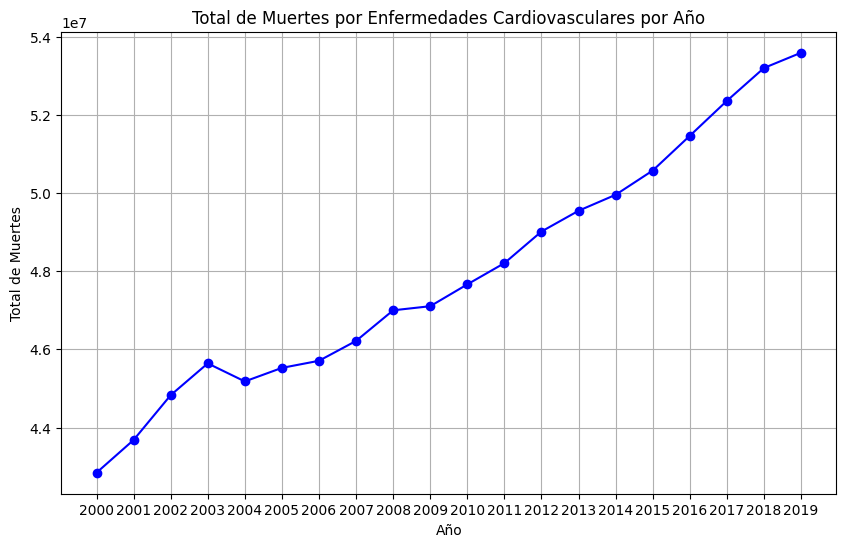

In [13]:
import matplotlib.pyplot as plt

# Filtramos solo las columnas de las patologías y el año
df_yearly = df[['Year'] + patologias]

# Sumamos todas las muertes por todas las patologías para cada año
df_yearly['Total_Deaths'] = df_yearly[patologias].sum(axis=1)

# Agrupamos por año y sumamos las muertes para cada año
muertes_por_ano = df_yearly.groupby('Year')['Total_Deaths'].sum()

# Graficar el total de muertes por año
plt.figure(figsize=(10, 6))
plt.plot(muertes_por_ano.index, muertes_por_ano.values, marker='o', linestyle='-', color='b')
plt.xlabel('Año')
plt.ylabel('Total de Muertes')
plt.title('Total de Muertes por Enfermedades Cardiovasculares por Año')
plt.xticks(muertes_por_ano.index.astype(int))
plt.grid(True)
plt.show()

### Medidas de tendencia central

#### Media

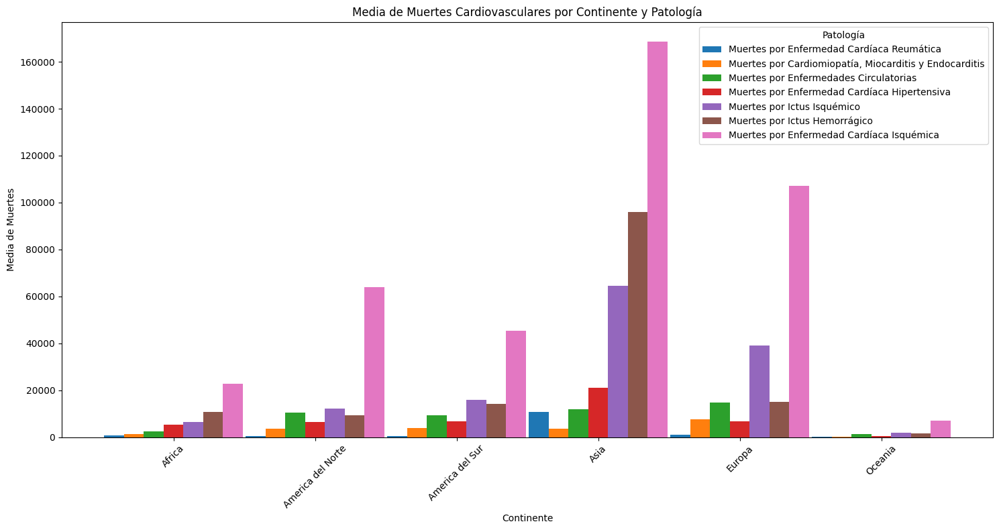

In [14]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Función para calcular la media de un conjunto de datos
def calcular_media_continentes(data):
    return np.mean(data)

# Lista para almacenar los resultados
resultados = []

# Iterar sobre cada continente y sus respectivos países
for continente, paises in continentes.items():
    # Filtrar el DataFrame para obtener los datos del continente actual
    df_continente = df[df['Entity'].isin(paises)]

    # Iterar sobre cada patología
    for patologia in patologias:
        # Obtener los datos de la patología actual en el continente
        data_patologia = df_continente[patologia]
        
        # Calcular la media de la patología
        media = calcular_media_continentes(data_patologia)
        
        # Reemplazar el nombre de la patología por una versión más legible
        patologia_legible = reemplazar_texto(patologia)
        
        # Almacenar los resultados en la lista
        resultados.append({
            'Continente': continente,
            'Patologia': patologia_legible,
            'Media': media
        })

# Convertir la lista de resultados en un DataFrame
resultados_df = pd.DataFrame(resultados)

# Crear una figura para el gráfico
plt.figure(figsize=(15, 8))

# Ancho de las barras en el gráfico
bar_width = 0.14
index = np.arange(len(continentes))

# Iterar sobre cada patología única en el DataFrame de resultados
for i, patologia in enumerate(resultados_df['Patologia'].unique()):
    subset = resultados_df[resultados_df['Patologia'] == patologia]
    plt.bar(index + i * bar_width, subset['Media'], bar_width, label=patologia)

# Configurar el título y etiquetas del gráfico
plt.title('Media de Muertes Cardiovasculares por Continente y Patología')
plt.xlabel('Continente')
plt.ylabel('Media de Muertes')
plt.xticks(index + bar_width * (len(patologias) - 1) / 2, continentes.keys())
plt.legend(title='Patología')
plt.xticks(rotation=45)

# Mostrar el gráfico
plt.tight_layout()
plt.show()


#### Mediana

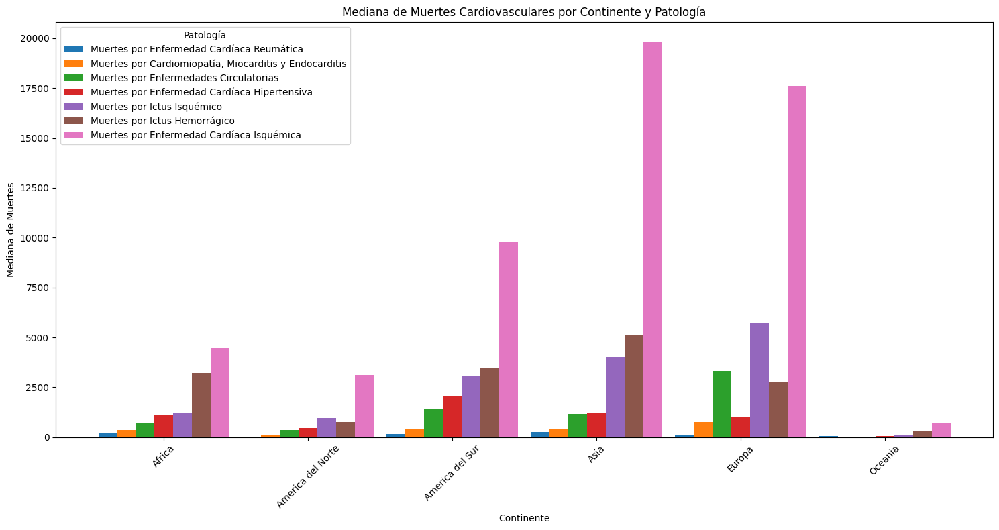

In [15]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Función para calcular la mediana de un conjunto de datos
def calcular_mediana_continentes(data):
    return np.median(data)

# Lista para almacenar los resultados
resultados = []

# Iterar sobre cada continente y sus respectivos países
for continente, paises in continentes.items():
    # Filtrar el DataFrame para obtener los datos del continente actual
    df_continente = df[df['Entity'].isin(paises)]

    # Iterar sobre cada patología
    for patologia in patologias:
        # Obtener los datos de la patología actual en el continente
        data_patologia = df_continente[patologia]
        
        # Calcular la mediana de la patología
        mediana = calcular_mediana_continentes(data_patologia)
        
        # Reemplazar el nombre de la patología por una versión más legible
        patologia_legible = reemplazar_texto(patologia)
        
        # Almacenar los resultados en la lista
        resultados.append({
            'Continente': continente,
            'Patologia': patologia_legible,
            'Mediana': mediana
        })

# Convertir la lista de resultados en un DataFrame
resultados_df = pd.DataFrame(resultados)

# Crear una figura para el gráfico
plt.figure(figsize=(15, 8))

# Ancho de las barras en el gráfico
bar_width = 0.13
index = np.arange(len(continentes))

# Iterar sobre cada patología única en el DataFrame de resultados
for i, patologia in enumerate(resultados_df['Patologia'].unique()):
    subset = resultados_df[resultados_df['Patologia'] == patologia]
    plt.bar(index + i * bar_width, subset['Mediana'], bar_width, label=patologia)

# Configurar el título y etiquetas del gráfico
plt.title('Mediana de Muertes Cardiovasculares por Continente y Patología')
plt.xlabel('Continente')
plt.ylabel('Mediana de Muertes')
plt.xticks(index + bar_width * (len(patologias) - 1) / 2, continentes.keys())
plt.legend(title='Patología')
plt.xticks(rotation=45)

# Mostrar el gráfico
plt.tight_layout()
plt.show()

#### Varianza

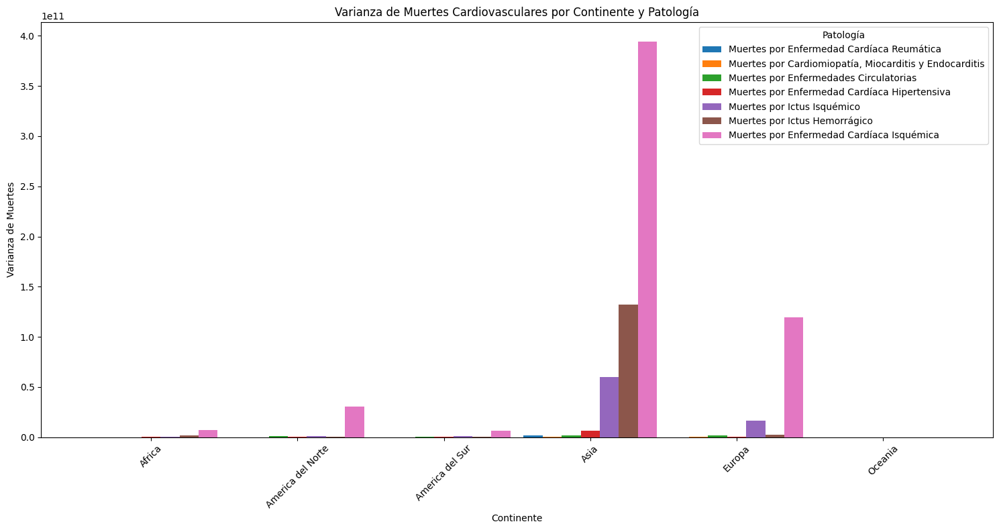

In [16]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Función para calcular la varianza de un conjunto de datos
def calcular_varianza_continentes(data):
    return np.var(data)

# Lista para almacenar los resultados
resultados = []

# Iterar sobre cada continente y sus respectivos países
for continente, paises in continentes.items():
    # Filtrar el DataFrame para obtener los datos del continente actual
    df_continente = df[df['Entity'].isin(paises)]

    # Iterar sobre cada patología
    for patologia in patologias:
        # Obtener los datos de la patología actual en el continente
        data_patologia = df_continente[patologia]
        
        # Calcular la varianza de la patología
        varianza = calcular_varianza_continentes(data_patologia)
        
        # Reemplazar el nombre de la patología por una versión más legible
        patologia_legible = reemplazar_texto(patologia)
        
        # Almacenar los resultados en la lista
        resultados.append({
            'Continente': continente,
            'Patologia': patologia_legible,
            'Varianza': varianza
        })

# Convertir la lista de resultados en un DataFrame
resultados_df = pd.DataFrame(resultados)

# Crear una figura para el gráfico
plt.figure(figsize=(15, 8))

# Ancho de las barras en el gráfico
bar_width = 0.13
index = np.arange(len(continentes))

# Iterar sobre cada patología única en el DataFrame de resultados
for i, patologia in enumerate(resultados_df['Patologia'].unique()):
    subset = resultados_df[resultados_df['Patologia'] == patologia]
    plt.bar(index + i * bar_width, subset['Varianza'], bar_width, label=patologia)

# Configurar el título y etiquetas del gráfico
plt.title('Varianza de Muertes Cardiovasculares por Continente y Patología')
plt.xlabel('Continente')
plt.ylabel('Varianza de Muertes')
plt.xticks(index + bar_width * (len(patologias) - 1) / 2, continentes.keys())
plt.legend(title='Patología')
plt.xticks(rotation=45)

# Mostrar el gráfico
plt.tight_layout()
plt.show()

#### Desviación estándar

Desviación estándar de Muertes Cardiovasculares en Africa
La Desviación estándar de Muertes por Enfermedad Cardíaca Reumática es: 2553.8927530788687
La Desviación estándar de Muertes por Cardiomiopatía, Miocarditis y Endocarditis es: 4948.268206693669
La Desviación estándar de Muertes por Enfermedades Circulatorias es: 9754.930564334583
La Desviación estándar de Muertes por Enfermedad Cardíaca Hipertensiva es: 19523.698056505284
La Desviación estándar de Muertes por Ictus Isquémico es: 24275.76307770034
La Desviación estándar de Muertes por Ictus Hemorrágico es: 39984.93196650453
La Desviación estándar de Muertes por Enfermedad Cardíaca Isquémica es: 86116.19476933702
----------------------------------------------------------------------------------
Desviación estándar de Muertes Cardiovasculares en America del Norte
La Desviación estándar de Muertes por Enfermedad Cardíaca Reumática es: 1436.8451596787072
La Desviación estándar de Muertes por Cardiomiopatía, Miocarditis y Endocarditis

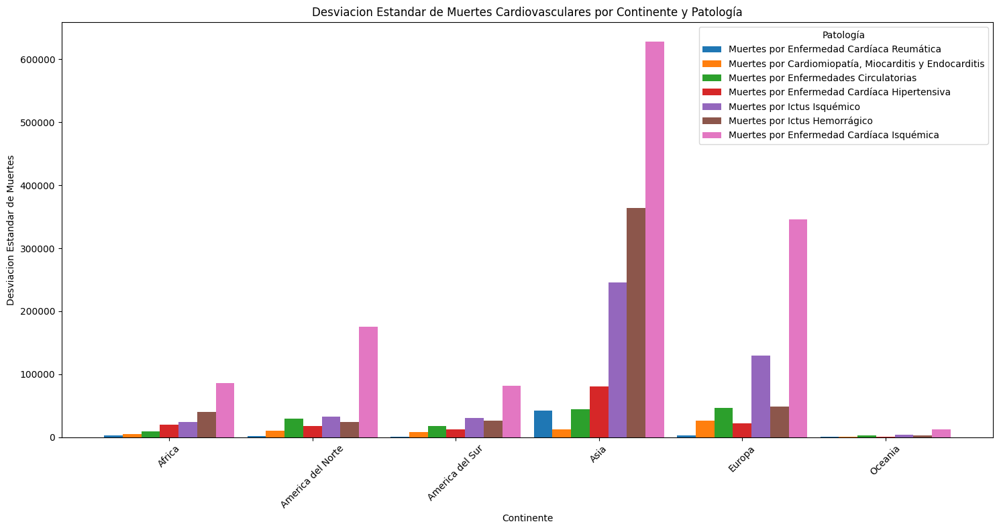

In [17]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Función para calcular la varianza de un conjunto de datos
def calcular_varianza_continentes(data):
    return np.var(data)

# Imprimir la desviación estándar por continente y patología
for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]
    print(f"Desviación estándar de Muertes Cardiovasculares en {continente}")

    for patologia in patologias:
        data_patologia = df_continente[patologia]
        desv_est = np.sqrt(calcular_varianza_continentes(data_patologia))
        patologia_legible = reemplazar_texto(patologia)

        print(f"La Desviación estándar de {patologia_legible} es: {desv_est}")
    print("----------------------------------------------------------------------------------")

# Lista para almacenar los resultados
resultados = []

# Calcular la desviación estándar y almacenar los resultados
for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]

    for patologia in patologias:
        data_patologia = df_continente[patologia]
        desv_est = np.sqrt(calcular_varianza_continentes(data_patologia))
        patologia_legible = reemplazar_texto(patologia)
        resultados.append({
            'Continente': continente,
            'Patologia': patologia_legible,
            'Desviacion Estandar': desv_est
        })

# Convertir la lista de resultados en un DataFrame
resultados_df = pd.DataFrame(resultados)

# Crear una figura para el gráfico
plt.figure(figsize=(15, 8))

# Ancho de las barras en el gráfico
bar_width = 0.13
index = np.arange(len(continentes))

# Iterar sobre cada patología única en el DataFrame de resultados
for i, patologia in enumerate(resultados_df['Patologia'].unique()):
    subset = resultados_df[resultados_df['Patologia'] == patologia]
    plt.bar(index + i * bar_width, subset['Desviacion Estandar'], bar_width, label=patologia)

# Configurar el título y etiquetas del gráfico
plt.title('Desviacion Estandar de Muertes Cardiovasculares por Continente y Patología')
plt.xlabel('Continente')
plt.ylabel('Desviacion Estandar de Muertes')
plt.xticks(index + bar_width * (len(patologias) - 1) / 2, continentes.keys())
plt.legend(title='Patología')
plt.xticks(rotation=45)

# Mostrar el gráfico
plt.tight_layout()
plt.show()

In [18]:
#from google.colab import drive
#drive.mount('/content/drive')

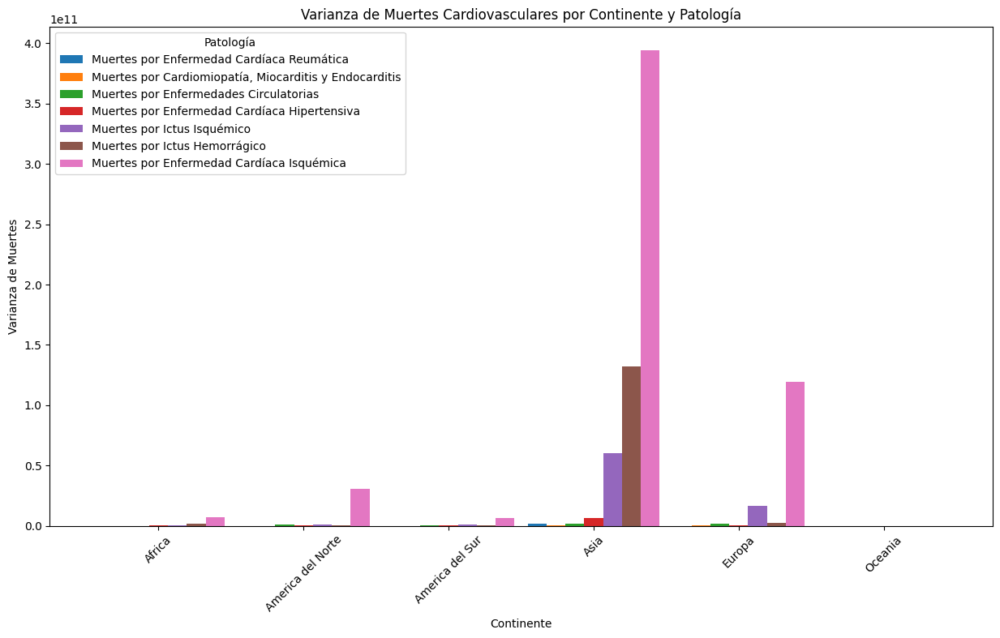

In [19]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Función para calcular la varianza de un conjunto de datos
def calcular_varianza_continentes(data):
    return np.var(data)

# Lista para almacenar los resultados
resultados = []

# Calcular la varianza y almacenar los resultados
for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]

    for patologia in patologias:
        data_patologia = df_continente[patologia]
        varianza = calcular_varianza_continentes(data_patologia)
        patologia_legible = reemplazar_texto(patologia)
        resultados.append({
            'Continente': continente,
            'Patologia': patologia_legible,
            'Varianza': varianza
        })

# Convertir la lista de resultados en un DataFrame
resultados_df = pd.DataFrame(resultados)

# Crear una figura para el gráfico
plt.figure(figsize=(15, 8))

# Ancho de las barras en el gráfico
bar_width = 0.13
index = np.arange(len(continentes))

# Iterar sobre cada patología única en el DataFrame de resultados
for i, patologia in enumerate(resultados_df['Patologia'].unique()):
    subset = resultados_df[resultados_df['Patologia'] == patologia]
    plt.bar(index + i * bar_width, subset['Varianza'], bar_width, label=patologia)

# Configurar el título y etiquetas del gráfico
plt.title('Varianza de Muertes Cardiovasculares por Continente y Patología')
plt.xlabel('Continente')
plt.ylabel('Varianza de Muertes')
plt.xticks(index + bar_width * (len(patologias) - 1) / 2, continentes.keys())
plt.legend(title='Patología')
plt.xticks(rotation=45)

# Mostrar el gráfico
plt.show()


Desviación estándar de Muertes Cardiovasculares en Africa
La Desviación estándar de Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges es: 2553.8927530788687
La Desviación estándar de Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges es: 4948.268206693669
La Desviación estándar de Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges es: 9754.930564334583
La Desviación estándar de Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges es: 19523.698056505284
La Desviación estándar de Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges es: 24275.76307770034
La Desviación estándar de Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges es: 39984.93196650453
La Desviación estándar de Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges es: 86116.19476933702
--------------------------------------

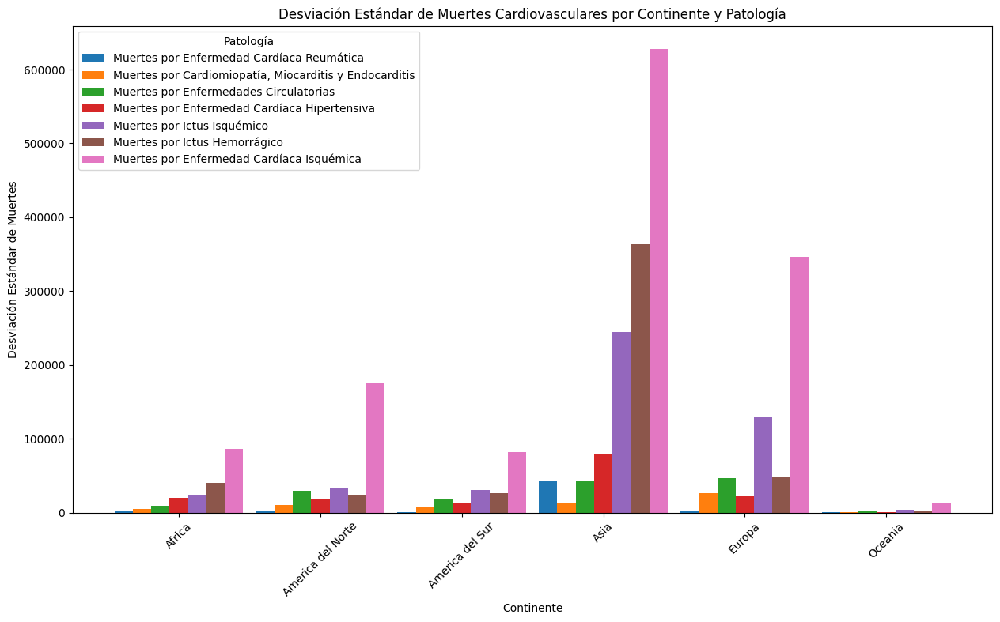

In [20]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Función para calcular la varianza de un conjunto de datos
def calcular_varianza_continentes(data):
    return np.var(data)

# Función para calcular la desviación estándar de un conjunto de datos
def calcular_desviacion_estandar_continentes(data):
    return np.sqrt(calcular_varianza_continentes(data))

# Diccionario para almacenar los resultados de la desviación estándar
resultados_desv_est = []

# Calcular la desviación estándar y almacenar los resultados
for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]

    for patologia in patologias:
        data_patologia = df_continente[patologia]
        desv_est = calcular_desviacion_estandar_continentes(data_patologia)
        patologia_legible = reemplazar_texto(patologia)
        resultados_desv_est.append({
            'Continente': continente,
            'Patologia': patologia_legible,
            'Desviacion Estandar': desv_est
        })

# Convertir la lista de resultados en un DataFrame
resultados_desv_est_df = pd.DataFrame(resultados_desv_est)

# Mostrar los resultados impresos por consola
for continente, paises in continentes.items():
    print(f"Desviación estándar de Muertes Cardiovasculares en {continente}")

    for patologia in patologias:
        desv_est = resultados_desv_est_df[
            (resultados_desv_est_df['Continente'] == continente) & 
            (resultados_desv_est_df['Patologia'] == reemplazar_texto(patologia))
        ]['Desviacion Estandar'].values[0]

        print(f"La Desviación estándar de {patologia} es: {desv_est}")
    print("-"*90)

# Crear una figura para el gráfico de barras
plt.figure(figsize=(15, 8))

# Ancho de las barras en el gráfico
bar_width = 0.13
index = np.arange(len(continentes))

# Iterar sobre cada patología única en el DataFrame de resultados de desviación estándar
for i, patologia in enumerate(resultados_desv_est_df['Patologia'].unique()):
    subset = resultados_desv_est_df[resultados_desv_est_df['Patologia'] == patologia]
    plt.bar(index + i * bar_width, subset['Desviacion Estandar'], bar_width, label=patologia)

# Configurar el título y etiquetas del gráfico
plt.title('Desviación Estándar de Muertes Cardiovasculares por Continente y Patología')
plt.xlabel('Continente')
plt.ylabel('Desviación Estándar de Muertes')
plt.xticks(index + bar_width * (len(patologias) - 1) / 2, continentes.keys())
plt.legend(title='Patología')
plt.xticks(rotation=45)

# Mostrar el gráfico
plt.show()


#### Moda

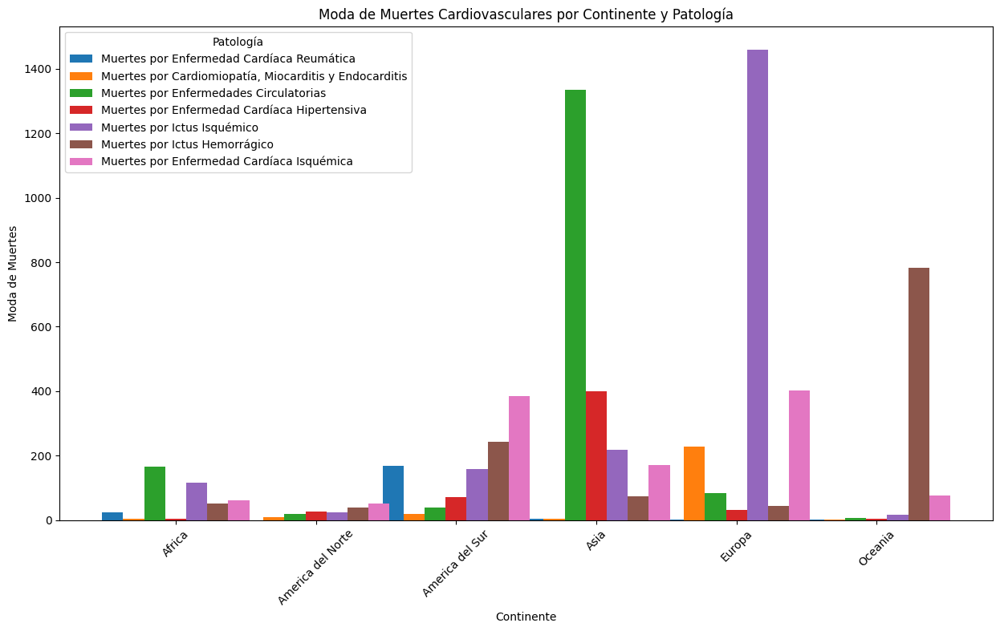

In [21]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import mode

# Definir la función para reemplazar los textos en inglés por su equivalente en español
def reemplazar_texto(texto):
    reemplazos = {
        'Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges': 'Muertes por Enfermedad Cardíaca Reumática',
        'Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges': 'Muertes por Cardiomiopatía, Miocarditis y Endocarditis',
        'Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges': 'Muertes por Enfermedades Circulatorias',
        'Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges': 'Muertes por Enfermedad Cardíaca Hipertensiva',
        'Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges': 'Muertes por Ictus Isquémico',
        'Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges': 'Muertes por Ictus Hemorrágico',
        'Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges': 'Muertes por Enfermedad Cardíaca Isquémica'
    }
    return reemplazos.get(texto, texto)

# Función para calcular la moda de un conjunto de datos
def calcular_moda_continentes(data):
    if data.empty or data.isna().all():
        return np.nan
    moda_result = mode(data, nan_policy='omit')
    # Verificar si moda_result.count y moda_result.mode son escalares o arrays
    if isinstance(moda_result.count, np.ndarray):
        if moda_result.count.size > 0 and moda_result.count[0] > 0:
            return moda_result.mode[0]
    else:
        if moda_result.count > 0:
            return moda_result.mode
    return np.nan

# Lista para almacenar los resultados de la moda
resultados = []

# Iterar sobre cada continente y sus respectivos países
for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]

    for patologia in patologias:
        data_patologia = df_continente[patologia]
        moda = calcular_moda_continentes(data_patologia)
        patologia_legible = reemplazar_texto(patologia)
        resultados.append({
            'Continente': continente,
            'Patologia': patologia_legible,
            'Moda': moda
        })

# Convertir la lista de resultados a un DataFrame
resultados_df = pd.DataFrame(resultados)

# Crear la figura para el gráfico de barras
plt.figure(figsize=(15, 8))

# Configuración para las barras
bar_width = 0.15
index = np.arange(len(resultados_df['Continente'].unique()))

# Crear barras para cada patología
for i, patologia in enumerate(resultados_df['Patologia'].unique()):
    subset = resultados_df[resultados_df['Patologia'] == patologia]
    plt.bar(index + i * bar_width, subset['Moda'], bar_width, label=patologia)

# Configurar el gráfico
plt.title('Moda de Muertes Cardiovasculares por Continente y Patología')
plt.xlabel('Continente')
plt.ylabel('Moda de Muertes')
plt.xticks(index + bar_width * (len(resultados_df['Patologia'].unique()) - 1) / 2, resultados_df['Continente'].unique())
plt.legend(title='Patología')
plt.xticks(rotation=45)

# Mostrar el gráfico
plt.show()


### Rango

Rangos de muertes por enfermedades en Africa:
El rango de Muertes por Enfermedad Cardíaca Reumática es: 20652.04
El rango de Muertes por Cardiomiopatía, Miocarditis y Endocarditis es: 41908.55
El rango de Muertes por Enfermedades Circulatorias es: 85867.87000000001
El rango de Muertes por Enfermedad Cardíaca Hipertensiva es: 168949.03
El rango de Muertes por Ictus Isquémico es: 222580.45
El rango de Muertes por Ictus Hemorrágico es: 319762.4
El rango de Muertes por Enfermedad Cardíaca Isquémica es: 759482.9299999999
Rangos de muertes por enfermedades en America del Norte:
El rango de Muertes por Enfermedad Cardíaca Reumática es: 6772.0
El rango de Muertes por Cardiomiopatía, Miocarditis y Endocarditis es: 40493.43
El rango de Muertes por Enfermedades Circulatorias es: 140481.77000000002
El rango de Muertes por Enfermedad Cardíaca Hipertensiva es: 100504.29
El rango de Muertes por Ictus Isquémico es: 150371.72
El rango de Muertes por Ictus Hemorrágico es: 117844.38
El rango de Muertes p

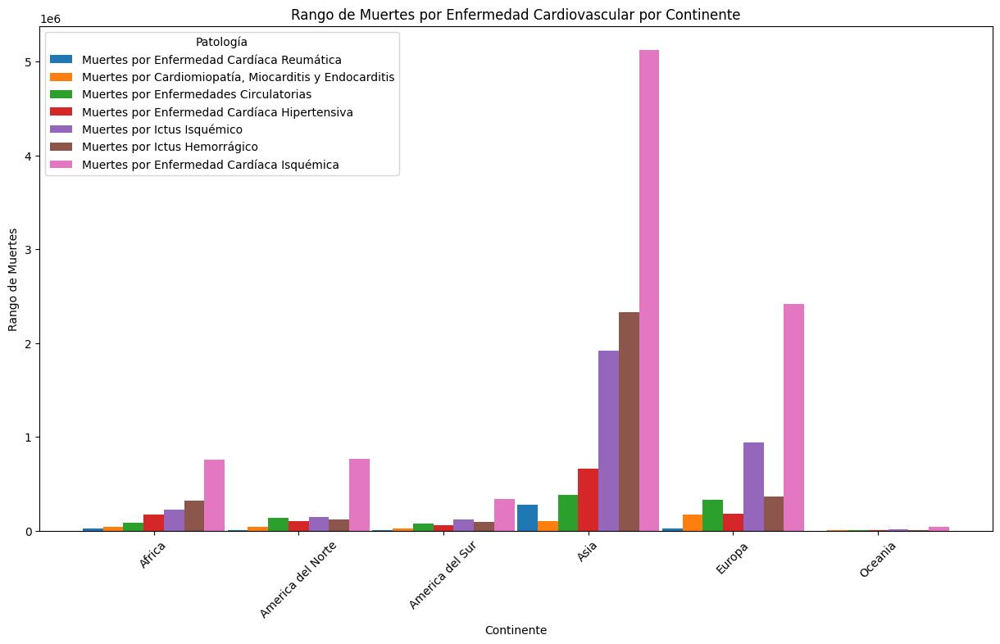

In [22]:
def calcular_rango(data):
    return data.max() - data.min()

resultados = []

# Calcular el rango y almacenar los resultados
for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]
    print(f"Rangos de muertes por enfermedades en {continente}:")

    for patologia in patologias:
        data_patologia = df_continente[patologia]
        rango = calcular_rango(data_patologia)
        patologia_legible = reemplazar_texto(patologia)
        resultados.append({
            'Continente': continente,
            'Patologia': patologia_legible,
            'Rango': rango
        })

        print(f"El rango de {patologia_legible} es: {rango}")

# Convertir la lista de resultados a un DataFrame
resultados_df = pd.DataFrame(resultados)

# Graficar el rango
plt.figure(figsize=(15, 8))

bar_width = 0.14
index = np.arange(len(continentes))  # Utilizar np.arange en lugar de list(range())

# Iterar sobre las patologías para crear barras agrupadas
for i, patologia in enumerate(resultados_df['Patologia'].unique()):
    subset = resultados_df[resultados_df['Patologia'] == patologia]
    plt.bar(index + i * bar_width, subset['Rango'], bar_width, label=patologia)

# Configuración del gráfico
plt.title('Rango de Muertes por Enfermedad Cardiovascular por Continente')
plt.xlabel('Continente')
plt.ylabel('Rango de Muertes')
plt.xticks(index + bar_width * (len(patologias) - 1) / 2, continentes.keys())
plt.legend(title='Patología')
plt.xticks(rotation=45)
plt.show()


### Marcas de clase

In [23]:
for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]
    print(f"Marca de clase de muertes por enfermedades en {continente}")  # Imprimir el nombre correcto del continente

    for patologia in patologias:
        data_patologia = df_continente[patologia]
        rango = calcular_rango(data_patologia)
        
        # Definir el número de bins para el histograma
        num_bins = 10  # Usar un número apropiado de bins para obtener marcas de clase más significativas
        hist, bins = np.histogram(data_patologia, bins=num_bins)
        
        # Calcular las marcas de clase como el punto medio de cada bin
        marcas_clase = [(bins[i] + bins[i + 1]) / 2 for i in range(len(bins) - 1)]

        patologia_legible = reemplazar_texto(patologia)
        print(f"Las marcas de clase para {patologia_legible} son: {marcas_clase}")

    print("-" * 90)

Marca de clase de muertes por enfermedades en Africa
Las marcas de clase para Muertes por Enfermedad Cardíaca Reumática son: [1033.4420000000002, 3098.6460000000006, 5163.85, 7229.054000000001, 9294.258000000002, 11359.462000000001, 13424.666000000001, 15489.870000000003, 17555.074, 19620.278000000002]
Las marcas de clase para Muertes por Cardiomiopatía, Miocarditis y Endocarditis son: [2099.0175000000004, 6289.872500000001, 10480.7275, 14671.582500000002, 18862.4375, 23053.292500000003, 27244.147500000006, 31435.002500000002, 35625.8575, 39816.7125]
Las marcas de clase para Muertes por Enfermedades Circulatorias son: [4301.2335, 12888.0205, 21474.807500000003, 30061.5945, 38648.381499999996, 47235.1685, 55821.9555, 64408.7425, 72995.5295, 81582.3165]
Las marcas de clase para Muertes por Enfermedad Cardíaca Hipertensiva son: [8451.9415, 25346.8445, 42241.7475, 59136.650499999996, 76031.5535, 92926.4565, 109821.35949999999, 126716.26249999998, 143611.16549999997, 160506.0685]
Las marcas

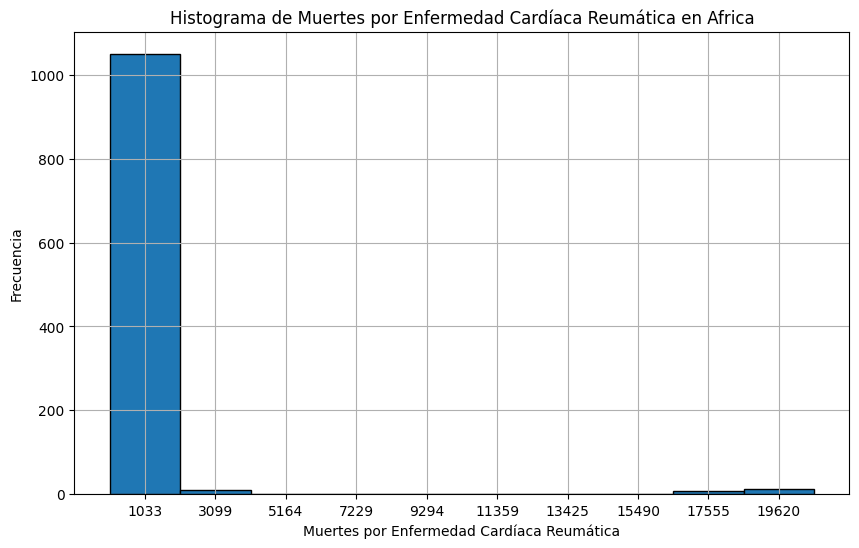

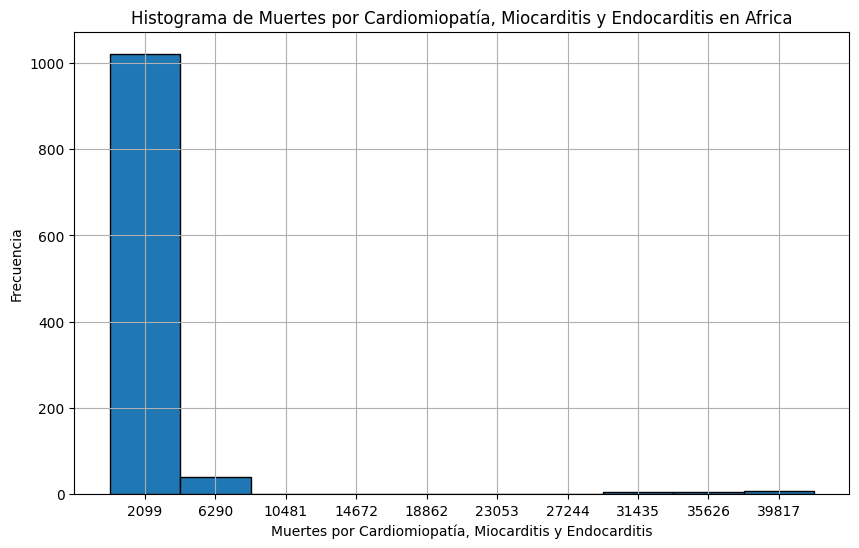

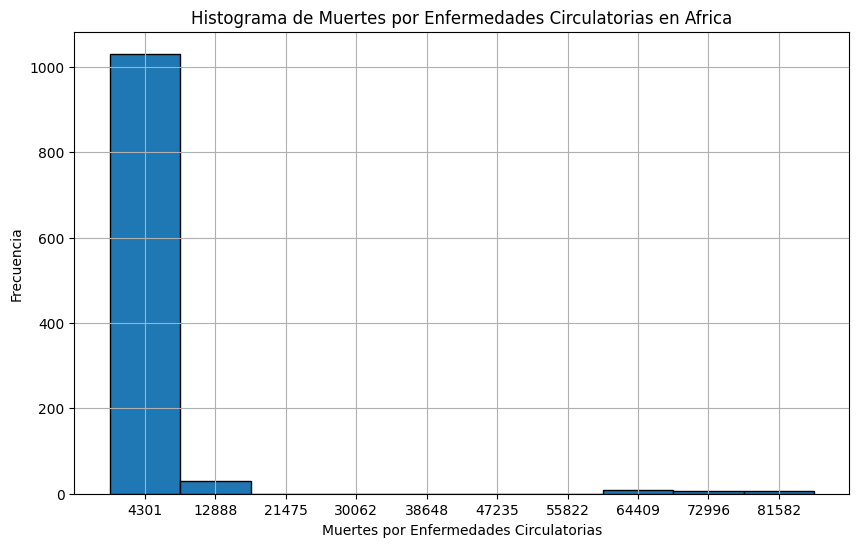

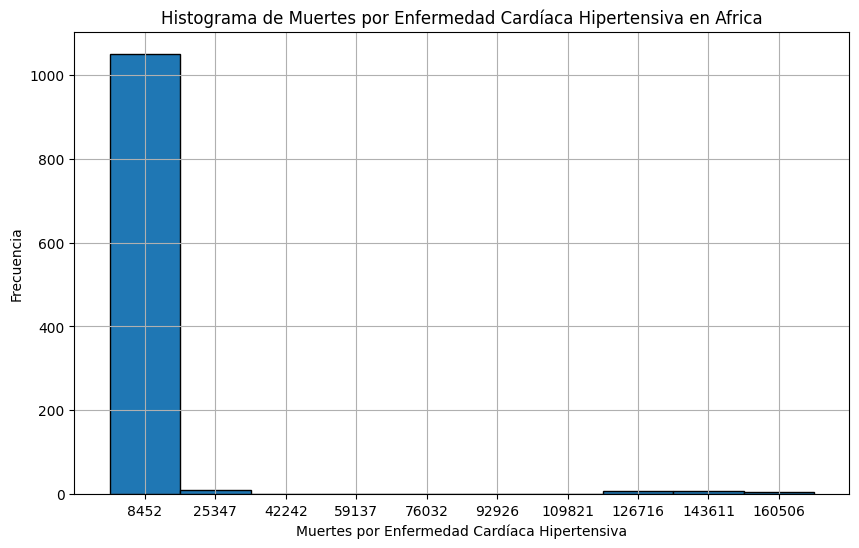

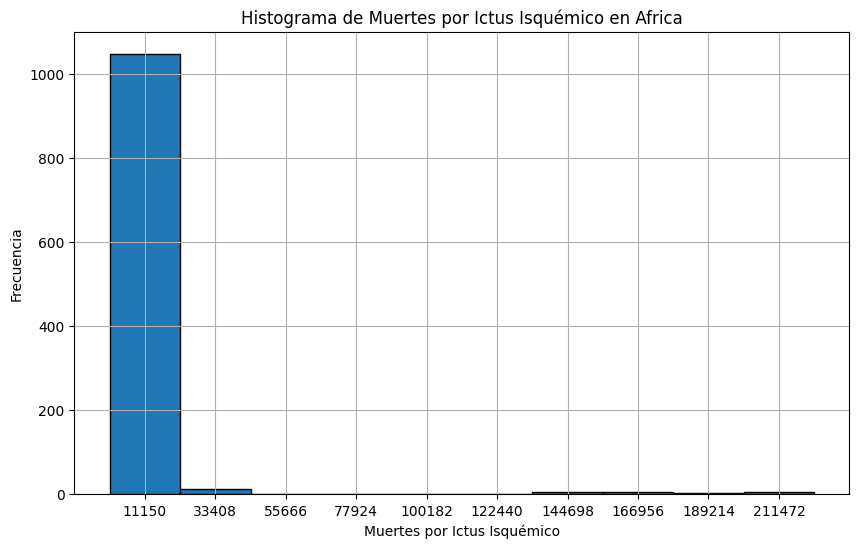

...

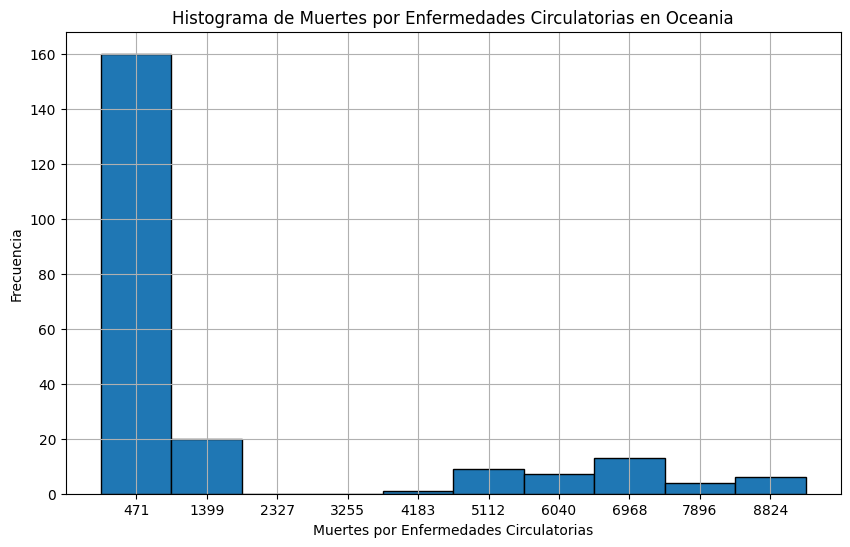

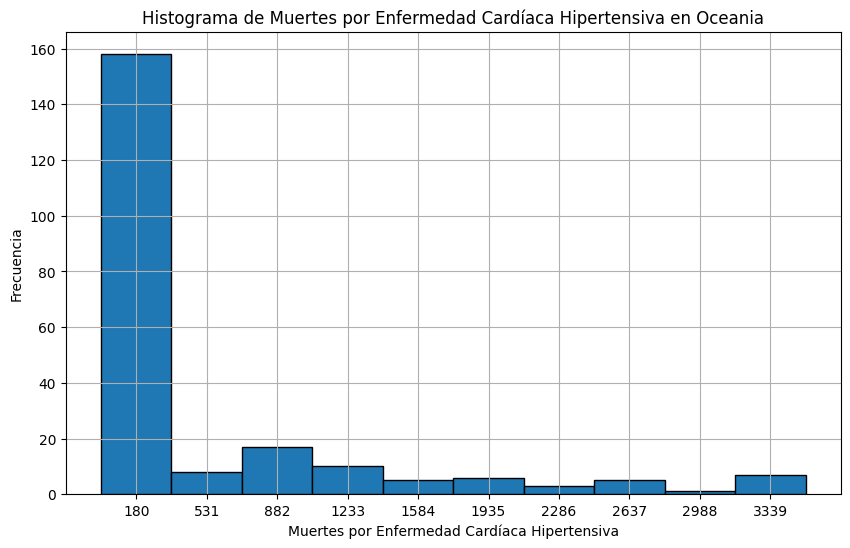

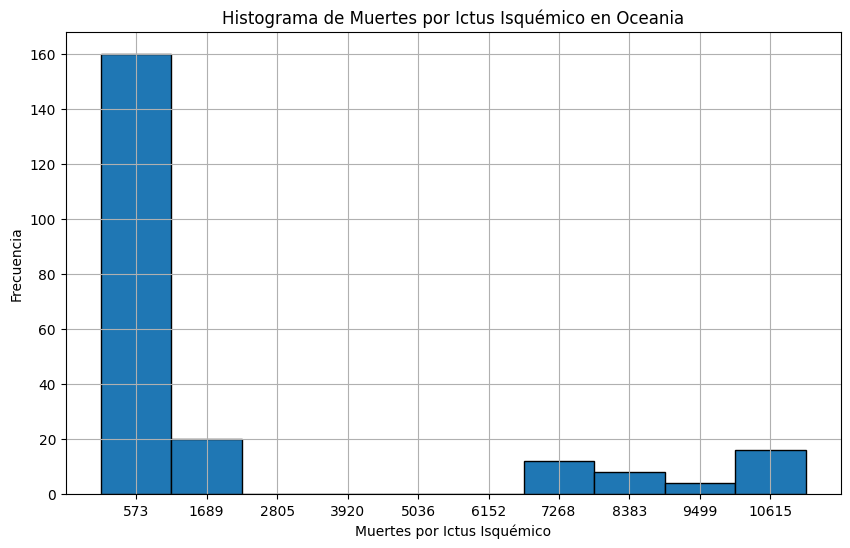

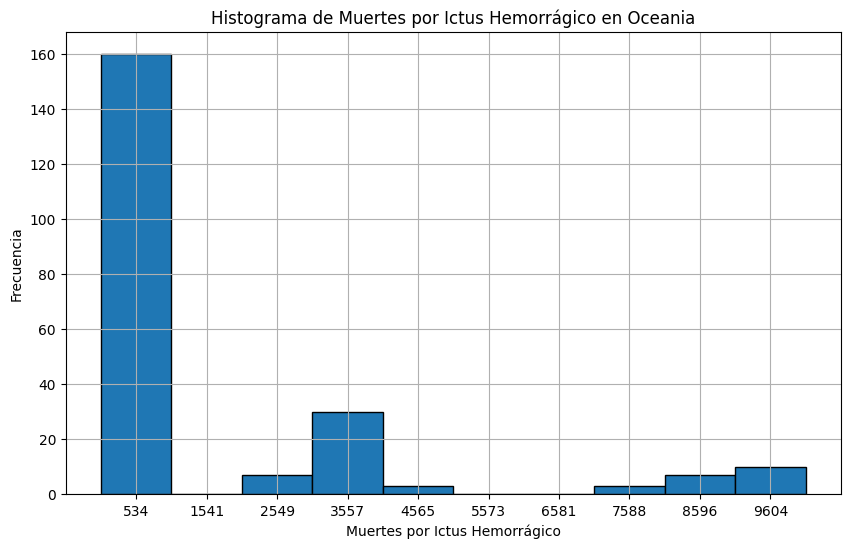

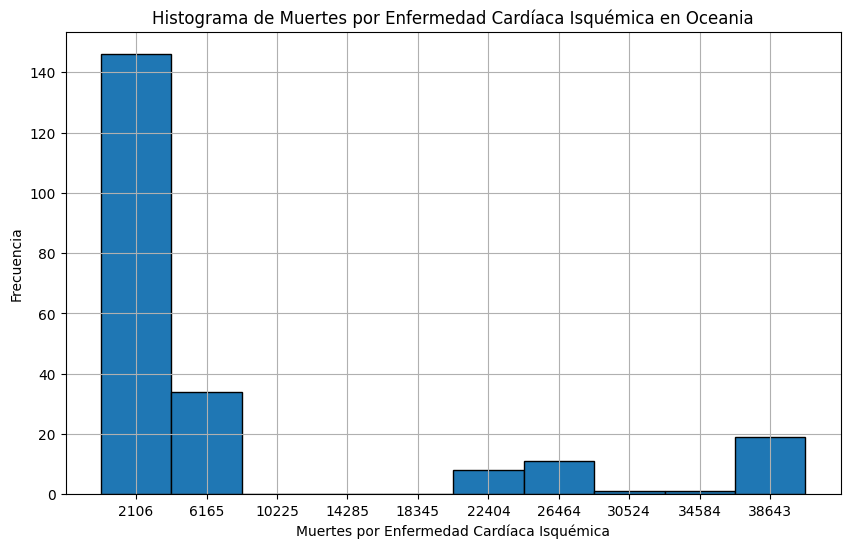

In [24]:
for continente, paises in continentes.items():
    # Filtrar el DataFrame para obtener los datos del continente actual
    df_continente = df[df['Entity'].isin(paises)]

    for patologia in patologias:
        # Obtener los datos de la patología actual en el continente
        data_patologia = df_continente[patologia]
        
        # Calcular el rango de los datos de la patología
        rango = calcular_rango(data_patologia)
        
        # Definir el número de bins para el histograma
        num_bins = 10
        
        # Calcular el histograma
        hist, bins = np.histogram(data_patologia, bins=num_bins)
        
        # Calcular las marcas de clase para etiquetar el eje x del histograma
        marcas_clase = [(bins[i] + bins[i + 1]) / 2 for i in range(len(bins) - 1)]

        # Obtener el nombre legible de la patología
        patologia_legible = reemplazar_texto(patologia)

        # Crear una nueva figura para cada histograma
        plt.figure(figsize=(10, 6))
        
        # Graficar el histograma
        plt.hist(data_patologia, bins=num_bins, edgecolor='black')
        
        # Configurar el título del gráfico
        plt.title(f'Histograma de {patologia_legible} en {continente}')
        
        # Configurar las etiquetas de los ejes
        plt.xlabel(patologia_legible)
        plt.ylabel('Frecuencia')
        
        # Establecer las marcas de clase en el eje x
        plt.xticks(marcas_clase)
        
        # Activar la cuadrícula en el gráfico
        plt.grid(True)
        
        # Mostrar el gráfico actual
        plt.show()


# Frecuencias

### Frecuencia Absoluta

Frecuencia Absoluta de Muertes por Enfermedades Cardiovasculares en Africa
La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Reumática es:
Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
0.84        1
0.85        2
0.86        3
0.87        2
0.88        1
           ..
19457.38    1
19723.10    1
20017.19    1
20340.27    1
20652.88    1
Name: count, Length: 1051, dtype: int64
------------------------------------------------------------------------------------------


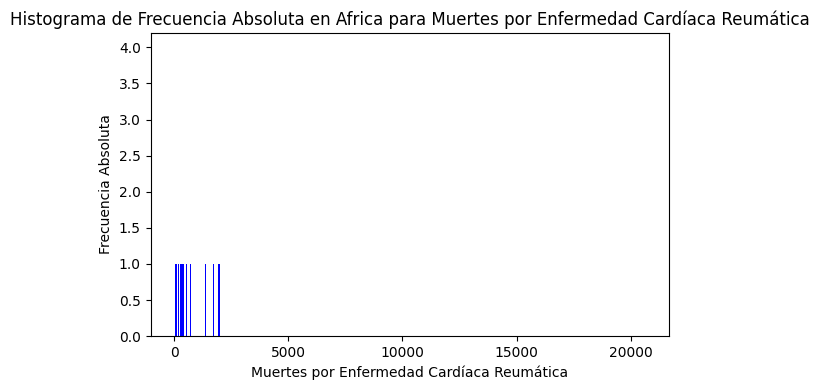

La Frecuencia Absoluta por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
3.590        1
3.790        1
3.950        1
4.140        1
4.260        1
            ..
39371.770    1
40136.400    1
40756.310    1
41414.742    1
41912.140    1
Name: count, Length: 1070, dtype: int64
------------------------------------------------------------------------------------------


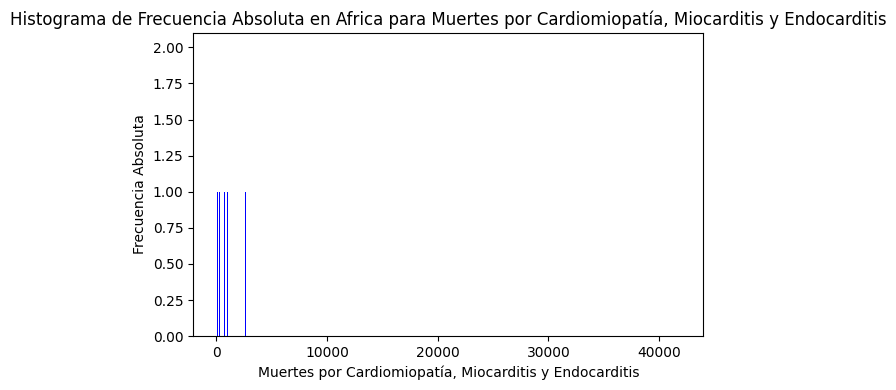

La Frecuencia Absoluta por Muertes por Enfermedades Circulatorias es:
Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
7.84        1
8.01        1
8.30        1
8.67        1
8.79        1
           ..
79002.25    1
80907.11    1
82560.66    1
84386.80    1
85875.71    1
Name: count, Length: 1077, dtype: int64
------------------------------------------------------------------------------------------


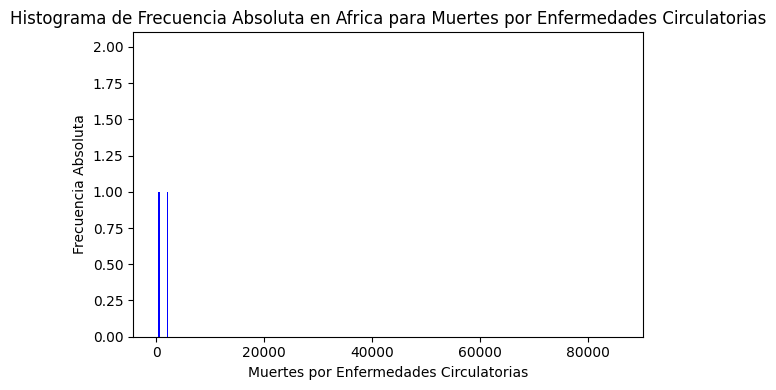

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Hipertensiva es:
Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
4.49         1
4.60         1
4.91         1
5.01         1
5.13         1
            ..
157492.22    1
160568.23    1
163145.42    1
166119.48    1
168953.52    1
Name: count, Length: 1074, dtype: int64
------------------------------------------------------------------------------------------


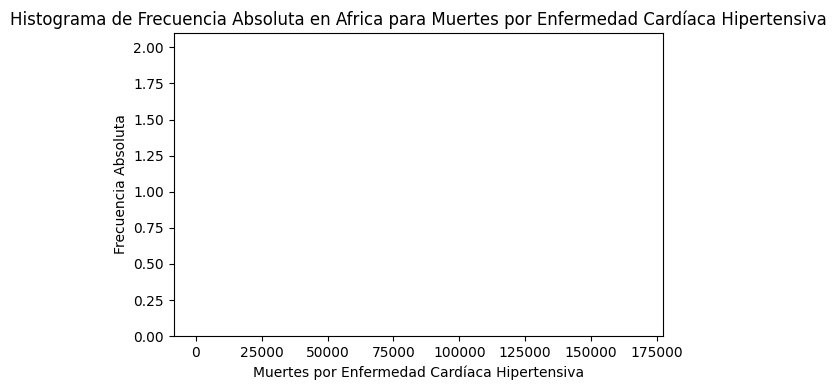

La Frecuencia Absoluta por Muertes por Ictus Isquémico es:
Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
20.72        1
21.32        1
21.41        1
22.23        1
22.44        1
            ..
202617.55    1
208114.31    1
212977.38    1
218254.10    1
222601.17    1
Name: count, Length: 1078, dtype: int64
------------------------------------------------------------------------------------------


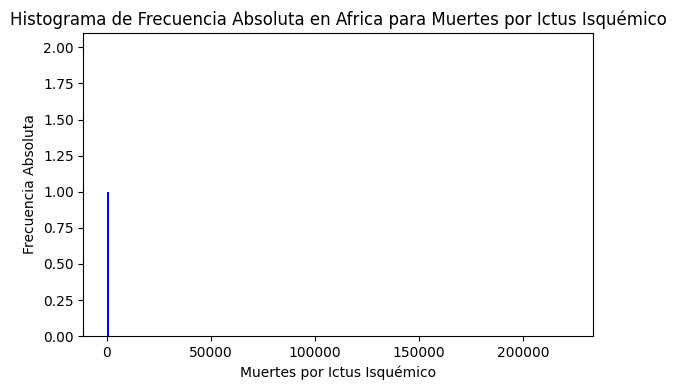

La Frecuencia Absoluta por Muertes por Ictus Hemorrágico es:
Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
24.60        1
24.63        1
25.12        1
26.29        1
26.51        1
            ..
308043.97    1
311411.28    1
313122.80    1
316123.34    1
319787.00    1
Name: count, Length: 1077, dtype: int64
------------------------------------------------------------------------------------------


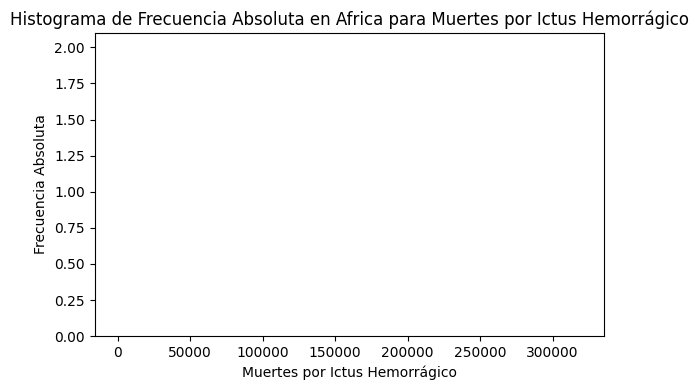

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Isquémica es:
Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
62.27        1
63.46        1
64.86        1
67.25        1
68.50        1
            ..
700492.70    1
711311.40    1
723322.70    1
743241.20    1
759545.20    1
Name: count, Length: 1080, dtype: int64
------------------------------------------------------------------------------------------


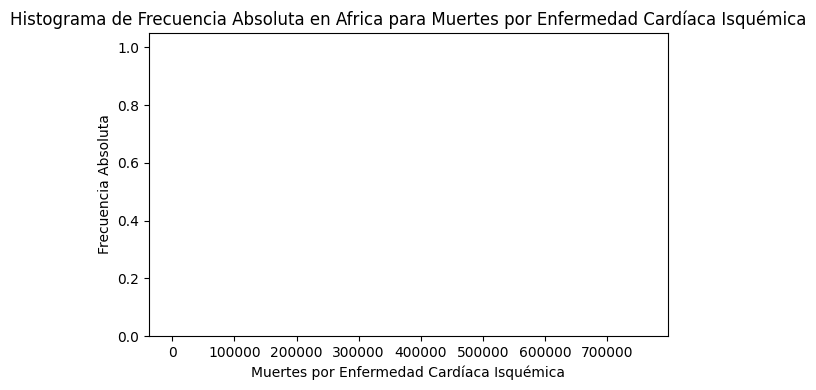

Frecuencia Absoluta de Muertes por Enfermedades Cardiovasculares en America del Norte
La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Reumática es:
Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
0.00       7
0.09       1
0.19       1
0.20       1
0.24       1
          ..
6487.09    1
6492.11    1
6593.87    1
6691.04    1
6772.00    1
Name: count, Length: 407, dtype: int64
------------------------------------------------------------------------------------------


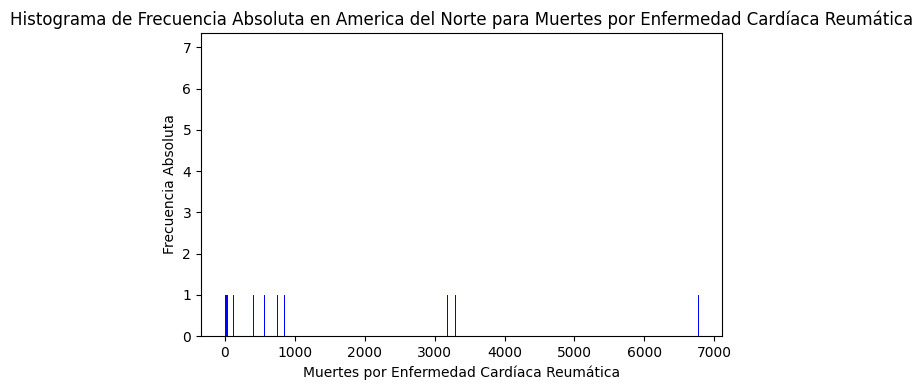

La Frecuencia Absoluta por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
1.23        1
1.67        1
1.79        1
2.00        1
2.05        1
           ..
39512.35    1
39797.33    1
39922.47    1
40191.20    1
40494.66    1
Name: count, Length: 438, dtype: int64
------------------------------------------------------------------------------------------


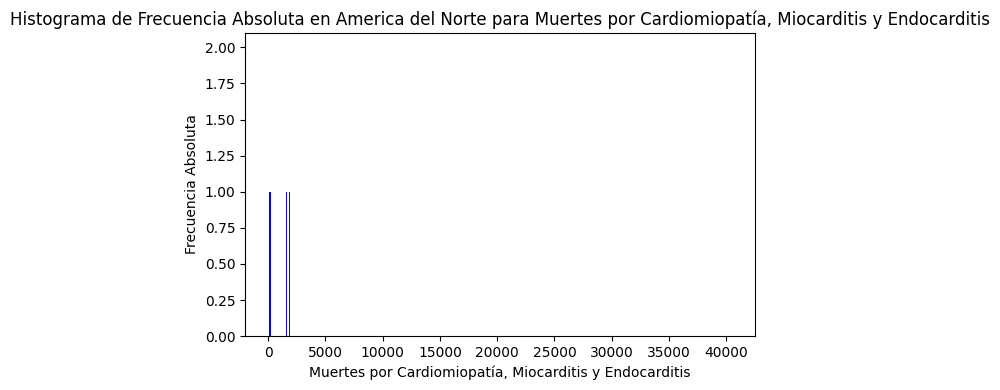

La Frecuencia Absoluta por Muertes por Enfermedades Circulatorias es:
Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
14.40        1
14.52        1
14.73        1
16.99        1
17.50        1
            ..
130131.31    1
133030.39    1
135864.75    1
138203.08    1
140496.17    1
Name: count, Length: 437, dtype: int64
------------------------------------------------------------------------------------------


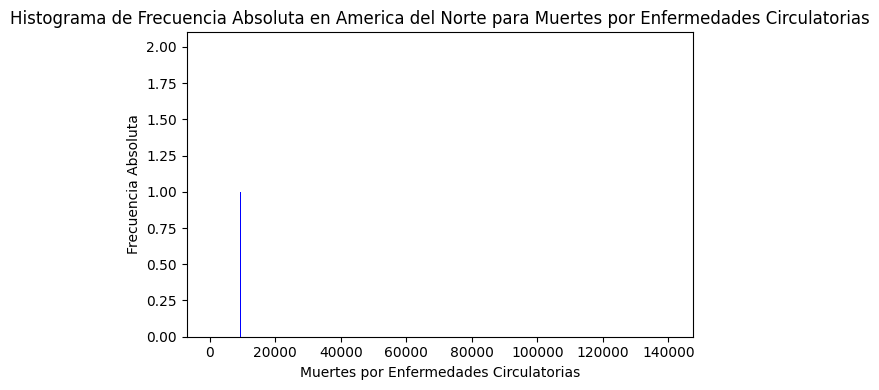

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Hipertensiva es:
Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
0.00         1
1.44         1
2.61         1
5.05         1
6.60         1
            ..
88564.22     1
93023.07     1
97884.39     1
99771.36     1
100504.29    1
Name: count, Length: 435, dtype: int64
------------------------------------------------------------------------------------------


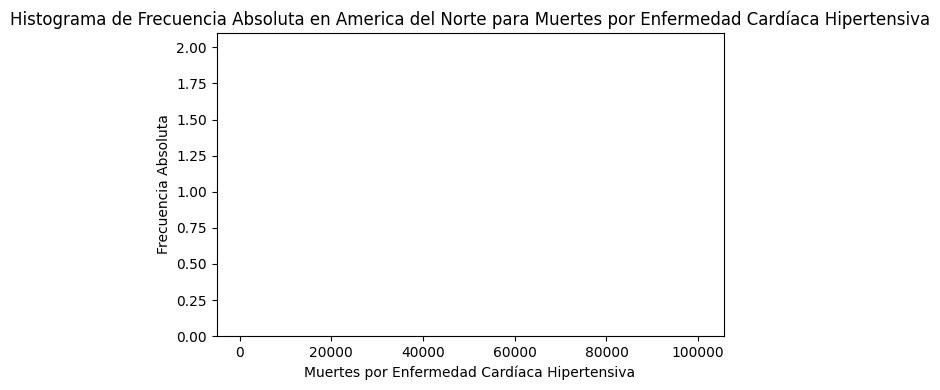

La Frecuencia Absoluta por Muertes por Ictus Isquémico es:
Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
18.06        1
19.76        1
20.19        1
21.92        1
22.37        1
            ..
144782.52    1
146436.77    1
147397.98    1
147605.08    1
150389.78    1
Name: count, Length: 438, dtype: int64
------------------------------------------------------------------------------------------


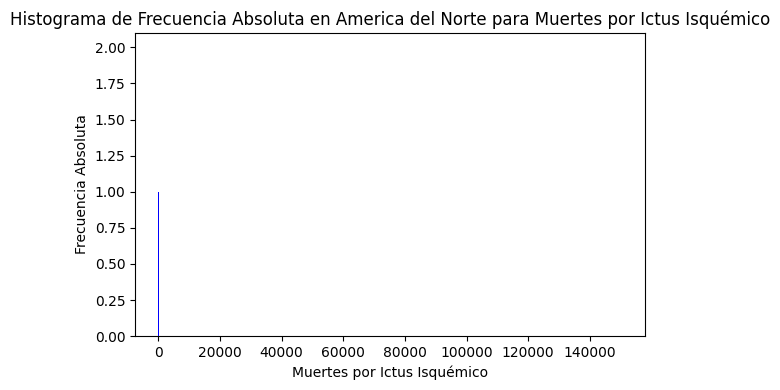

La Frecuencia Absoluta por Muertes por Ictus Hemorrágico es:
Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
19.59        1
20.18        1
21.92        1
22.05        1
22.20        1
            ..
110249.72    1
111734.02    1
114282.62    1
115814.10    1
117863.97    1
Name: count, Length: 435, dtype: int64
------------------------------------------------------------------------------------------


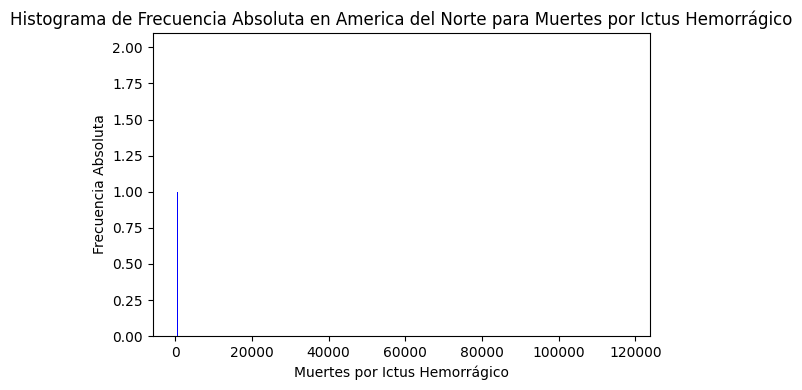

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Isquémica es:
Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
52.45        1
56.61        1
65.10        1
67.10        1
76.19        1
            ..
738099.70    1
746474.90    1
750899.60    1
753114.75    1
763962.44    1
Name: count, Length: 440, dtype: int64
------------------------------------------------------------------------------------------


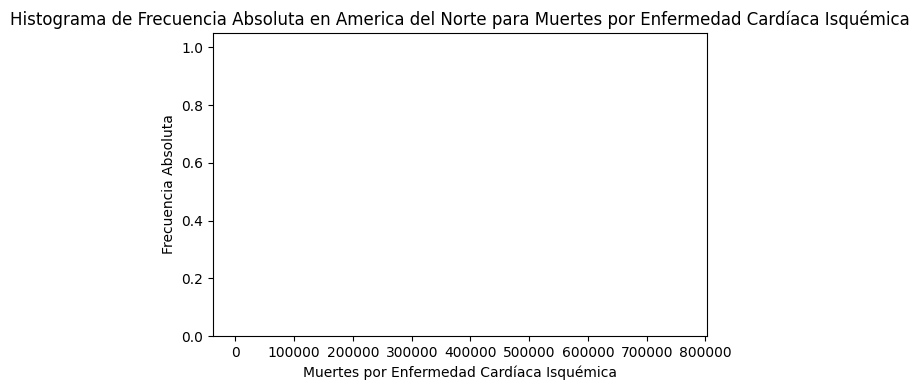

Frecuencia Absoluta de Muertes por Enfermedades Cardiovasculares en America del Sur
La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Reumática es:
Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
5.4900       1
5.5400       1
5.6000       1
5.6100       1
5.7400       1
            ..
3852.3300    1
3913.7200    1
3927.4200    1
3929.3098    1
4132.8003    1
Name: count, Length: 259, dtype: int64
------------------------------------------------------------------------------------------


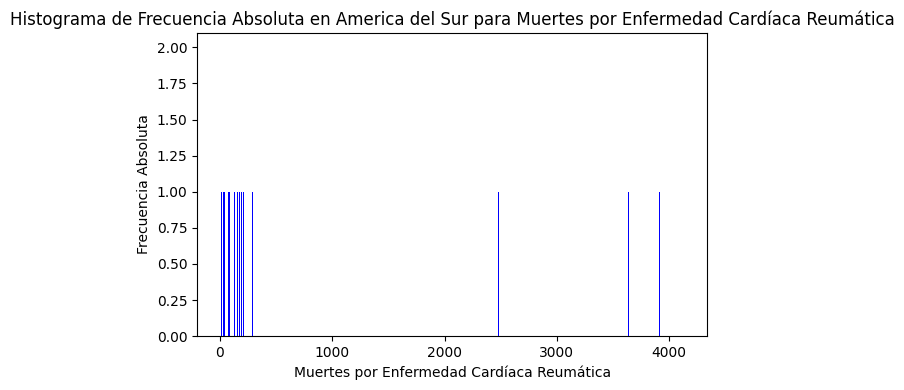

La Frecuencia Absoluta por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
20.020       1
22.010       1
22.270       1
22.530       1
22.800       1
            ..
26624.418    1
26991.300    1
27016.250    1
27413.060    1
28142.750    1
Name: count, Length: 260, dtype: int64
------------------------------------------------------------------------------------------


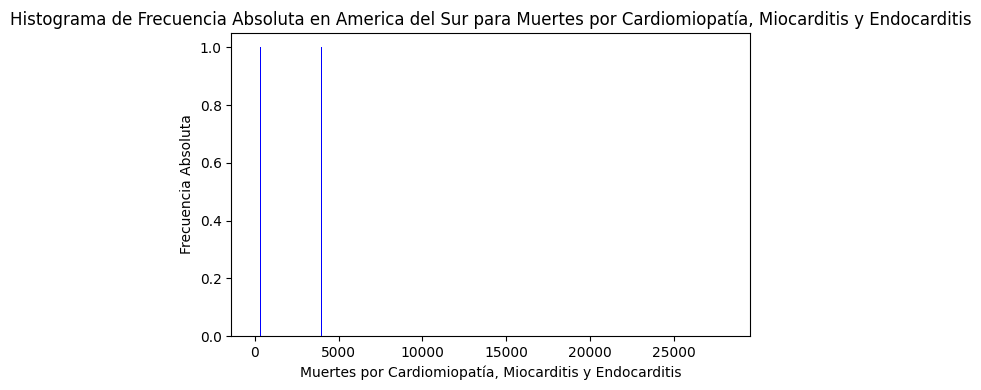

La Frecuencia Absoluta por Muertes por Enfermedades Circulatorias es:
Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
39.040       1
42.550       1
43.990       1
44.420       1
44.730       1
            ..
71430.110    1
74907.460    1
76301.810    1
78637.980    1
79477.734    1
Name: count, Length: 260, dtype: int64
------------------------------------------------------------------------------------------


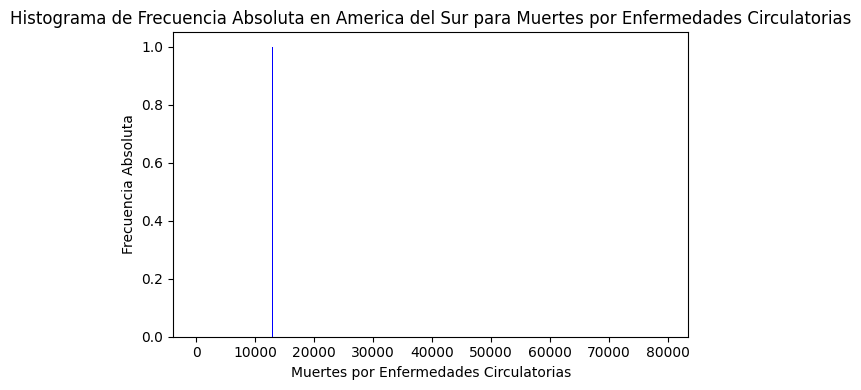

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Hipertensiva es:
Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
70.750       1
75.000       1
77.250       1
77.940       1
77.950       1
            ..
51390.860    1
53653.867    1
57164.020    1
57523.770    1
57549.332    1
Name: count, Length: 260, dtype: int64
------------------------------------------------------------------------------------------


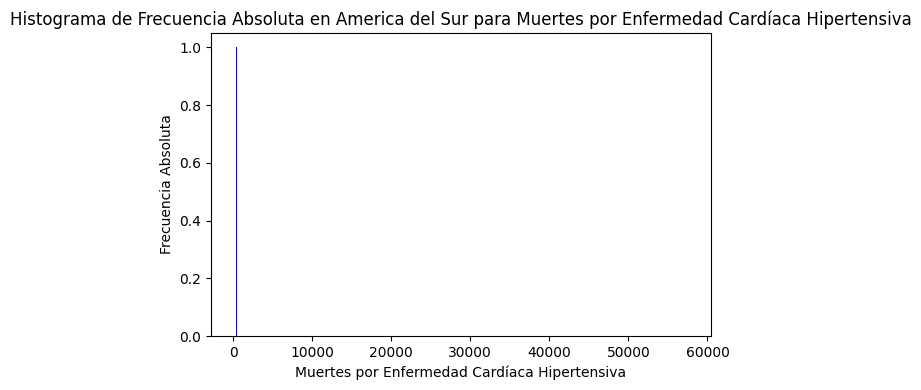

La Frecuencia Absoluta por Muertes por Ictus Isquémico es:
Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
159.000       1
173.220       1
174.700       1
175.140       1
177.390       1
             ..
111461.516    1
112430.830    1
113697.450    1
113910.890    1
116831.370    1
Name: count, Length: 260, dtype: int64
------------------------------------------------------------------------------------------


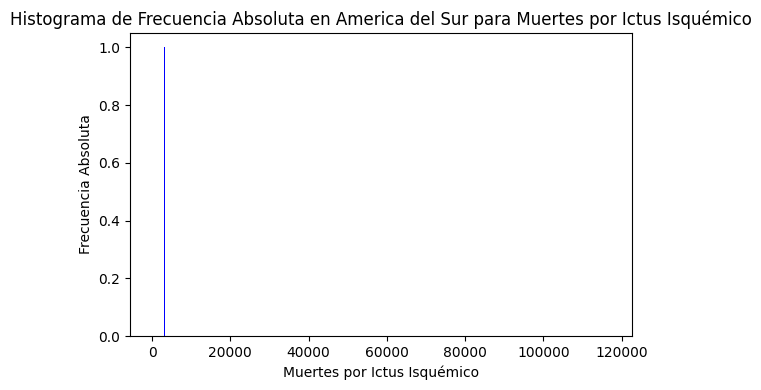

La Frecuencia Absoluta por Muertes por Ictus Hemorrágico es:
Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
243.940      1
246.690      1
248.580      1
251.130      1
254.770      1
            ..
93601.140    1
94716.630    1
94762.350    1
95542.016    1
95568.690    1
Name: count, Length: 260, dtype: int64
------------------------------------------------------------------------------------------


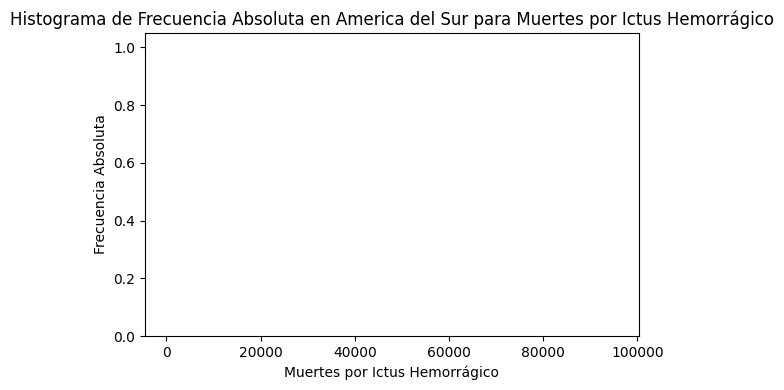

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Isquémica es:
Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
383.98       1
401.88       1
401.98       1
402.35       1
403.00       1
            ..
319031.44    1
329473.50    1
332213.12    1
333533.47    1
340410.97    1
Name: count, Length: 260, dtype: int64
------------------------------------------------------------------------------------------


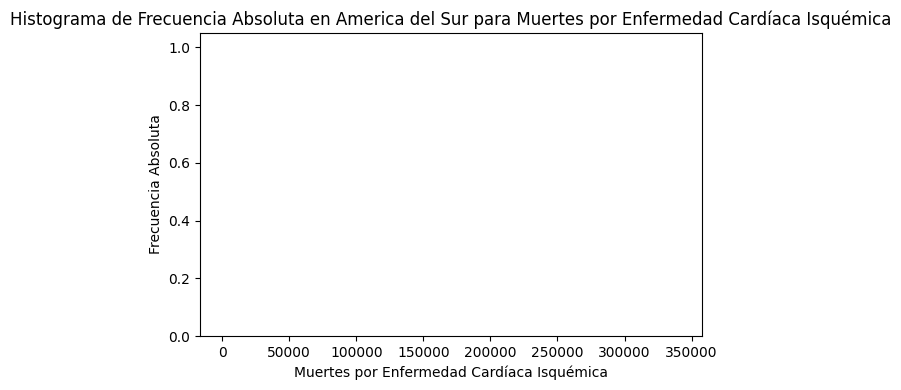

Frecuencia Absoluta de Muertes por Enfermedades Cardiovasculares en Asia
La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Reumática es:
Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
2.38         1
3.11         1
3.19         1
3.22         1
3.25         1
            ..
266637.30    1
272691.47    1
276988.28    1
279125.80    1
281037.22    1
Name: count, Length: 929, dtype: int64
------------------------------------------------------------------------------------------


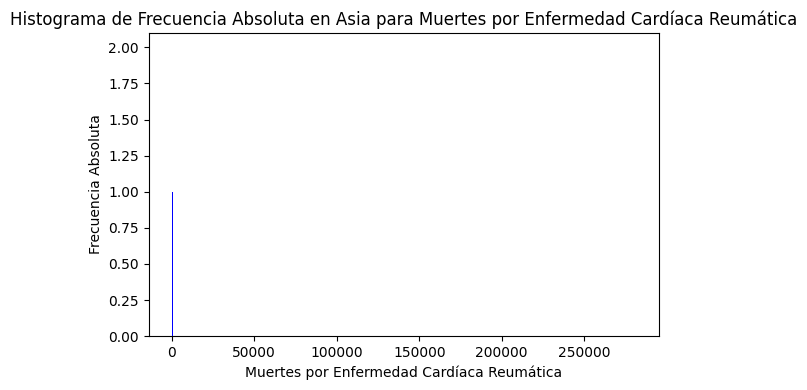

La Frecuencia Absoluta por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
3.460        1
3.530        1
3.620        1
3.740        1
3.810        1
            ..
91913.340    1
93881.290    1
95387.130    1
96893.984    1
98310.586    1
Name: count, Length: 936, dtype: int64
------------------------------------------------------------------------------------------


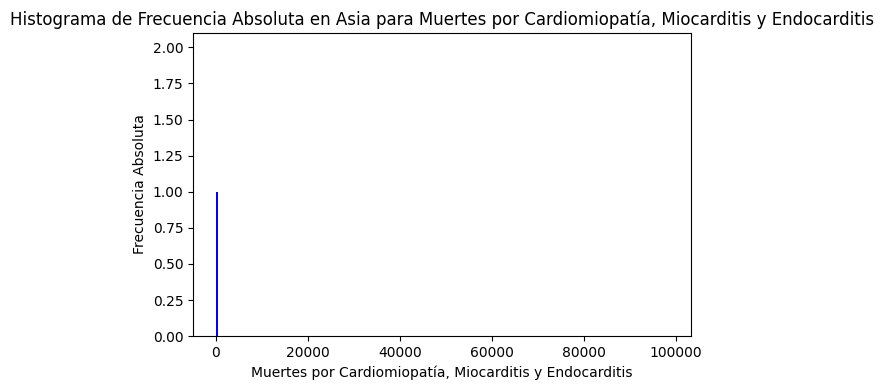

La Frecuencia Absoluta por Muertes por Enfermedades Circulatorias es:
Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
14.65        1
15.01        1
15.14        1
16.58        1
16.94        1
            ..
327228.03    1
343853.56    1
360083.22    1
371115.75    1
379218.47    1
Name: count, Length: 938, dtype: int64
------------------------------------------------------------------------------------------


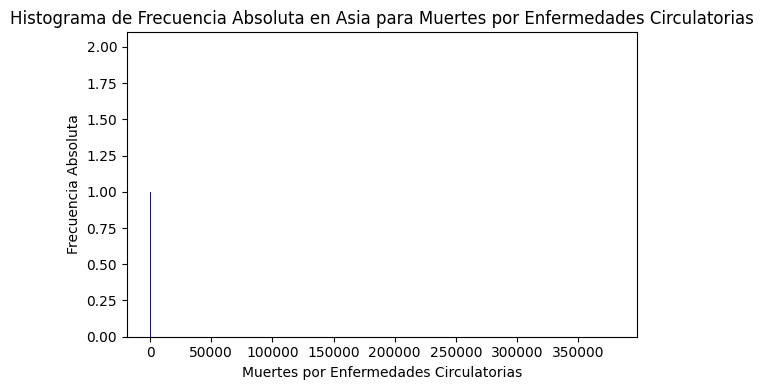

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Hipertensiva es:
Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
9.49         1
9.69         1
9.99         1
10.55        1
10.64        1
            ..
597123.10    1
622403.56    1
640159.70    1
649710.44    1
658448.20    1
Name: count, Length: 938, dtype: int64
------------------------------------------------------------------------------------------


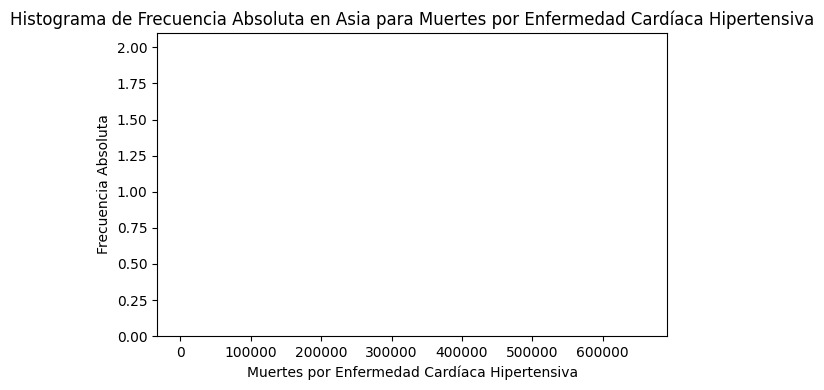

La Frecuencia Absoluta por Muertes por Ictus Isquémico es:
Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
37.77         1
38.82         1
40.51         1
43.64         1
44.21         1
             ..
1689184.90    1
1755075.80    1
1817979.50    1
1869142.00    1
1917909.50    1
Name: count, Length: 939, dtype: int64
------------------------------------------------------------------------------------------


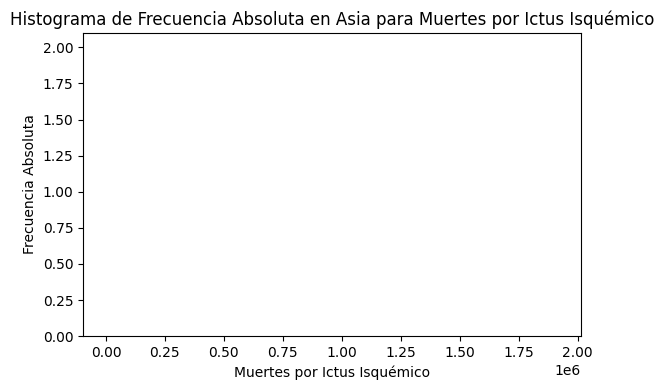

La Frecuencia Absoluta por Muertes por Ictus Hemorrágico es:
Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
52.96         1
54.13         1
54.68         1
54.86         1
56.49         1
             ..
2281280.50    1
2284003.20    1
2288032.20    1
2297081.50    1
2330634.00    1
Name: count, Length: 939, dtype: int64
------------------------------------------------------------------------------------------


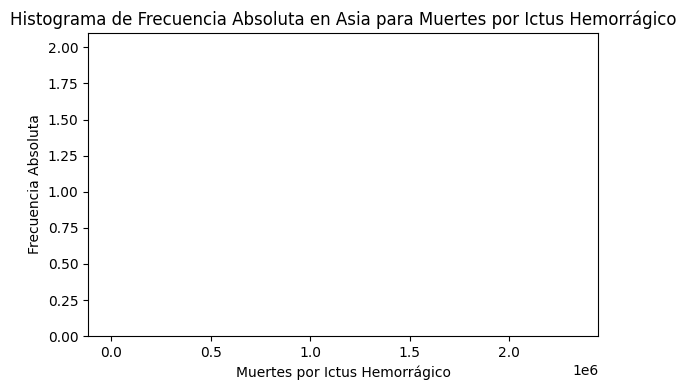

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Isquémica es:
Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
171.95        1
184.02        1
202.40        1
202.80        1
203.36        1
             ..
4601395.00    1
4752694.00    1
4888440.50    1
5021420.50    1
5125233.50    1
Name: count, Length: 940, dtype: int64
------------------------------------------------------------------------------------------


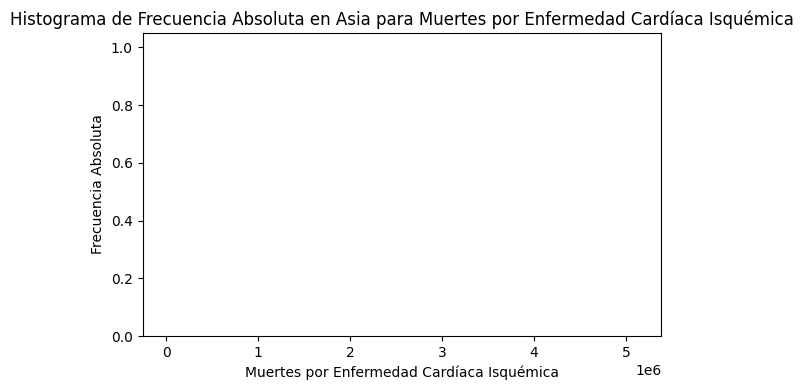

Frecuencia Absoluta de Muertes por Enfermedades Cardiovasculares en Europa
La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Reumática es:
Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
0.34        1
0.67        1
0.69        1
0.73        1
1.02        1
           ..
23340.59    1
24811.98    1
24997.32    1
25336.74    1
26909.65    1
Name: count, Length: 783, dtype: int64
------------------------------------------------------------------------------------------


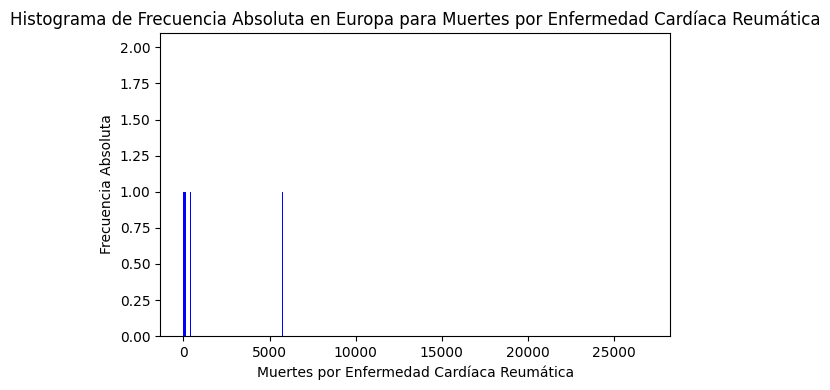

La Frecuencia Absoluta por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
6.19         1
6.83         1
6.92         1
7.21         1
7.30         1
            ..
166977.55    1
171847.36    1
172127.72    1
172340.02    1
176270.03    1
Name: count, Length: 799, dtype: int64
------------------------------------------------------------------------------------------


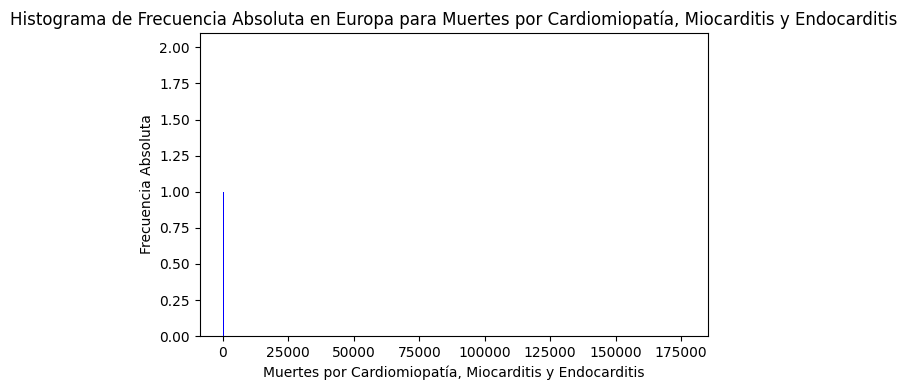

La Frecuencia Absoluta por Muertes por Enfermedades Circulatorias es:
Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
53.46        1
55.33        1
56.65        1
61.20        1
68.59        1
            ..
304621.84    1
315382.03    1
319021.90    1
325365.20    1
325785.25    1
Name: count, Length: 797, dtype: int64
------------------------------------------------------------------------------------------


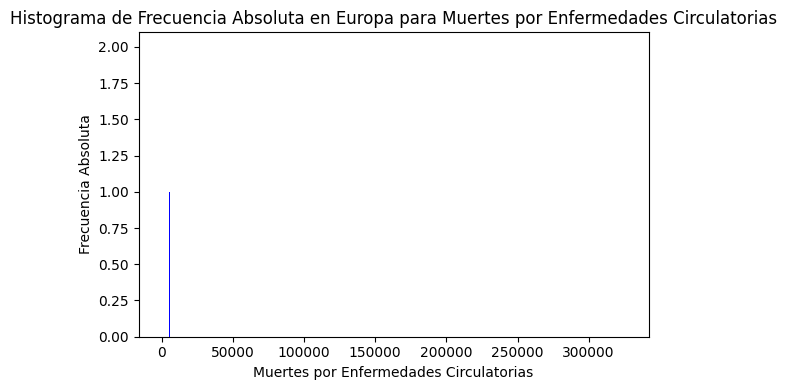

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Hipertensiva es:
Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
12.46        1
13.31        1
13.50        1
14.49        1
15.09        1
            ..
160819.80    1
168651.89    1
170222.22    1
175557.06    1
176734.75    1
Name: count, Length: 799, dtype: int64
------------------------------------------------------------------------------------------


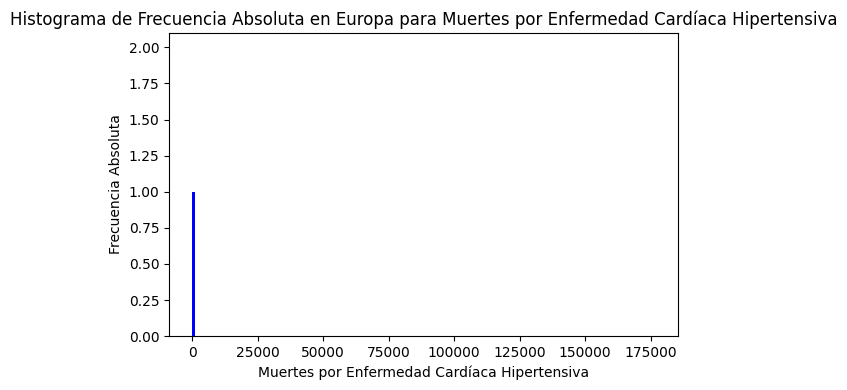

La Frecuencia Absoluta por Muertes por Ictus Isquémico es:
Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
90.46        1
92.35        1
93.40        1
93.75        1
94.13        1
            ..
875105.30    1
910014.50    1
913928.06    1
928153.30    1
940375.40    1
Name: count, Length: 799, dtype: int64
------------------------------------------------------------------------------------------


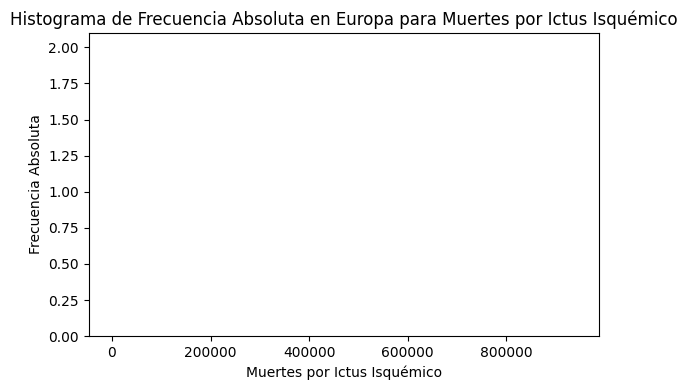

La Frecuencia Absoluta por Muertes por Ictus Hemorrágico es:
Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
44.20        1
45.08        1
45.11        1
46.46        1
47.10        1
            ..
346032.97    1
356016.20    1
356654.03    1
362487.20    1
365019.06    1
Name: count, Length: 800, dtype: int64
------------------------------------------------------------------------------------------


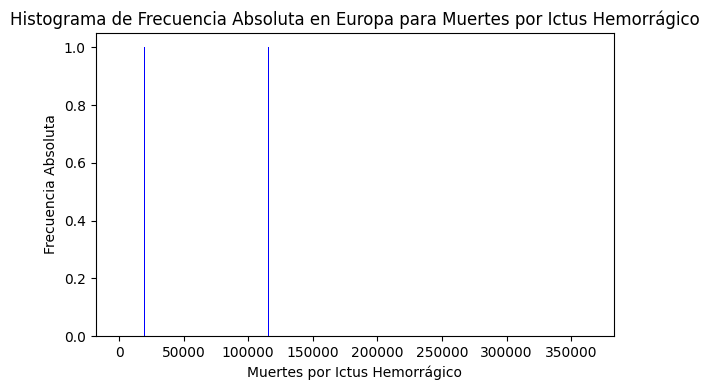

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Isquémica es:
Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
403.43        1
403.83        1
414.61        1
417.13        1
423.04        1
             ..
2299962.00    1
2305014.80    1
2316179.80    1
2367026.00    1
2416414.50    1
Name: count, Length: 800, dtype: int64
------------------------------------------------------------------------------------------


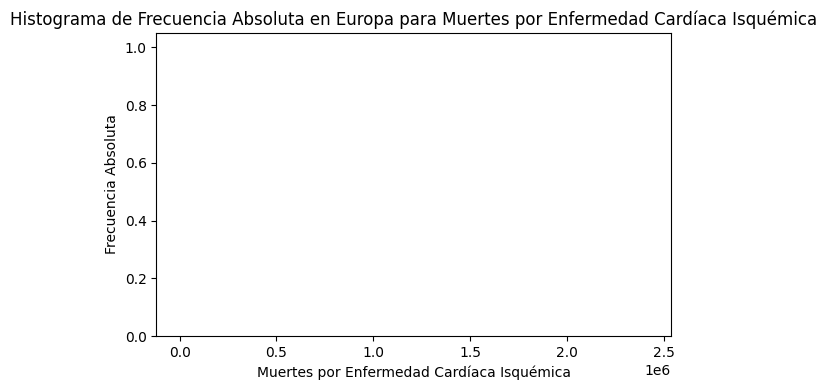

Frecuencia Absoluta de Muertes por Enfermedades Cardiovasculares en Oceania
La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Reumática es:
Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
2.1400       1
2.2500       1
2.3300       1
2.3400       1
2.4800       1
            ..
1724.2600    1
1734.3500    1
1745.1799    1
1764.5901    1
1767.6799    1
Name: count, Length: 214, dtype: int64
------------------------------------------------------------------------------------------


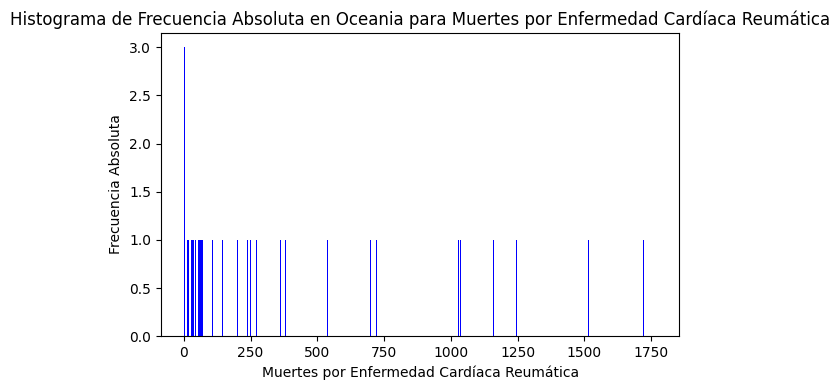

La Frecuencia Absoluta por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
1.9100       1
1.9700       1
2.0100       2
2.0600       1
2.0800       1
            ..
2158.4200    1
2209.4700    1
2217.0200    1
2259.8198    1
2260.2600    1
Name: count, Length: 212, dtype: int64
------------------------------------------------------------------------------------------


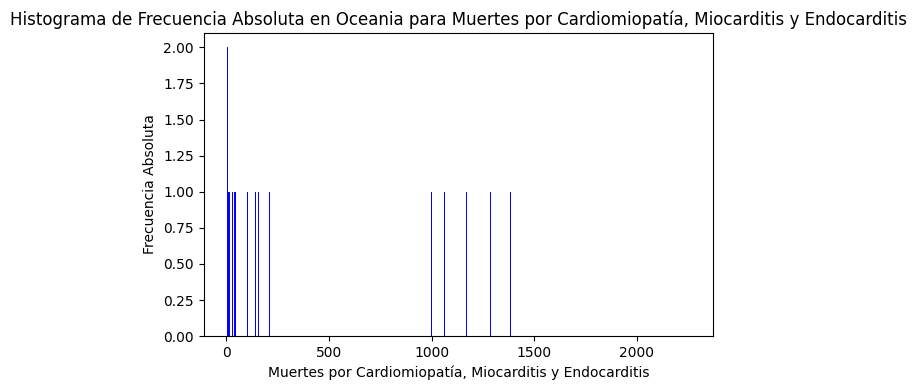

La Frecuencia Absoluta por Muertes por Enfermedades Circulatorias es:
Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
6.580       2
6.720       1
6.770       1
6.860       1
6.940       1
           ..
9001.080    1
9172.710    1
9230.550    1
9283.910    1
9288.359    1
Name: count, Length: 216, dtype: int64
------------------------------------------------------------------------------------------


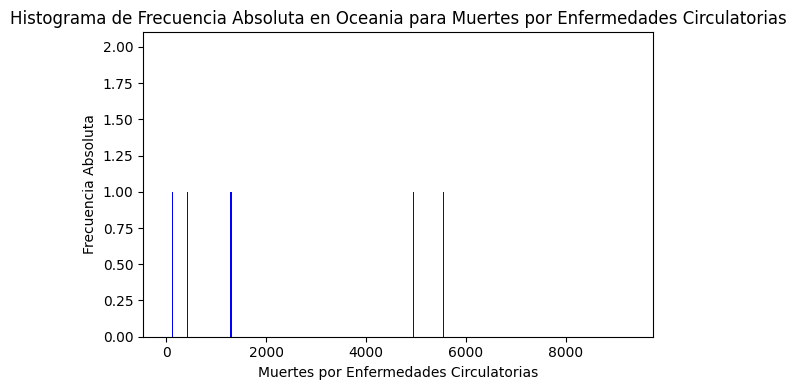

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Hipertensiva es:
Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
4.9300       1
4.9600       1
5.0600       2
5.1100       1
5.1200       1
            ..
3339.2000    1
3371.0498    1
3422.6500    1
3448.7200    1
3514.5898    1
Name: count, Length: 216, dtype: int64
------------------------------------------------------------------------------------------


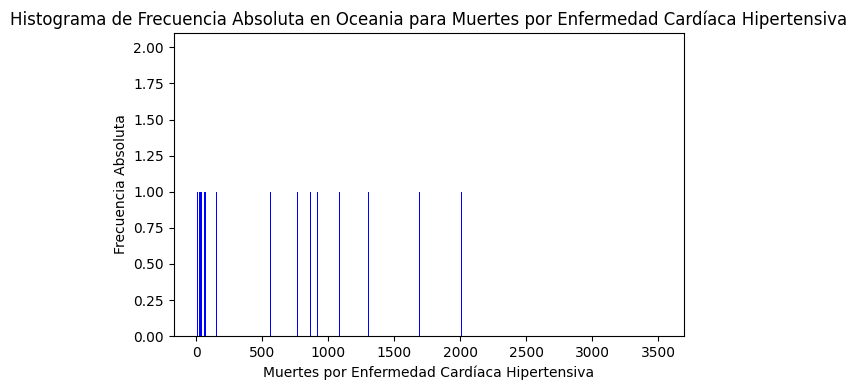

La Frecuencia Absoluta por Muertes por Ictus Isquémico es:
Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
15.390       1
15.440       1
15.750       1
16.010       1
16.110       2
            ..
10922.420    1
10941.430    1
10976.090    1
10980.591    1
11172.591    1
Name: count, Length: 218, dtype: int64
------------------------------------------------------------------------------------------


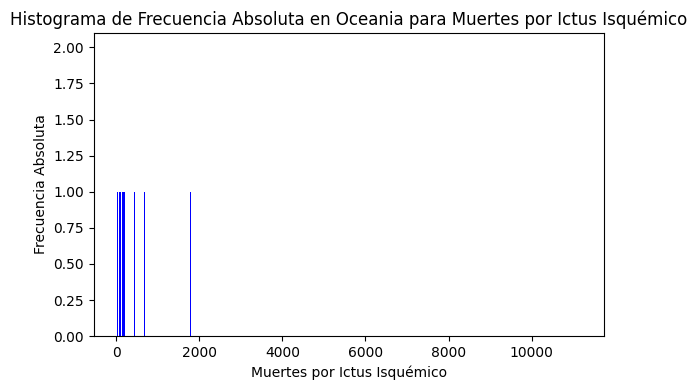

La Frecuencia Absoluta por Muertes por Ictus Hemorrágico es:
Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
29.75       1
30.20       1
31.04       1
31.14       1
31.16       1
           ..
9836.74     1
9919.37     1
9923.87     1
9977.64     1
10107.84    1
Name: count, Length: 219, dtype: int64
------------------------------------------------------------------------------------------


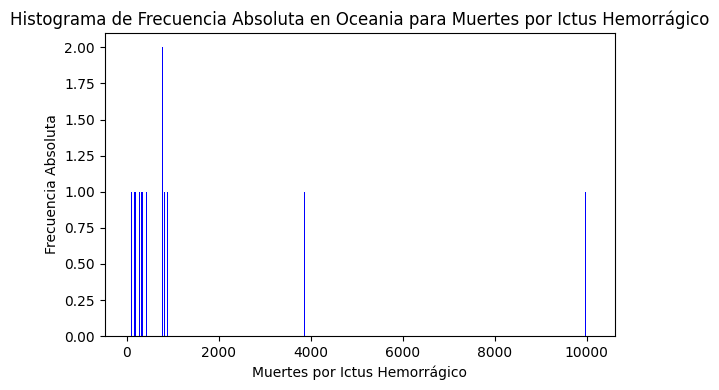

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Isquémica es:
Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
75.770       1
77.500       1
78.790       1
79.220       1
80.130       1
            ..
39865.652    1
40163.850    1
40346.000    1
40530.190    1
40673.220    1
Name: count, Length: 220, dtype: int64
------------------------------------------------------------------------------------------


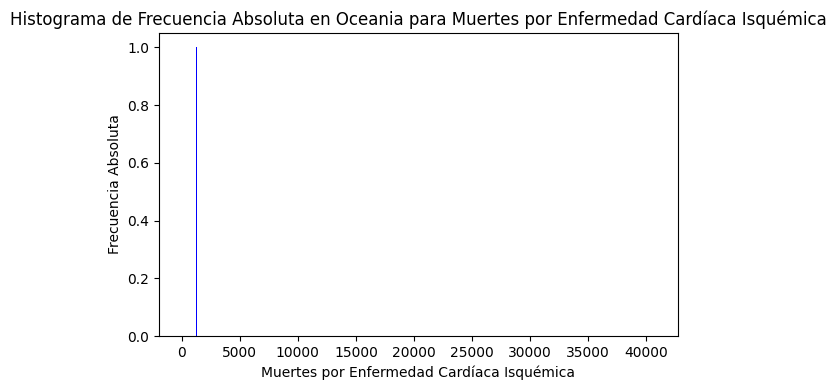

In [25]:
# Definir una función para calcular la frecuencia absoluta de una patología en un DataFrame dado
def calcular_frecuencia_absoluta(df, patologia):
    data_patologia = df[patologia]  # Obtener los datos de la patología específica
    return data_patologia.value_counts().sort_index()  # Calcular y ordenar la frecuencia absoluta por valor

# Iterar sobre cada continente y sus respectivos países
for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]  # Filtrar el DataFrame por los países del continente actual
    print(f"Frecuencia Absoluta de Muertes por Enfermedades Cardiovasculares en {continente}")

    # Iterar sobre cada patología para calcular y mostrar la frecuencia absoluta
    for patologia in patologias:
        Fabs = calcular_frecuencia_absoluta(df_continente, patologia)  # Calcular la frecuencia absoluta
        patologia_legible = reemplazar_texto(patologia)  # Obtener el nombre legible de la patología
        
        # Imprimir la frecuencia absoluta
        print(f"La Frecuencia Absoluta por {patologia_legible} es:\n{Fabs}")
        print("-" * 90)

        # Crear y mostrar el gráfico de histograma para la frecuencia absoluta
        plt.figure(figsize=(6, 4))
        bar_width = 10
        plt.bar(Fabs.index, Fabs.values, color='blue', alpha=1)
        plt.xlabel(f'{patologia_legible}')
        plt.ylabel('Frecuencia Absoluta')
        plt.title(f'Histograma de Frecuencia Absoluta en {continente} para {patologia_legible}')
        plt.xticks(rotation=0)
        plt.tight_layout()
        plt.show()

### Frecuencias Relativas

Frecuencias Relativa de muertes por Enfermedades Cardiovasculares en Africa:


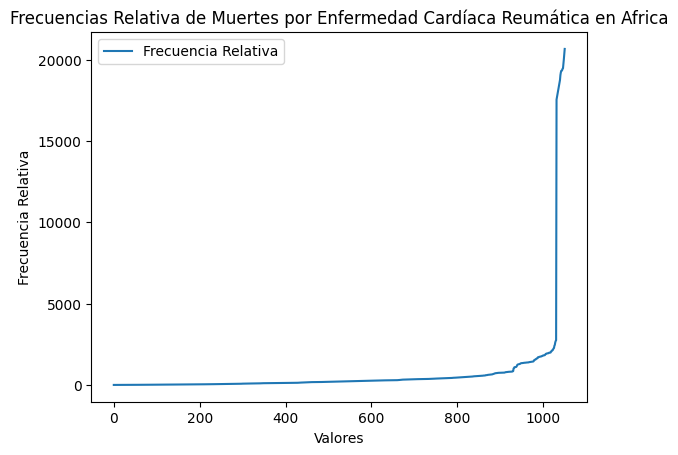

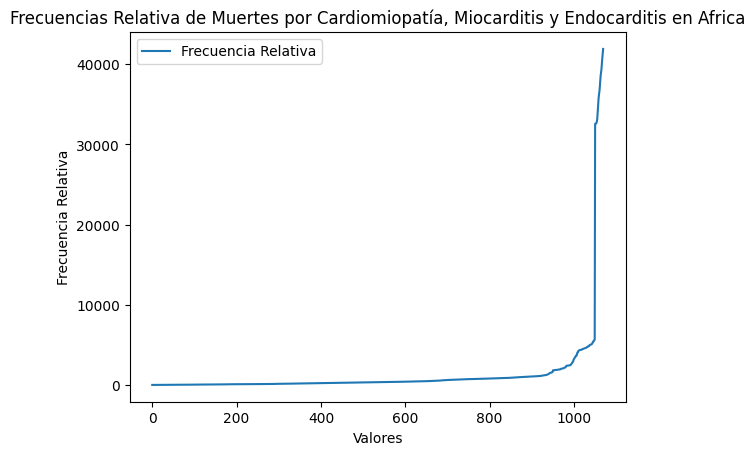

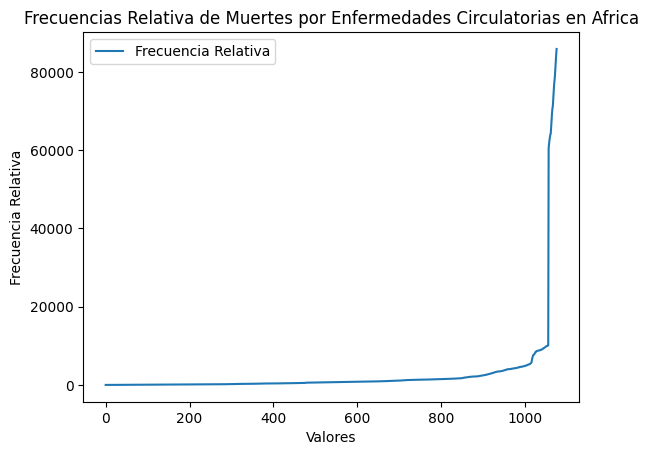

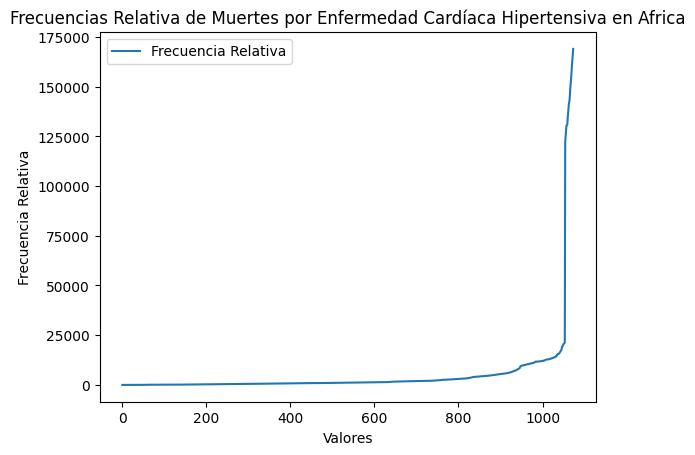

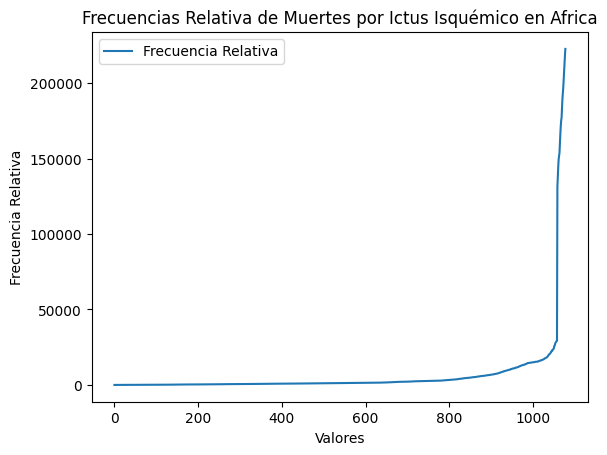

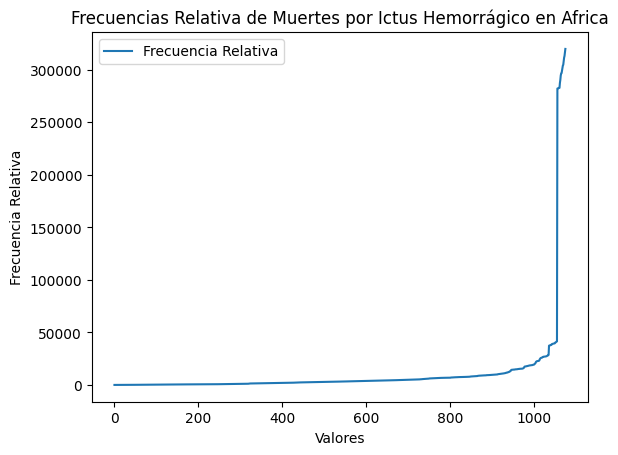

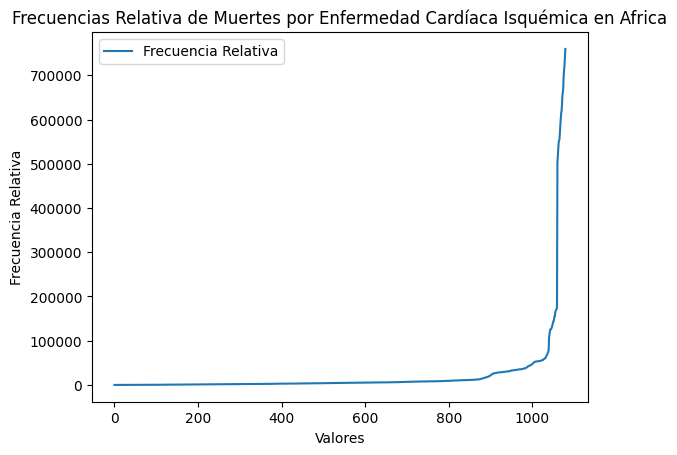

------------------------------------------------------------------------------------------
Frecuencias Relativa de muertes por Enfermedades Cardiovasculares en America del Norte:


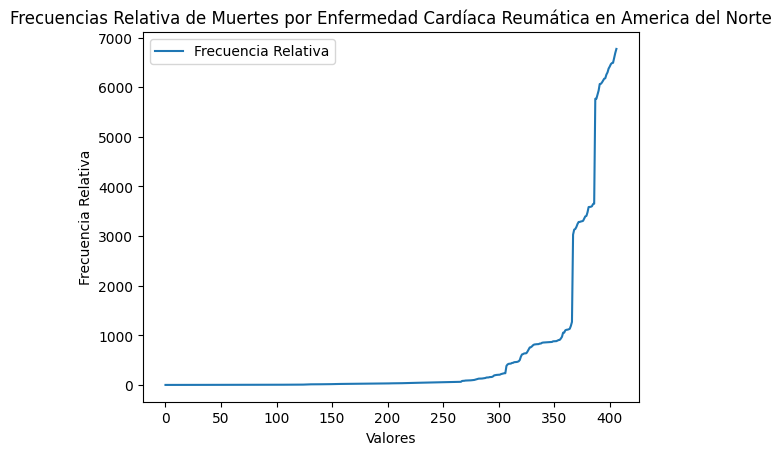

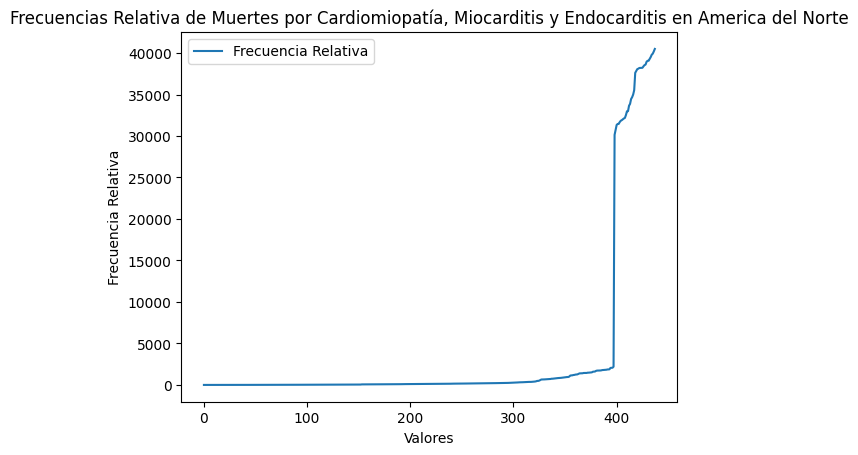

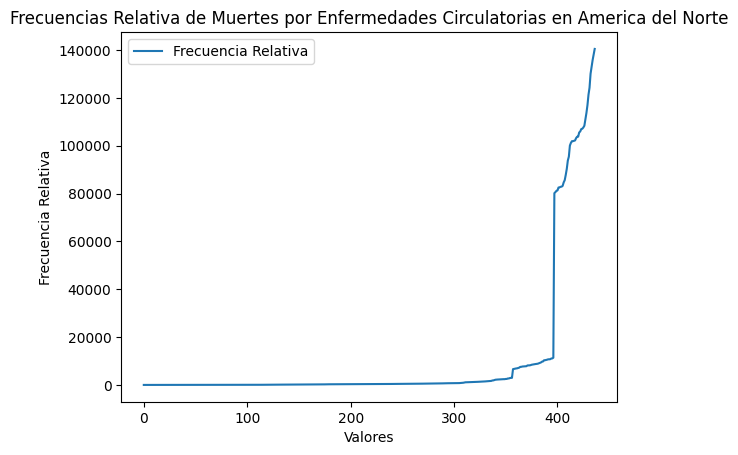

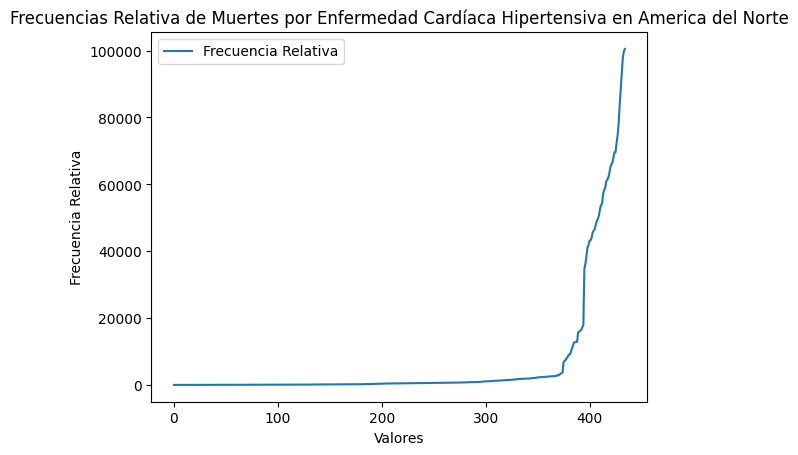

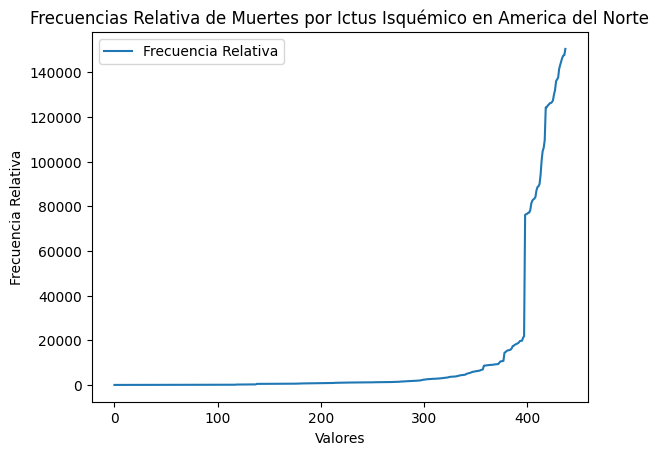

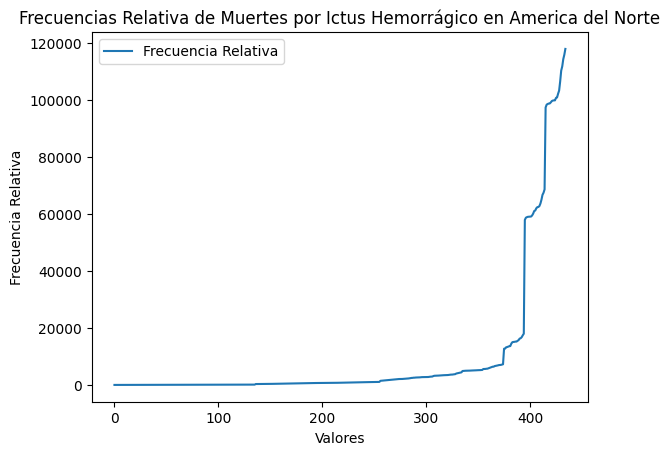

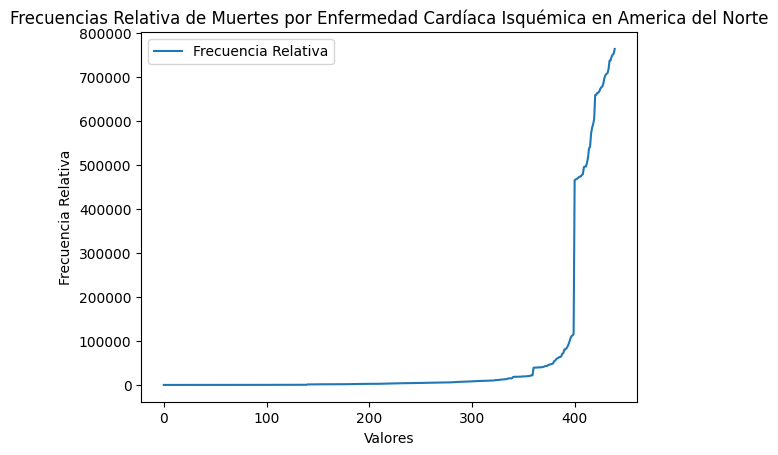

------------------------------------------------------------------------------------------
Frecuencias Relativa de muertes por Enfermedades Cardiovasculares en America del Sur:


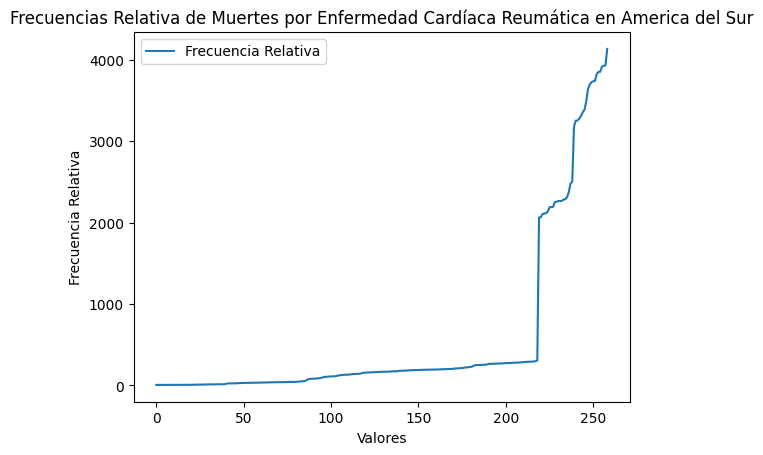

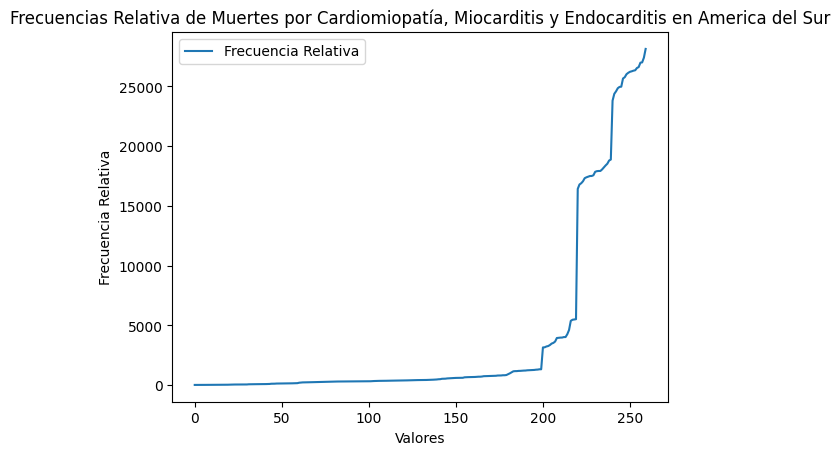

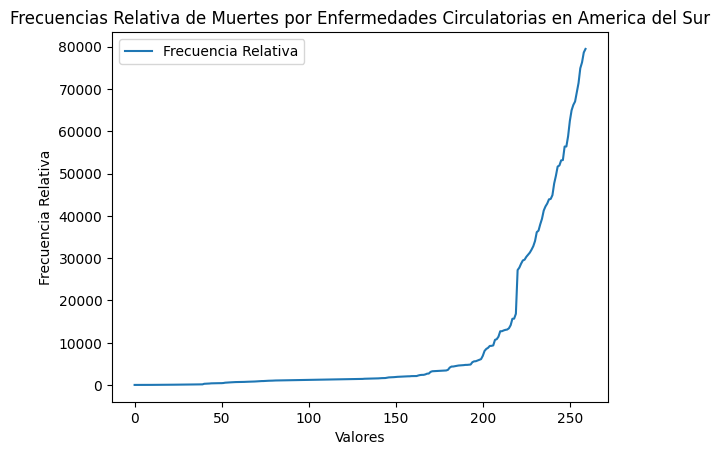

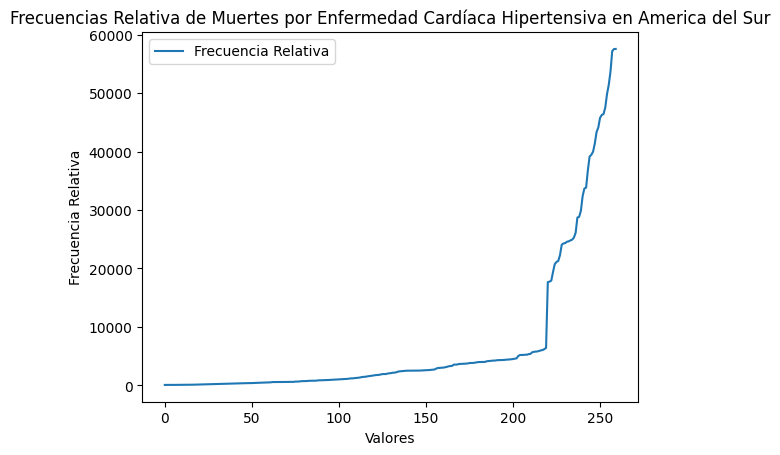

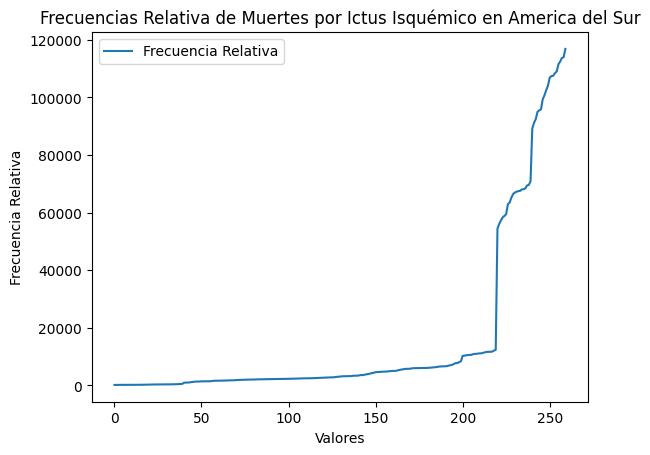

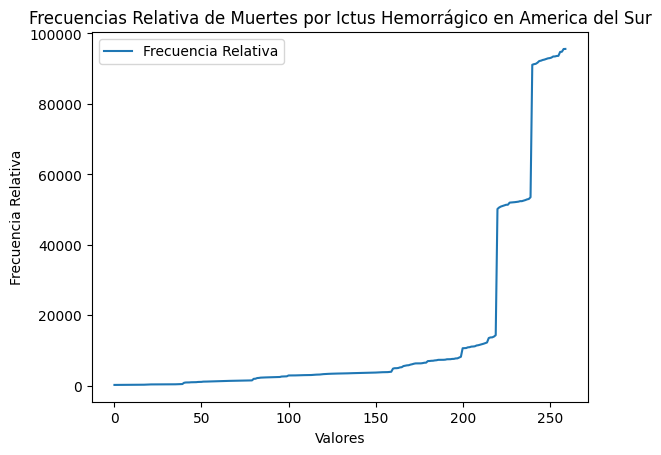

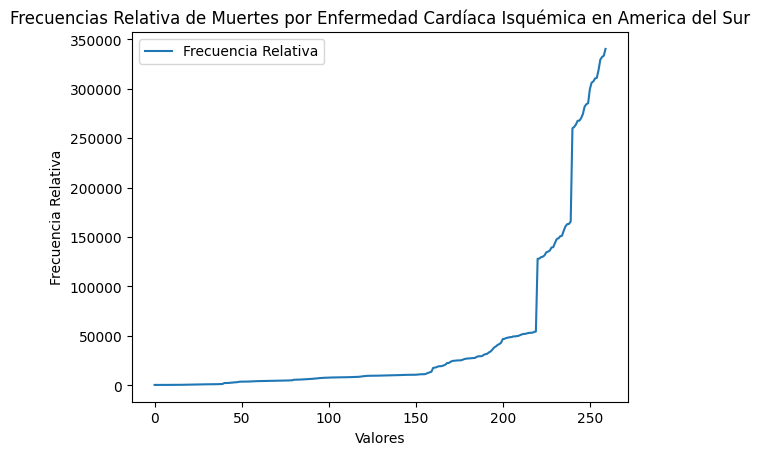

------------------------------------------------------------------------------------------
Frecuencias Relativa de muertes por Enfermedades Cardiovasculares en Asia:


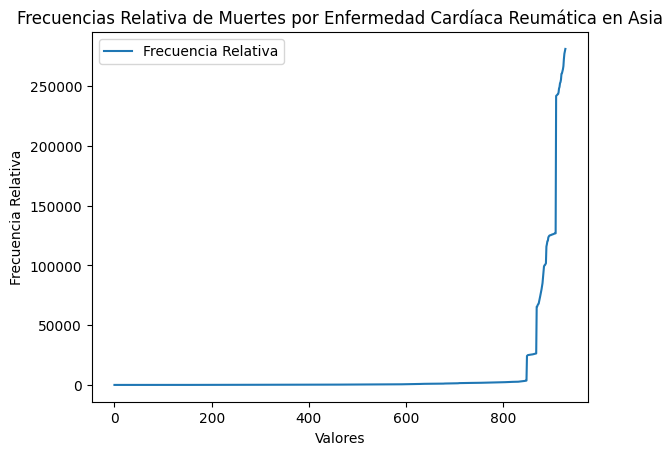

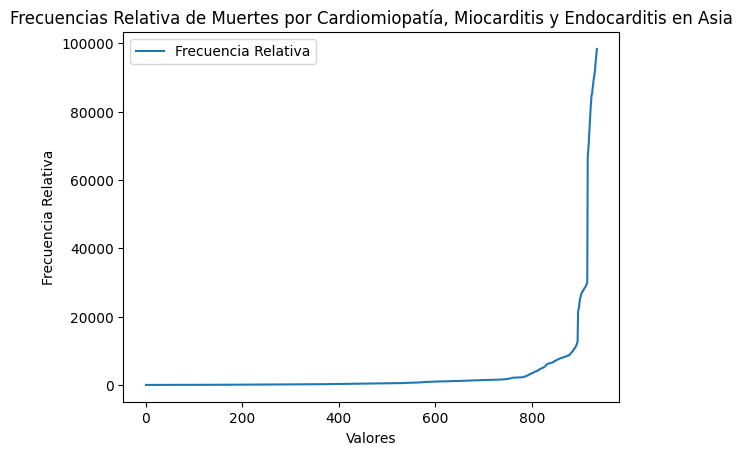

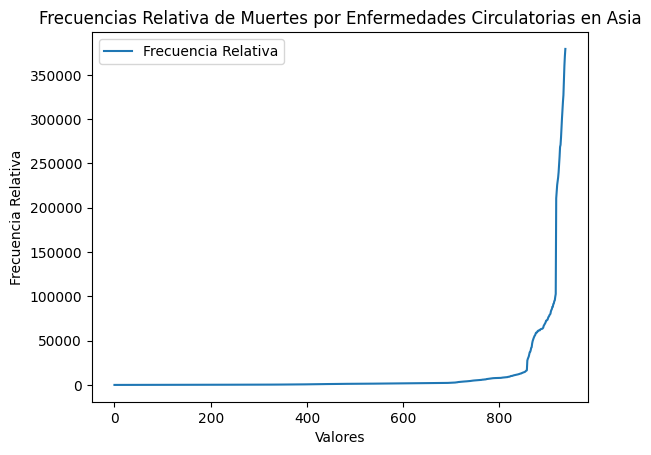

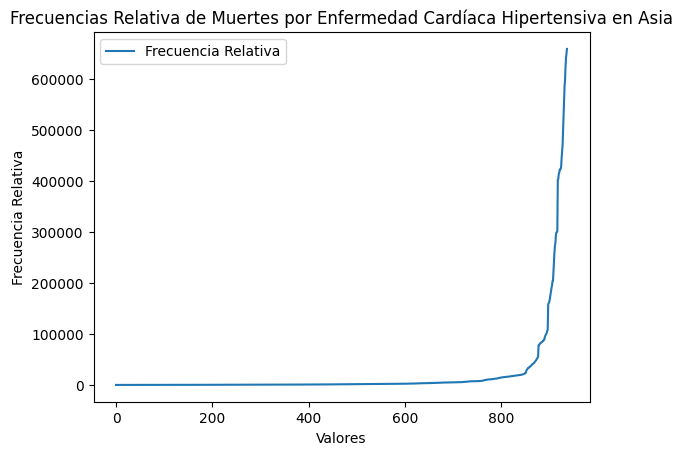

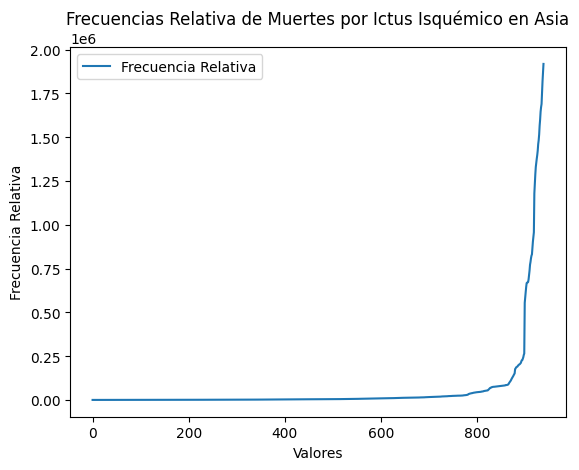

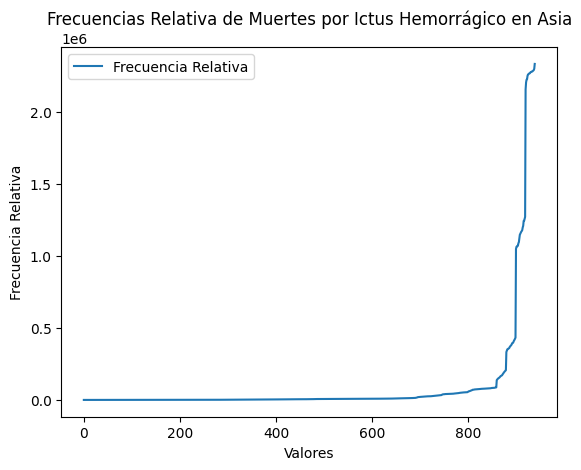

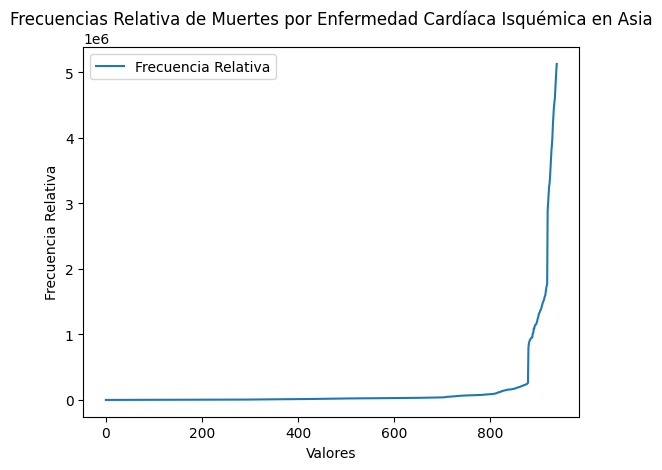

------------------------------------------------------------------------------------------
Frecuencias Relativa de muertes por Enfermedades Cardiovasculares en Europa:


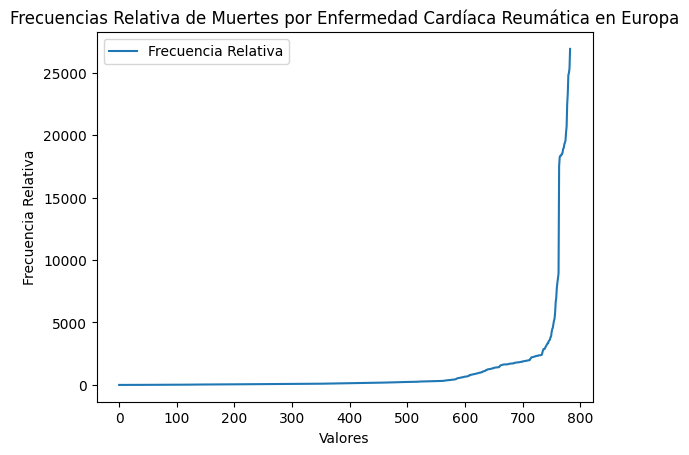

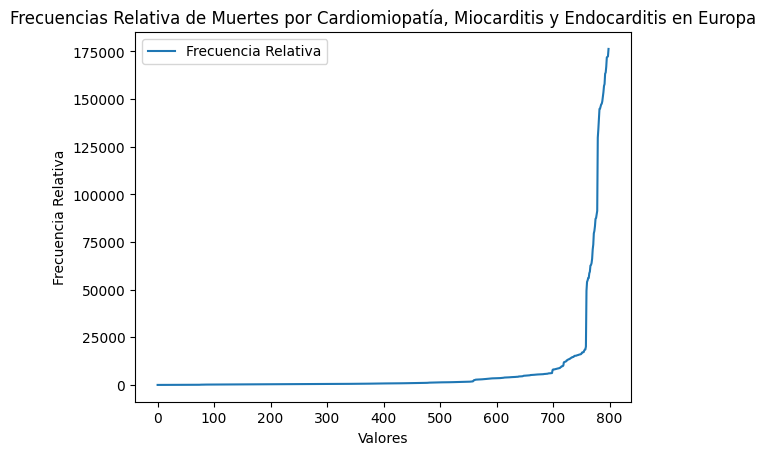

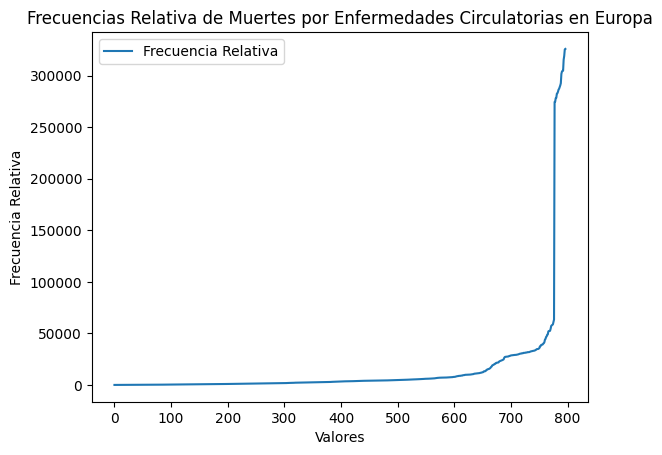

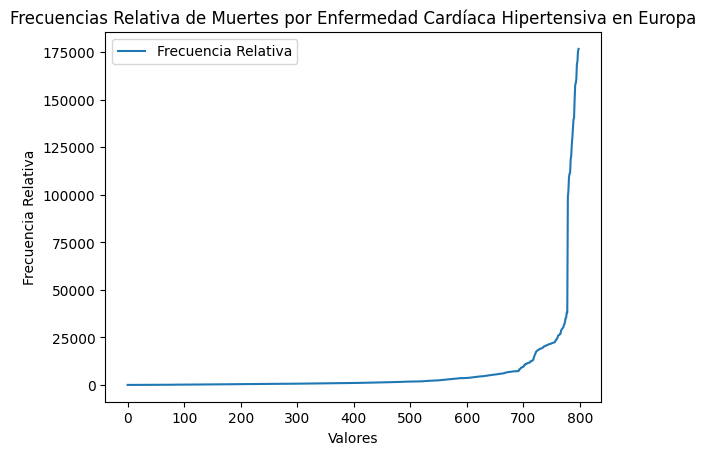

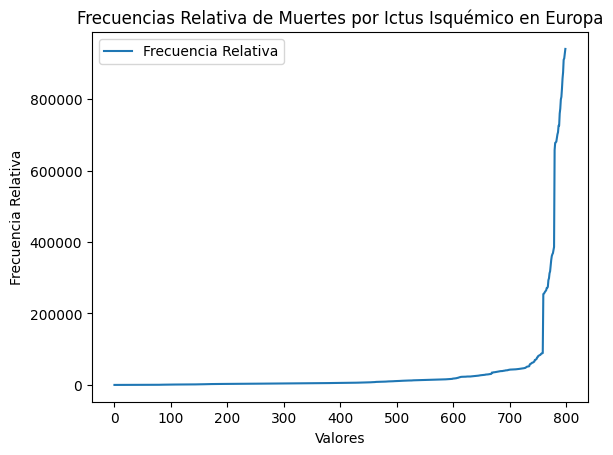

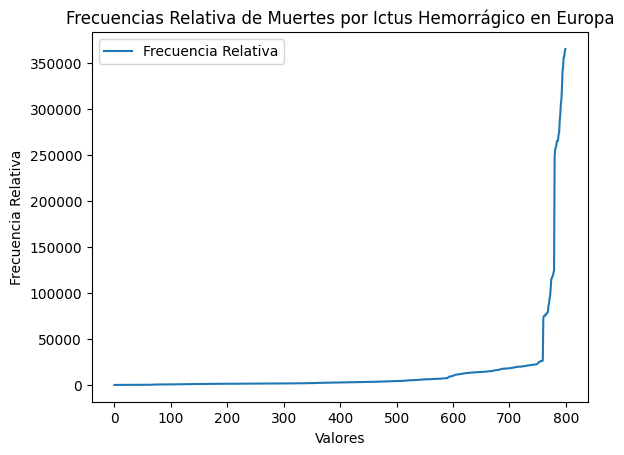

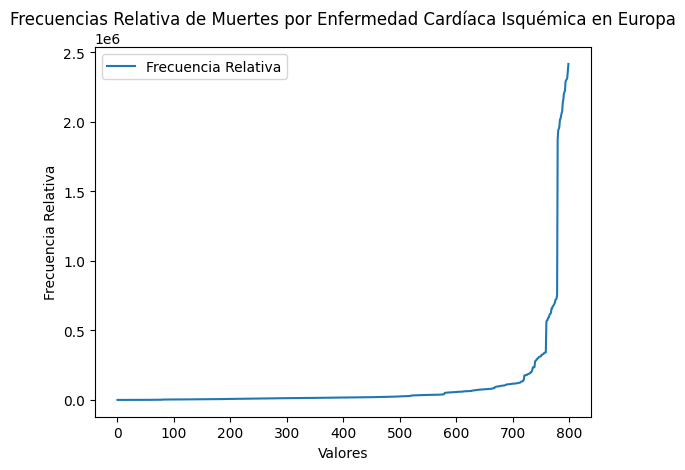

------------------------------------------------------------------------------------------
Frecuencias Relativa de muertes por Enfermedades Cardiovasculares en Oceania:


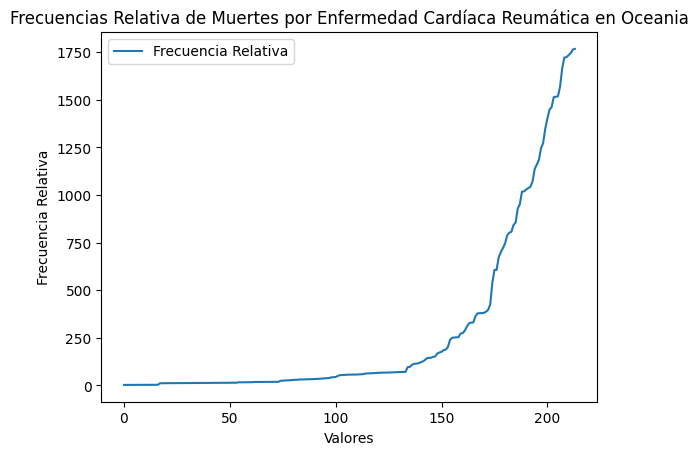

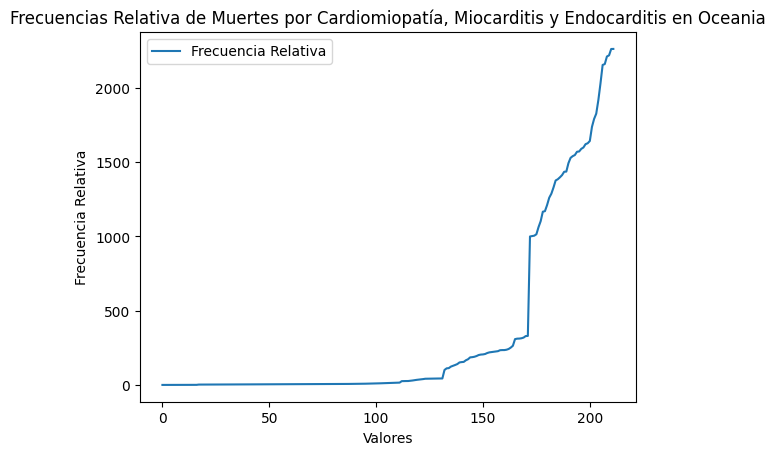

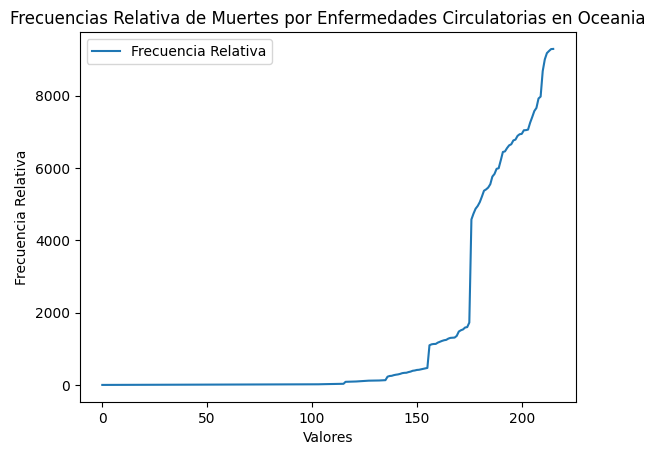

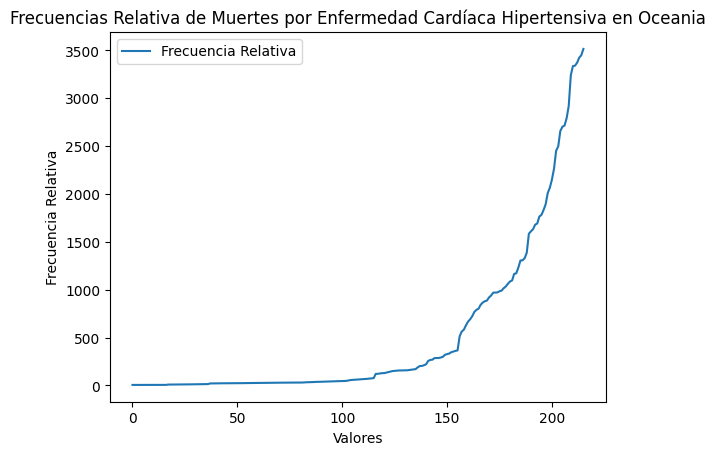

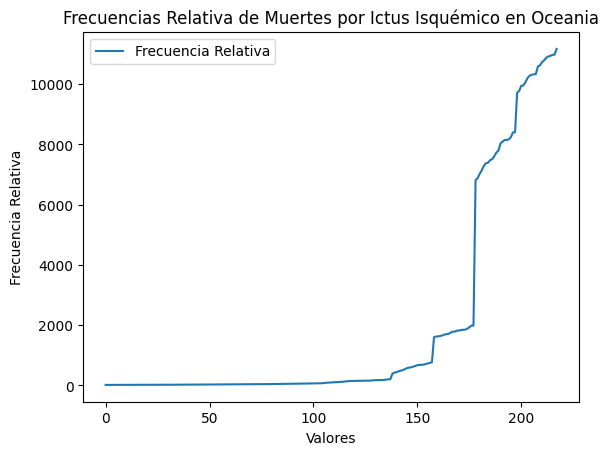

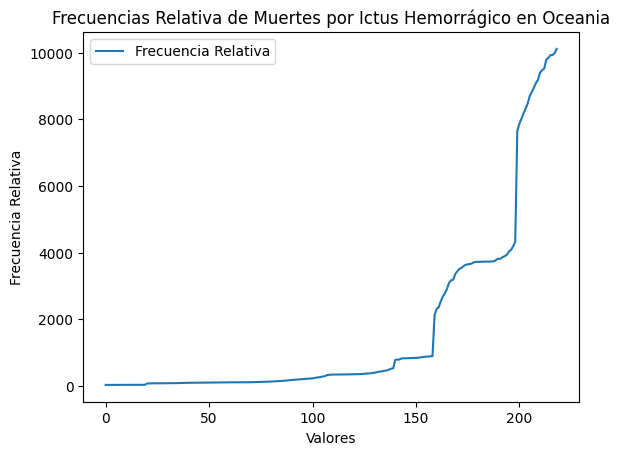

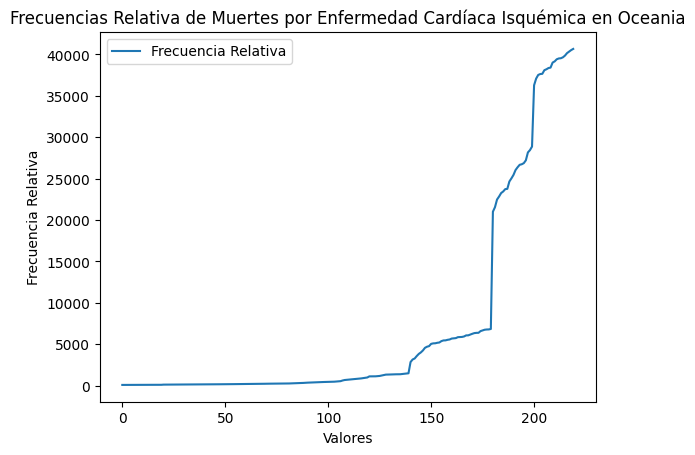

------------------------------------------------------------------------------------------


In [26]:
# Definir una función para calcular la frecuencia absoluta de una serie de datos
def calcular_frecuencia_absoluta(data):
    return data.value_counts().sort_index()

# Lista para almacenar los resultados
resultados = []

# Iterar sobre cada continente y sus respectivos países
for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]  # Filtrar el DataFrame por los países del continente actual
    print(f"Frecuencias Relativa de muertes por Enfermedades Cardiovasculares en {continente}:")

    # Iterar sobre cada patología para calcular y mostrar la frecuencia relativa
    for patologia in patologias:
        data_patologia = df_continente[patologia]  # Obtener los datos de la patología actual
        Fabs = calcular_frecuencia_absoluta(data_patologia)  # Calcular la frecuencia absoluta
        Frel = Fabs / len(data_patologia)  # Calcular la frecuencia relativa

        patologia_legible = reemplazar_texto(patologia)
        resultados.append({
            'Continente': continente,
            'Patologia': patologia_legible,
            'Frecuencia Relativa': Frel
        })

        # Crear y mostrar el gráfico de líneas para la frecuencia relativa
        plt.figure()
        plt.plot(Frel.index, label='Frecuencia Relativa')
        plt.title(f'Frecuencias Relativa de {patologia_legible} en {continente}')
        plt.xlabel('Valores')
        plt.ylabel('Frecuencia Relativa')
        plt.legend()
        plt.show()

    print("-" * 90)


### Frecuencias absolutas

Frecuencias Acumuladas de muertes por Enfermedades Cardiovasculares en Africa:
La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
0.84        1
0.85        2
0.86        3
0.87        2
0.88        1
           ..
19457.38    1
19723.10    1
20017.19    1
20340.27    1
20652.88    1
Name: count, Length: 1051, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
0.84        0.000926
0.85        0.001852
0.86        0.002778
0.87        0.001852
0.88        0.000926
              ...   
19457.38    0.000926
19723.10    0.000926
20017.19    0.000926
20340.27    0.000926
20652.88    0.000926
Name: count, Length: 1051, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age 

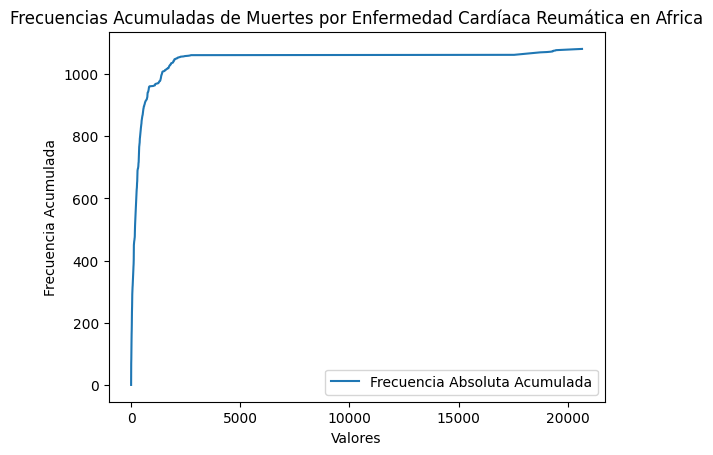

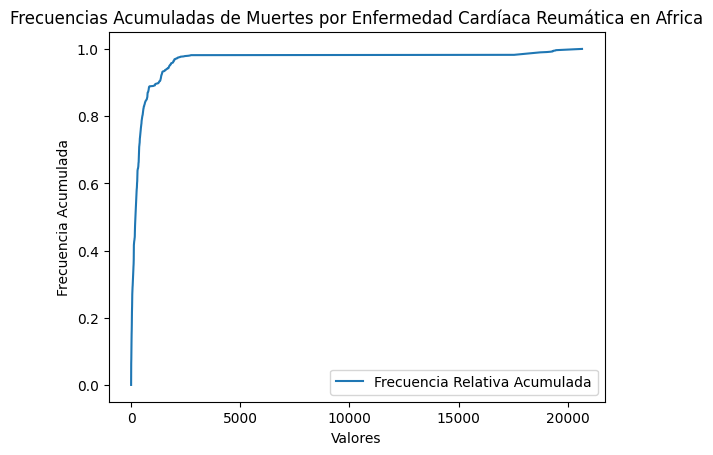

La Frecuencia Absoluta por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
3.590        1
3.790        1
3.950        1
4.140        1
4.260        1
            ..
39371.770    1
40136.400    1
40756.310    1
41414.742    1
41912.140    1
Name: count, Length: 1070, dtype: int64
La Frecuencia Relativa por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
3.590        0.000926
3.790        0.000926
3.950        0.000926
4.140        0.000926
4.260        0.000926
               ...   
39371.770    0.000926
40136.400    0.000926
40756.310    0.000926
41414.742    0.000926
41912.140    0.000926
Name: count, Length: 1070, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, e

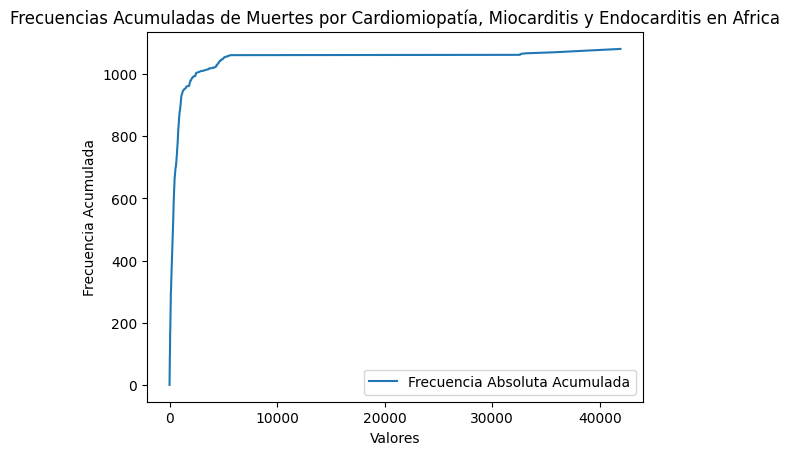

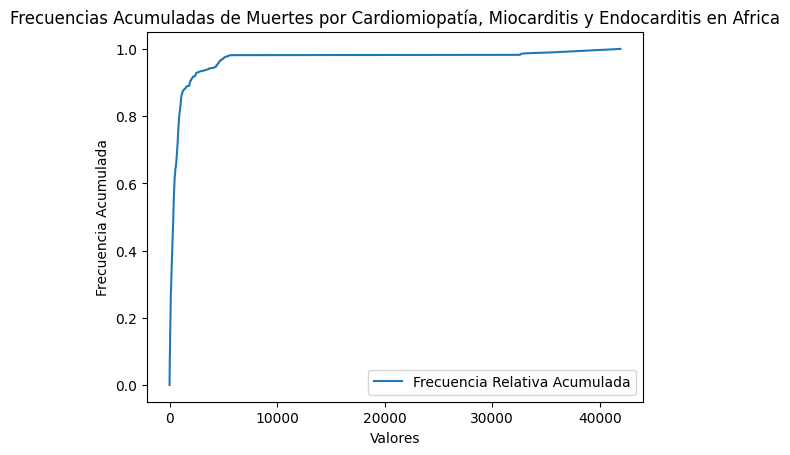

La Frecuencia Absoluta por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
7.84        1
8.01        1
8.30        1
8.67        1
8.79        1
           ..
79002.25    1
80907.11    1
82560.66    1
84386.80    1
85875.71    1
Name: count, Length: 1077, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
7.84        0.000926
8.01        0.000926
8.30        0.000926
8.67        0.000926
8.79        0.000926
              ...   
79002.25    0.000926
80907.11    0.000926
82560.66    0.000926
84386.80    0.000926
85875.71    0.000926
Name: count, Length: 1077, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
7.84           1
8.01           2
8.30           3
8.67         

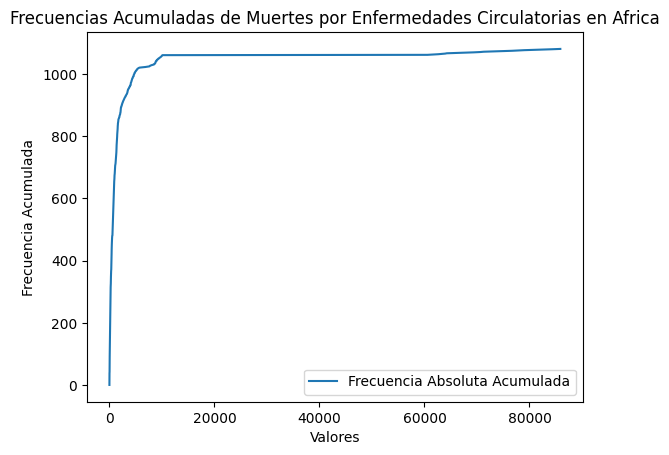

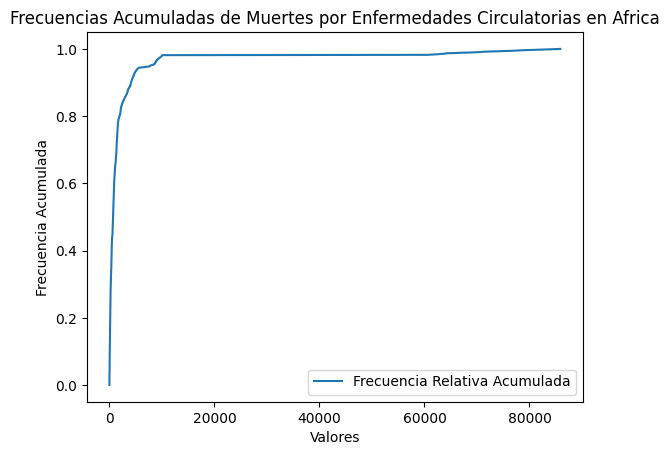

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
4.49         1
4.60         1
4.91         1
5.01         1
5.13         1
            ..
157492.22    1
160568.23    1
163145.42    1
166119.48    1
168953.52    1
Name: count, Length: 1074, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
4.49         0.000926
4.60         0.000926
4.91         0.000926
5.01         0.000926
5.13         0.000926
               ...   
157492.22    0.000926
160568.23    0.000926
163145.42    0.000926
166119.48    0.000926
168953.52    0.000926
Name: count, Length: 1074, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
4.49            1
4.60  

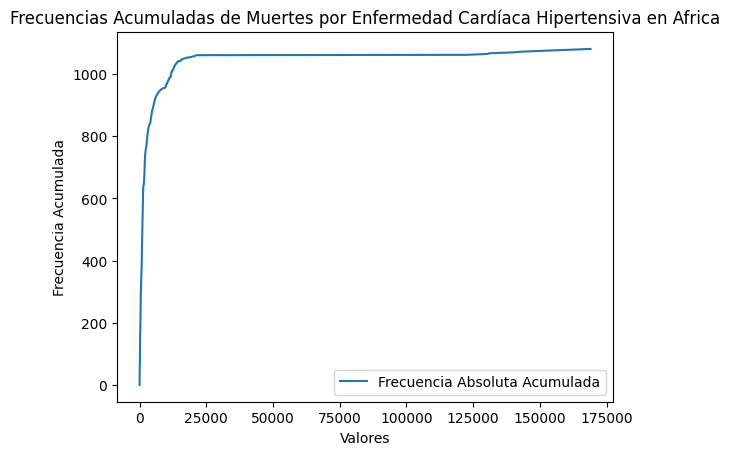

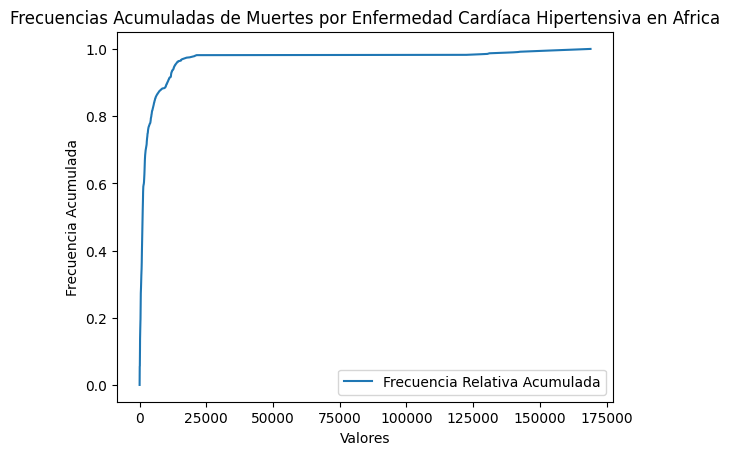

La Frecuencia Absoluta por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
20.72        1
21.32        1
21.41        1
22.23        1
22.44        1
            ..
202617.55    1
208114.31    1
212977.38    1
218254.10    1
222601.17    1
Name: count, Length: 1078, dtype: int64
La Frecuencia Relativa por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
20.72        0.000926
21.32        0.000926
21.41        0.000926
22.23        0.000926
22.44        0.000926
               ...   
202617.55    0.000926
208114.31    0.000926
212977.38    0.000926
218254.10    0.000926
222601.17    0.000926
Name: count, Length: 1078, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
20.72           1
21.32           2
21.41           3
22.23           4
22.44           5
             ..

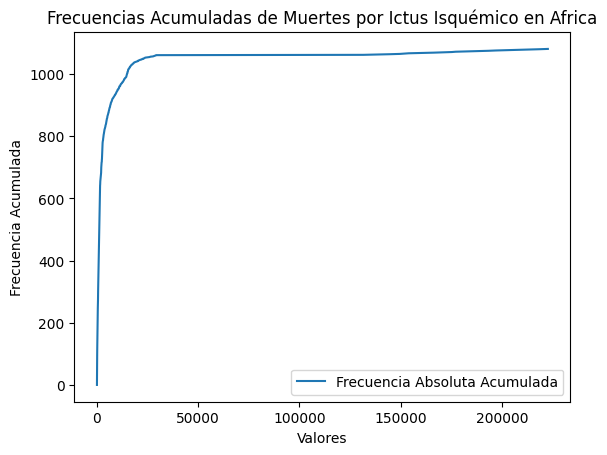

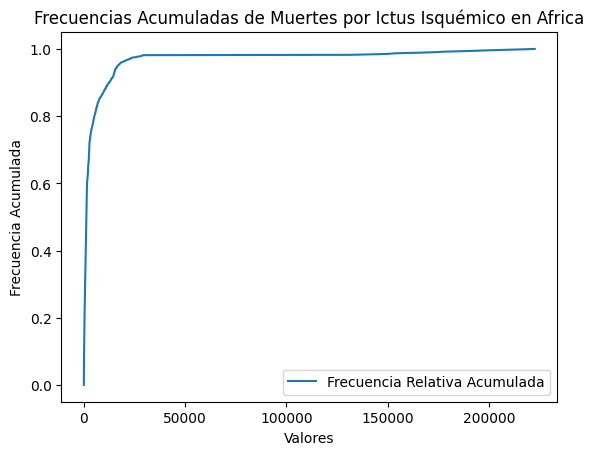

La Frecuencia Absoluta por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
24.60        1
24.63        1
25.12        1
26.29        1
26.51        1
            ..
308043.97    1
311411.28    1
313122.80    1
316123.34    1
319787.00    1
Name: count, Length: 1077, dtype: int64
La Frecuencia Relativa por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
24.60        0.000926
24.63        0.000926
25.12        0.000926
26.29        0.000926
26.51        0.000926
               ...   
308043.97    0.000926
311411.28    0.000926
313122.80    0.000926
316123.34    0.000926
319787.00    0.000926
Name: count, Length: 1077, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
24.60           1
24.63           2
25.12           3
26.29           4
26.51           5


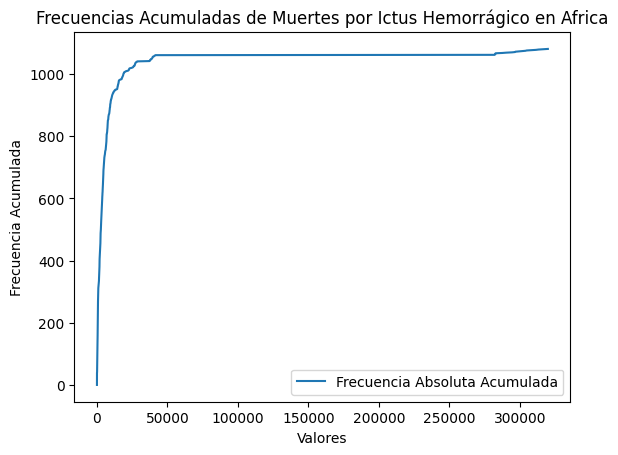

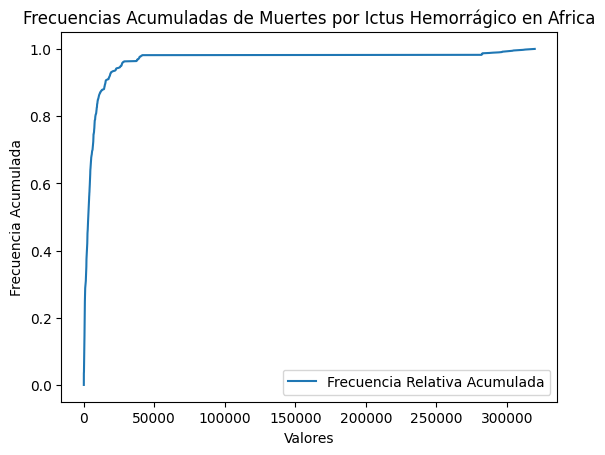

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
62.27        1
63.46        1
64.86        1
67.25        1
68.50        1
            ..
700492.70    1
711311.40    1
723322.70    1
743241.20    1
759545.20    1
Name: count, Length: 1080, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
62.27        0.000926
63.46        0.000926
64.86        0.000926
67.25        0.000926
68.50        0.000926
               ...   
700492.70    0.000926
711311.40    0.000926
723322.70    0.000926
743241.20    0.000926
759545.20    0.000926
Name: count, Length: 1080, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
62.27           1
63.46           2
64.86 

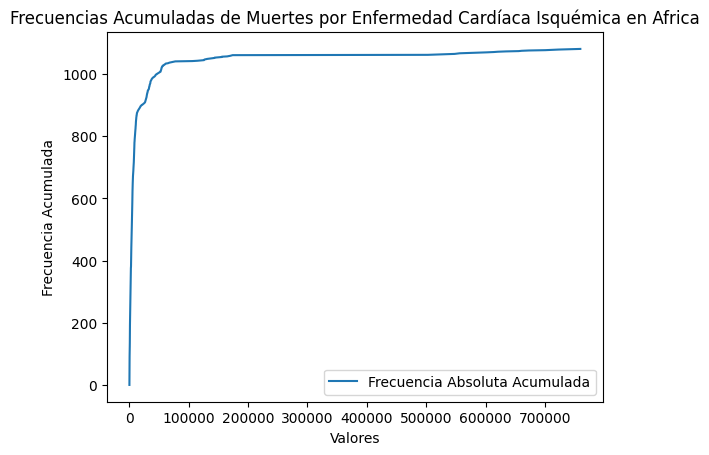

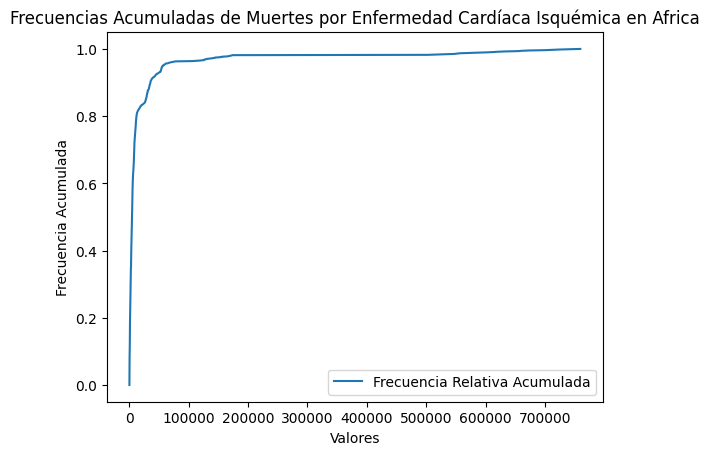

------------------------------------------------------------------------------------------
Frecuencias Acumuladas de muertes por Enfermedades Cardiovasculares en America del Norte:
La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
0.00       7
0.09       1
0.19       1
0.20       1
0.24       1
          ..
6487.09    1
6492.11    1
6593.87    1
6691.04    1
6772.00    1
Name: count, Length: 407, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
0.00       0.015909
0.09       0.002273
0.19       0.002273
0.20       0.002273
0.24       0.002273
             ...   
6487.09    0.002273
6492.11    0.002273
6593.87    0.002273
6691.04    0.002273
6772.00    0.002273
Name: count, Length: 407, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedad Cardíaca R

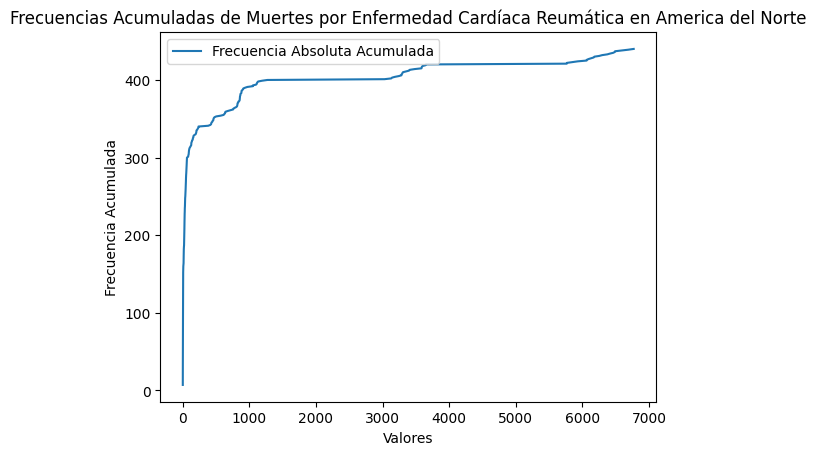

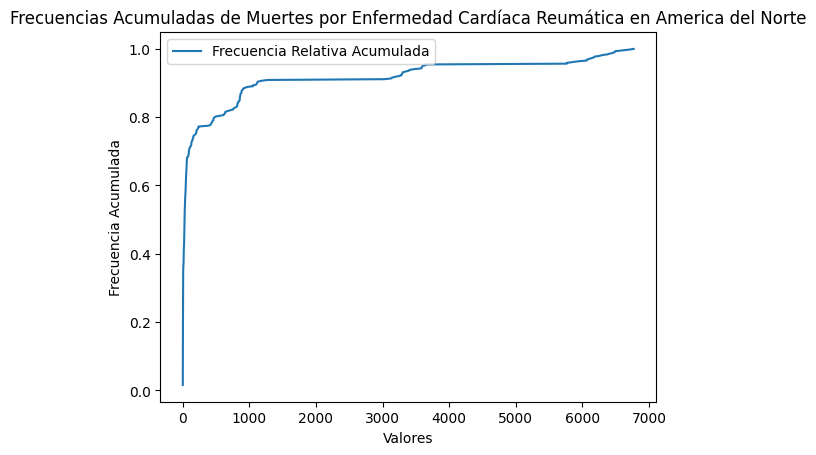

La Frecuencia Absoluta por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
1.23        1
1.67        1
1.79        1
2.00        1
2.05        1
           ..
39512.35    1
39797.33    1
39922.47    1
40191.20    1
40494.66    1
Name: count, Length: 438, dtype: int64
La Frecuencia Relativa por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
1.23        0.002273
1.67        0.002273
1.79        0.002273
2.00        0.002273
2.05        0.002273
              ...   
39512.35    0.002273
39797.33    0.002273
39922.47    0.002273
40191.20    0.002273
40494.66    0.002273
Name: count, Length: 438, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both 

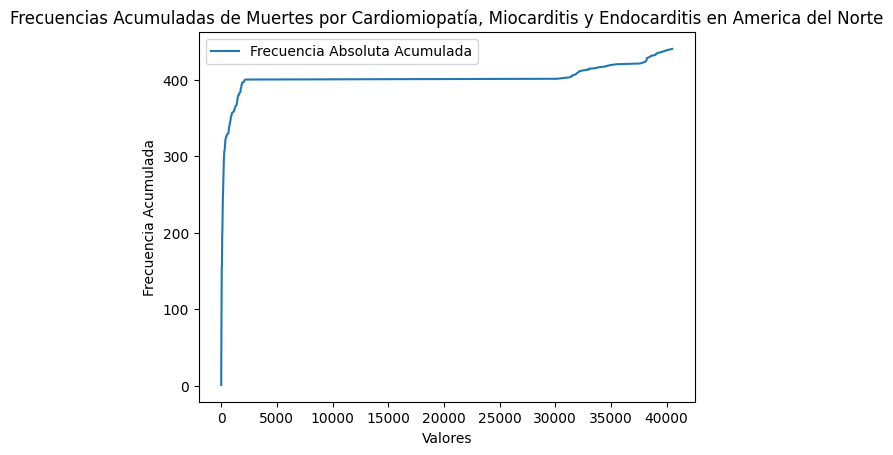

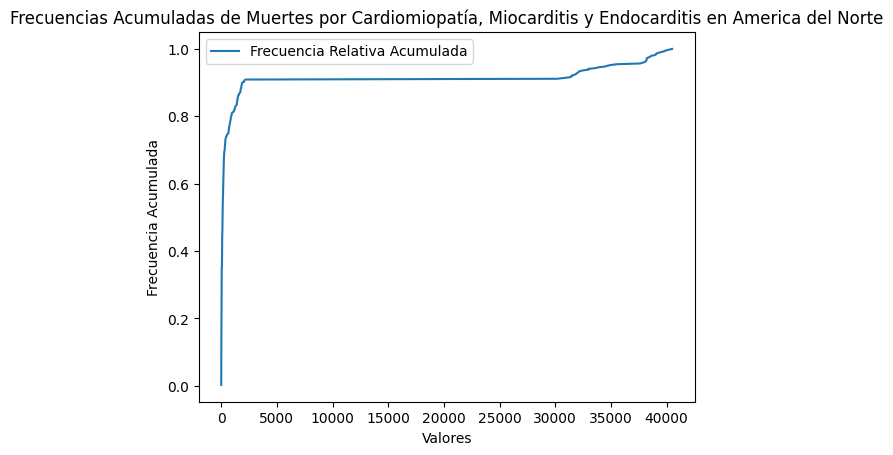

La Frecuencia Absoluta por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
14.40        1
14.52        1
14.73        1
16.99        1
17.50        1
            ..
130131.31    1
133030.39    1
135864.75    1
138203.08    1
140496.17    1
Name: count, Length: 437, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
14.40        0.002273
14.52        0.002273
14.73        0.002273
16.99        0.002273
17.50        0.002273
               ...   
130131.31    0.002273
133030.39    0.002273
135864.75    0.002273
138203.08    0.002273
140496.17    0.002273
Name: count, Length: 437, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
14.40          1
14.52          2
14.73     

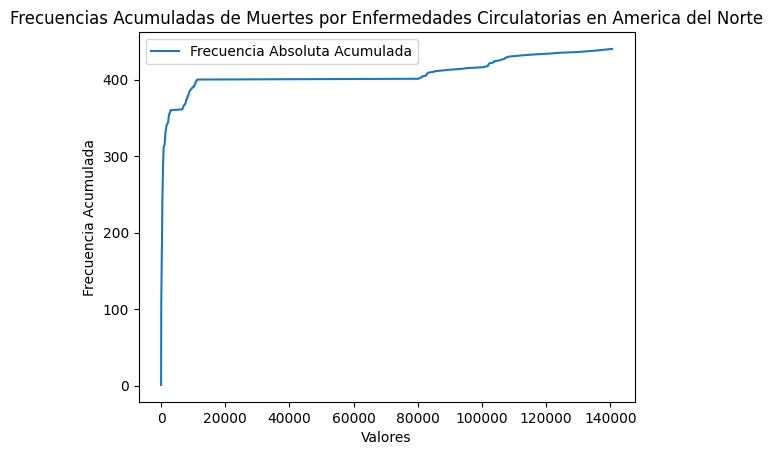

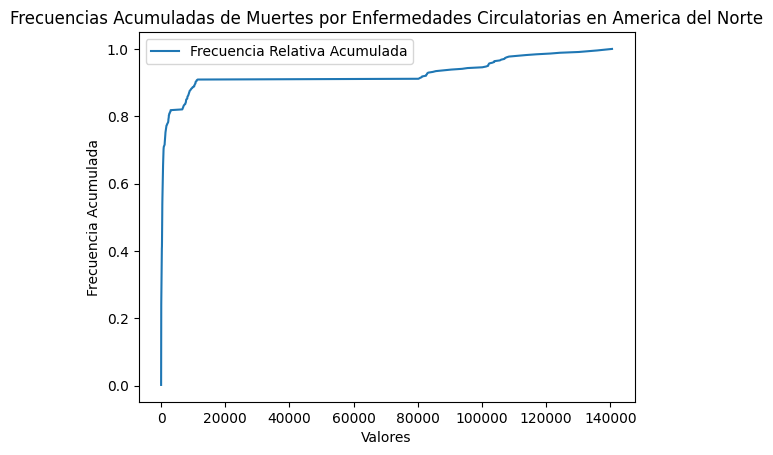

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
0.00         1
1.44         1
2.61         1
5.05         1
6.60         1
            ..
88564.22     1
93023.07     1
97884.39     1
99771.36     1
100504.29    1
Name: count, Length: 435, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
0.00         0.002273
1.44         0.002273
2.61         0.002273
5.05         0.002273
6.60         0.002273
               ...   
88564.22     0.002273
93023.07     0.002273
97884.39     0.002273
99771.36     0.002273
100504.29    0.002273
Name: count, Length: 435, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
0.00           1
1.44     

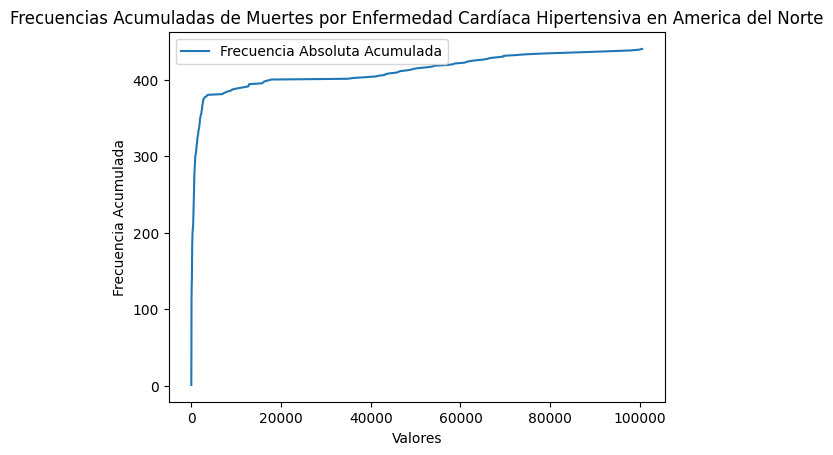

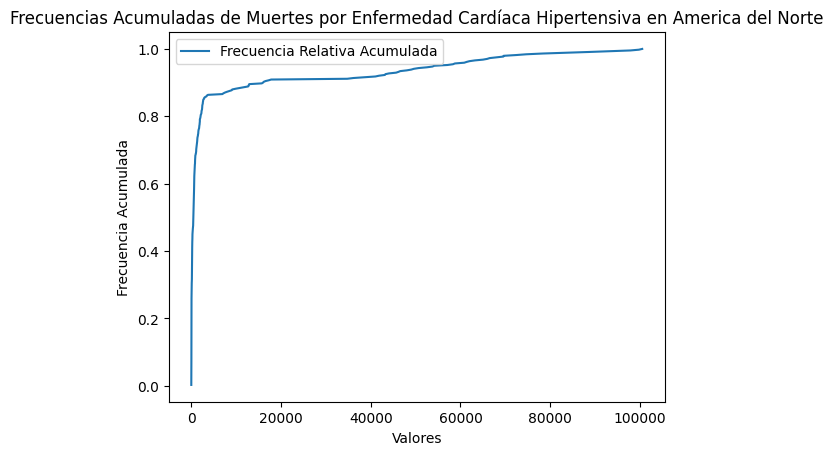

La Frecuencia Absoluta por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
18.06        1
19.76        1
20.19        1
21.92        1
22.37        1
            ..
144782.52    1
146436.77    1
147397.98    1
147605.08    1
150389.78    1
Name: count, Length: 438, dtype: int64
La Frecuencia Relativa por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
18.06        0.002273
19.76        0.002273
20.19        0.002273
21.92        0.002273
22.37        0.002273
               ...   
144782.52    0.002273
146436.77    0.002273
147397.98    0.002273
147605.08    0.002273
150389.78    0.002273
Name: count, Length: 438, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
18.06          1
19.76          2
20.19          3
21.92          4
22.37          5
            ... 
14478

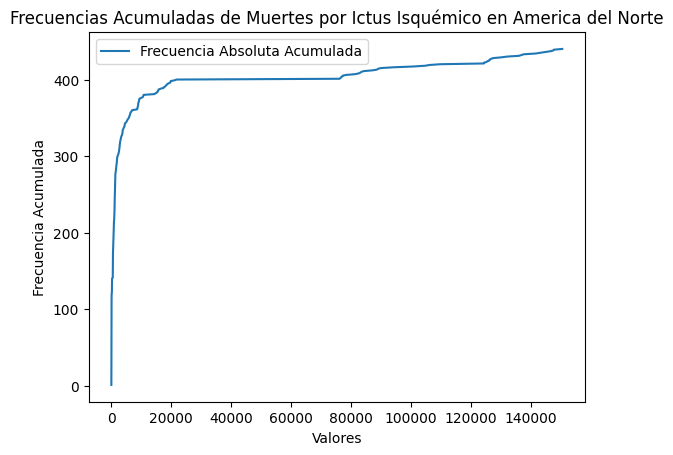

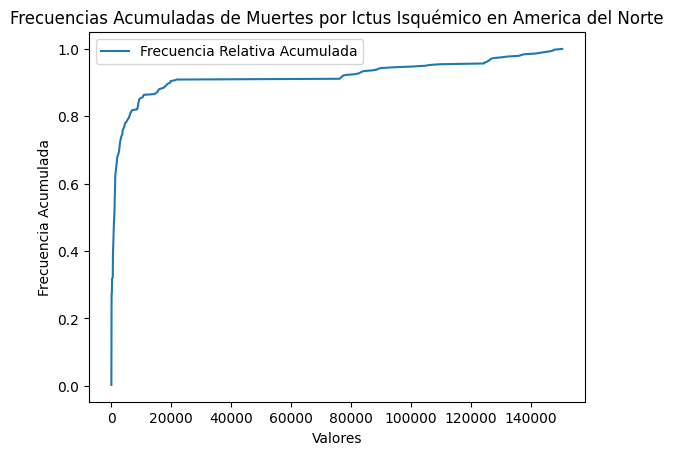

La Frecuencia Absoluta por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
19.59        1
20.18        1
21.92        1
22.05        1
22.20        1
            ..
110249.72    1
111734.02    1
114282.62    1
115814.10    1
117863.97    1
Name: count, Length: 435, dtype: int64
La Frecuencia Relativa por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
19.59        0.002273
20.18        0.002273
21.92        0.002273
22.05        0.002273
22.20        0.002273
               ...   
110249.72    0.002273
111734.02    0.002273
114282.62    0.002273
115814.10    0.002273
117863.97    0.002273
Name: count, Length: 435, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
19.59          1
20.18          2
21.92          3
22.05          4
22.20          5
       

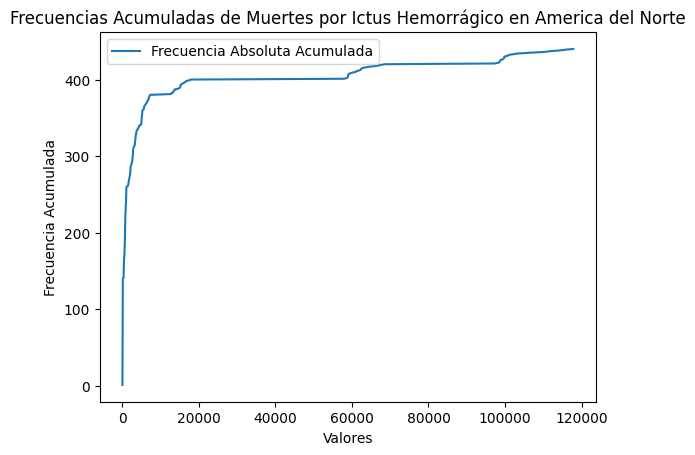

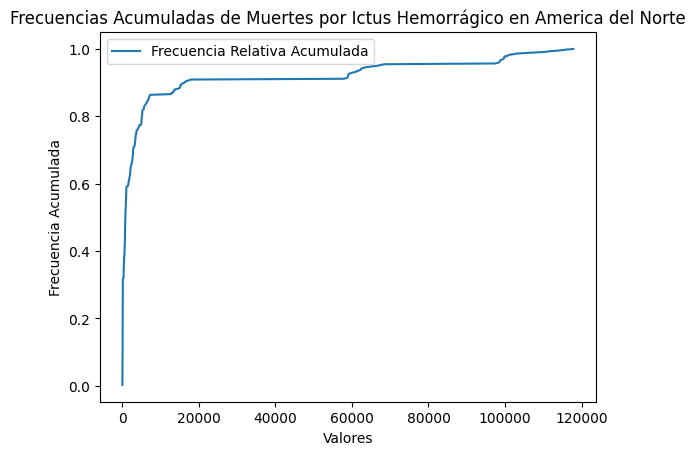

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
52.45        1
56.61        1
65.10        1
67.10        1
76.19        1
            ..
738099.70    1
746474.90    1
750899.60    1
753114.75    1
763962.44    1
Name: count, Length: 440, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
52.45        0.002273
56.61        0.002273
65.10        0.002273
67.10        0.002273
76.19        0.002273
               ...   
738099.70    0.002273
746474.90    0.002273
750899.60    0.002273
753114.75    0.002273
763962.44    0.002273
Name: count, Length: 440, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
52.45          1
56.61          2
65.10     

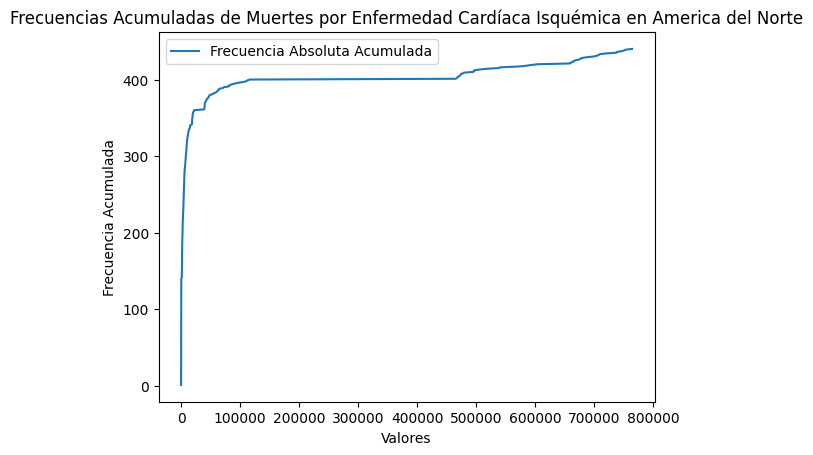

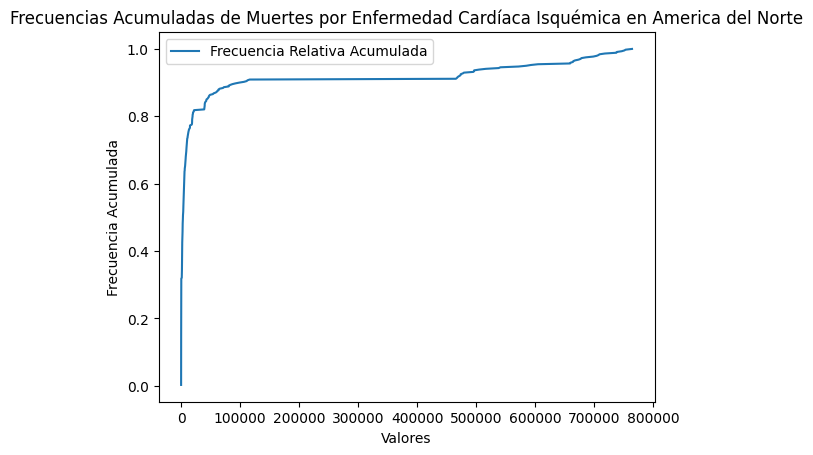

------------------------------------------------------------------------------------------
Frecuencias Acumuladas de muertes por Enfermedades Cardiovasculares en America del Sur:
La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
5.4900       1
5.5400       1
5.6000       1
5.6100       1
5.7400       1
            ..
3852.3300    1
3913.7200    1
3927.4200    1
3929.3098    1
4132.8003    1
Name: count, Length: 259, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
5.4900       0.003846
5.5400       0.003846
5.6000       0.003846
5.6100       0.003846
5.7400       0.003846
               ...   
3852.3300    0.003846
3913.7200    0.003846
3927.4200    0.003846
3929.3098    0.003846
4132.8003    0.003846
Name: count, Length: 259, dtype: float64
La Frecuencia Absoluta Acumu

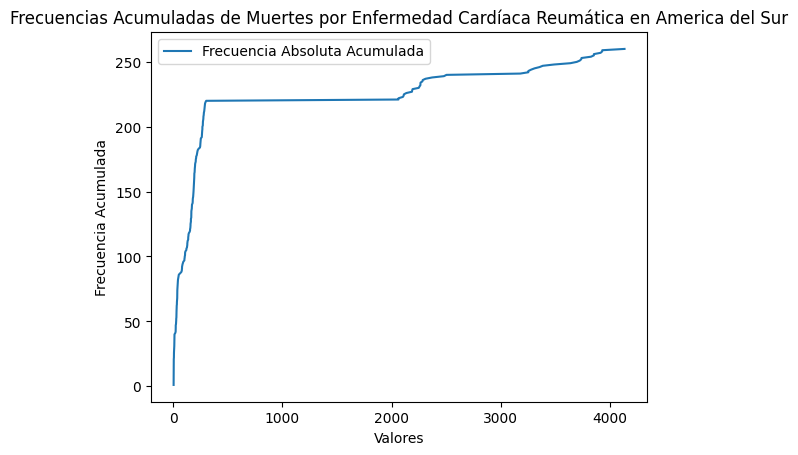

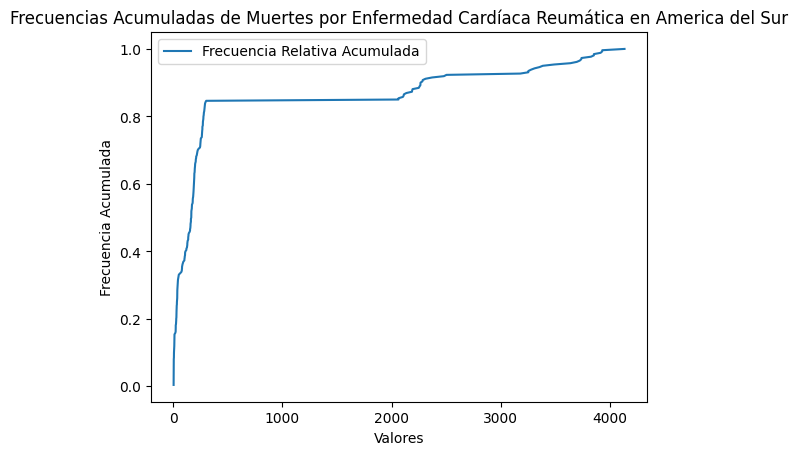

La Frecuencia Absoluta por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
20.020       1
22.010       1
22.270       1
22.530       1
22.800       1
            ..
26624.418    1
26991.300    1
27016.250    1
27413.060    1
28142.750    1
Name: count, Length: 260, dtype: int64
La Frecuencia Relativa por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
20.020       0.003846
22.010       0.003846
22.270       0.003846
22.530       0.003846
22.800       0.003846
               ...   
26624.418    0.003846
26991.300    0.003846
27016.250    0.003846
27413.060    0.003846
28142.750    0.003846
Name: count, Length: 260, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, end

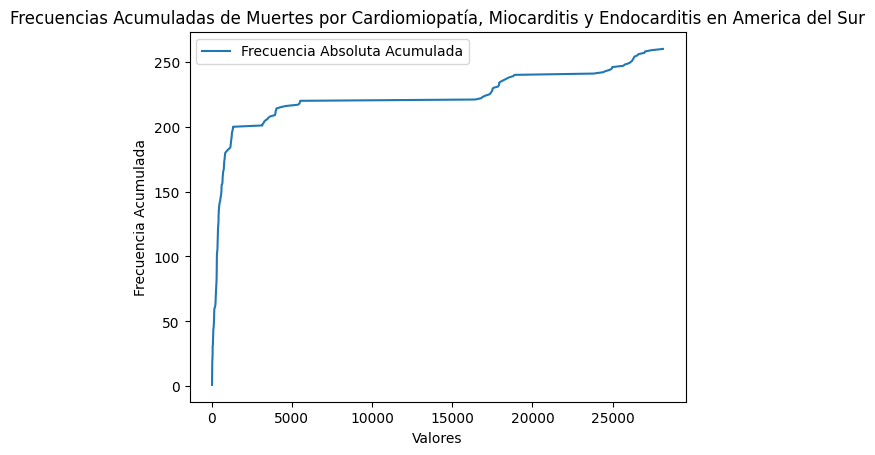

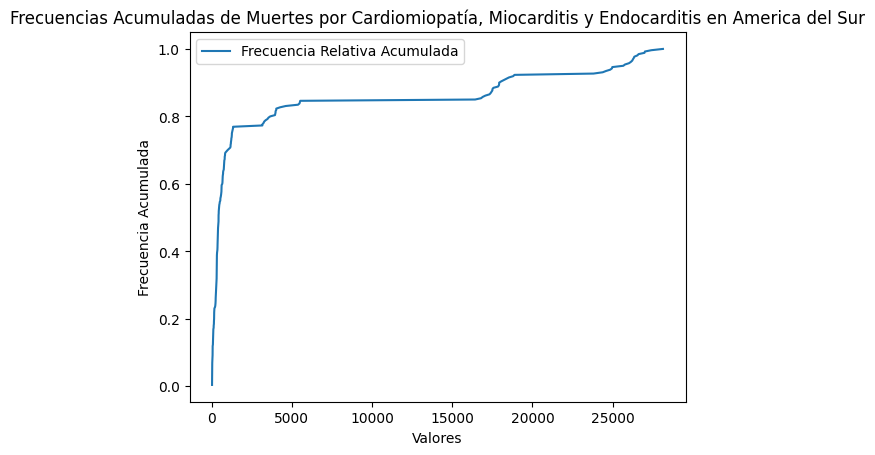

La Frecuencia Absoluta por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
39.040       1
42.550       1
43.990       1
44.420       1
44.730       1
            ..
71430.110    1
74907.460    1
76301.810    1
78637.980    1
79477.734    1
Name: count, Length: 260, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
39.040       0.003846
42.550       0.003846
43.990       0.003846
44.420       0.003846
44.730       0.003846
               ...   
71430.110    0.003846
74907.460    0.003846
76301.810    0.003846
78637.980    0.003846
79477.734    0.003846
Name: count, Length: 260, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
39.040         1
42.550         2
43.990    

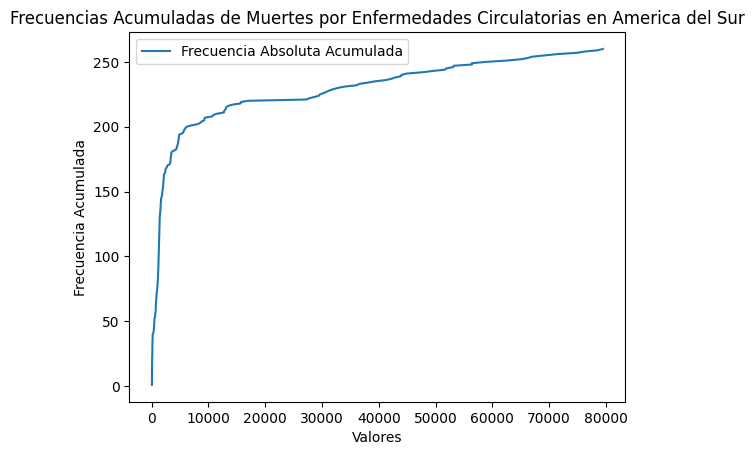

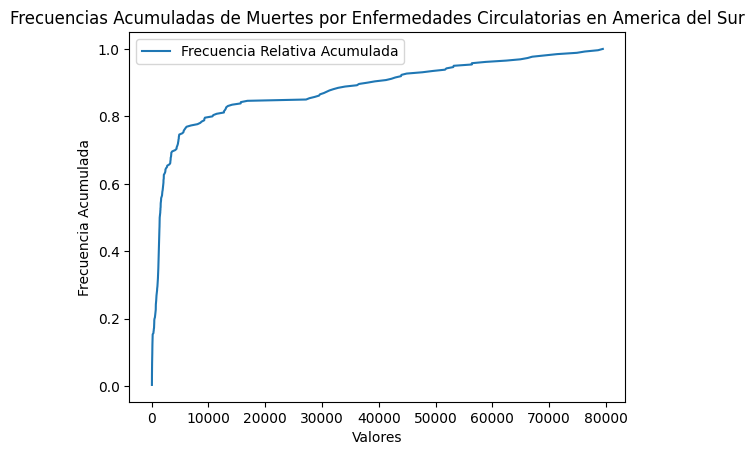

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
70.750       1
75.000       1
77.250       1
77.940       1
77.950       1
            ..
51390.860    1
53653.867    1
57164.020    1
57523.770    1
57549.332    1
Name: count, Length: 260, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
70.750       0.003846
75.000       0.003846
77.250       0.003846
77.940       0.003846
77.950       0.003846
               ...   
51390.860    0.003846
53653.867    0.003846
57164.020    0.003846
57523.770    0.003846
57549.332    0.003846
Name: count, Length: 260, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
70.750         1
75.000   

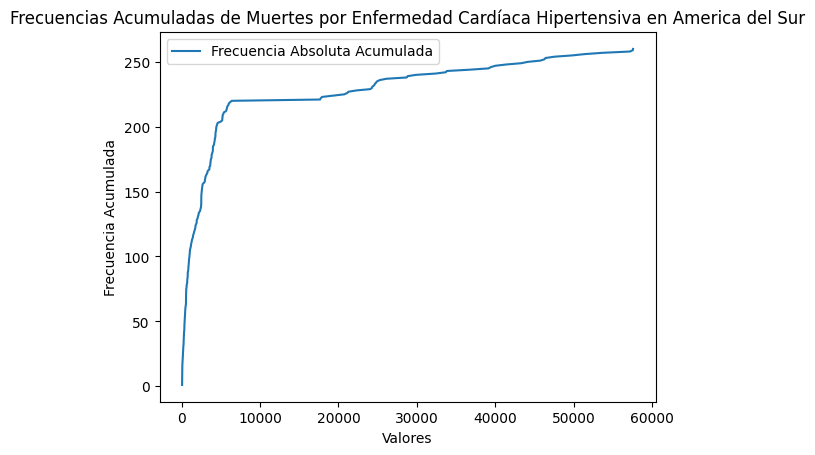

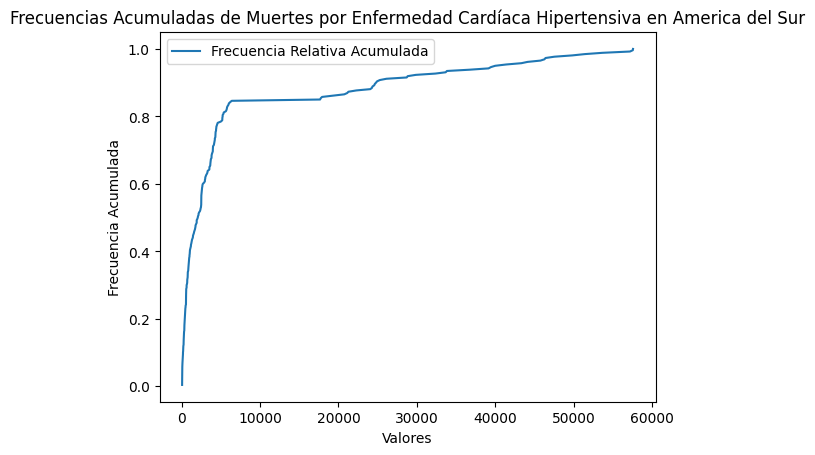

La Frecuencia Absoluta por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
159.000       1
173.220       1
174.700       1
175.140       1
177.390       1
             ..
111461.516    1
112430.830    1
113697.450    1
113910.890    1
116831.370    1
Name: count, Length: 260, dtype: int64
La Frecuencia Relativa por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
159.000       0.003846
173.220       0.003846
174.700       0.003846
175.140       0.003846
177.390       0.003846
                ...   
111461.516    0.003846
112430.830    0.003846
113697.450    0.003846
113910.890    0.003846
116831.370    0.003846
Name: count, Length: 260, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
159.000         1
173.220         2
174.700         3
175.140         4
177.390      

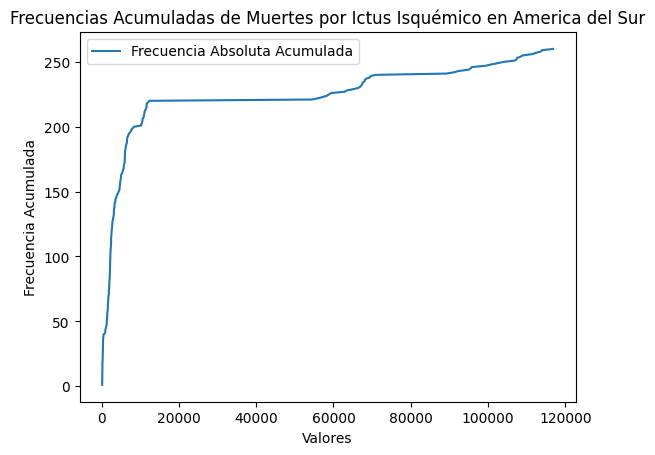

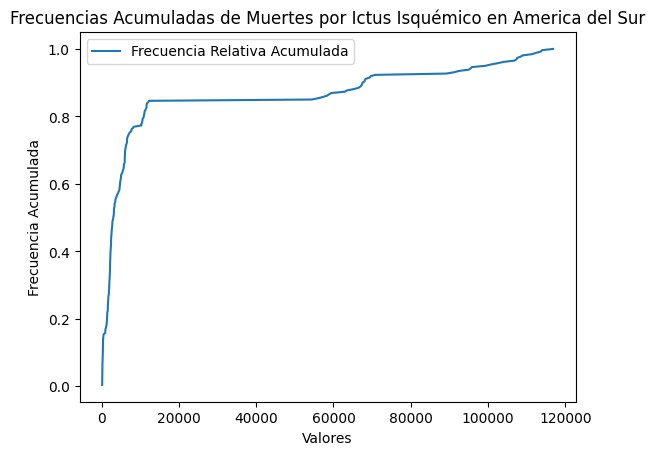

La Frecuencia Absoluta por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
243.940      1
246.690      1
248.580      1
251.130      1
254.770      1
            ..
93601.140    1
94716.630    1
94762.350    1
95542.016    1
95568.690    1
Name: count, Length: 260, dtype: int64
La Frecuencia Relativa por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
243.940      0.003846
246.690      0.003846
248.580      0.003846
251.130      0.003846
254.770      0.003846
               ...   
93601.140    0.003846
94716.630    0.003846
94762.350    0.003846
95542.016    0.003846
95568.690    0.003846
Name: count, Length: 260, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
243.940        1
246.690        2
248.580        3
251.130        4
254.770        5
       

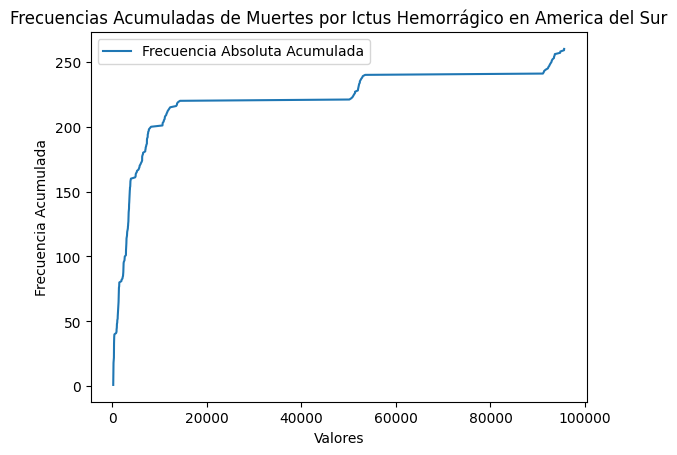

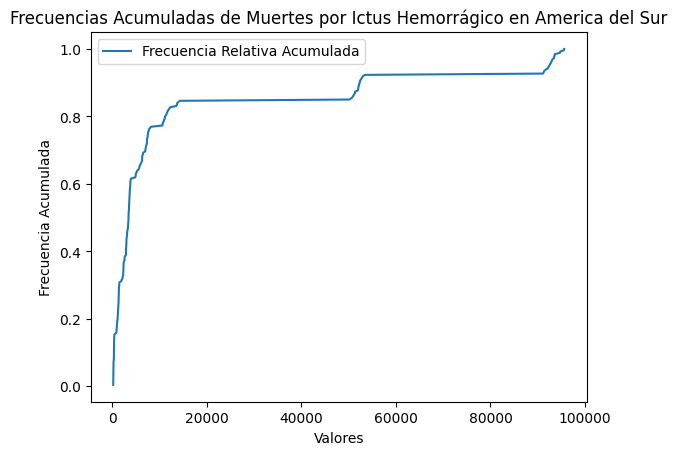

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
383.98       1
401.88       1
401.98       1
402.35       1
403.00       1
            ..
319031.44    1
329473.50    1
332213.12    1
333533.47    1
340410.97    1
Name: count, Length: 260, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
383.98       0.003846
401.88       0.003846
401.98       0.003846
402.35       0.003846
403.00       0.003846
               ...   
319031.44    0.003846
329473.50    0.003846
332213.12    0.003846
333533.47    0.003846
340410.97    0.003846
Name: count, Length: 260, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
383.98         1
401.88         2
401.98    

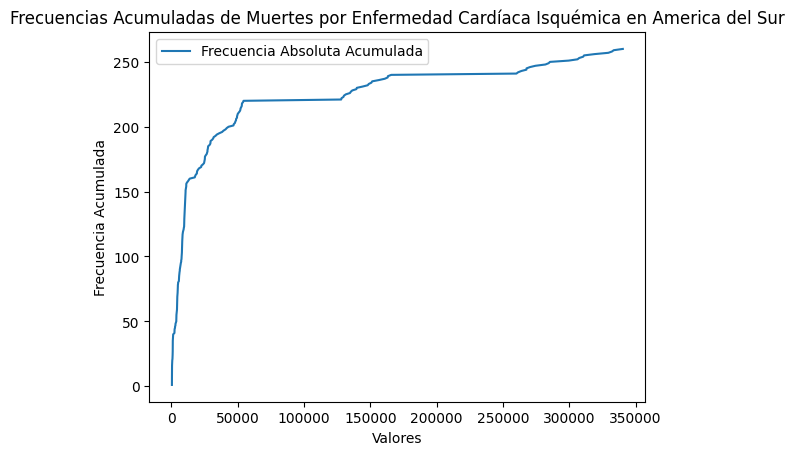

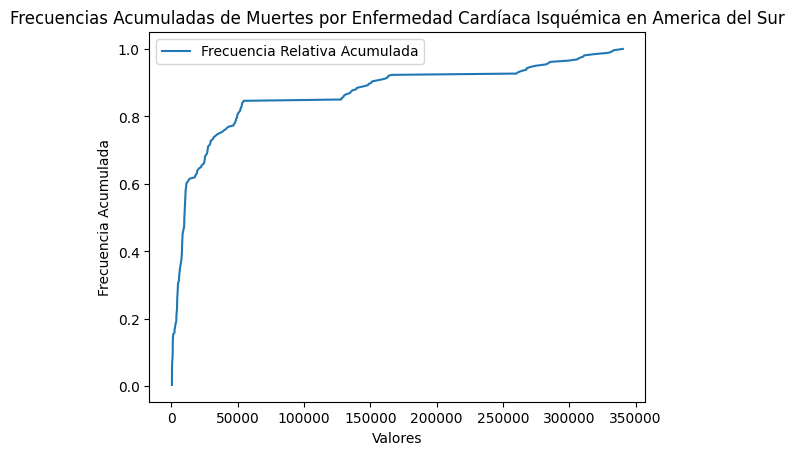

------------------------------------------------------------------------------------------
Frecuencias Acumuladas de muertes por Enfermedades Cardiovasculares en Asia:
La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
2.38         1
3.11         1
3.19         1
3.22         1
3.25         1
            ..
266637.30    1
272691.47    1
276988.28    1
279125.80    1
281037.22    1
Name: count, Length: 929, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
2.38         0.001064
3.11         0.001064
3.19         0.001064
3.22         0.001064
3.25         0.001064
               ...   
266637.30    0.001064
272691.47    0.001064
276988.28    0.001064
279125.80    0.001064
281037.22    0.001064
Name: count, Length: 929, dtype: float64
La Frecuencia Absoluta Acumulada por Mu

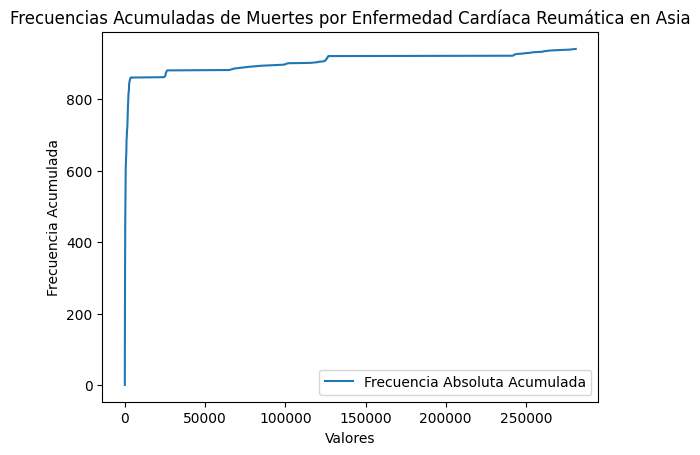

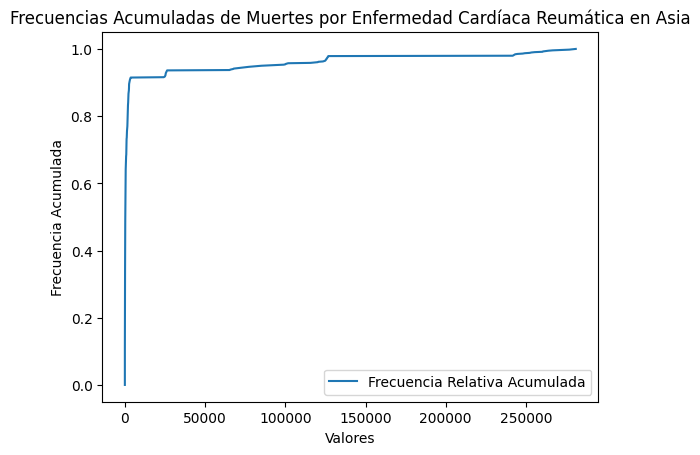

La Frecuencia Absoluta por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
3.460        1
3.530        1
3.620        1
3.740        1
3.810        1
            ..
91913.340    1
93881.290    1
95387.130    1
96893.984    1
98310.586    1
Name: count, Length: 936, dtype: int64
La Frecuencia Relativa por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
3.460        0.001064
3.530        0.001064
3.620        0.001064
3.740        0.001064
3.810        0.001064
               ...   
91913.340    0.001064
93881.290    0.001064
95387.130    0.001064
96893.984    0.001064
98310.586    0.001064
Name: count, Length: 936, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, end

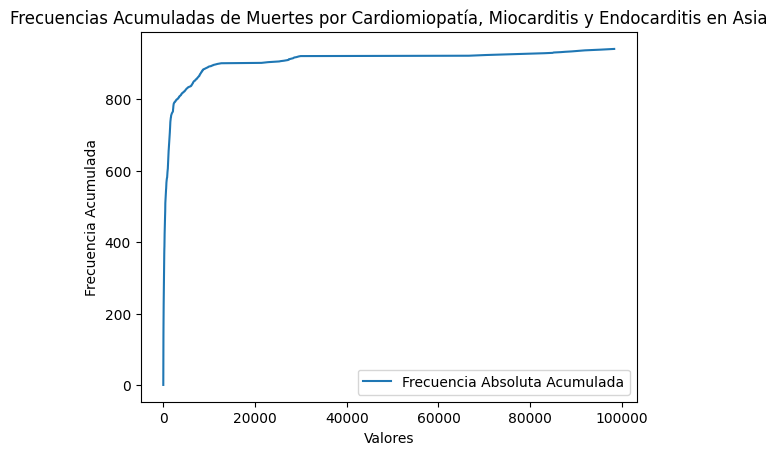

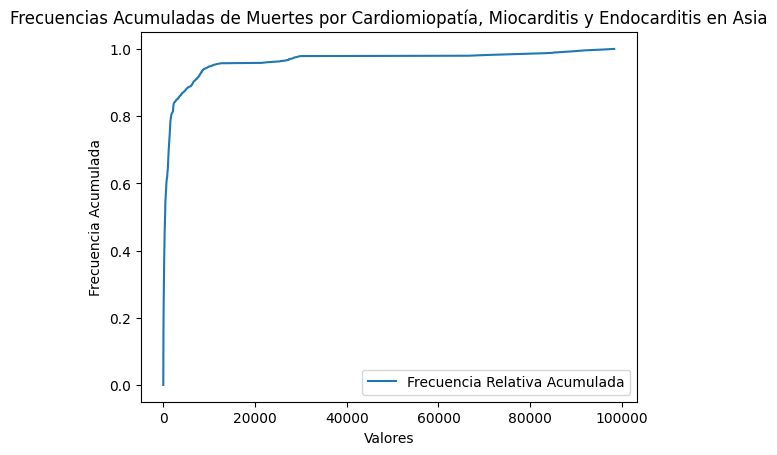

La Frecuencia Absoluta por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
14.65        1
15.01        1
15.14        1
16.58        1
16.94        1
            ..
327228.03    1
343853.56    1
360083.22    1
371115.75    1
379218.47    1
Name: count, Length: 938, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
14.65        0.001064
15.01        0.001064
15.14        0.001064
16.58        0.001064
16.94        0.001064
               ...   
327228.03    0.001064
343853.56    0.001064
360083.22    0.001064
371115.75    0.001064
379218.47    0.001064
Name: count, Length: 938, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
14.65          1
15.01          2
15.14     

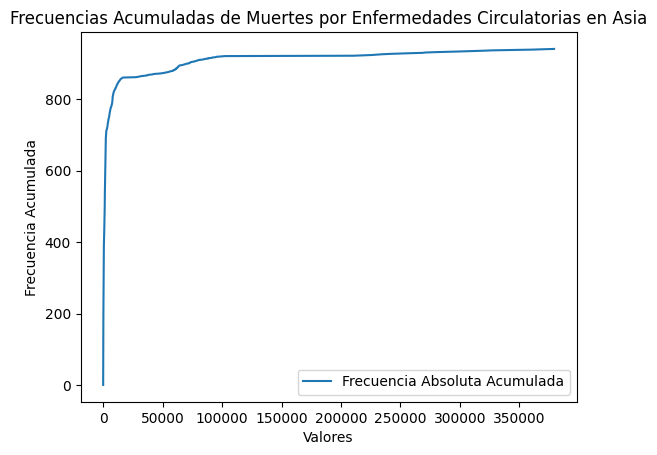

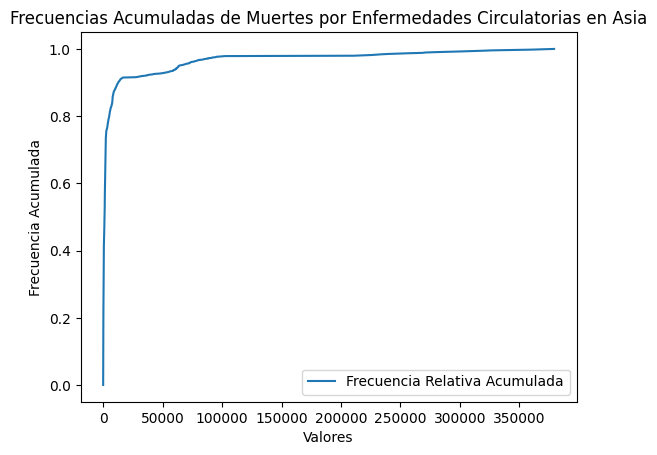

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
9.49         1
9.69         1
9.99         1
10.55        1
10.64        1
            ..
597123.10    1
622403.56    1
640159.70    1
649710.44    1
658448.20    1
Name: count, Length: 938, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
9.49         0.001064
9.69         0.001064
9.99         0.001064
10.55        0.001064
10.64        0.001064
               ...   
597123.10    0.001064
622403.56    0.001064
640159.70    0.001064
649710.44    0.001064
658448.20    0.001064
Name: count, Length: 938, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
9.49           1
9.69     

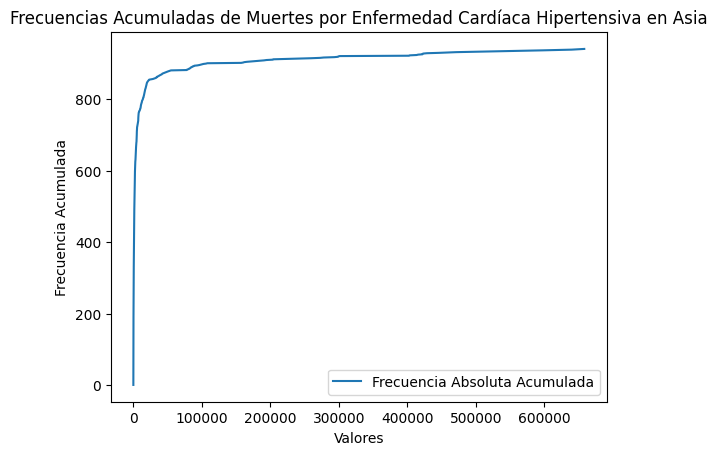

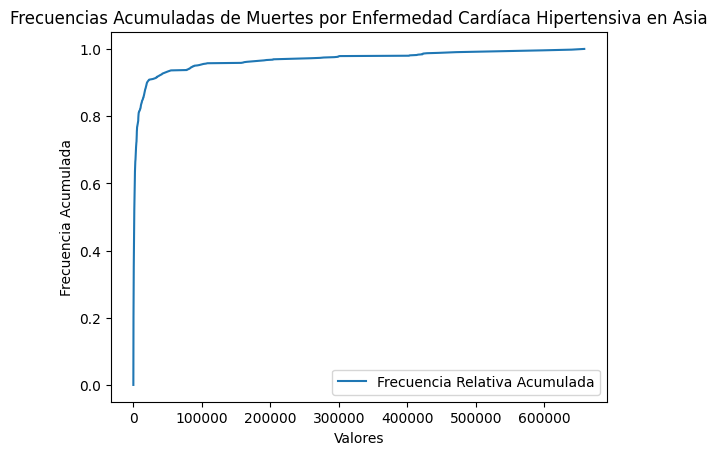

La Frecuencia Absoluta por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
37.77         1
38.82         1
40.51         1
43.64         1
44.21         1
             ..
1689184.90    1
1755075.80    1
1817979.50    1
1869142.00    1
1917909.50    1
Name: count, Length: 939, dtype: int64
La Frecuencia Relativa por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
37.77         0.001064
38.82         0.001064
40.51         0.001064
43.64         0.001064
44.21         0.001064
                ...   
1689184.90    0.001064
1755075.80    0.001064
1817979.50    0.001064
1869142.00    0.001064
1917909.50    0.001064
Name: count, Length: 939, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
37.77           1
38.82           2
40.51           3
43.64           4
44.21        

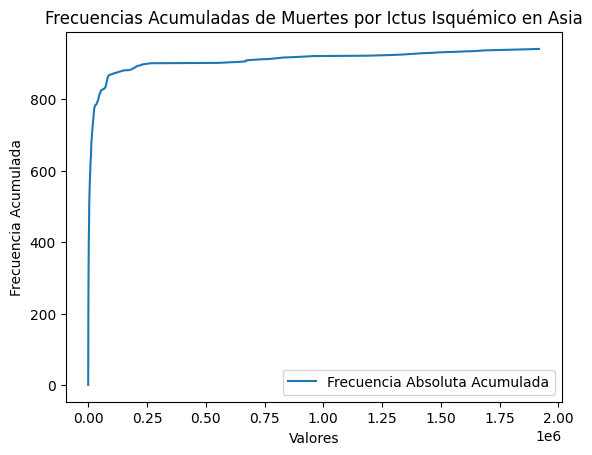

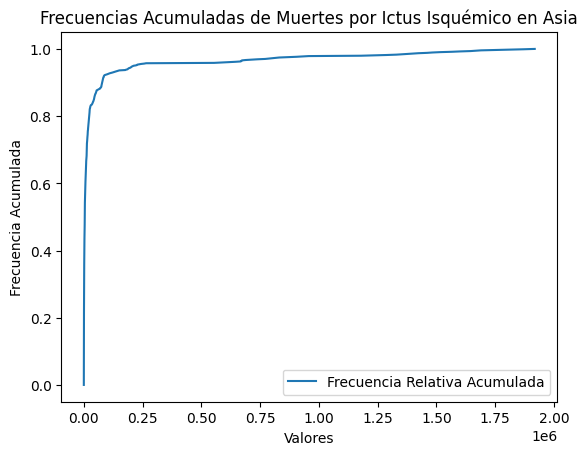

La Frecuencia Absoluta por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
52.96         1
54.13         1
54.68         1
54.86         1
56.49         1
             ..
2281280.50    1
2284003.20    1
2288032.20    1
2297081.50    1
2330634.00    1
Name: count, Length: 939, dtype: int64
La Frecuencia Relativa por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
52.96         0.001064
54.13         0.001064
54.68         0.001064
54.86         0.001064
56.49         0.001064
                ...   
2281280.50    0.001064
2284003.20    0.001064
2288032.20    0.001064
2297081.50    0.001064
2330634.00    0.001064
Name: count, Length: 939, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
52.96           1
54.13           2
54.68           3
54.86           

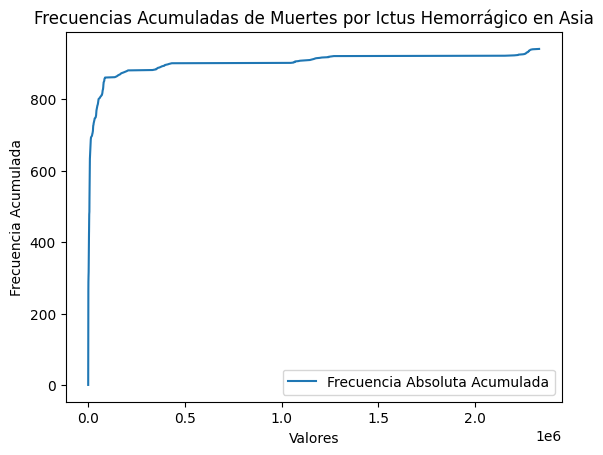

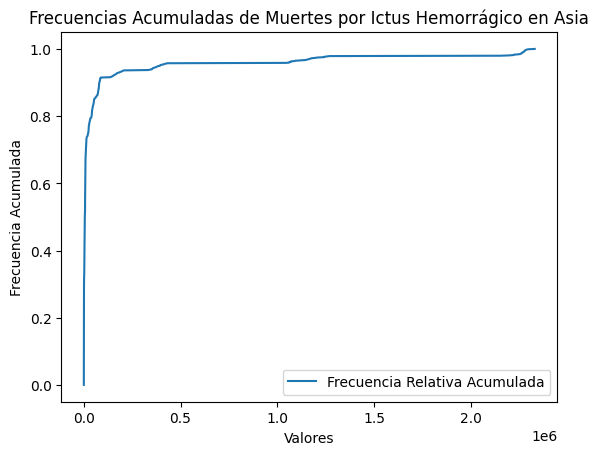

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
171.95        1
184.02        1
202.40        1
202.80        1
203.36        1
             ..
4601395.00    1
4752694.00    1
4888440.50    1
5021420.50    1
5125233.50    1
Name: count, Length: 940, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
171.95        0.001064
184.02        0.001064
202.40        0.001064
202.80        0.001064
203.36        0.001064
                ...   
4601395.00    0.001064
4752694.00    0.001064
4888440.50    0.001064
5021420.50    0.001064
5125233.50    0.001064
Name: count, Length: 940, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
171.95          1
184.

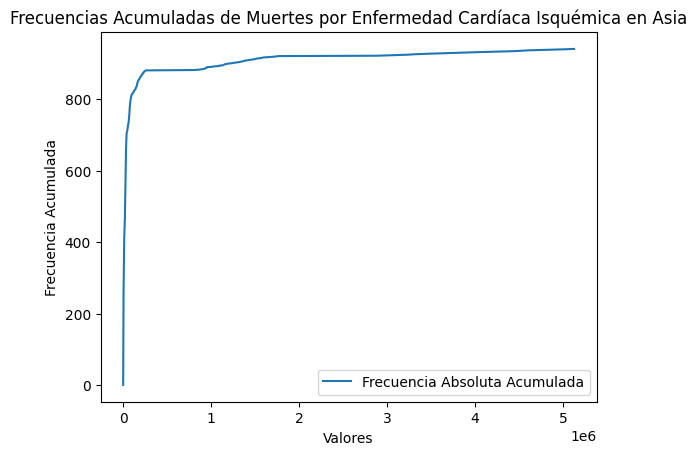

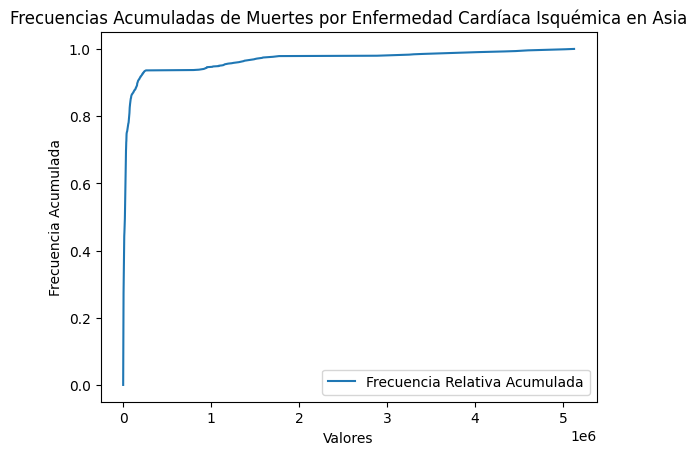

------------------------------------------------------------------------------------------
Frecuencias Acumuladas de muertes por Enfermedades Cardiovasculares en Europa:
La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
0.34        1
0.67        1
0.69        1
0.73        1
1.02        1
           ..
23340.59    1
24811.98    1
24997.32    1
25336.74    1
26909.65    1
Name: count, Length: 783, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
0.34        0.00125
0.67        0.00125
0.69        0.00125
0.73        0.00125
1.02        0.00125
             ...   
23340.59    0.00125
24811.98    0.00125
24997.32    0.00125
25336.74    0.00125
26909.65    0.00125
Name: count, Length: 783, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedad Cardíaca R

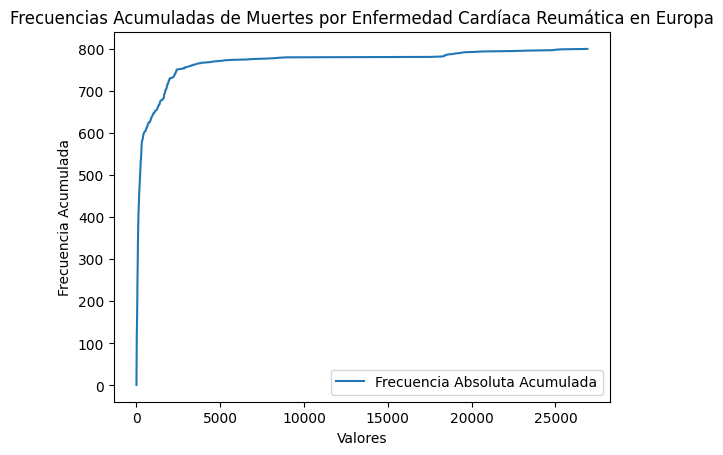

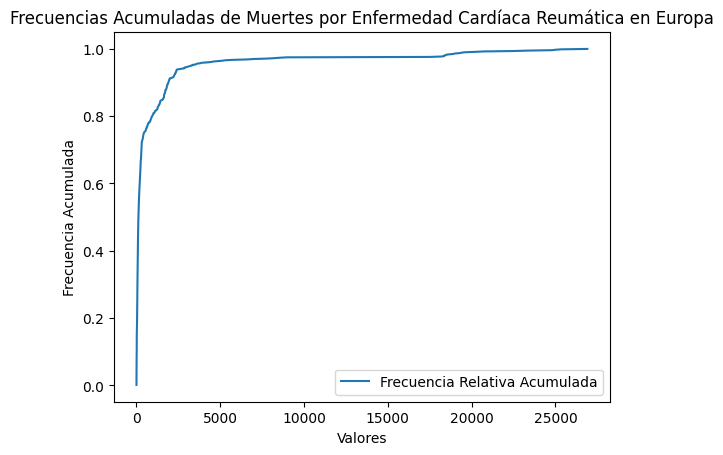

La Frecuencia Absoluta por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
6.19         1
6.83         1
6.92         1
7.21         1
7.30         1
            ..
166977.55    1
171847.36    1
172127.72    1
172340.02    1
176270.03    1
Name: count, Length: 799, dtype: int64
La Frecuencia Relativa por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
6.19         0.00125
6.83         0.00125
6.92         0.00125
7.21         0.00125
7.30         0.00125
              ...   
166977.55    0.00125
171847.36    0.00125
172127.72    0.00125
172340.02    0.00125
176270.03    0.00125
Name: count, Length: 799, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis -

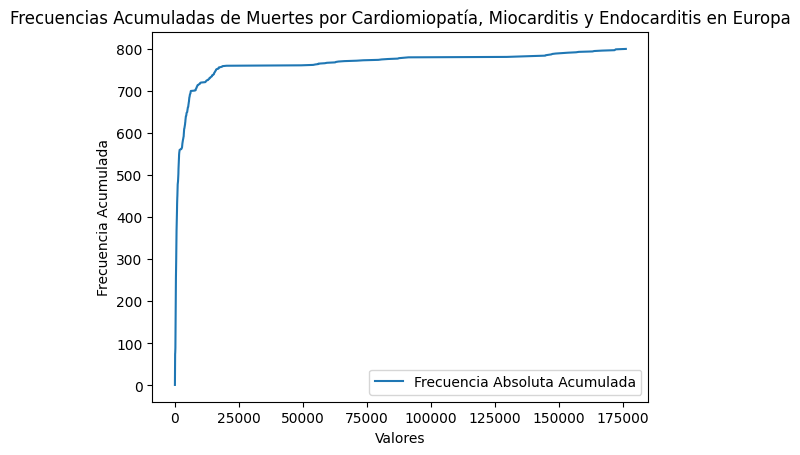

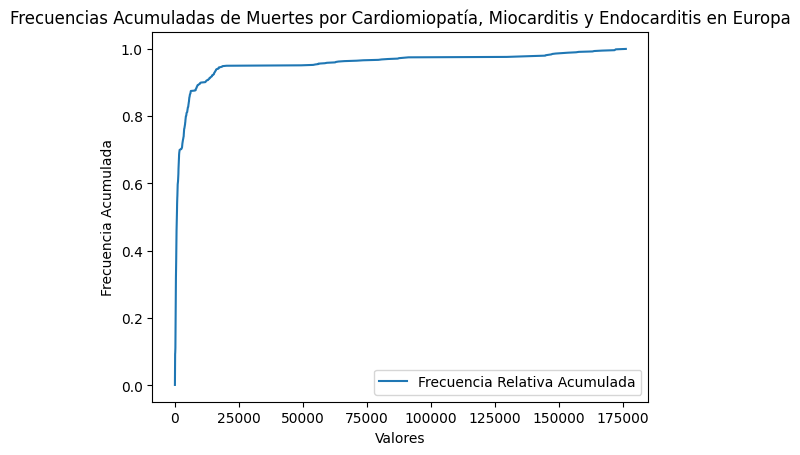

La Frecuencia Absoluta por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
53.46        1
55.33        1
56.65        1
61.20        1
68.59        1
            ..
304621.84    1
315382.03    1
319021.90    1
325365.20    1
325785.25    1
Name: count, Length: 797, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
53.46        0.00125
55.33        0.00125
56.65        0.00125
61.20        0.00125
68.59        0.00125
              ...   
304621.84    0.00125
315382.03    0.00125
319021.90    0.00125
325365.20    0.00125
325785.25    0.00125
Name: count, Length: 797, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
53.46          1
55.33          2
56.65          3
61.2

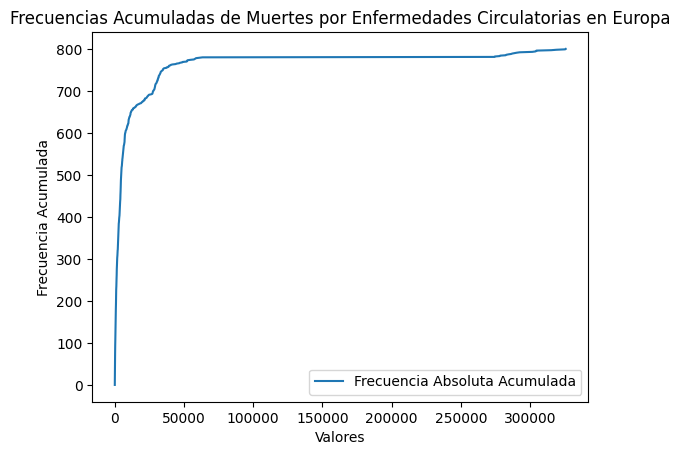

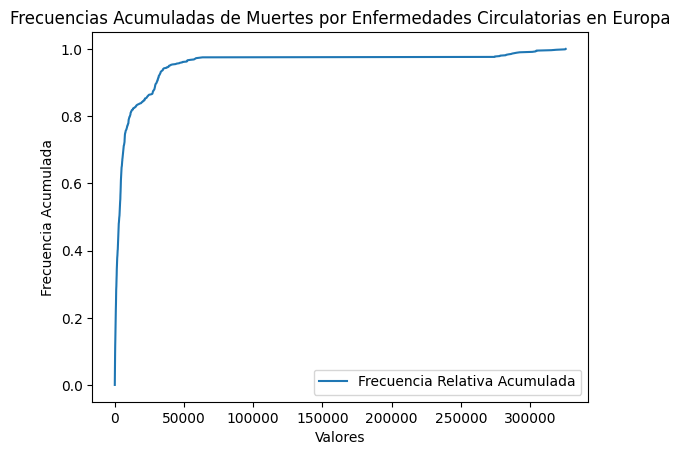

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
12.46        1
13.31        1
13.50        1
14.49        1
15.09        1
            ..
160819.80    1
168651.89    1
170222.22    1
175557.06    1
176734.75    1
Name: count, Length: 799, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
12.46        0.00125
13.31        0.00125
13.50        0.00125
14.49        0.00125
15.09        0.00125
              ...   
160819.80    0.00125
168651.89    0.00125
170222.22    0.00125
175557.06    0.00125
176734.75    0.00125
Name: count, Length: 799, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
12.46          1
13.31          2
13.

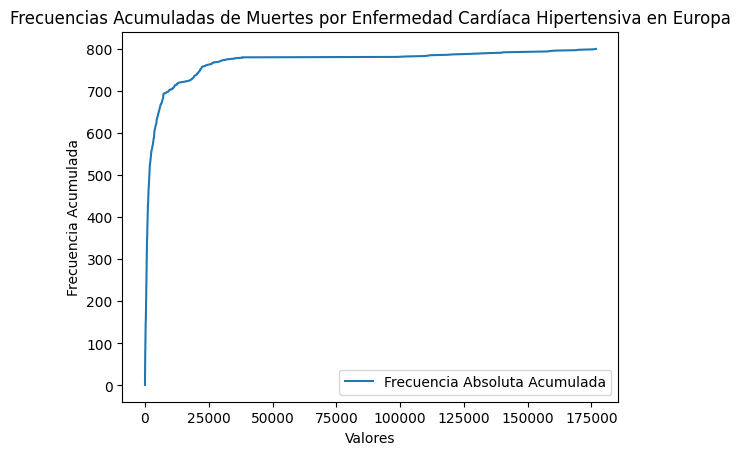

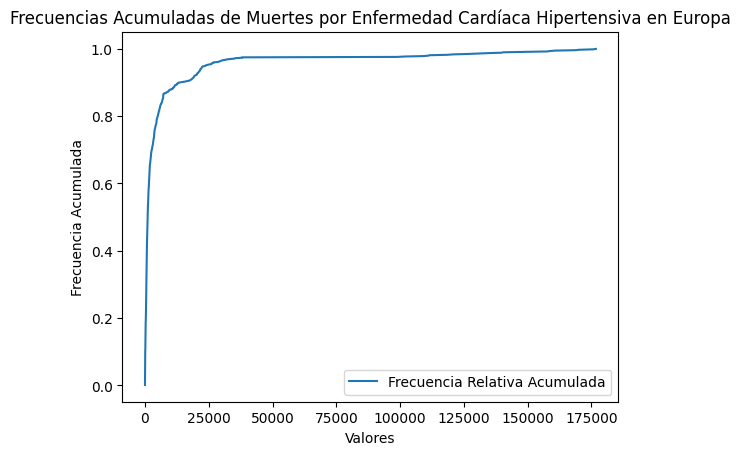

La Frecuencia Absoluta por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
90.46        1
92.35        1
93.40        1
93.75        1
94.13        1
            ..
875105.30    1
910014.50    1
913928.06    1
928153.30    1
940375.40    1
Name: count, Length: 799, dtype: int64
La Frecuencia Relativa por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
90.46        0.00125
92.35        0.00125
93.40        0.00125
93.75        0.00125
94.13        0.00125
              ...   
875105.30    0.00125
910014.50    0.00125
913928.06    0.00125
928153.30    0.00125
940375.40    0.00125
Name: count, Length: 799, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
90.46          1
92.35          2
93.40          3
93.75          4
94.13          5
            ... 
875105.30    796

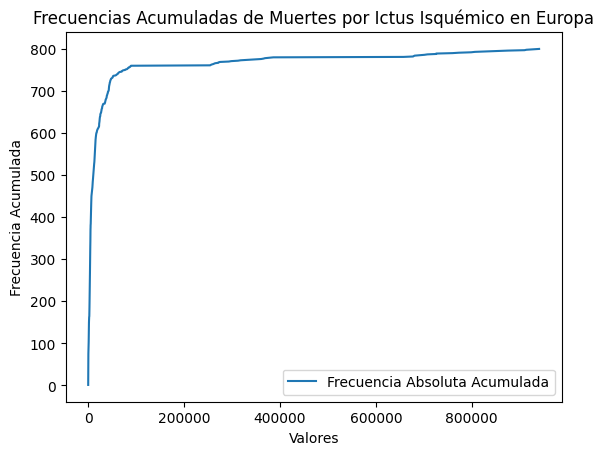

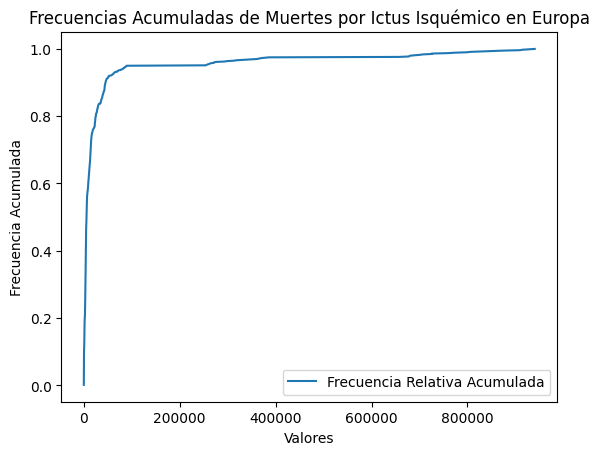

La Frecuencia Absoluta por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
44.20        1
45.08        1
45.11        1
46.46        1
47.10        1
            ..
346032.97    1
356016.20    1
356654.03    1
362487.20    1
365019.06    1
Name: count, Length: 800, dtype: int64
La Frecuencia Relativa por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
44.20        0.00125
45.08        0.00125
45.11        0.00125
46.46        0.00125
47.10        0.00125
              ...   
346032.97    0.00125
356016.20    0.00125
356654.03    0.00125
362487.20    0.00125
365019.06    0.00125
Name: count, Length: 800, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
44.20          1
45.08          2
45.11          3
46.46          4
47.10          5
            ... 
3

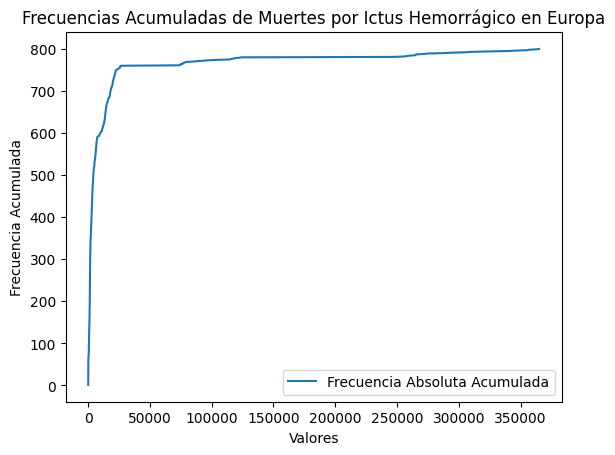

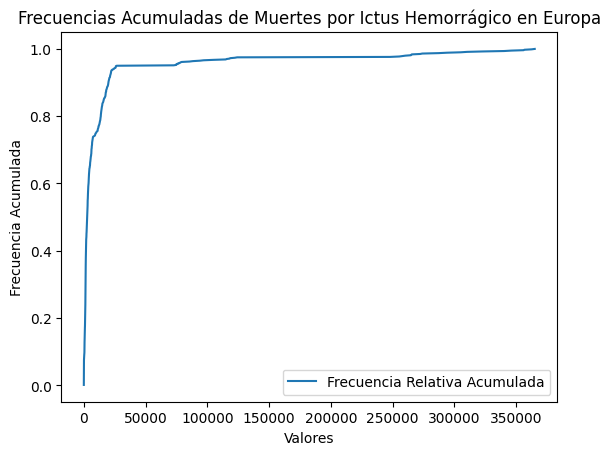

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
403.43        1
403.83        1
414.61        1
417.13        1
423.04        1
             ..
2299962.00    1
2305014.80    1
2316179.80    1
2367026.00    1
2416414.50    1
Name: count, Length: 800, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
403.43        0.00125
403.83        0.00125
414.61        0.00125
417.13        0.00125
423.04        0.00125
               ...   
2299962.00    0.00125
2305014.80    0.00125
2316179.80    0.00125
2367026.00    0.00125
2416414.50    0.00125
Name: count, Length: 800, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
403.43          1
403.83         

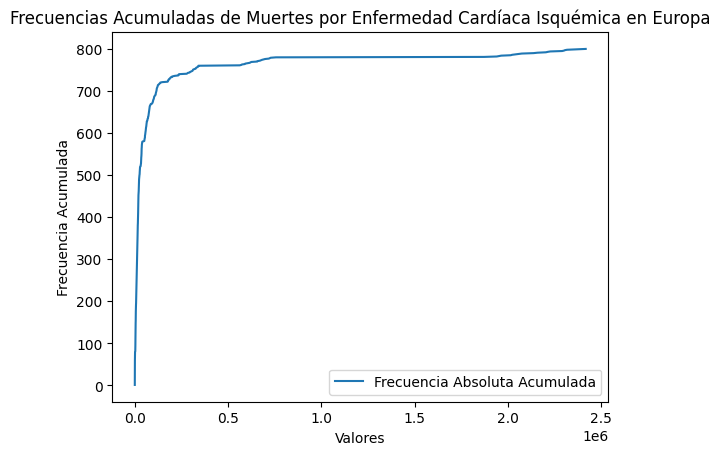

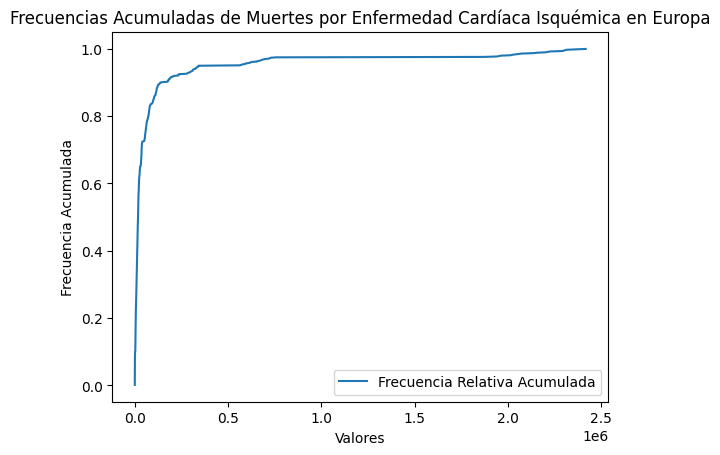

------------------------------------------------------------------------------------------
Frecuencias Acumuladas de muertes por Enfermedades Cardiovasculares en Oceania:
La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
2.1400       1
2.2500       1
2.3300       1
2.3400       1
2.4800       1
            ..
1724.2600    1
1734.3500    1
1745.1799    1
1764.5901    1
1767.6799    1
Name: count, Length: 214, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
2.1400       0.004545
2.2500       0.004545
2.3300       0.004545
2.3400       0.004545
2.4800       0.004545
               ...   
1724.2600    0.004545
1734.3500    0.004545
1745.1799    0.004545
1764.5901    0.004545
1767.6799    0.004545
Name: count, Length: 214, dtype: float64
La Frecuencia Absoluta Acumulada por

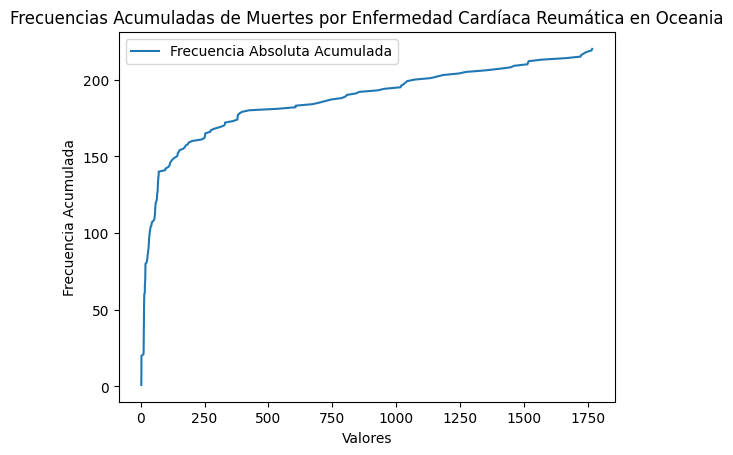

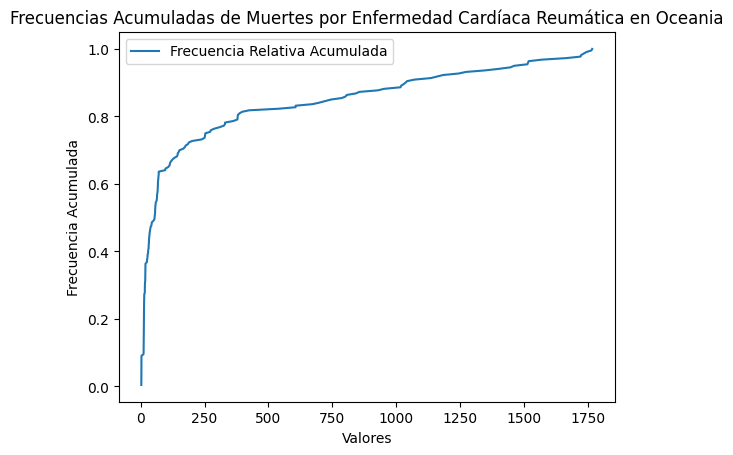

La Frecuencia Absoluta por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
1.9100       1
1.9700       1
2.0100       2
2.0600       1
2.0800       1
            ..
2158.4200    1
2209.4700    1
2217.0200    1
2259.8198    1
2260.2600    1
Name: count, Length: 212, dtype: int64
La Frecuencia Relativa por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
1.9100       0.004545
1.9700       0.004545
2.0100       0.009091
2.0600       0.004545
2.0800       0.004545
               ...   
2158.4200    0.004545
2209.4700    0.004545
2217.0200    0.004545
2259.8198    0.004545
2260.2600    0.004545
Name: count, Length: 212, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, end

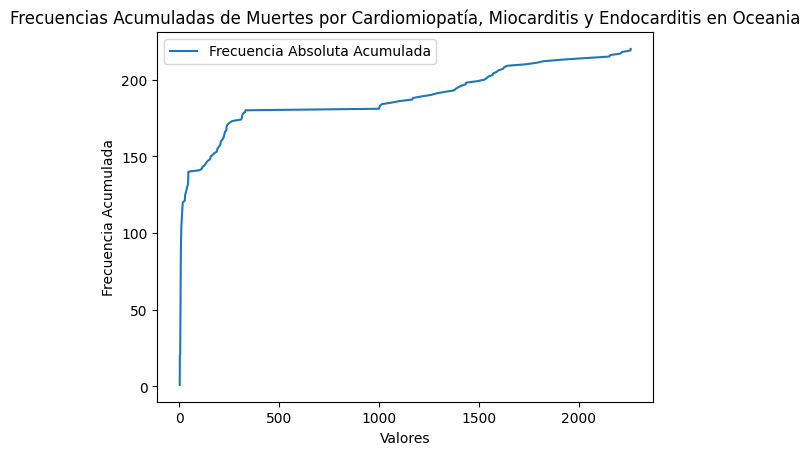

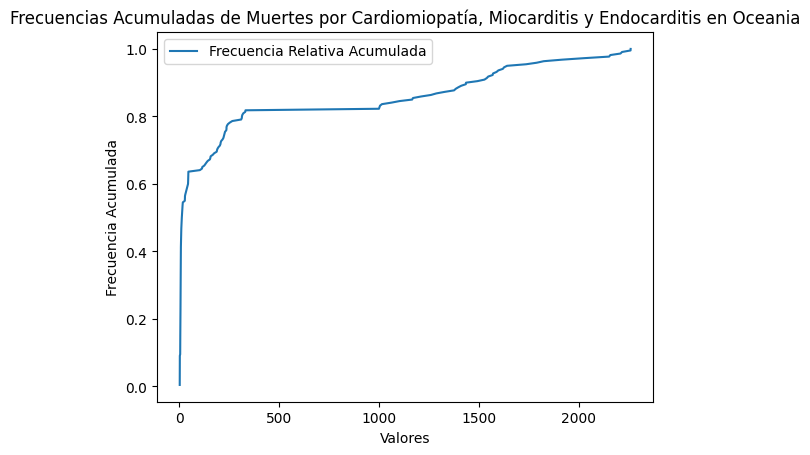

La Frecuencia Absoluta por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
6.580       2
6.720       1
6.770       1
6.860       1
6.940       1
           ..
9001.080    1
9172.710    1
9230.550    1
9283.910    1
9288.359    1
Name: count, Length: 216, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
6.580       0.009091
6.720       0.004545
6.770       0.004545
6.860       0.004545
6.940       0.004545
              ...   
9001.080    0.004545
9172.710    0.004545
9230.550    0.004545
9283.910    0.004545
9288.359    0.004545
Name: count, Length: 216, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
6.580         2
6.720         3
6.770         4
6.860         5
6.

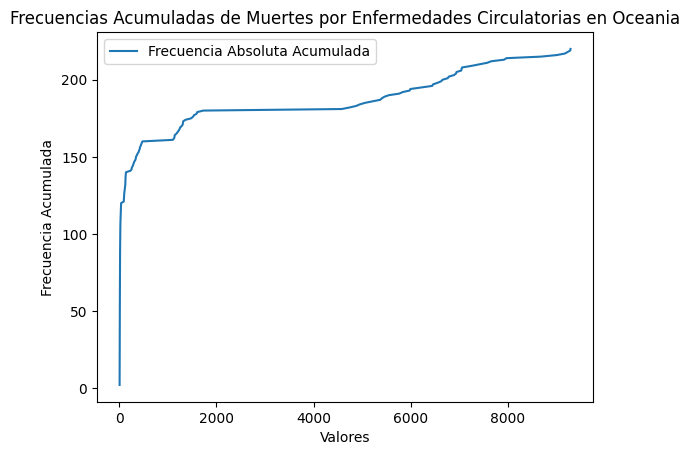

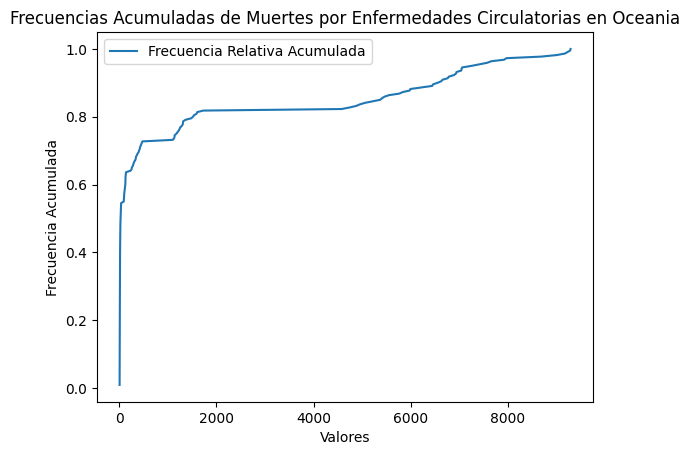

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
4.9300       1
4.9600       1
5.0600       2
5.1100       1
5.1200       1
            ..
3339.2000    1
3371.0498    1
3422.6500    1
3448.7200    1
3514.5898    1
Name: count, Length: 216, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
4.9300       0.004545
4.9600       0.004545
5.0600       0.009091
5.1100       0.004545
5.1200       0.004545
               ...   
3339.2000    0.004545
3371.0498    0.004545
3422.6500    0.004545
3448.7200    0.004545
3514.5898    0.004545
Name: count, Length: 216, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
4.9300         1
4.9600   

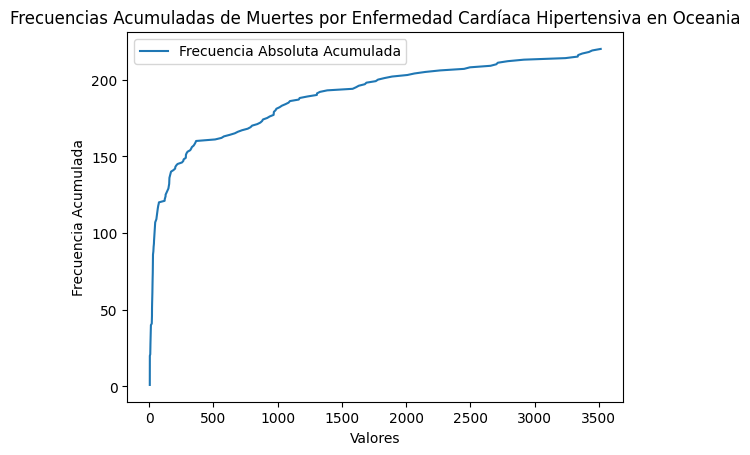

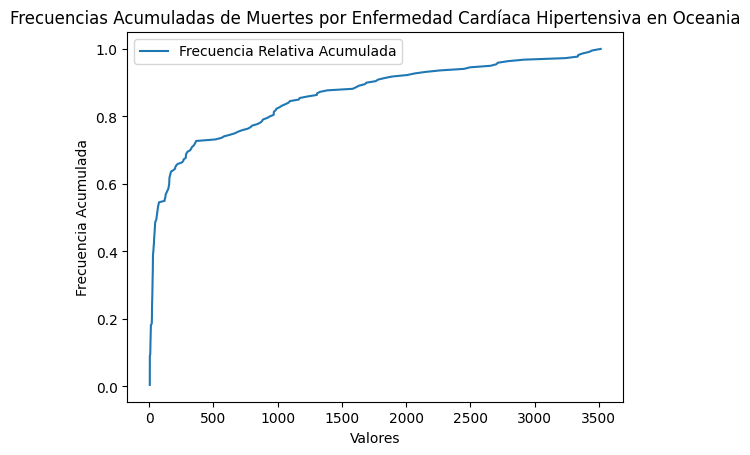

La Frecuencia Absoluta por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
15.390       1
15.440       1
15.750       1
16.010       1
16.110       2
            ..
10922.420    1
10941.430    1
10976.090    1
10980.591    1
11172.591    1
Name: count, Length: 218, dtype: int64
La Frecuencia Relativa por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
15.390       0.004545
15.440       0.004545
15.750       0.004545
16.010       0.004545
16.110       0.009091
               ...   
10922.420    0.004545
10941.430    0.004545
10976.090    0.004545
10980.591    0.004545
11172.591    0.004545
Name: count, Length: 218, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
15.390         1
15.440         2
15.750         3
16.010         4
16.110         6
            ... 
10922

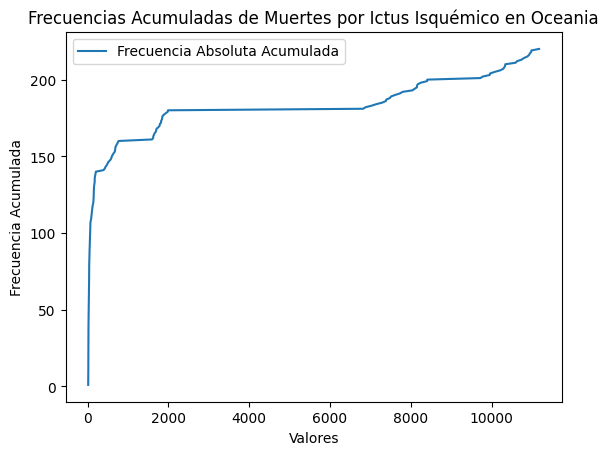

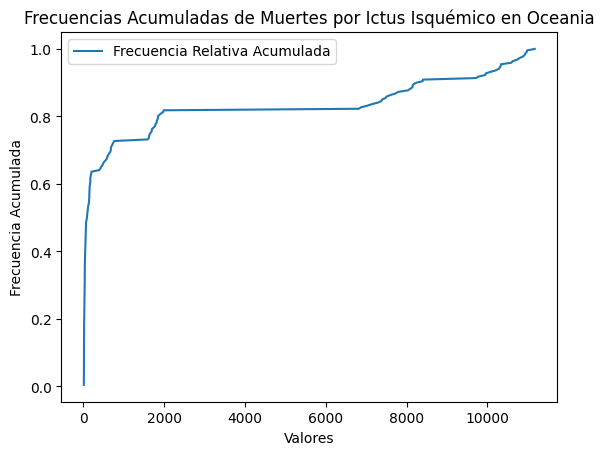

La Frecuencia Absoluta por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
29.75       1
30.20       1
31.04       1
31.14       1
31.16       1
           ..
9836.74     1
9919.37     1
9923.87     1
9977.64     1
10107.84    1
Name: count, Length: 219, dtype: int64
La Frecuencia Relativa por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
29.75       0.004545
30.20       0.004545
31.04       0.004545
31.14       0.004545
31.16       0.004545
              ...   
9836.74     0.004545
9919.37     0.004545
9923.87     0.004545
9977.64     0.004545
10107.84    0.004545
Name: count, Length: 219, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
29.75         1
30.20         2
31.04         3
31.14         4
31.16         5
           ... 
9836.74     216
99

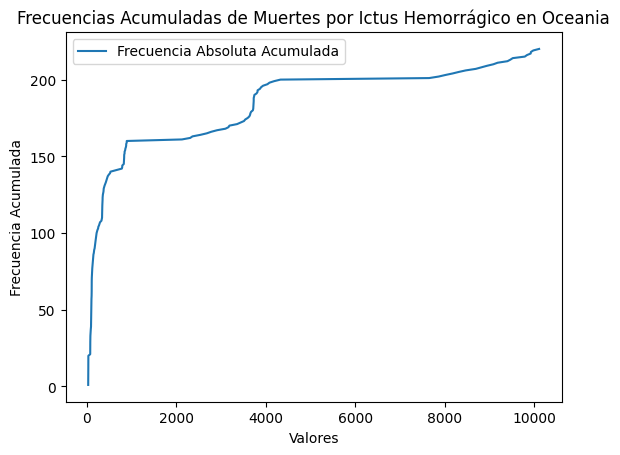

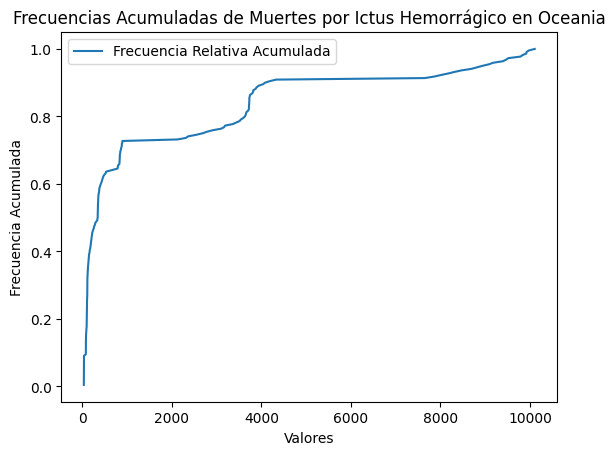

La Frecuencia Absoluta por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
75.770       1
77.500       1
78.790       1
79.220       1
80.130       1
            ..
39865.652    1
40163.850    1
40346.000    1
40530.190    1
40673.220    1
Name: count, Length: 220, dtype: int64
La Frecuencia Relativa por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
75.770       0.004545
77.500       0.004545
78.790       0.004545
79.220       0.004545
80.130       0.004545
               ...   
39865.652    0.004545
40163.850    0.004545
40346.000    0.004545
40530.190    0.004545
40673.220    0.004545
Name: count, Length: 220, dtype: float64
La Frecuencia Absoluta Acumulada por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
75.770         1
77.500         2
78.790    

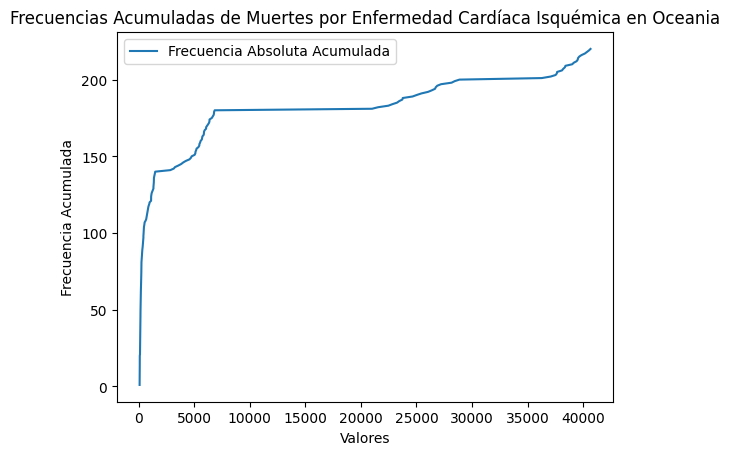

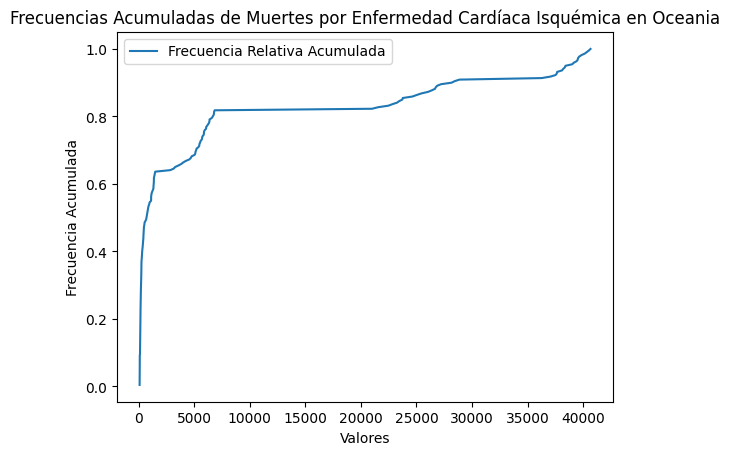

------------------------------------------------------------------------------------------


In [27]:
# Lista para almacenar los resultados
resultados = []

# Función para calcular la frecuencia absoluta de una serie de datos
def calcular_frecuencia_absoluta(data):
    return data.value_counts().sort_index()

# Iterar sobre cada continente y sus respectivos países
for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]  # Filtrar el DataFrame por los países del continente actual
    print(f"Frecuencias Acumuladas de muertes por Enfermedades Cardiovasculares en {continente}:")

    # Iterar sobre cada patología para calcular y mostrar las frecuencias acumuladas
    for patologia in patologias:
        data_patologia = df_continente[patologia]  # Obtener los datos de la patología actual
        Fabs = calcular_frecuencia_absoluta(data_patologia)  # Calcular la frecuencia absoluta
        Frel = Fabs / Fabs.sum()  # Calcular la frecuencia relativa
        Fabs_acum = Fabs.cumsum()  # Calcular la frecuencia absoluta acumulada
        Frel_acum = Frel.cumsum()  # Calcular la frecuencia relativa acumulada

        patologia_legible = reemplazar_texto(patologia)

        # Imprimir los resultados por consola
        print(f"La Frecuencia Absoluta por {patologia_legible} es:\n {Fabs}")
        print(f"La Frecuencia Relativa por {patologia_legible} es:\n {Frel}")
        print(f"La Frecuencia Absoluta Acumulada por {patologia_legible} es:\n {Fabs_acum}")
        print(f"La Frecuencia Relativa Acumulada por {patologia_legible} es:\n {Frel_acum}")

        # Almacenar los resultados en la lista
        resultados.append({
            'Continente': continente,
            'Patologia': patologia_legible,
            'Frecuencia Absoluta': Fabs,
            'Frecuencia Absoluta Acumulada': Fabs_acum
        })

        # Crear una nueva figura para cada combinación de enfermedad y continente
        plt.figure()
        plt.plot(Fabs_acum.index, Fabs_acum.values, label='Frecuencia Absoluta Acumulada')
        plt.title(f'Frecuencias Acumuladas de {patologia_legible} en {continente}')
        plt.xlabel('Valores')
        plt.ylabel('Frecuencia Acumulada')
        plt.legend()
        plt.show()

        # Crear una nueva figura para cada combinación de enfermedad y continente
        plt.figure()
        plt.plot(Frel_acum.index, Frel_acum.values, label='Frecuencia Relativa Acumulada')
        plt.title(f'Frecuencias Acumuladas de {patologia_legible} en {continente}')
        plt.xlabel('Valores')
        plt.ylabel('Frecuencia Acumulada')
        plt.legend()
        plt.show()

    print("-" * 90)


### Frecuencias absolutas relativas

### Frecuencia sobreviviente

Frecuencias Acumuladas de muertes por Enfermedades Cardiovasculares en Africa:
La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
0.84        1079
0.85        1078
0.86        1077
0.87        1078
0.88        1079
            ... 
19457.38    1079
19723.10    1079
20017.19    1079
20340.27    1079
20652.88    1079
Name: count, Length: 1051, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
0.84        9.990741e-01
0.85        9.972222e-01
0.86        9.944444e-01
0.87        9.925926e-01
0.88        9.916667e-01
                ...     
19457.38    3.703704e-03
19723.10    2.777778e-03
20017.19    1.851852e-03
20340.27    9.259259e-04
20652.88    1.898481e-14
Name: count, Length: 1051, dtype: float64


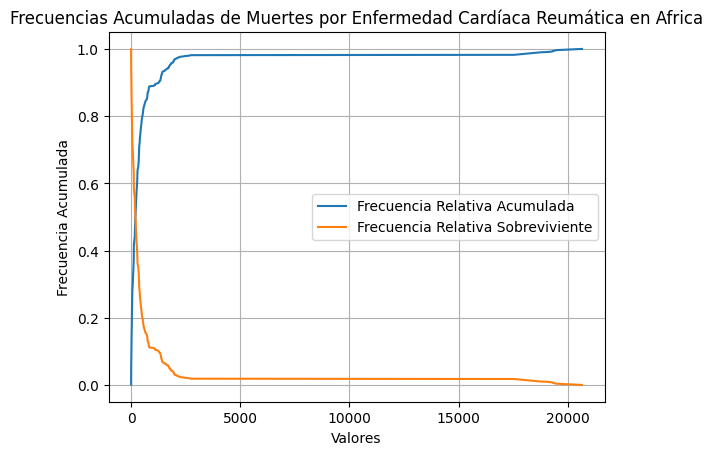

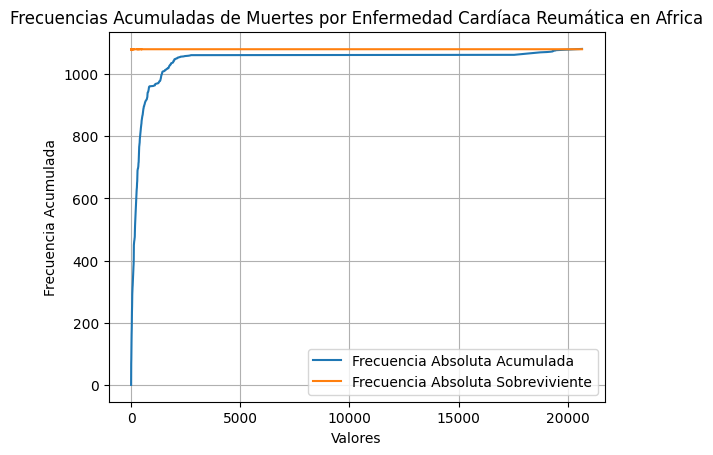

La Frecuencia Absoluta Complementaria por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
3.590        1079
3.790        1079
3.950        1079
4.140        1079
4.260        1079
             ... 
39371.770    1079
40136.400    1079
40756.310    1079
41414.742    1079
41912.140    1079
Name: count, Length: 1070, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
3.590        9.990741e-01
3.790        9.981481e-01
3.950        9.972222e-01
4.140        9.962963e-01
4.260        9.953704e-01
                 ...     
39371.770    3.703704e-03
40136.400    2.777778e-03
40756.310    1.851852e-03
41414.742    9.259259e-04
41912.140    1.920686e-14
Name: count, Length: 1070, dtype: float64


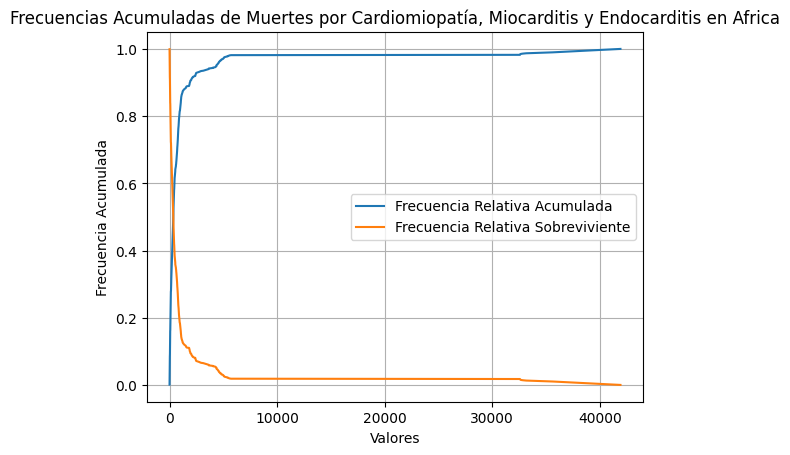

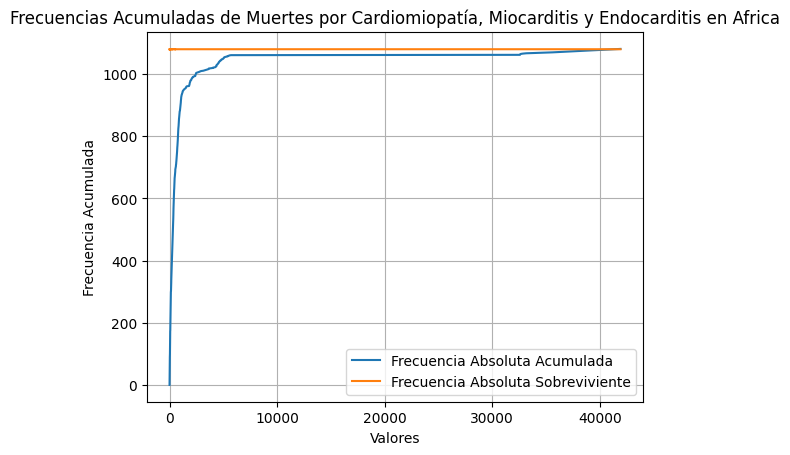

La Frecuencia Absoluta Complementaria por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
7.84        1079
8.01        1079
8.30        1079
8.67        1079
8.79        1079
            ... 
79002.25    1079
80907.11    1079
82560.66    1079
84386.80    1079
85875.71    1079
Name: count, Length: 1077, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
7.84        9.990741e-01
8.01        9.981481e-01
8.30        9.972222e-01
8.67        9.962963e-01
8.79        9.953704e-01
                ...     
79002.25    3.703704e-03
80907.11    2.777778e-03
82560.66    1.851852e-03
84386.80    9.259259e-04
85875.71    1.920686e-14
Name: count, Length: 1077, dtype: float64


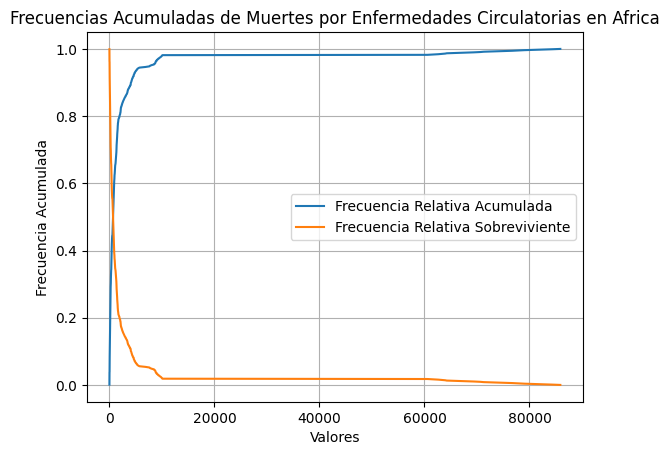

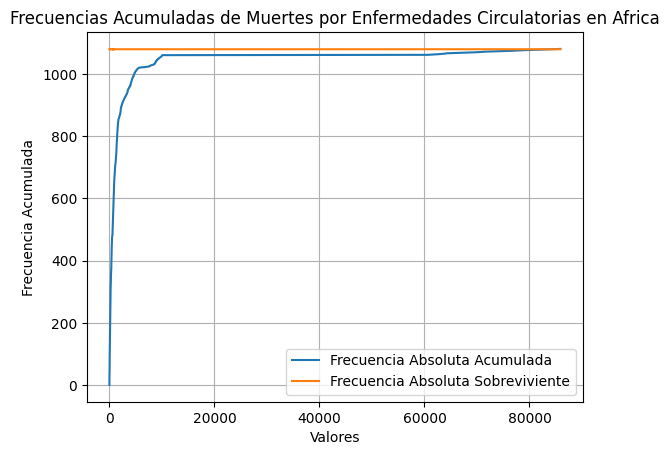

La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
4.49         1079
4.60         1079
4.91         1079
5.01         1079
5.13         1079
             ... 
157492.22    1079
160568.23    1079
163145.42    1079
166119.48    1079
168953.52    1079
Name: count, Length: 1074, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
4.49         9.990741e-01
4.60         9.981481e-01
4.91         9.972222e-01
5.01         9.962963e-01
5.13         9.953704e-01
                 ...     
157492.22    3.703704e-03
160568.23    2.777778e-03
163145.42    1.851852e-03
166119.48    9.259259e-04
168953.52    1.931788e-14
Name: count, Length: 1074, dtype: float64


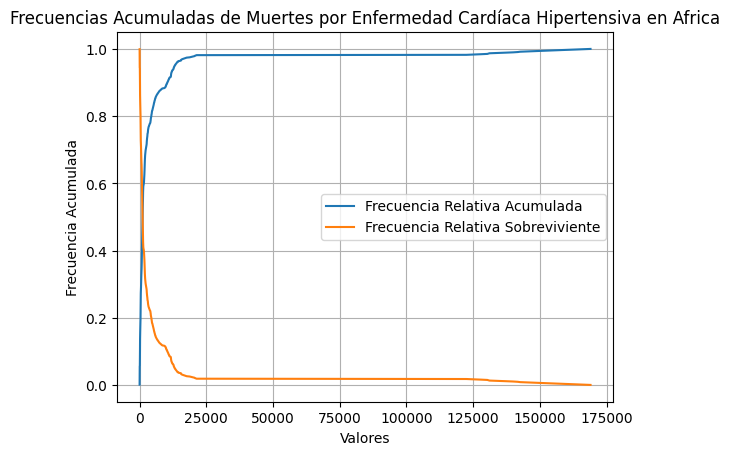

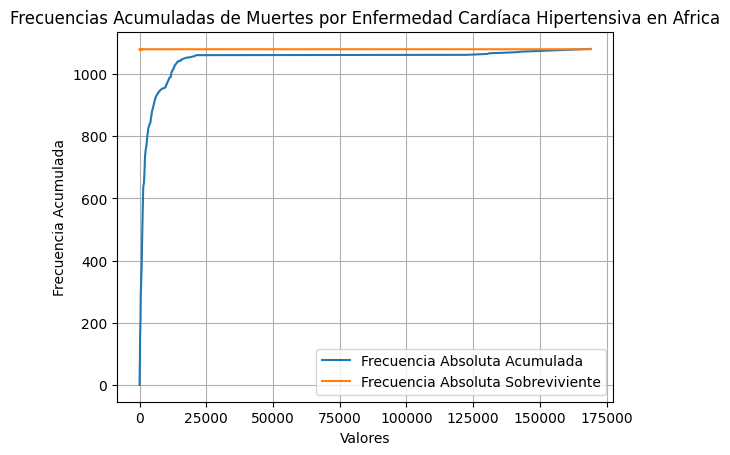

La Frecuencia Absoluta Complementaria por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
20.72        1079
21.32        1079
21.41        1079
22.23        1079
22.44        1079
             ... 
202617.55    1079
208114.31    1079
212977.38    1079
218254.10    1079
222601.17    1079
Name: count, Length: 1078, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
20.72        9.990741e-01
21.32        9.981481e-01
21.41        9.972222e-01
22.23        9.962963e-01
22.44        9.953704e-01
                 ...     
202617.55    3.703704e-03
208114.31    2.777778e-03
212977.38    1.851852e-03
218254.10    9.259259e-04
222601.17    1.920686e-14
Name: count, Length: 1078, dtype: float64


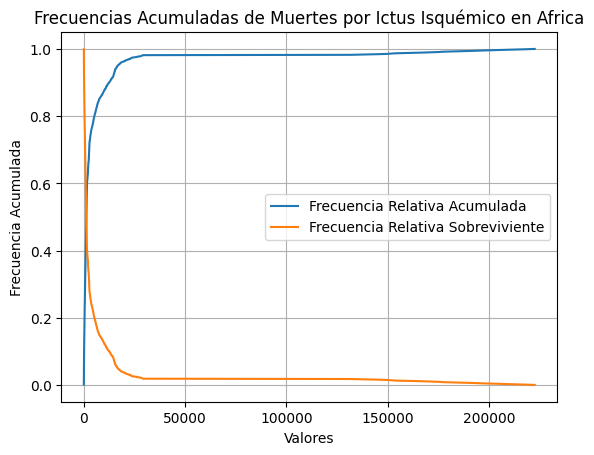

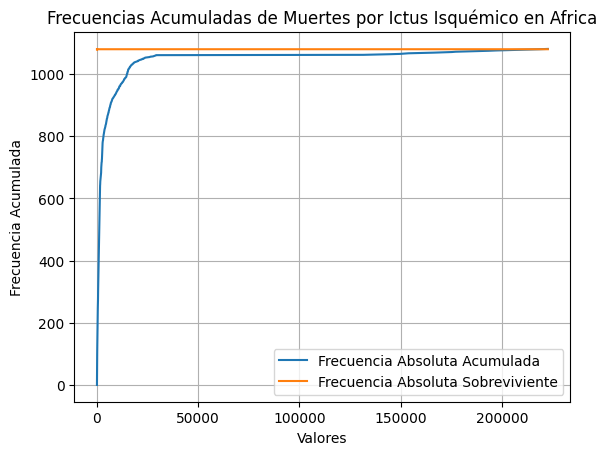

La Frecuencia Absoluta Complementaria por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
24.60        1079
24.63        1079
25.12        1079
26.29        1079
26.51        1079
             ... 
308043.97    1079
311411.28    1079
313122.80    1079
316123.34    1079
319787.00    1079
Name: count, Length: 1077, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
24.60        9.990741e-01
24.63        9.981481e-01
25.12        9.972222e-01
26.29        9.962963e-01
26.51        9.953704e-01
                 ...     
308043.97    3.703704e-03
311411.28    2.777778e-03
313122.80    1.851852e-03
316123.34    9.259259e-04
319787.00    1.909584e-14
Name: count, Length: 1077, dtype: float64


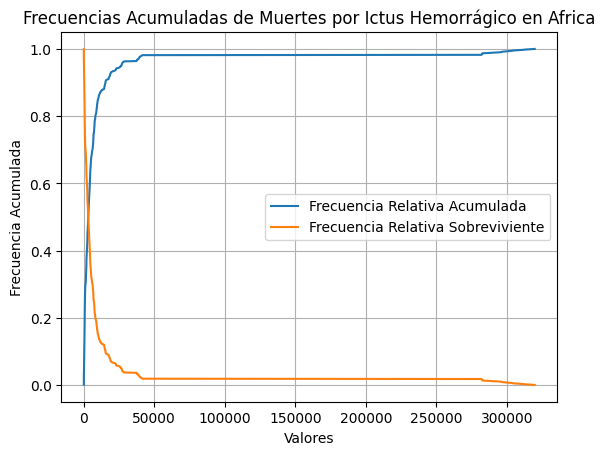

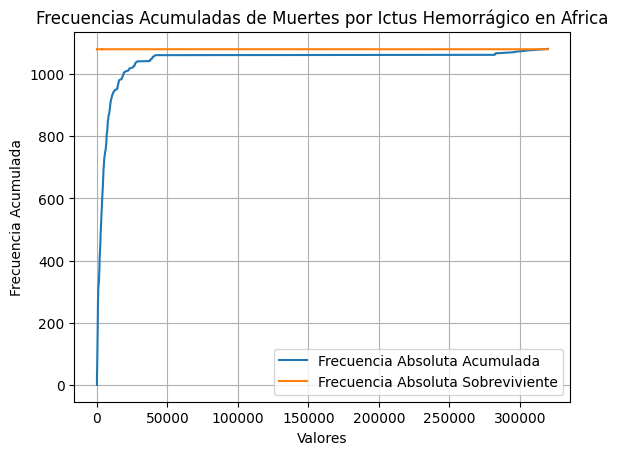

La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
62.27        1079
63.46        1079
64.86        1079
67.25        1079
68.50        1079
             ... 
700492.70    1079
711311.40    1079
723322.70    1079
743241.20    1079
759545.20    1079
Name: count, Length: 1080, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
62.27        9.990741e-01
63.46        9.981481e-01
64.86        9.972222e-01
67.25        9.962963e-01
68.50        9.953704e-01
                 ...     
700492.70    3.703704e-03
711311.40    2.777778e-03
723322.70    1.851852e-03
743241.20    9.259259e-04
759545.20    1.920686e-14
Name: count, Length: 1080, dtype: float64


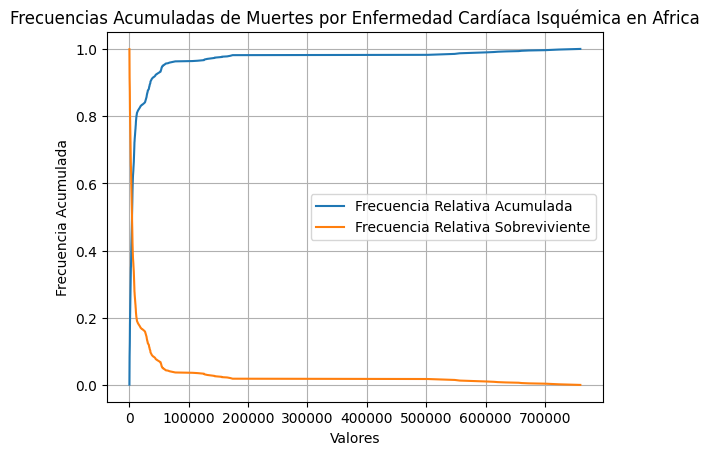

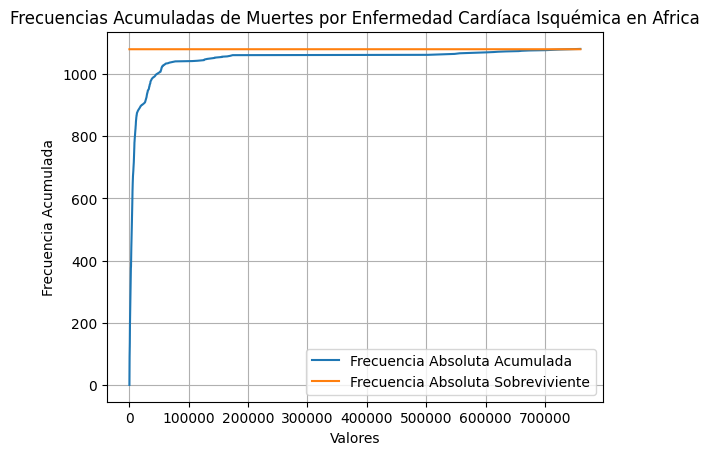

------------------------------------------------------------------------------------------
Frecuencias Acumuladas de muertes por Enfermedades Cardiovasculares en America del Norte:
La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
0.00       433
0.09       439
0.19       439
0.20       439
0.24       439
          ... 
6487.09    439
6492.11    439
6593.87    439
6691.04    439
6772.00    439
Name: count, Length: 407, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
0.00       9.840909e-01
0.09       9.818182e-01
0.19       9.795455e-01
0.20       9.772727e-01
0.24       9.750000e-01
               ...     
6487.09    9.090909e-03
6492.11    6.818182e-03
6593.87    4.545455e-03
6691.04    2.272727e-03
6772.00   -7.327472e-15
Name: count, Le

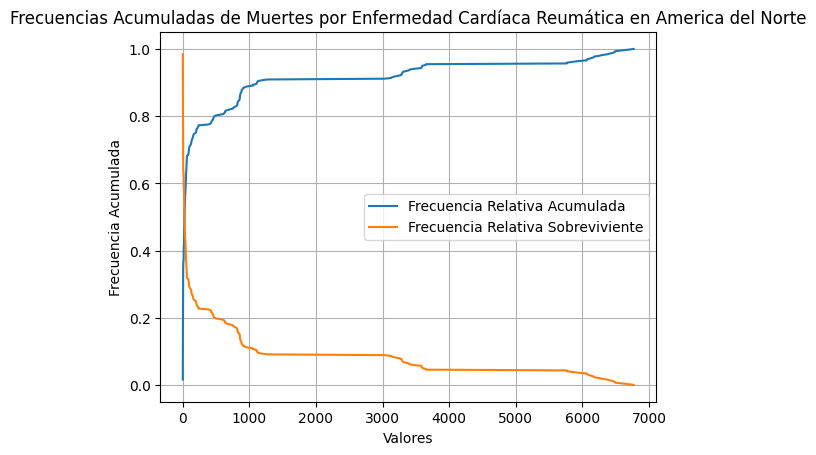

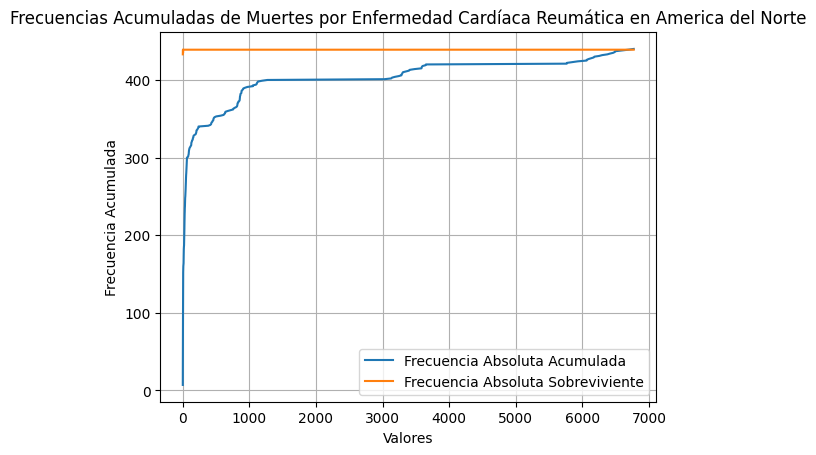

La Frecuencia Absoluta Complementaria por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
1.23        439
1.67        439
1.79        439
2.00        439
2.05        439
           ... 
39512.35    439
39797.33    439
39922.47    439
40191.20    439
40494.66    439
Name: count, Length: 438, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
1.23        9.977273e-01
1.67        9.954545e-01
1.79        9.931818e-01
2.00        9.909091e-01
2.05        9.886364e-01
                ...     
39512.35    9.090909e-03
39797.33    6.818182e-03
39922.47    4.545455e-03
40191.20    2.272727e-03
40494.66   -7.105427e-15
Name: count, Length: 438, dtype: float64


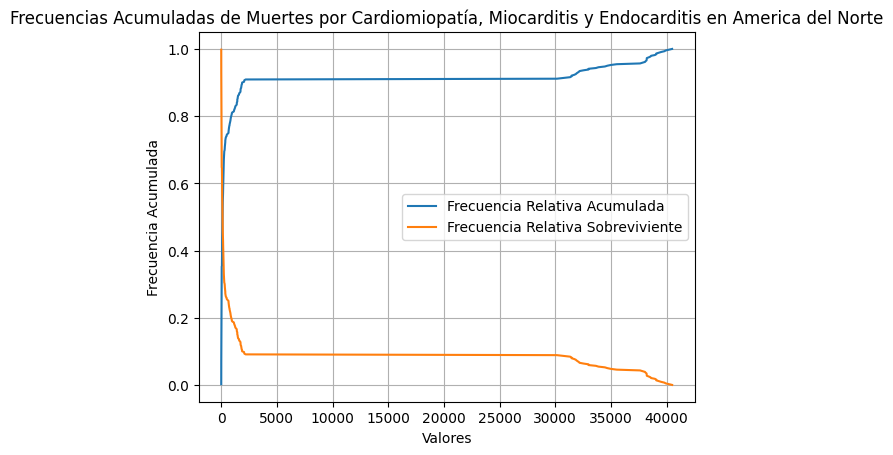

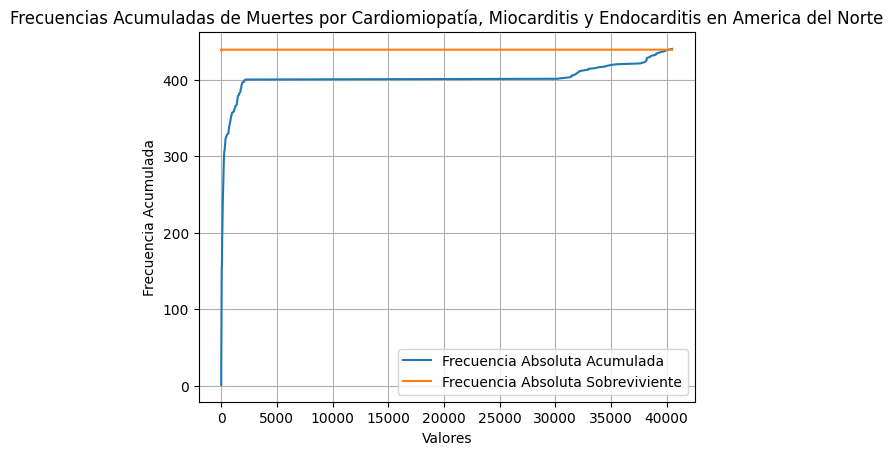

La Frecuencia Absoluta Complementaria por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
14.40        439
14.52        439
14.73        439
16.99        439
17.50        439
            ... 
130131.31    439
133030.39    439
135864.75    439
138203.08    439
140496.17    439
Name: count, Length: 437, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
14.40        9.977273e-01
14.52        9.954545e-01
14.73        9.931818e-01
16.99        9.909091e-01
17.50        9.886364e-01
                 ...     
130131.31    9.090909e-03
133030.39    6.818182e-03
135864.75    4.545455e-03
138203.08    2.272727e-03
140496.17   -7.105427e-15
Name: count, Length: 437, dtype: float64


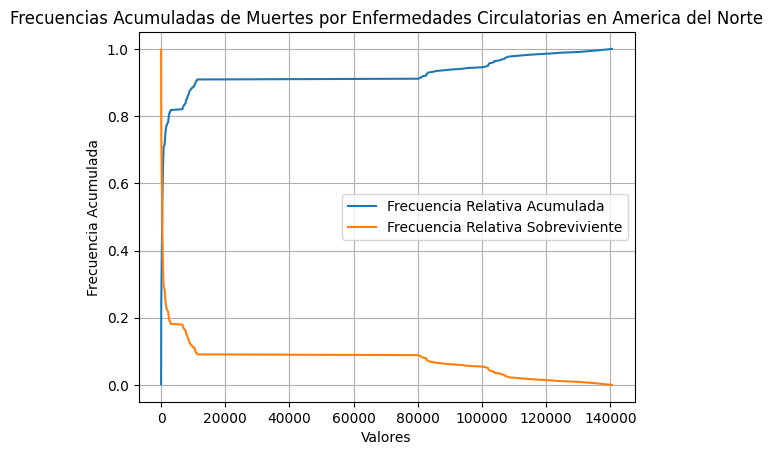

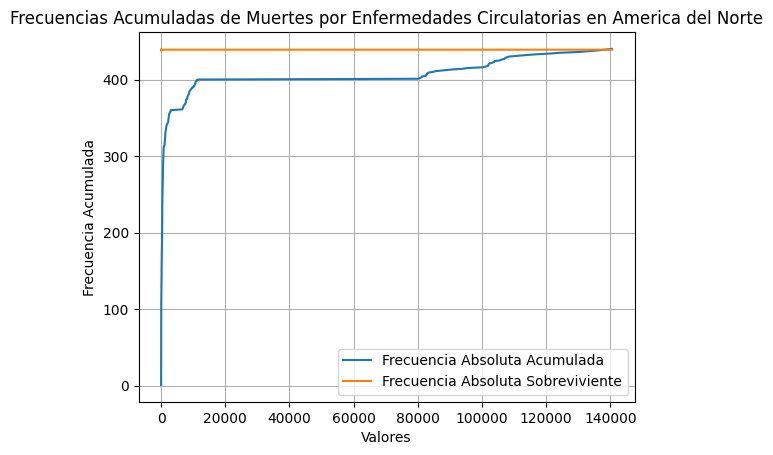

La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
0.00         439
1.44         439
2.61         439
5.05         439
6.60         439
            ... 
88564.22     439
93023.07     439
97884.39     439
99771.36     439
100504.29    439
Name: count, Length: 435, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
0.00         9.977273e-01
1.44         9.954545e-01
2.61         9.931818e-01
5.05         9.909091e-01
6.60         9.886364e-01
                 ...     
88564.22     9.090909e-03
93023.07     6.818182e-03
97884.39     4.545455e-03
99771.36     2.272727e-03
100504.29   -7.105427e-15
Name: count, Length: 435, dtype: float64


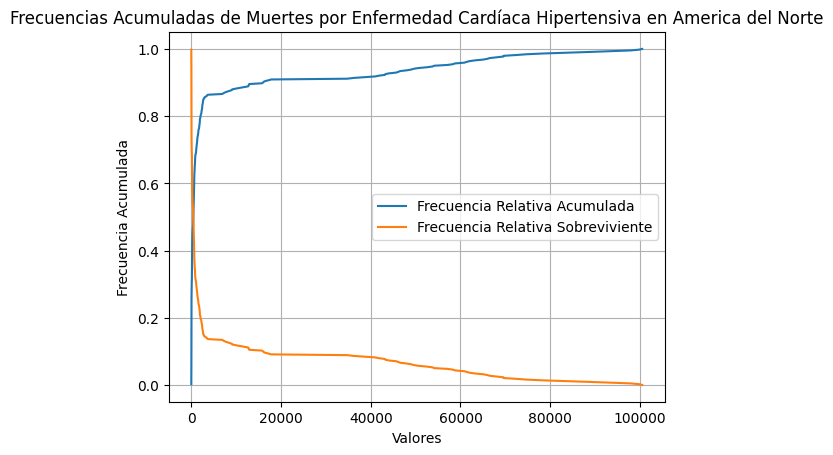

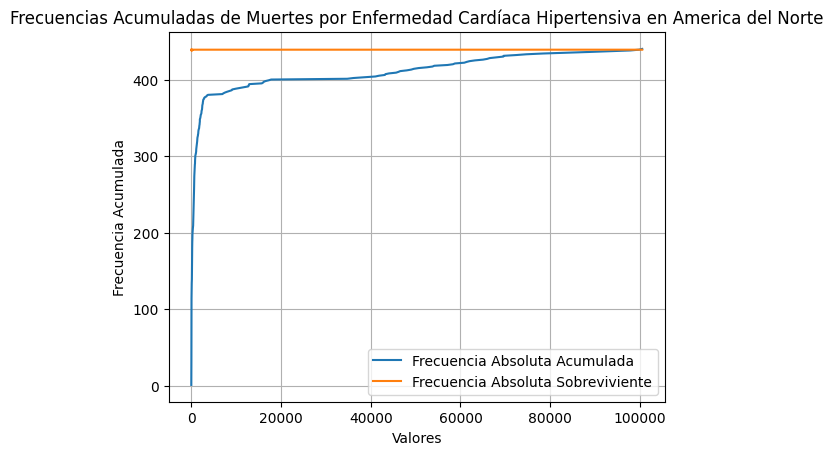

La Frecuencia Absoluta Complementaria por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
18.06        439
19.76        439
20.19        439
21.92        439
22.37        439
            ... 
144782.52    439
146436.77    439
147397.98    439
147605.08    439
150389.78    439
Name: count, Length: 438, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
18.06        9.977273e-01
19.76        9.954545e-01
20.19        9.931818e-01
21.92        9.909091e-01
22.37        9.886364e-01
                 ...     
144782.52    9.090909e-03
146436.77    6.818182e-03
147397.98    4.545455e-03
147605.08    2.272727e-03
150389.78   -7.105427e-15
Name: count, Length: 438, dtype: float64


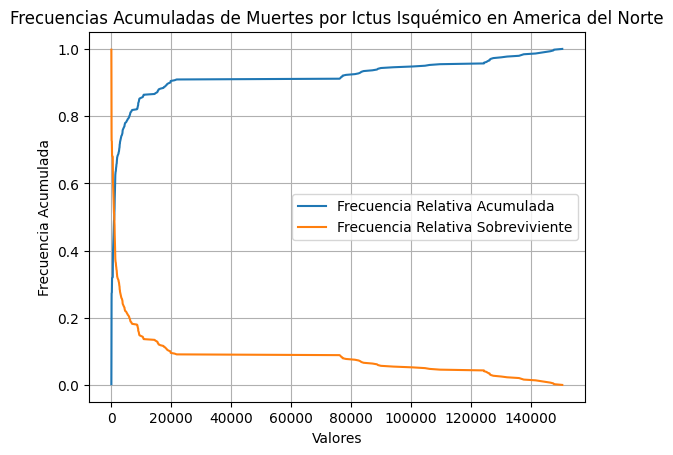

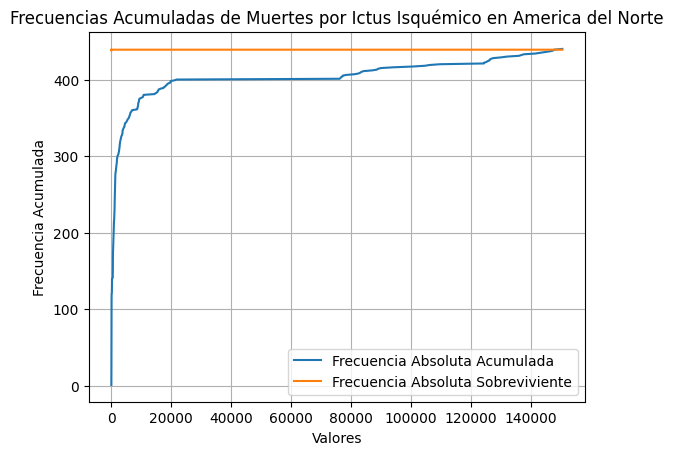

La Frecuencia Absoluta Complementaria por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
19.59        439
20.18        439
21.92        439
22.05        439
22.20        439
            ... 
110249.72    439
111734.02    439
114282.62    439
115814.10    439
117863.97    439
Name: count, Length: 435, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
19.59        9.977273e-01
20.18        9.954545e-01
21.92        9.931818e-01
22.05        9.909091e-01
22.20        9.886364e-01
                 ...     
110249.72    9.090909e-03
111734.02    6.818182e-03
114282.62    4.545455e-03
115814.10    2.272727e-03
117863.97   -7.105427e-15
Name: count, Length: 435, dtype: float64


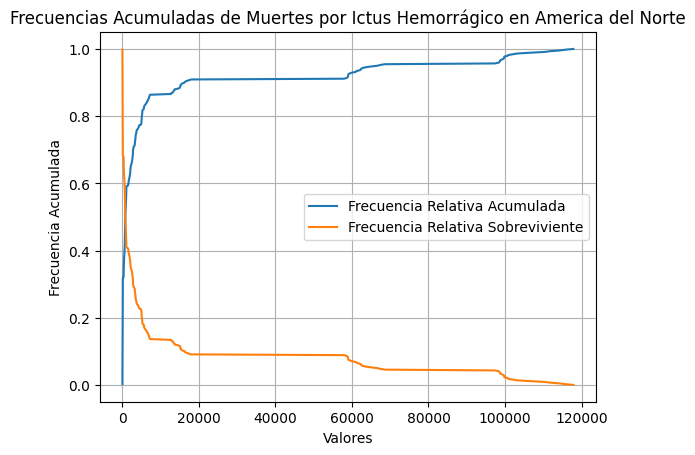

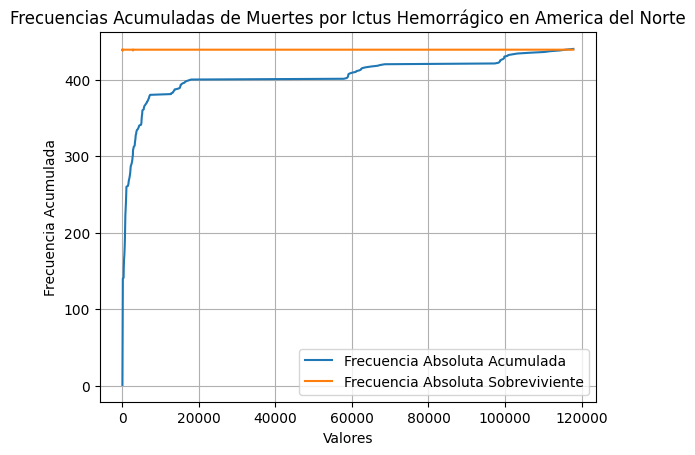

La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
52.45        439
56.61        439
65.10        439
67.10        439
76.19        439
            ... 
738099.70    439
746474.90    439
750899.60    439
753114.75    439
763962.44    439
Name: count, Length: 440, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
52.45        9.977273e-01
56.61        9.954545e-01
65.10        9.931818e-01
67.10        9.909091e-01
76.19        9.886364e-01
                 ...     
738099.70    9.090909e-03
746474.90    6.818182e-03
750899.60    4.545455e-03
753114.75    2.272727e-03
763962.44   -7.105427e-15
Name: count, Length: 440, dtype: float64


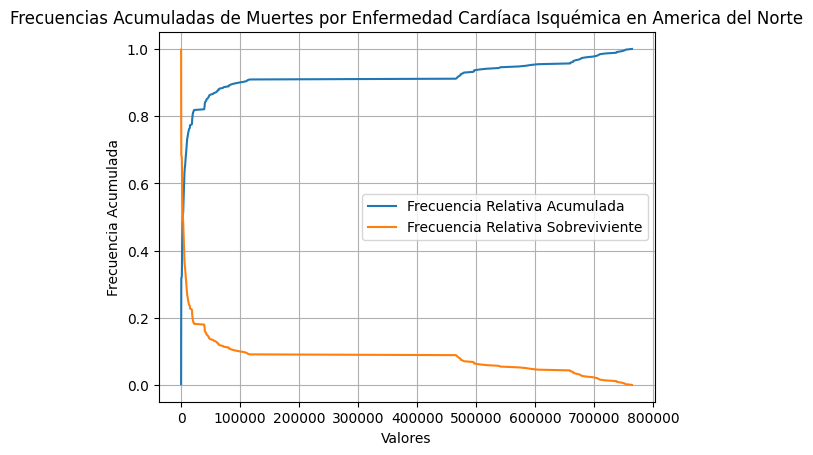

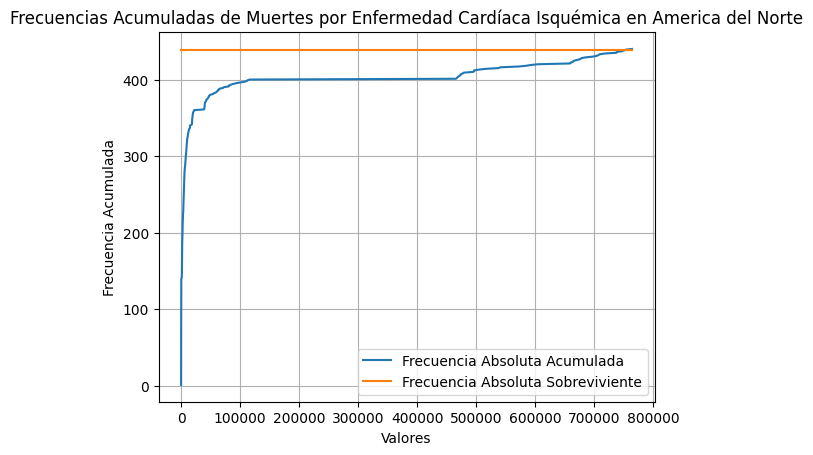

------------------------------------------------------------------------------------------
Frecuencias Acumuladas de muertes por Enfermedades Cardiovasculares en America del Sur:
La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
5.4900       259
5.5400       259
5.6000       259
5.6100       259
5.7400       259
            ... 
3852.3300    259
3913.7200    259
3927.4200    259
3929.3098    259
4132.8003    259
Name: count, Length: 259, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
5.4900       9.961538e-01
5.5400       9.923077e-01
5.6000       9.884615e-01
5.6100       9.846154e-01
5.7400       9.807692e-01
                 ...     
3852.3300    1.538462e-02
3913.7200    1.153846e-02
3927.4200    7.692308e-03
3929.3098    3.846154e-03

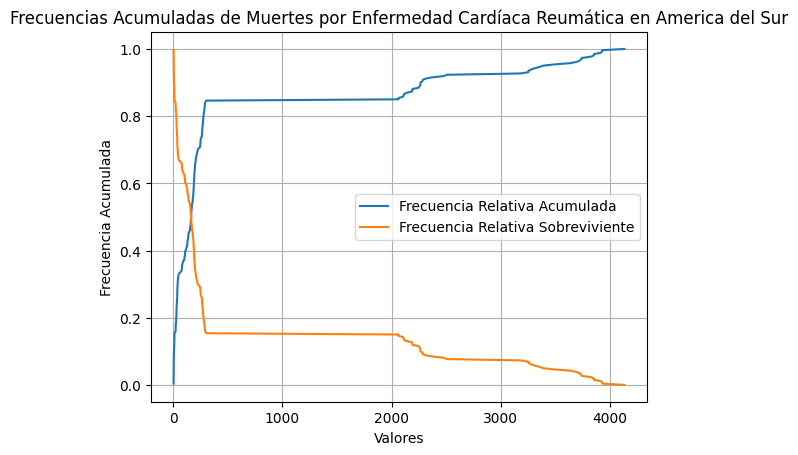

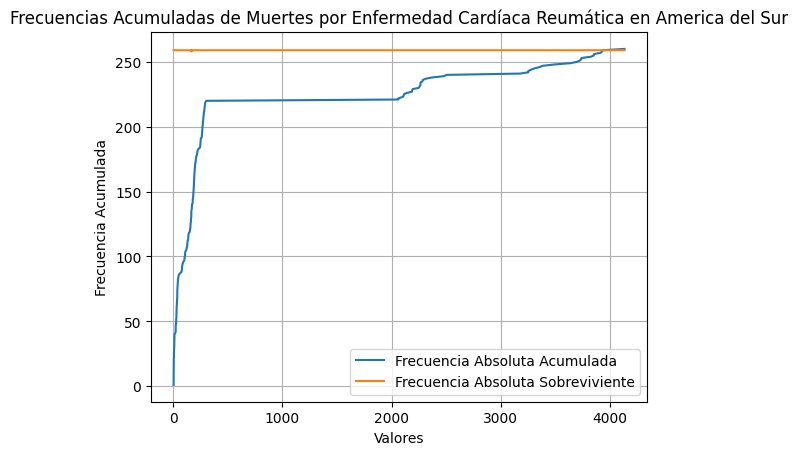

La Frecuencia Absoluta Complementaria por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
20.020       259
22.010       259
22.270       259
22.530       259
22.800       259
            ... 
26624.418    259
26991.300    259
27016.250    259
27413.060    259
28142.750    259
Name: count, Length: 260, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
20.020       9.961538e-01
22.010       9.923077e-01
22.270       9.884615e-01
22.530       9.846154e-01
22.800       9.807692e-01
                 ...     
26624.418    1.538462e-02
26991.300    1.153846e-02
27016.250    7.692308e-03
27413.060    3.846154e-03
28142.750    3.108624e-15
Name: count, Length: 260, dtype: float64


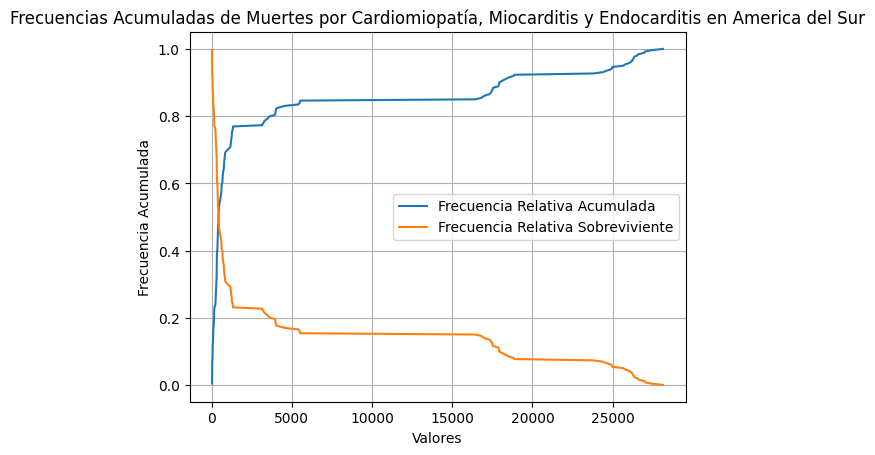

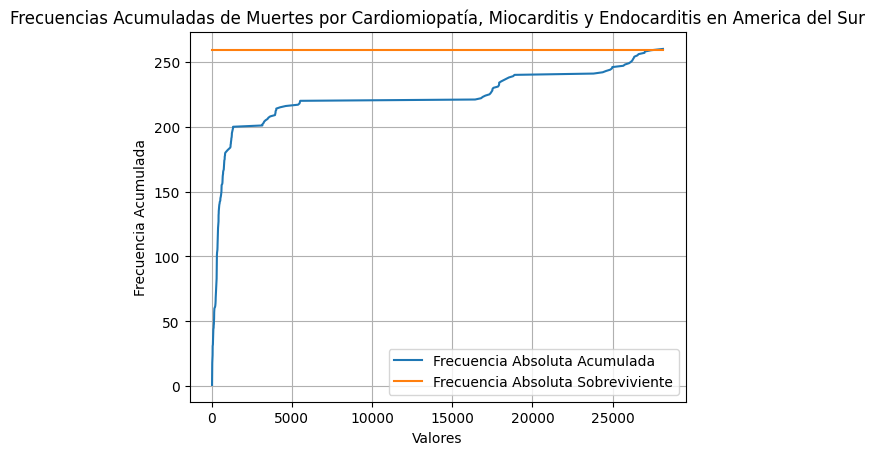

La Frecuencia Absoluta Complementaria por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
39.040       259
42.550       259
43.990       259
44.420       259
44.730       259
            ... 
71430.110    259
74907.460    259
76301.810    259
78637.980    259
79477.734    259
Name: count, Length: 260, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
39.040       9.961538e-01
42.550       9.923077e-01
43.990       9.884615e-01
44.420       9.846154e-01
44.730       9.807692e-01
                 ...     
71430.110    1.538462e-02
74907.460    1.153846e-02
76301.810    7.692308e-03
78637.980    3.846154e-03
79477.734    3.108624e-15
Name: count, Length: 260, dtype: float64


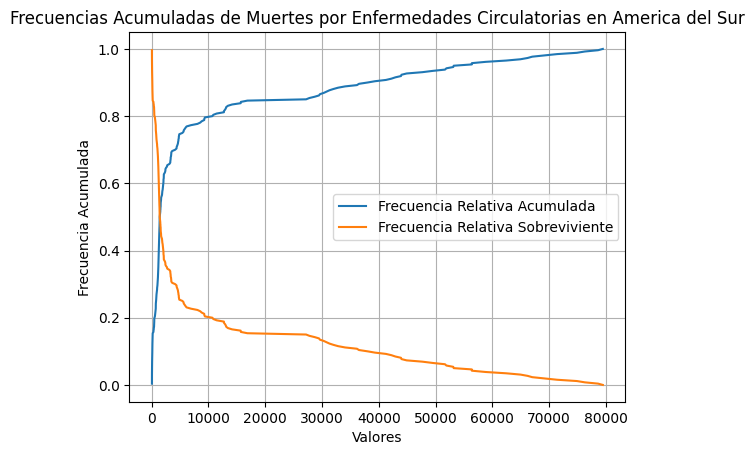

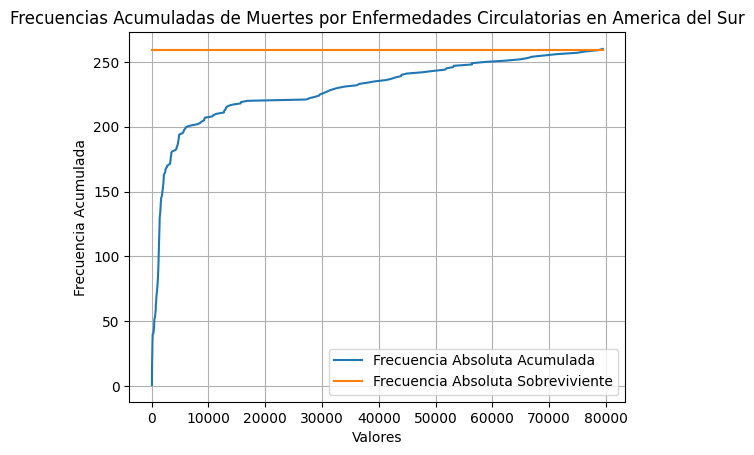

La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
70.750       259
75.000       259
77.250       259
77.940       259
77.950       259
            ... 
51390.860    259
53653.867    259
57164.020    259
57523.770    259
57549.332    259
Name: count, Length: 260, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
70.750       9.961538e-01
75.000       9.923077e-01
77.250       9.884615e-01
77.940       9.846154e-01
77.950       9.807692e-01
                 ...     
51390.860    1.538462e-02
53653.867    1.153846e-02
57164.020    7.692308e-03
57523.770    3.846154e-03
57549.332    3.108624e-15
Name: count, Length: 260, dtype: float64


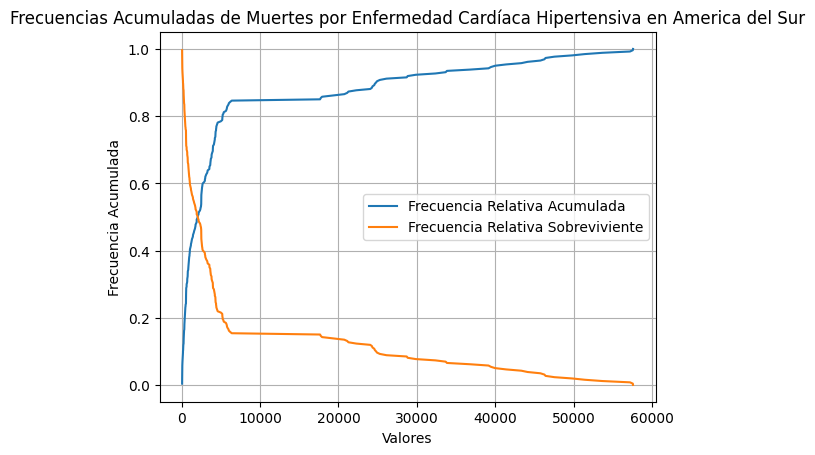

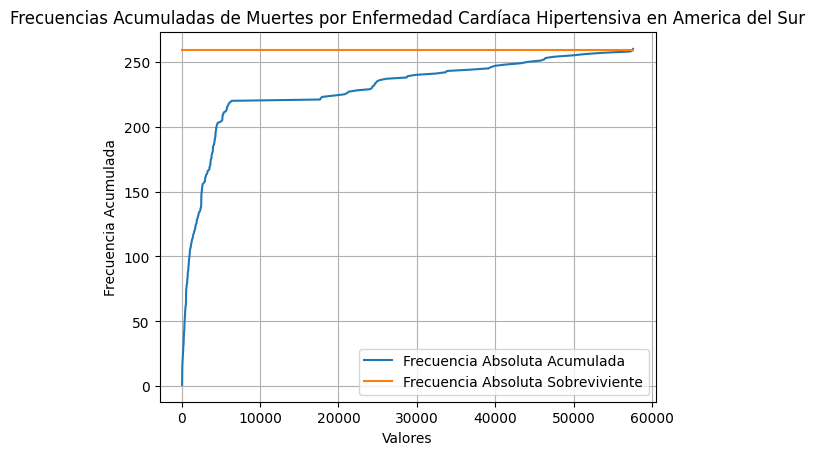

La Frecuencia Absoluta Complementaria por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
159.000       259
173.220       259
174.700       259
175.140       259
177.390       259
             ... 
111461.516    259
112430.830    259
113697.450    259
113910.890    259
116831.370    259
Name: count, Length: 260, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
159.000       9.961538e-01
173.220       9.923077e-01
174.700       9.884615e-01
175.140       9.846154e-01
177.390       9.807692e-01
                  ...     
111461.516    1.538462e-02
112430.830    1.153846e-02
113697.450    7.692308e-03
113910.890    3.846154e-03
116831.370    3.108624e-15
Name: count, Length: 260, dtype: float64


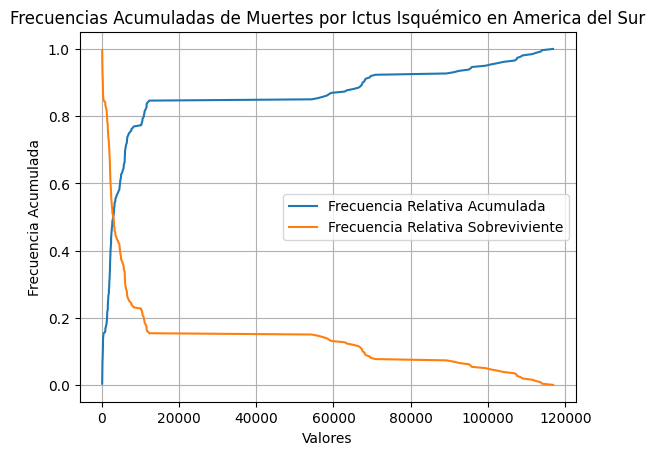

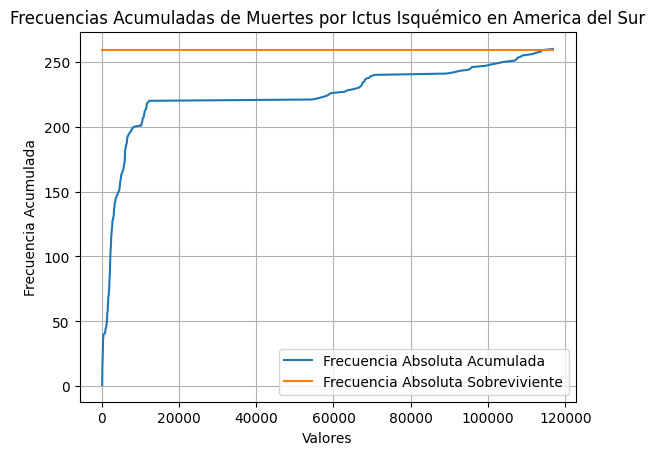

La Frecuencia Absoluta Complementaria por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
243.940      259
246.690      259
248.580      259
251.130      259
254.770      259
            ... 
93601.140    259
94716.630    259
94762.350    259
95542.016    259
95568.690    259
Name: count, Length: 260, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
243.940      9.961538e-01
246.690      9.923077e-01
248.580      9.884615e-01
251.130      9.846154e-01
254.770      9.807692e-01
                 ...     
93601.140    1.538462e-02
94716.630    1.153846e-02
94762.350    7.692308e-03
95542.016    3.846154e-03
95568.690    3.108624e-15
Name: count, Length: 260, dtype: float64


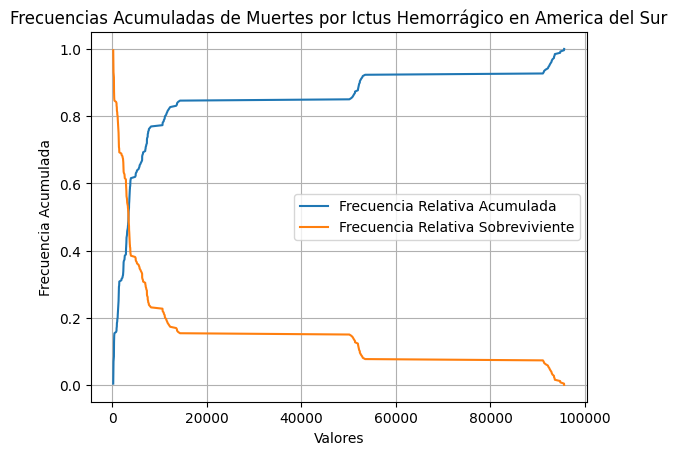

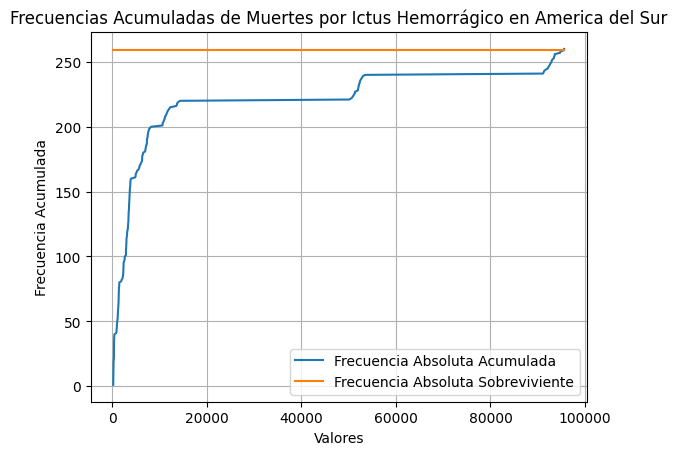

La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
383.98       259
401.88       259
401.98       259
402.35       259
403.00       259
            ... 
319031.44    259
329473.50    259
332213.12    259
333533.47    259
340410.97    259
Name: count, Length: 260, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
383.98       9.961538e-01
401.88       9.923077e-01
401.98       9.884615e-01
402.35       9.846154e-01
403.00       9.807692e-01
                 ...     
319031.44    1.538462e-02
329473.50    1.153846e-02
332213.12    7.692308e-03
333533.47    3.846154e-03
340410.97    3.108624e-15
Name: count, Length: 260, dtype: float64


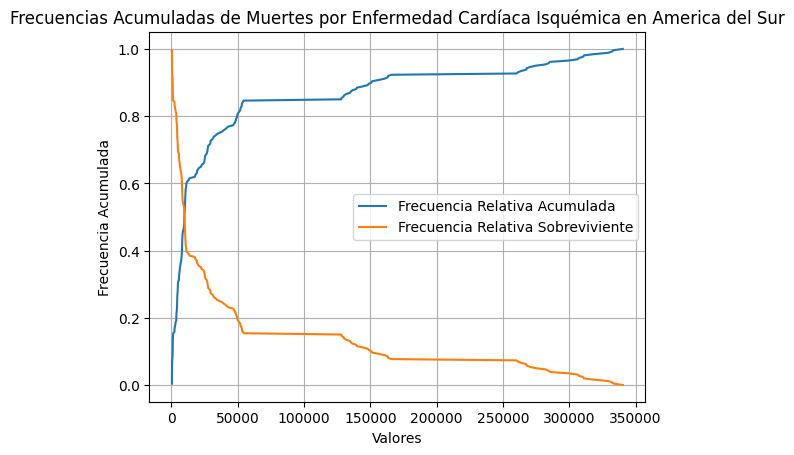

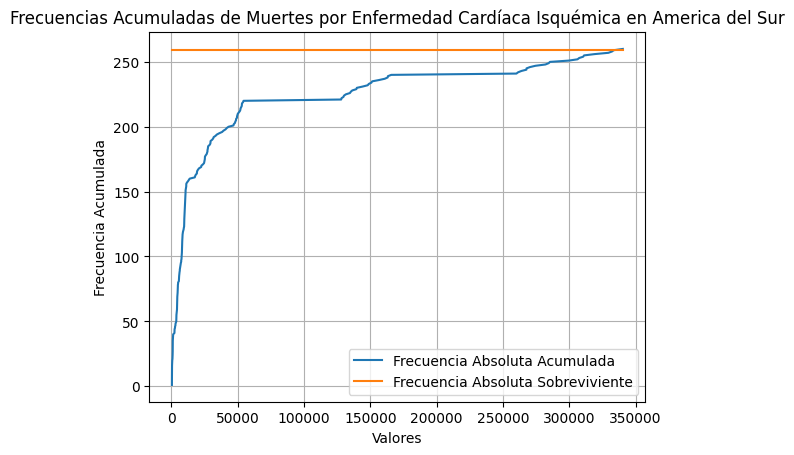

------------------------------------------------------------------------------------------
Frecuencias Acumuladas de muertes por Enfermedades Cardiovasculares en Asia:
La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
2.38         939
3.11         939
3.19         939
3.22         939
3.25         939
            ... 
266637.30    939
272691.47    939
276988.28    939
279125.80    939
281037.22    939
Name: count, Length: 929, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
2.38         9.989362e-01
3.11         9.978723e-01
3.19         9.968085e-01
3.22         9.957447e-01
3.25         9.946809e-01
                 ...     
266637.30    4.255319e-03
272691.47    3.191489e-03
276988.28    2.127660e-03
279125.80    1.063830e-03
281037.22 

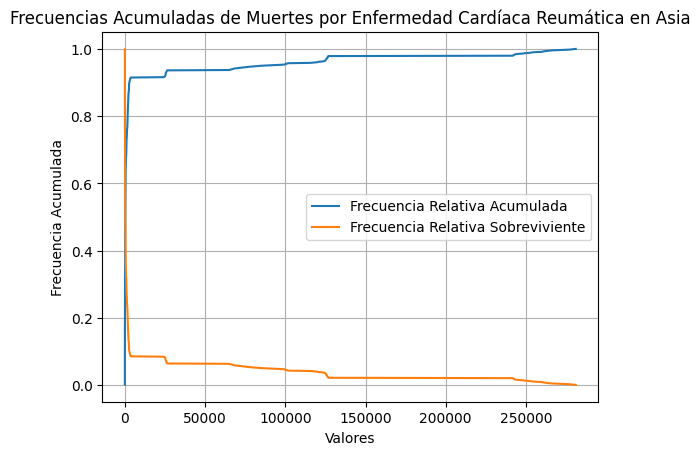

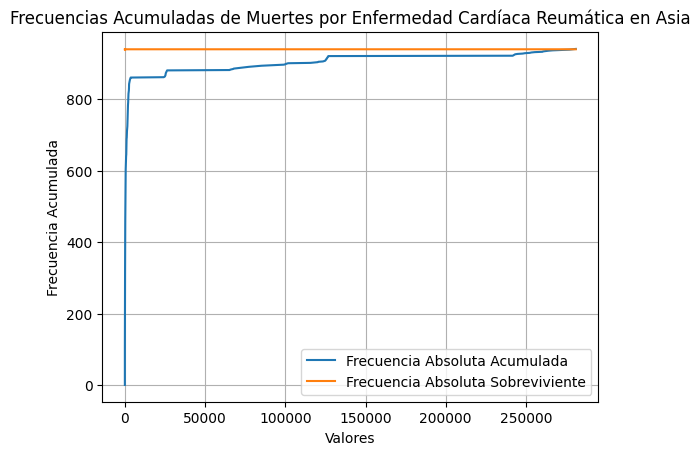

La Frecuencia Absoluta Complementaria por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
3.460        939
3.530        939
3.620        939
3.740        939
3.810        939
            ... 
91913.340    939
93881.290    939
95387.130    939
96893.984    939
98310.586    939
Name: count, Length: 936, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
3.460        9.989362e-01
3.530        9.978723e-01
3.620        9.968085e-01
3.740        9.957447e-01
3.810        9.946809e-01
                 ...     
91913.340    4.255319e-03
93881.290    3.191489e-03
95387.130    2.127660e-03
96893.984    1.063830e-03
98310.586   -7.993606e-15
Name: count, Length: 936, dtype: float64


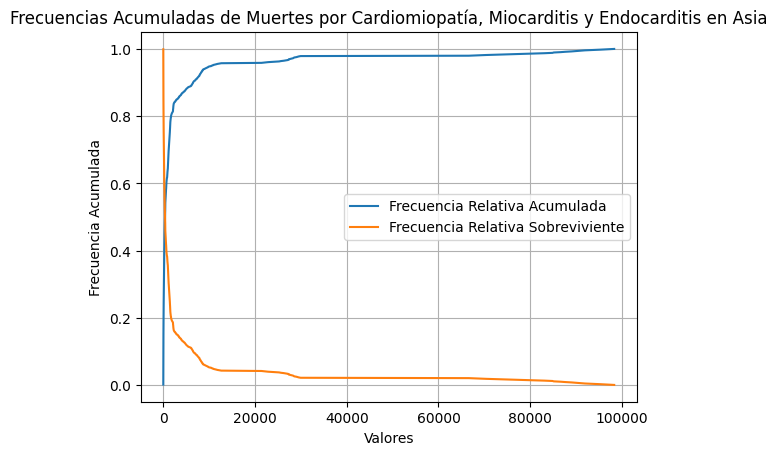

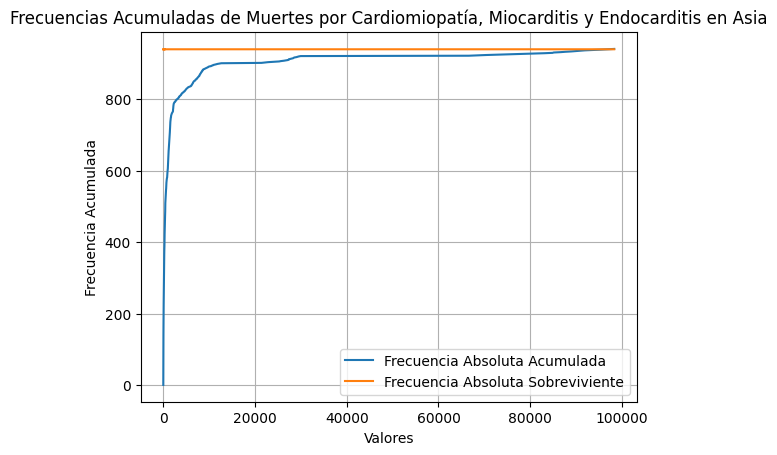

La Frecuencia Absoluta Complementaria por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
14.65        939
15.01        939
15.14        939
16.58        939
16.94        939
            ... 
327228.03    939
343853.56    939
360083.22    939
371115.75    939
379218.47    939
Name: count, Length: 938, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
14.65        9.989362e-01
15.01        9.978723e-01
15.14        9.968085e-01
16.58        9.957447e-01
16.94        9.946809e-01
                 ...     
327228.03    4.255319e-03
343853.56    3.191489e-03
360083.22    2.127660e-03
371115.75    1.063830e-03
379218.47   -7.549517e-15
Name: count, Length: 938, dtype: float64


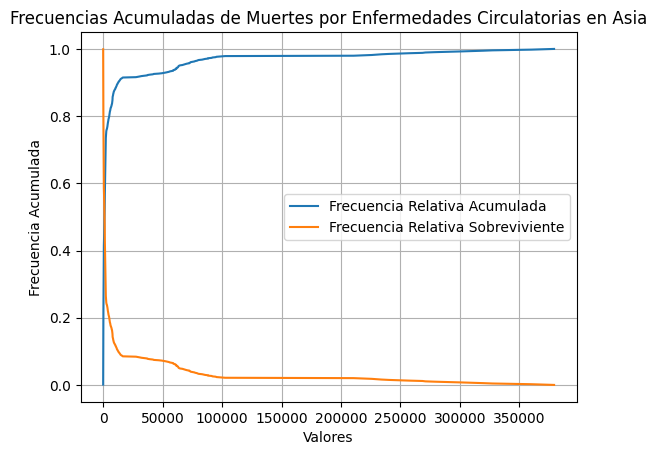

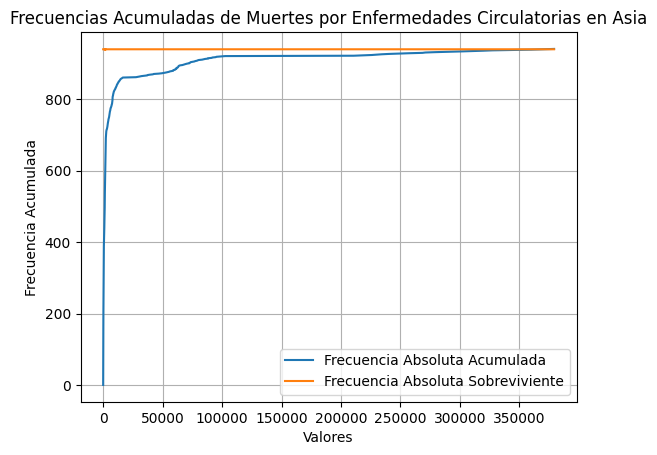

La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
9.49         939
9.69         939
9.99         939
10.55        939
10.64        939
            ... 
597123.10    939
622403.56    939
640159.70    939
649710.44    939
658448.20    939
Name: count, Length: 938, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
9.49         9.989362e-01
9.69         9.978723e-01
9.99         9.968085e-01
10.55        9.957447e-01
10.64        9.946809e-01
                 ...     
597123.10    4.255319e-03
622403.56    3.191489e-03
640159.70    2.127660e-03
649710.44    1.063830e-03
658448.20   -7.771561e-15
Name: count, Length: 938, dtype: float64


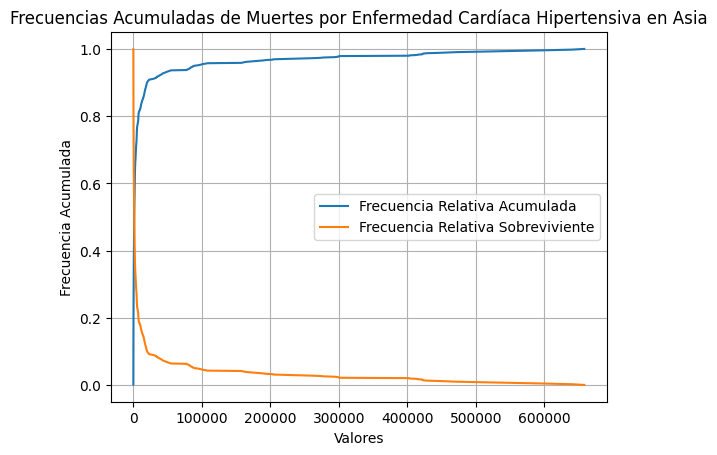

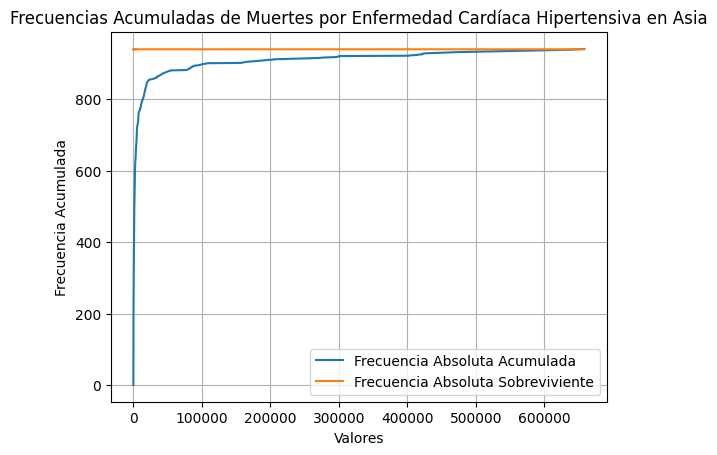

La Frecuencia Absoluta Complementaria por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
37.77         939
38.82         939
40.51         939
43.64         939
44.21         939
             ... 
1689184.90    939
1755075.80    939
1817979.50    939
1869142.00    939
1917909.50    939
Name: count, Length: 939, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
37.77         9.989362e-01
38.82         9.978723e-01
40.51         9.968085e-01
43.64         9.957447e-01
44.21         9.946809e-01
                  ...     
1689184.90    4.255319e-03
1755075.80    3.191489e-03
1817979.50    2.127660e-03
1869142.00    1.063830e-03
1917909.50   -7.771561e-15
Name: count, Length: 939, dtype: float64


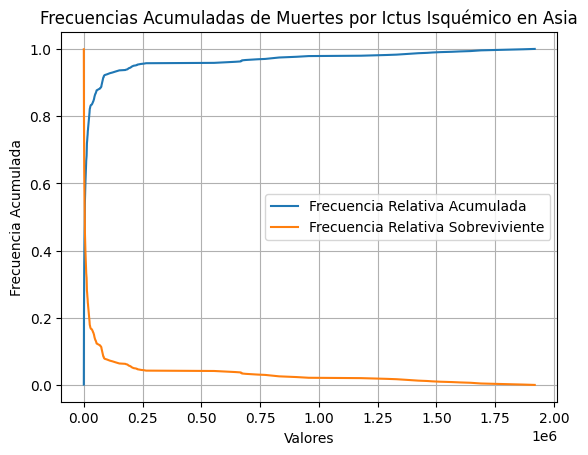

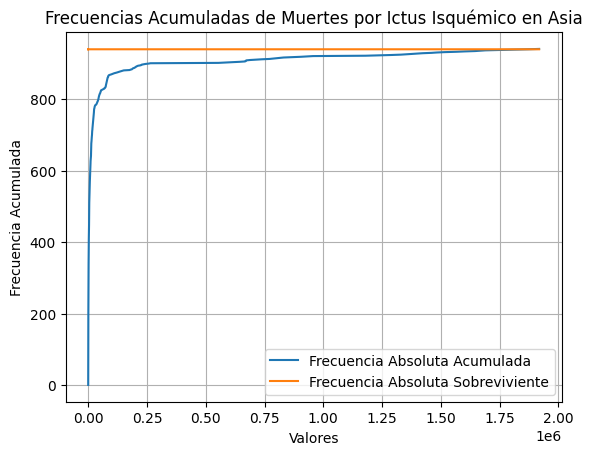

La Frecuencia Absoluta Complementaria por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
52.96         939
54.13         939
54.68         939
54.86         939
56.49         939
             ... 
2281280.50    939
2284003.20    939
2288032.20    939
2297081.50    939
2330634.00    939
Name: count, Length: 939, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
52.96         9.989362e-01
54.13         9.978723e-01
54.68         9.968085e-01
54.86         9.957447e-01
56.49         9.946809e-01
                  ...     
2281280.50    4.255319e-03
2284003.20    3.191489e-03
2288032.20    2.127660e-03
2297081.50    1.063830e-03
2330634.00   -7.771561e-15
Name: count, Length: 939, dtype: float64


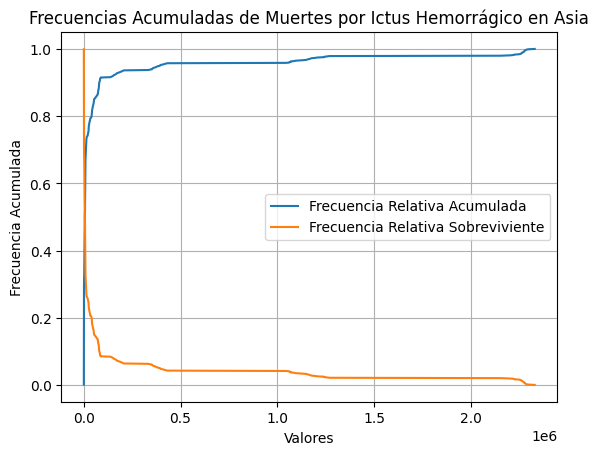

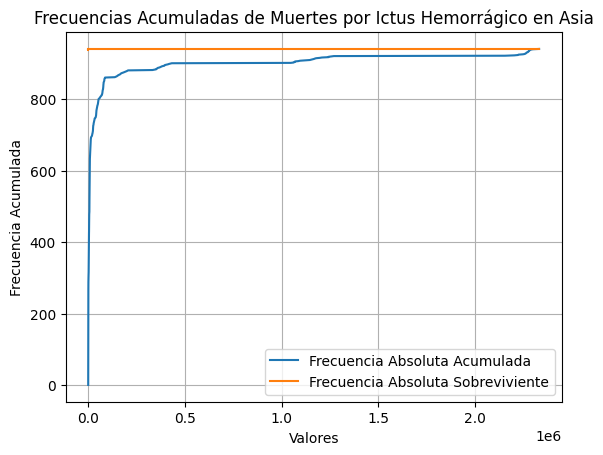

La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
171.95        939
184.02        939
202.40        939
202.80        939
203.36        939
             ... 
4601395.00    939
4752694.00    939
4888440.50    939
5021420.50    939
5125233.50    939
Name: count, Length: 940, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
171.95        9.989362e-01
184.02        9.978723e-01
202.40        9.968085e-01
202.80        9.957447e-01
203.36        9.946809e-01
                  ...     
4601395.00    4.255319e-03
4752694.00    3.191489e-03
4888440.50    2.127660e-03
5021420.50    1.063830e-03
5125233.50   -7.771561e-15
Name: count, Length: 940, dtype: float64


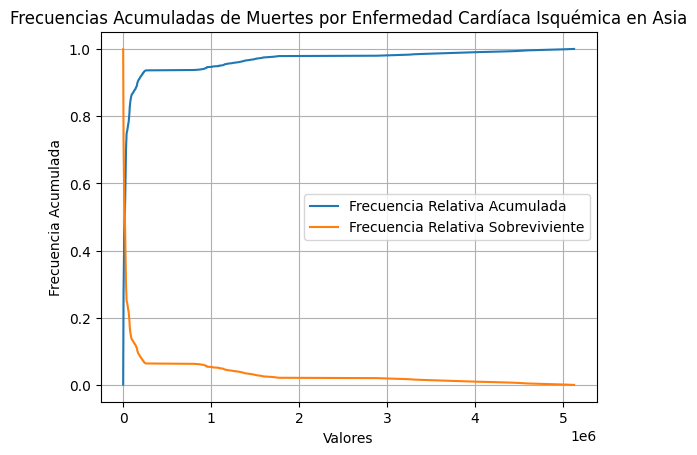

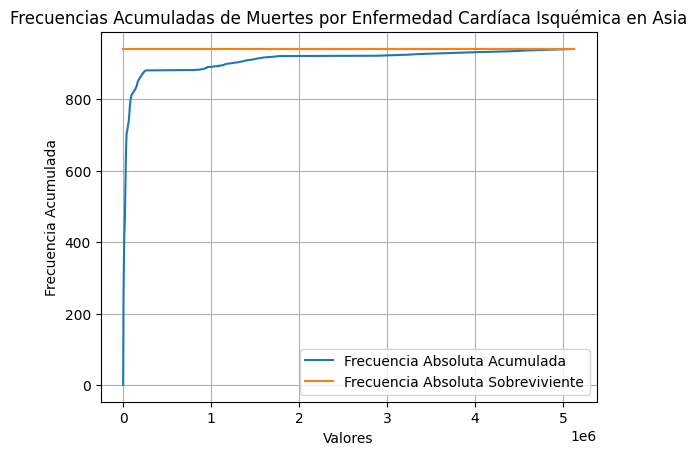

------------------------------------------------------------------------------------------
Frecuencias Acumuladas de muertes por Enfermedades Cardiovasculares en Europa:
La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
0.34        799
0.67        799
0.69        799
0.73        799
1.02        799
           ... 
23340.59    799
24811.98    799
24997.32    799
25336.74    799
26909.65    799
Name: count, Length: 783, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
0.34        9.987500e-01
0.67        9.975000e-01
0.69        9.962500e-01
0.73        9.950000e-01
1.02        9.937500e-01
                ...     
23340.59    5.000000e-03
24811.98    3.750000e-03
24997.32    2.500000e-03
25336.74    1.250000e-03
26909.65    1.543210e-14
Name

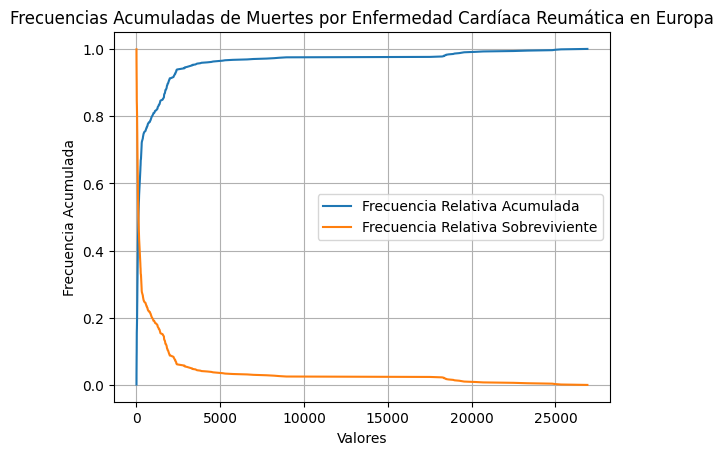

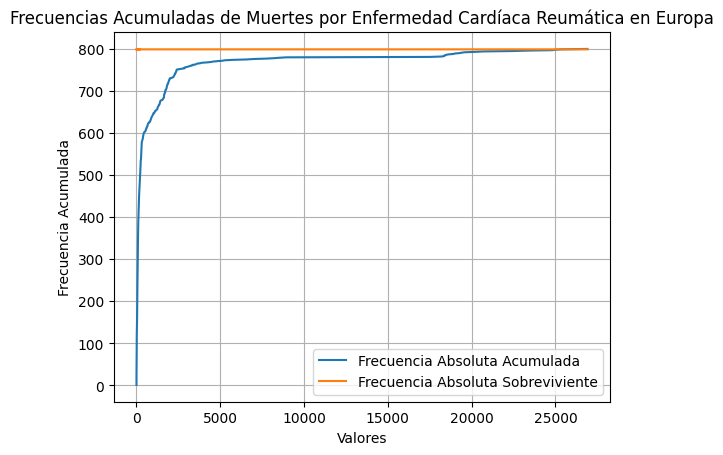

La Frecuencia Absoluta Complementaria por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
6.19         799
6.83         799
6.92         799
7.21         799
7.30         799
            ... 
166977.55    799
171847.36    799
172127.72    799
172340.02    799
176270.03    799
Name: count, Length: 799, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
6.19         9.987500e-01
6.83         9.975000e-01
6.92         9.962500e-01
7.21         9.950000e-01
7.30         9.937500e-01
                 ...     
166977.55    5.000000e-03
171847.36    3.750000e-03
172127.72    2.500000e-03
172340.02    1.250000e-03
176270.03    1.576517e-14
Name: count, Length: 799, dtype: float64


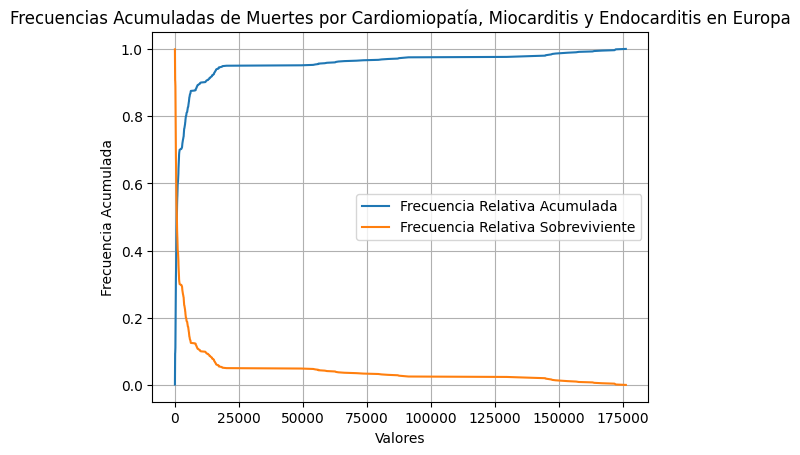

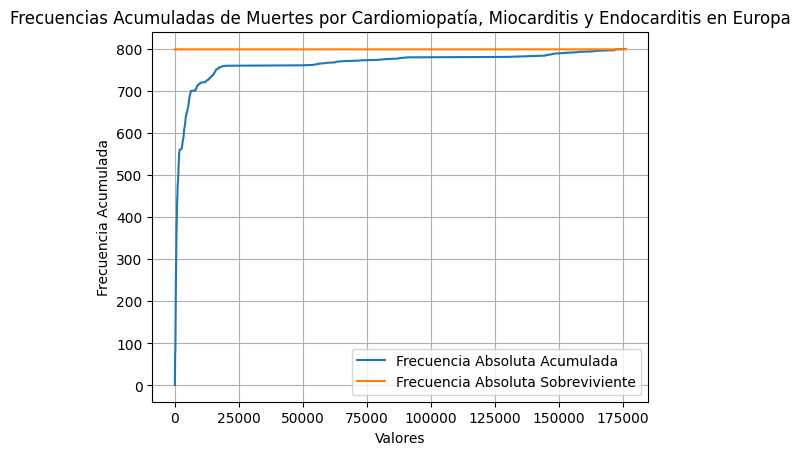

La Frecuencia Absoluta Complementaria por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
53.46        799
55.33        799
56.65        799
61.20        799
68.59        799
            ... 
304621.84    799
315382.03    799
319021.90    799
325365.20    799
325785.25    799
Name: count, Length: 797, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
53.46        9.987500e-01
55.33        9.975000e-01
56.65        9.962500e-01
61.20        9.950000e-01
68.59        9.937500e-01
                 ...     
304621.84    5.000000e-03
315382.03    3.750000e-03
319021.90    2.500000e-03
325365.20    1.250000e-03
325785.25    1.576517e-14
Name: count, Length: 797, dtype: float64


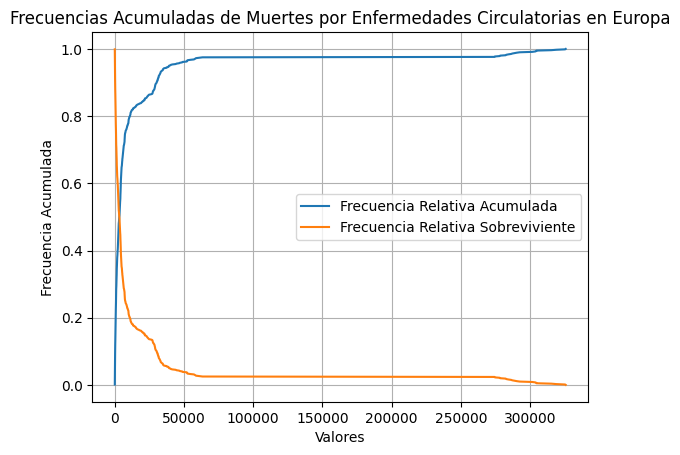

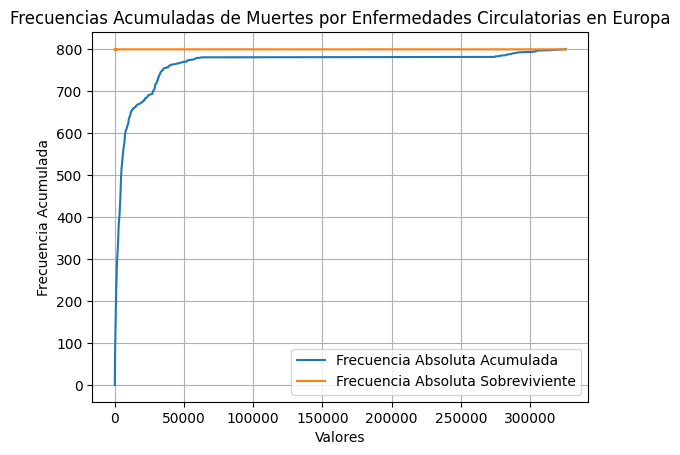

La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
12.46        799
13.31        799
13.50        799
14.49        799
15.09        799
            ... 
160819.80    799
168651.89    799
170222.22    799
175557.06    799
176734.75    799
Name: count, Length: 799, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
12.46        9.987500e-01
13.31        9.975000e-01
13.50        9.962500e-01
14.49        9.950000e-01
15.09        9.937500e-01
                 ...     
160819.80    5.000000e-03
168651.89    3.750000e-03
170222.22    2.500000e-03
175557.06    1.250000e-03
176734.75    1.576517e-14
Name: count, Length: 799, dtype: float64


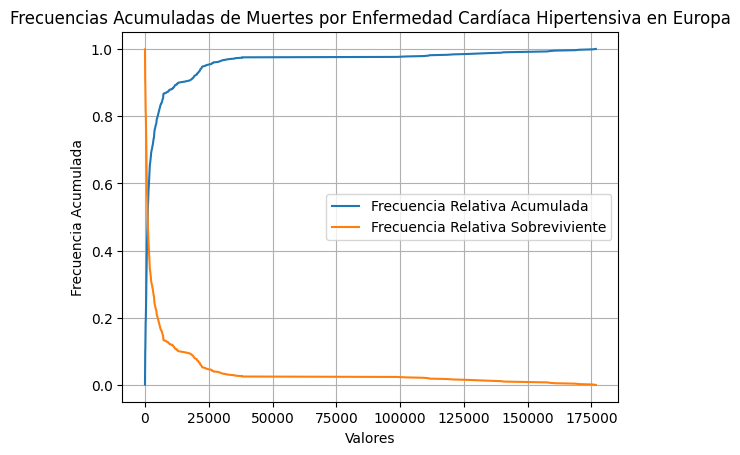

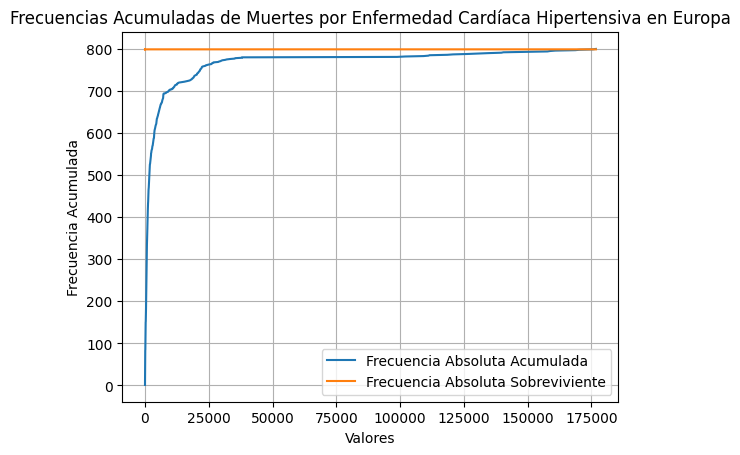

La Frecuencia Absoluta Complementaria por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
90.46        799
92.35        799
93.40        799
93.75        799
94.13        799
            ... 
875105.30    799
910014.50    799
913928.06    799
928153.30    799
940375.40    799
Name: count, Length: 799, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
90.46        9.987500e-01
92.35        9.975000e-01
93.40        9.962500e-01
93.75        9.950000e-01
94.13        9.937500e-01
                 ...     
875105.30    5.000000e-03
910014.50    3.750000e-03
913928.06    2.500000e-03
928153.30    1.250000e-03
940375.40    1.576517e-14
Name: count, Length: 799, dtype: float64


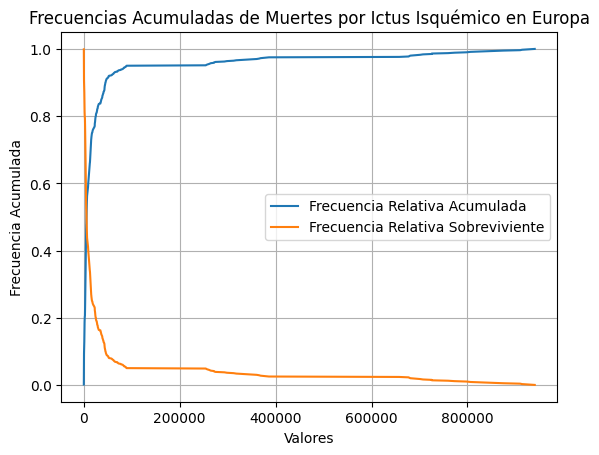

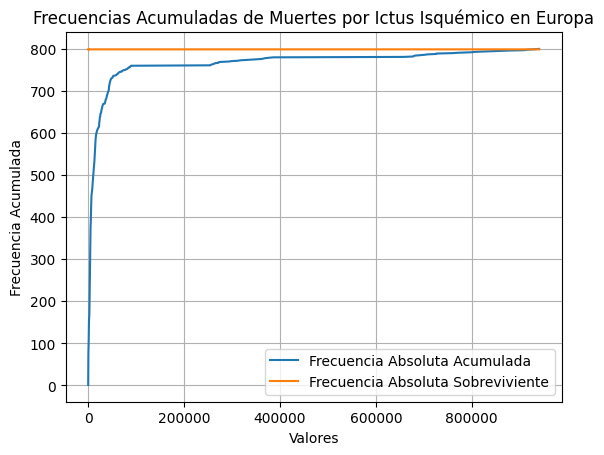

La Frecuencia Absoluta Complementaria por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
44.20        799
45.08        799
45.11        799
46.46        799
47.10        799
            ... 
346032.97    799
356016.20    799
356654.03    799
362487.20    799
365019.06    799
Name: count, Length: 800, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
44.20        9.987500e-01
45.08        9.975000e-01
45.11        9.962500e-01
46.46        9.950000e-01
47.10        9.937500e-01
                 ...     
346032.97    5.000000e-03
356016.20    3.750000e-03
356654.03    2.500000e-03
362487.20    1.250000e-03
365019.06    1.576517e-14
Name: count, Length: 800, dtype: float64


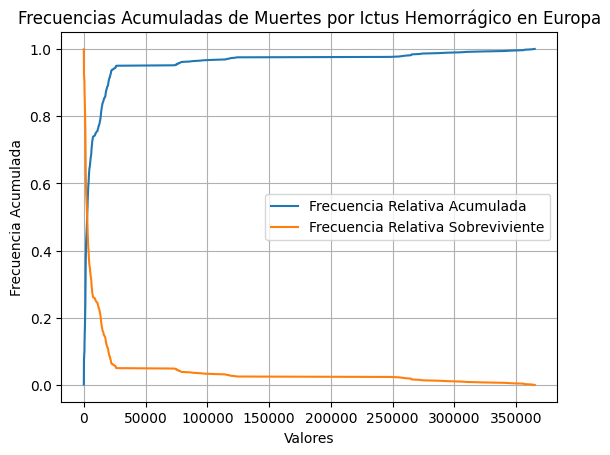

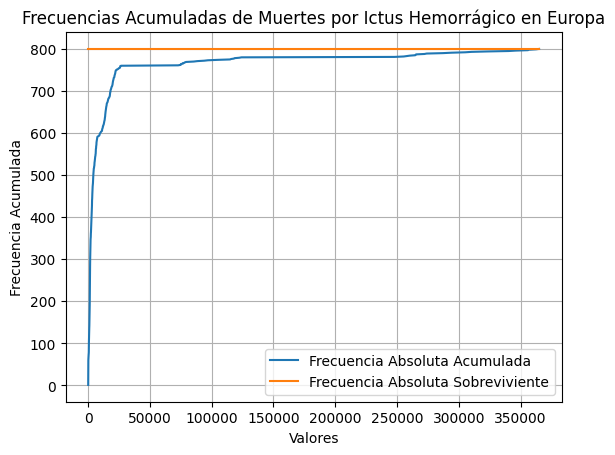

La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
403.43        799
403.83        799
414.61        799
417.13        799
423.04        799
             ... 
2299962.00    799
2305014.80    799
2316179.80    799
2367026.00    799
2416414.50    799
Name: count, Length: 800, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
403.43        9.987500e-01
403.83        9.975000e-01
414.61        9.962500e-01
417.13        9.950000e-01
423.04        9.937500e-01
                  ...     
2299962.00    5.000000e-03
2305014.80    3.750000e-03
2316179.80    2.500000e-03
2367026.00    1.250000e-03
2416414.50    1.576517e-14
Name: count, Length: 800, dtype: float64


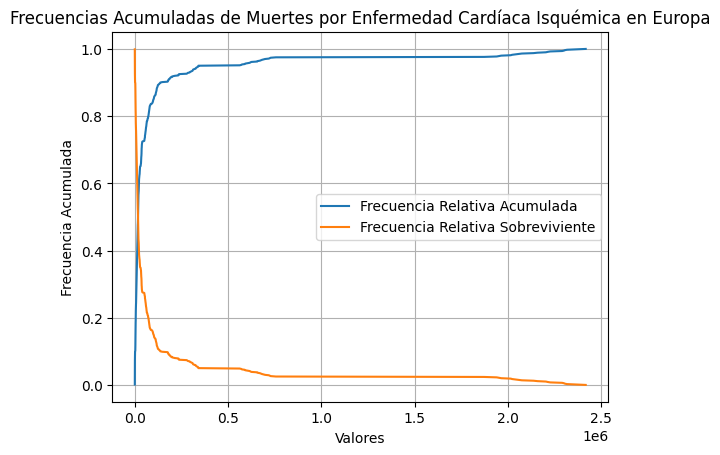

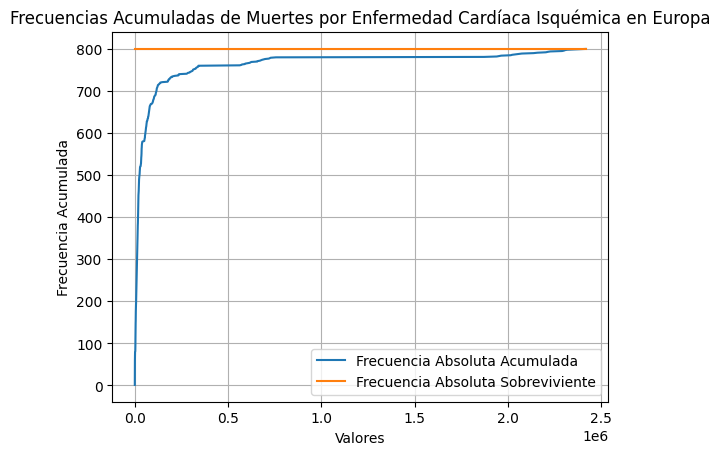

------------------------------------------------------------------------------------------
Frecuencias Acumuladas de muertes por Enfermedades Cardiovasculares en Oceania:
La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
2.1400       219
2.2500       219
2.3300       219
2.3400       219
2.4800       219
            ... 
1724.2600    219
1734.3500    219
1745.1799    219
1764.5901    219
1767.6799    219
Name: count, Length: 214, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Reumática es:
 Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
2.1400       9.954545e-01
2.2500       9.909091e-01
2.3300       9.863636e-01
2.3400       9.818182e-01
2.4800       9.772727e-01
                 ...     
1724.2600    1.818182e-02
1734.3500    1.363636e-02
1745.1799    9.090909e-03
1764.5901    4.545455e-03
1767.67

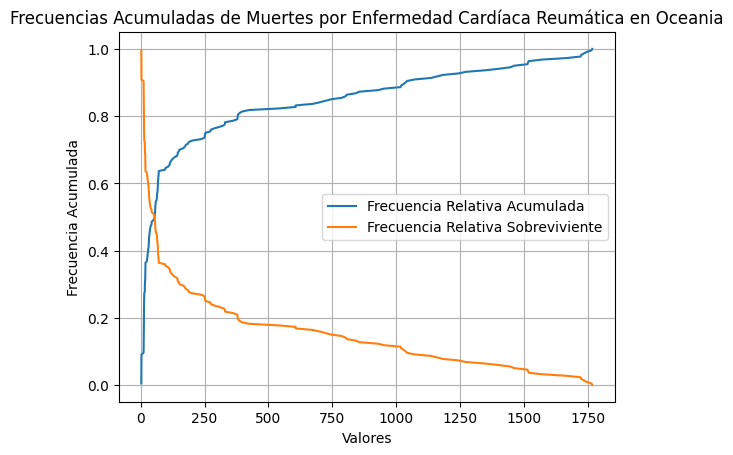

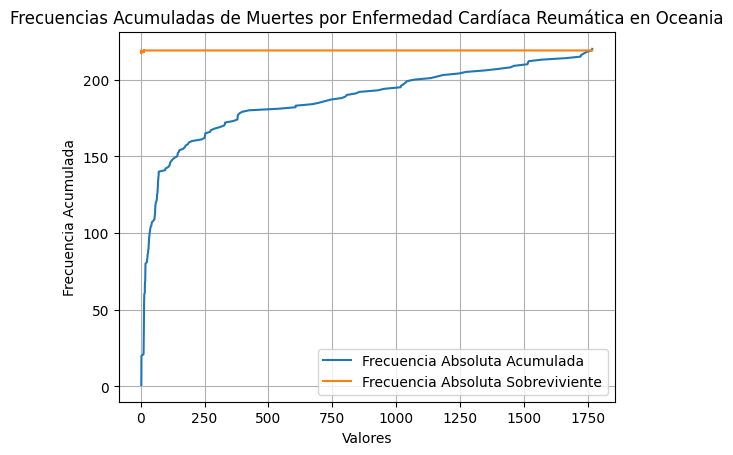

La Frecuencia Absoluta Complementaria por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
1.9100       219
1.9700       219
2.0100       218
2.0600       219
2.0800       219
            ... 
2158.4200    219
2209.4700    219
2217.0200    219
2259.8198    219
2260.2600    219
Name: count, Length: 212, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Cardiomiopatía, Miocarditis y Endocarditis es:
 Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
1.9100       9.954545e-01
1.9700       9.909091e-01
2.0100       9.818182e-01
2.0600       9.772727e-01
2.0800       9.727273e-01
                 ...     
2158.4200    1.818182e-02
2209.4700    1.363636e-02
2217.0200    9.090909e-03
2259.8198    4.545455e-03
2260.2600    4.107825e-15
Name: count, Length: 212, dtype: float64


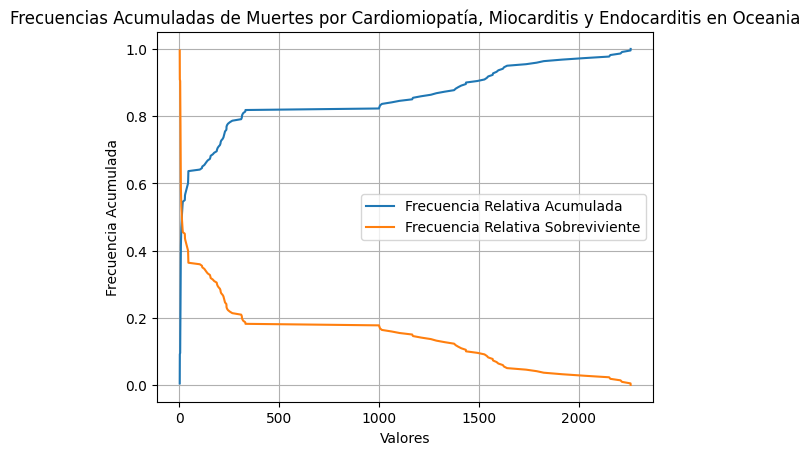

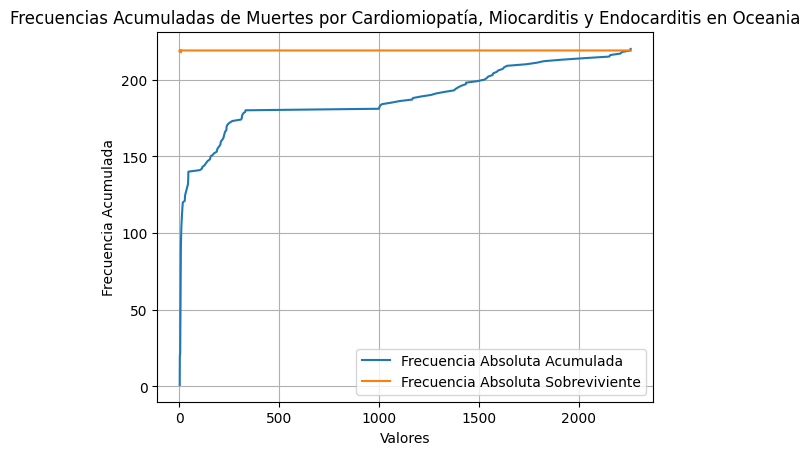

La Frecuencia Absoluta Complementaria por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
6.580       218
6.720       219
6.770       219
6.860       219
6.940       219
           ... 
9001.080    219
9172.710    219
9230.550    219
9283.910    219
9288.359    219
Name: count, Length: 216, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedades Circulatorias es:
 Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
6.580       9.909091e-01
6.720       9.863636e-01
6.770       9.818182e-01
6.860       9.772727e-01
6.940       9.727273e-01
                ...     
9001.080    1.818182e-02
9172.710    1.363636e-02
9230.550    9.090909e-03
9283.910    4.545455e-03
9288.359    4.218847e-15
Name: count, Length: 216, dtype: float64


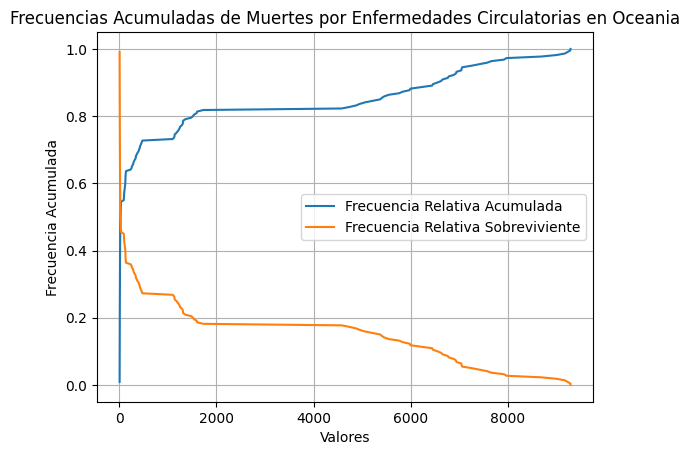

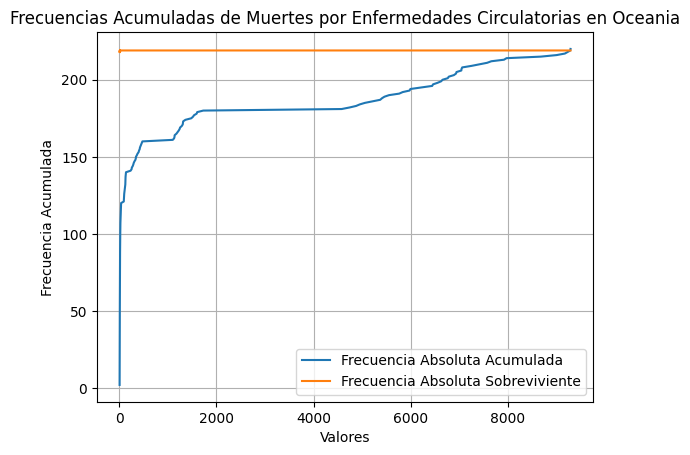

La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
4.9300       219
4.9600       219
5.0600       218
5.1100       219
5.1200       219
            ... 
3339.2000    219
3371.0498    219
3422.6500    219
3448.7200    219
3514.5898    219
Name: count, Length: 216, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Hipertensiva es:
 Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
4.9300       9.954545e-01
4.9600       9.909091e-01
5.0600       9.818182e-01
5.1100       9.772727e-01
5.1200       9.727273e-01
                 ...     
3339.2000    1.818182e-02
3371.0498    1.363636e-02
3422.6500    9.090909e-03
3448.7200    4.545455e-03
3514.5898    4.218847e-15
Name: count, Length: 216, dtype: float64


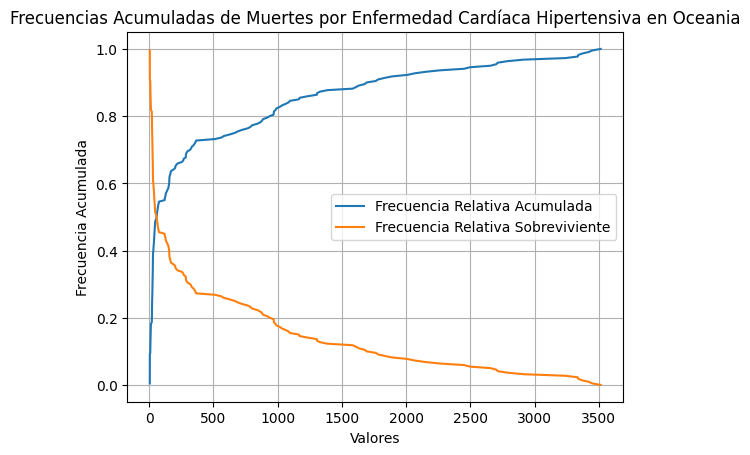

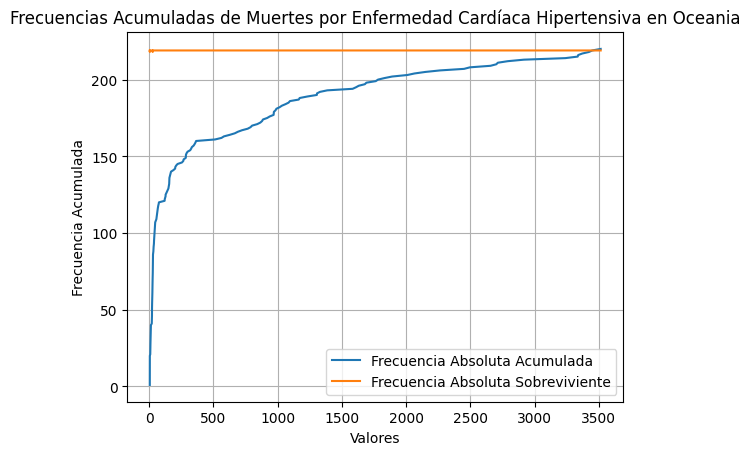

La Frecuencia Absoluta Complementaria por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
15.390       219
15.440       219
15.750       219
16.010       219
16.110       218
            ... 
10922.420    219
10941.430    219
10976.090    219
10980.591    219
11172.591    219
Name: count, Length: 218, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Ictus Isquémico es:
 Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
15.390       9.954545e-01
15.440       9.909091e-01
15.750       9.863636e-01
16.010       9.818182e-01
16.110       9.727273e-01
                 ...     
10922.420    1.818182e-02
10941.430    1.363636e-02
10976.090    9.090909e-03
10980.591    4.545455e-03
11172.591    4.218847e-15
Name: count, Length: 218, dtype: float64


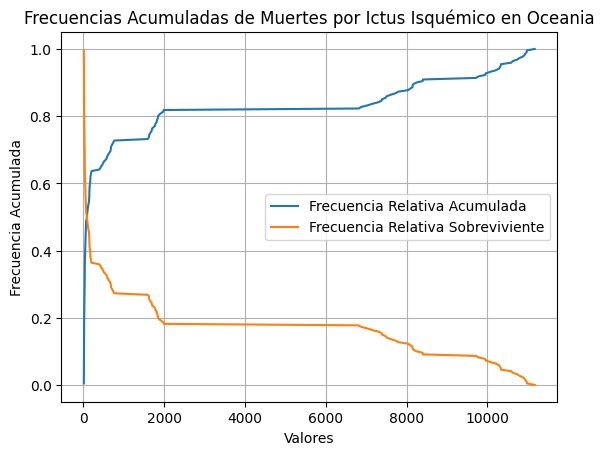

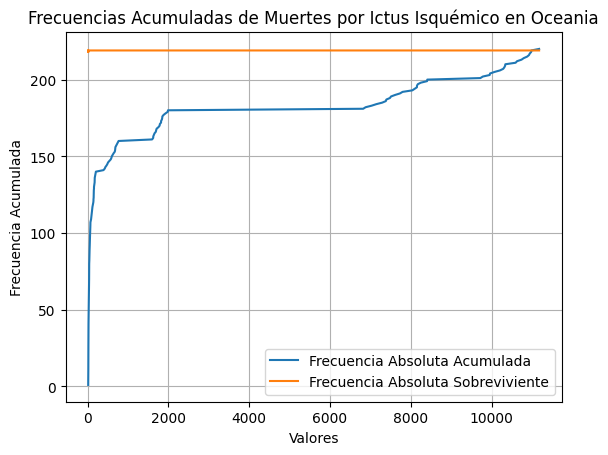

La Frecuencia Absoluta Complementaria por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
29.75       219
30.20       219
31.04       219
31.14       219
31.16       219
           ... 
9836.74     219
9919.37     219
9923.87     219
9977.64     219
10107.84    219
Name: count, Length: 219, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Ictus Hemorrágico es:
 Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
29.75       9.954545e-01
30.20       9.909091e-01
31.04       9.863636e-01
31.14       9.818182e-01
31.16       9.772727e-01
                ...     
9836.74     1.818182e-02
9919.37     1.363636e-02
9923.87     9.090909e-03
9977.64     4.545455e-03
10107.84    4.218847e-15
Name: count, Length: 219, dtype: float64


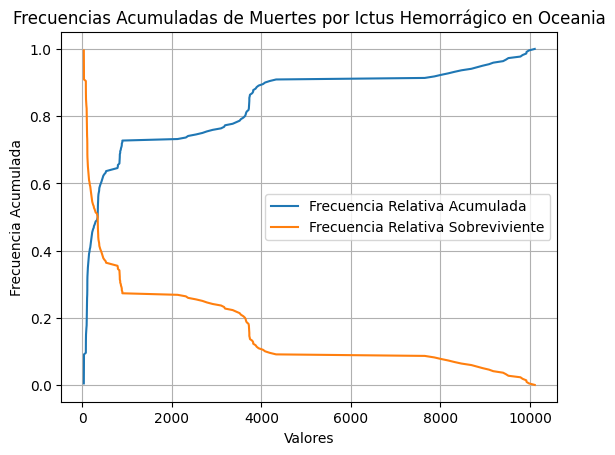

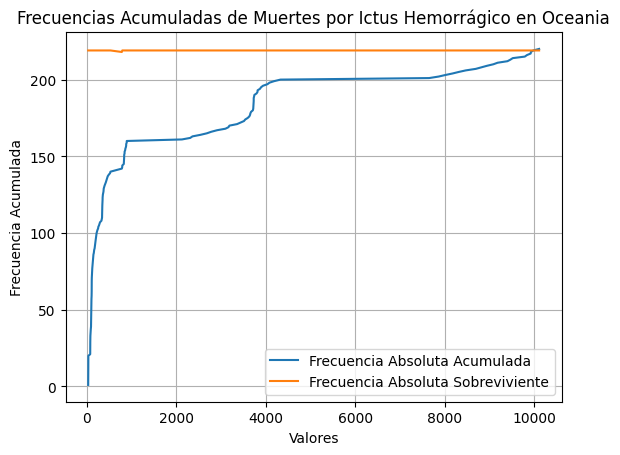

La Frecuencia Absoluta Complementaria por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
75.770       219
77.500       219
78.790       219
79.220       219
80.130       219
            ... 
39865.652    219
40163.850    219
40346.000    219
40530.190    219
40673.220    219
Name: count, Length: 220, dtype: int64
La Frecuencia Relativa Complementaria por Muertes por Enfermedad Cardíaca Isquémica es:
 Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
75.770       9.954545e-01
77.500       9.909091e-01
78.790       9.863636e-01
79.220       9.818182e-01
80.130       9.772727e-01
                 ...     
39865.652    1.818182e-02
40163.850    1.363636e-02
40346.000    9.090909e-03
40530.190    4.545455e-03
40673.220    4.218847e-15
Name: count, Length: 220, dtype: float64


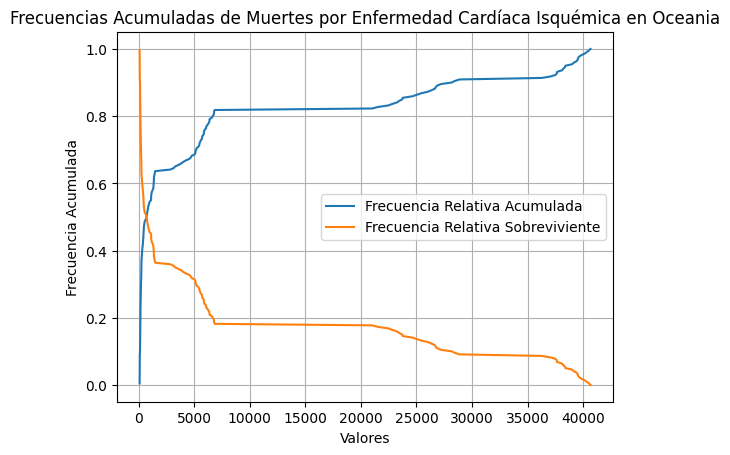

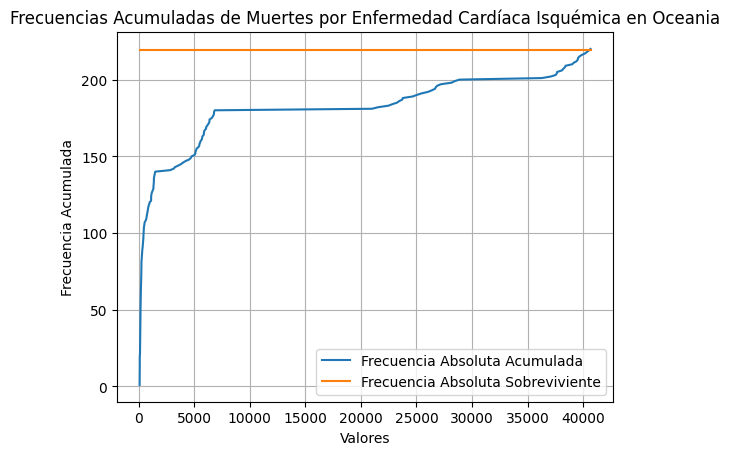

------------------------------------------------------------------------------------------


In [28]:
resultados = []

# Función para calcular la frecuencia absoluta de una serie de datos
def calcular_frecuencia_absoluta(data):
    return data.value_counts().sort_index()

# Iterar sobre cada continente y sus respectivos países
for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]  # Filtrar el DataFrame por los países del continente actual
    print(f"Frecuencias Acumuladas de muertes por Enfermedades Cardiovasculares en {continente}:")

    # Iterar sobre cada patología para calcular y mostrar las frecuencias acumuladas y complementarias
    for patologia in patologias:
        data_patologia = df_continente[patologia]  # Obtener los datos de la patología actual
        Fabs = calcular_frecuencia_absoluta(data_patologia)  # Calcular la frecuencia absoluta
        total_observaciones = len(data_patologia)  # Calcular el número total de observaciones

        # Calcular la frecuencia absoluta acumulada
        Fabs_acum = Fabs.cumsum()

        # Calcular la frecuencia relativa acumulada
        Frel_acum = Fabs / total_observaciones
        Frel_acum = Frel_acum.cumsum()

        # Calcular la frecuencia absoluta complementaria
        Fabs_complementaria = total_observaciones - Fabs

        # Calcular la frecuencia relativa complementaria
        Frel_complementaria = 1 - Frel_acum

        patologia_legible = reemplazar_texto(patologia)

        # Imprimir los resultados por consola
        print(f"La Frecuencia Absoluta Complementaria por {patologia_legible} es:\n {Fabs_complementaria}")
        print(f"La Frecuencia Relativa Complementaria por {patologia_legible} es:\n {Frel_complementaria}")

        # Almacenar los resultados en la lista
        resultados.append({
            'Continente': continente,
            'Patologia': patologia_legible,
            'Frecuencia Absoluta': Fabs,
            'Frecuencia Absoluta Acumulada': Fabs_acum,
            'Frecuencia Absoluta Sobreviviente': Fabs_complementaria,
            'Frecuencia Relativa': Frel_acum,
            'Frecuencia Relativa Sobreviviente': Frel_complementaria
        })

        # Crear y mostrar el gráfico de la frecuencia relativa acumulada y complementaria
        plt.figure()
        plt.plot(Frel_acum.index, Frel_acum.values, label='Frecuencia Relativa Acumulada')
        plt.plot(Frel_complementaria.index, Frel_complementaria.values, label='Frecuencia Relativa Sobreviviente')
        plt.title(f'Frecuencias Acumuladas de {patologia_legible} en {continente}')
        plt.xlabel('Valores')
        plt.ylabel('Frecuencia Acumulada')
        plt.legend()
        plt.grid(True)
        plt.show()

        # Crear y mostrar el gráfico de la frecuencia absoluta acumulada y complementaria
        plt.figure()
        plt.plot(Fabs_acum.index, Fabs_acum.values, label='Frecuencia Absoluta Acumulada')
        plt.plot(Fabs_complementaria.index, Fabs_complementaria.values, label='Frecuencia Absoluta Sobreviviente')
        plt.title(f'Frecuencias Acumuladas de {patologia_legible} en {continente}')
        plt.xlabel('Valores')
        plt.ylabel('Frecuencia Acumulada')
        plt.legend()
        plt.grid(True)
        plt.show()

    print("-" * 90)


### Año contra número de muertes

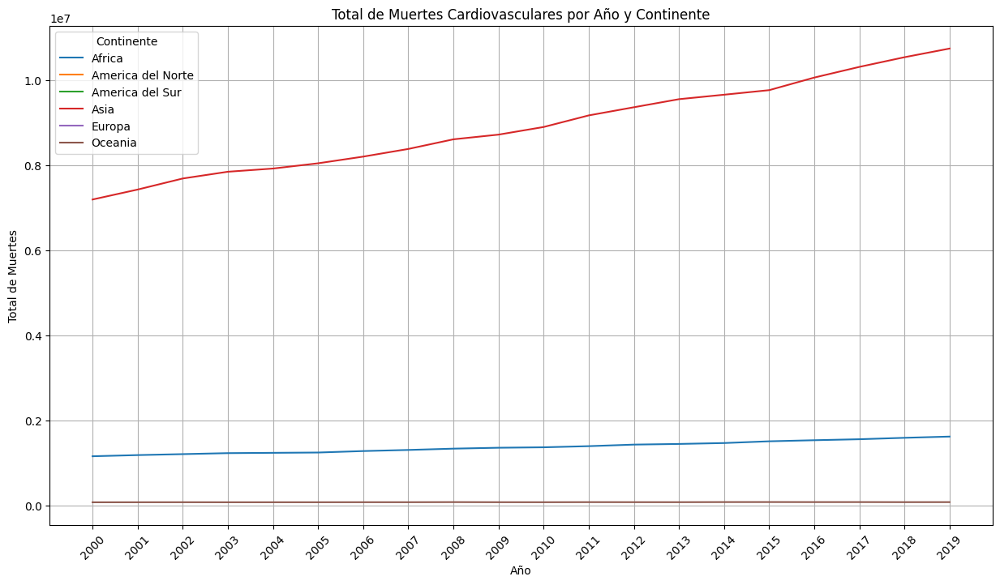

In [29]:
# Crear una nueva columna para la suma de muertes por año
df['Total_deaths'] = df.iloc[:, 2:].sum(axis=1)

# Filtrar los datos para el rango de años del 2000 al 2019
df_filtrado = df[(df['Year'] >= 2000) & (df['Year'] <= 2019)]

# Calcular la suma total de muertes por año para cada continente
resultados = []

for continente in continentes:
    df_continente = df_filtrado[df_filtrado['Entity'] == continente]
    total_muertes_por_ano = df_continente.groupby('Year')['Total_deaths'].sum().reset_index()
    resultados.append({
        'Continente': continente,
        'Total_muertes_por_ano': total_muertes_por_ano
    })

# Graficar la suma total de muertes por año para cada continente
plt.figure(figsize=(15, 8))

for resultado in resultados:
    plt.plot(resultado['Total_muertes_por_ano']['Year'], resultado['Total_muertes_por_ano']['Total_deaths'], label=resultado['Continente'])

plt.title('Total de Muertes Cardiovasculares por Año y Continente')
plt.xlabel('Año')
plt.ylabel('Total de Muertes')
plt.legend(title='Continente')
plt.xticks(ticks=range(2000, 2020), rotation=45)
plt.grid(True)
plt.show()


# Funciones

## Función de densidad probabilidad

Densidad de probabilidad para Muertes por Enfermedad Cardíaca Reumática:
Continente: Africa
count     1080.000000
mean       695.290742
std       2555.075933
min          0.840000
25%         49.477500
50%        198.475000
75%        424.010000
max      20652.880000
Name: Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges, dtype: float64
Continente: America del Norte
count     440.000000
mean      567.628912
std      1438.480727
min         0.000000
25%         3.487500
50%        26.190000
75%       193.742500
max      6772.000000
Name: Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges, dtype: float64
Continente: America del Sur
count     260.000000
mean      557.406694
std      1056.376955
min         5.490000
25%        36.762500
50%       167.150000
75%       265.407500
max      4132.800300
Name: Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges, dtype: float64
Continente: Asia
count       940.00

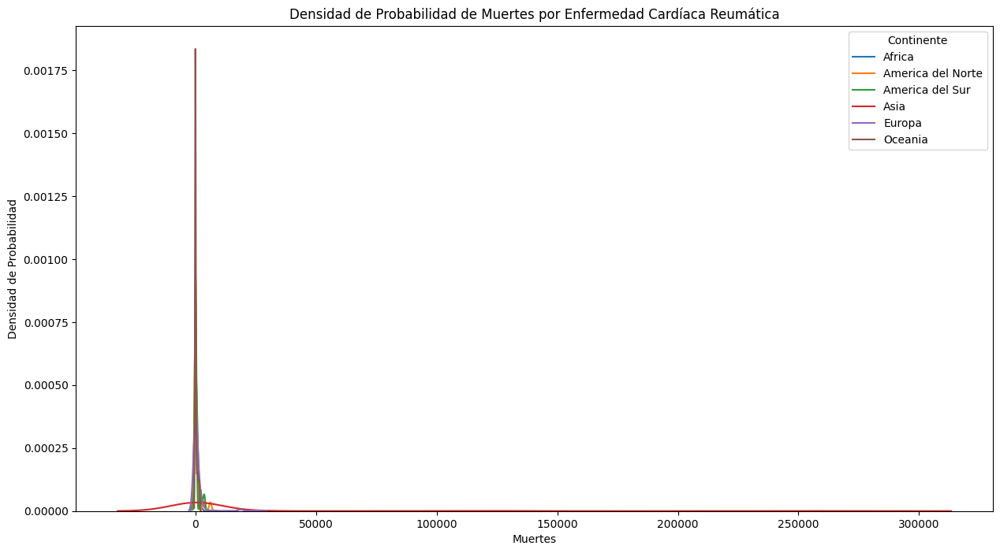

Densidad de probabilidad para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Continente: Africa
count     1080.000000
mean      1334.966231
std       4950.560664
min          3.590000
25%        111.905000
50%        353.690000
75%        801.227500
max      41912.140000
Name: Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges, dtype: float64
Continente: America del Norte
count      440.000000
mean      3528.601575
std      10251.478436
min          1.230000
25%         28.397500
50%        123.345000
75%        652.545000
max      40494.660000
Name: Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges, dtype: float64
Continente: America del Sur
count      260.000000
mean      3993.150815
std       7870.515415
min         20.020000
25%        242.897500
50%        425.885000
75%       1261.520000
max      28142.750000
Name: Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: 

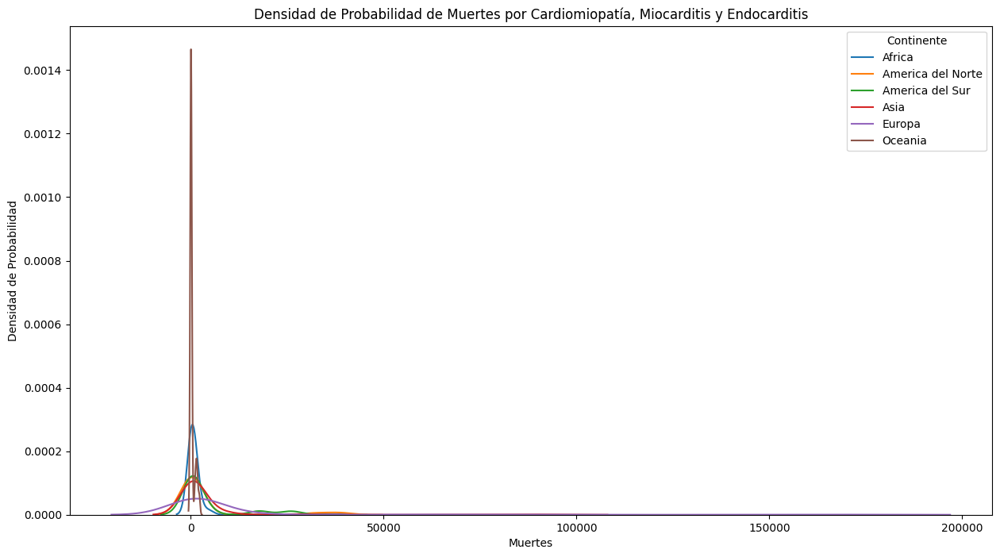

Densidad de probabilidad para Muertes por Enfermedades Circulatorias:
Continente: Africa
count     1080.000000
mean      2629.595646
std       9759.449875
min          7.840000
25%        174.427500
50%        696.345000
75%       1513.132500
max      85875.710000
Name: Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges, dtype: float64
Continente: America del Norte
count       440.000000
mean      10489.266377
std       29708.691717
min          14.400000
25%          65.590000
50%         352.965000
75%        1373.335000
max      140496.170000
Name: Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges, dtype: float64
Continente: America del Sur
count      260.000000
mean      9494.685046
std      17979.609875
min         39.040000
25%        787.787500
50%       1423.450000
75%       5459.405000
max      79477.734000
Name: Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges, dtype: float64
Conti

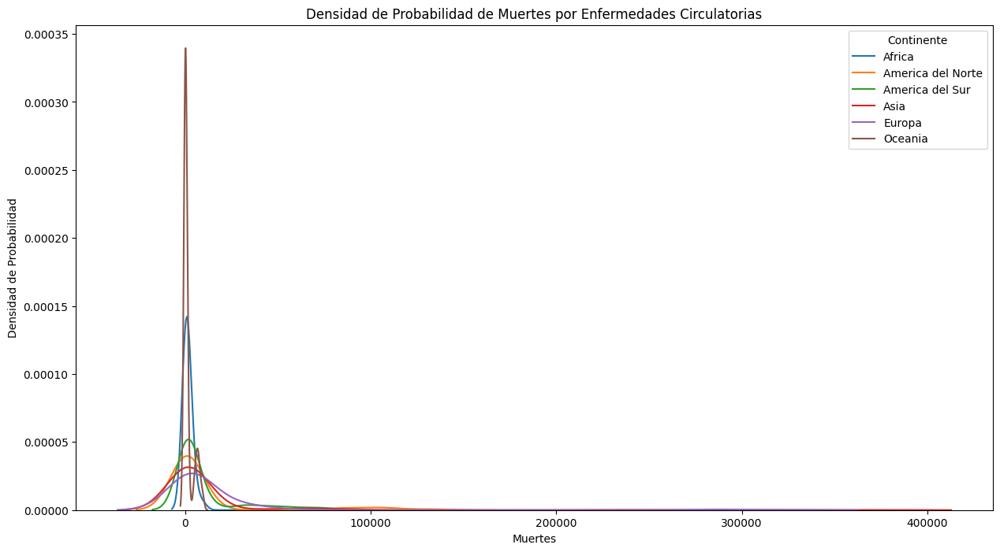

Densidad de probabilidad para Muertes por Enfermedad Cardíaca Hipertensiva:
Continente: Africa
count      1080.000000
mean       5296.967296
std       19532.743087
min           4.490000
25%         423.762500
50%        1101.660000
75%        3072.695000
max      168953.520000
Name: Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges, dtype: float64
Continente: America del Norte
count       440.000000
mean       6588.228811
std       18177.189617
min           0.000000
25%          44.852500
50%         459.350000
75%        1544.300000
max      100504.290000
Name: Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges, dtype: float64
Continente: America del Sur
count      260.000000
mean      6899.742900
std      12699.526607
min         70.750000
25%        566.222500
50%       2079.750000
75%       4333.832500
max      57549.332000
Name: Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges, dtype:

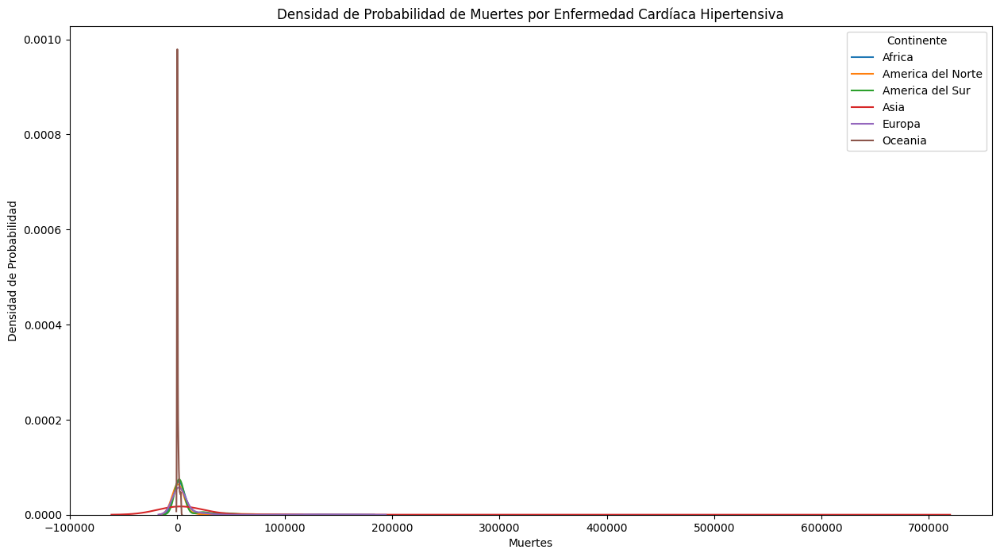

Densidad de probabilidad para Muertes por Ictus Isquémico:
Continente: Africa
count      1080.000000
mean       6525.879963
std       24287.009668
min          20.720000
25%         524.560000
50%        1232.885000
75%        3478.660000
max      222601.170000
Name: Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges, dtype: float64
Continente: America del Norte
count       440.000000
mean      12268.663827
std       32491.821332
min          18.060000
25%          87.220000
50%         974.995000
75%        3718.005000
max      150389.780000
Name: Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges, dtype: float64
Continente: America del Sur
count       260.000000
mean      15947.590835
std       30331.579542
min         159.000000
25%        1709.247500
50%        3064.180000
75%        7233.897500
max      116831.370000
Name: Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges, dtype: float64
Continente: Asia
count    9.40

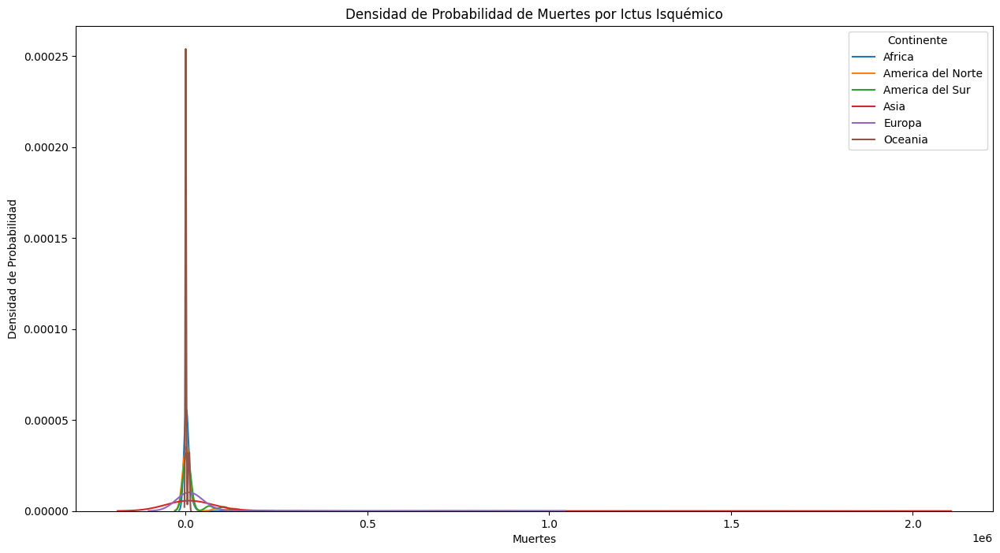

Densidad de probabilidad para Muertes por Ictus Hemorrágico:
Continente: Africa
count      1080.000000
mean      10844.348324
std       40003.456374
min          24.600000
25%         779.080000
50%        3206.120000
75%        7141.230000
max      319787.000000
Name: Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges, dtype: float64
Continente: America del Norte
count       440.000000
mean       9423.106957
std       24314.327647
min          19.590000
25%          90.337500
50%         772.675000
75%        3641.472500
max      117863.970000
Name: Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges, dtype: float64
Continente: America del Sur
count      260.000000
mean     14315.283415
std      26320.521366
min        243.940000
25%       1376.767500
50%       3481.090000
75%       7623.157500
max      95568.690000
Name: Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges, dtype: float64
Continente: Asia
count    9

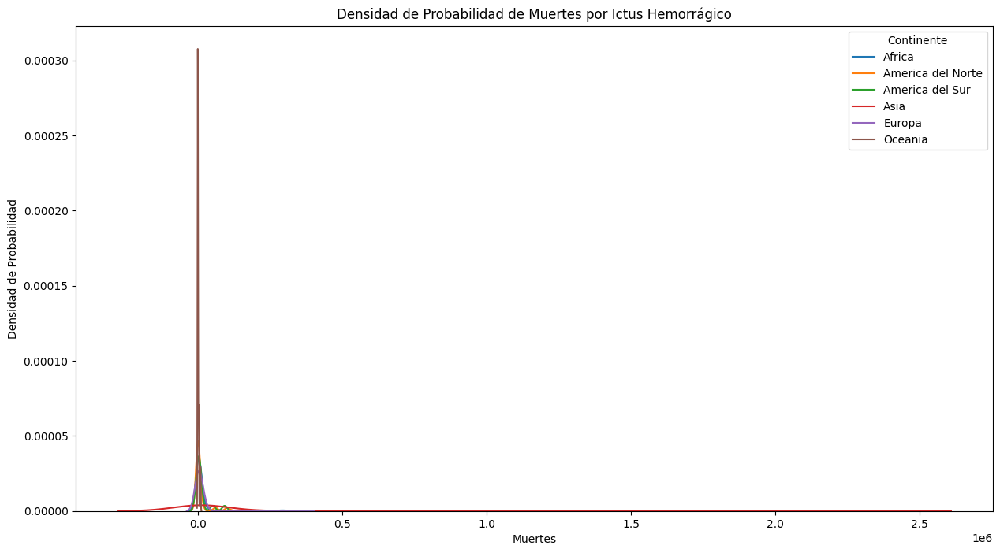

Densidad de probabilidad para Muertes por Enfermedad Cardíaca Isquémica:
Continente: Africa
count      1080.000000
mean      22916.073102
std       86156.091086
min          62.270000
25%        1454.535000
50%        4482.095000
75%        9734.882500
max      759545.200000
Name: Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges, dtype: float64
Continente: America del Norte
count       440.000000
mean      63887.882682
std      175516.793269
min          52.450000
25%         254.102500
50%        3103.880000
75%       12133.892500
max      763962.440000
Name: Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges, dtype: float64
Continente: America del Sur
count       260.000000
mean      45442.859192
std       81785.293650
min         383.980000
25%        4364.347500
50%        9792.335000
75%       36613.442500
max      340410.970000
Name: Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges, dtype: flo

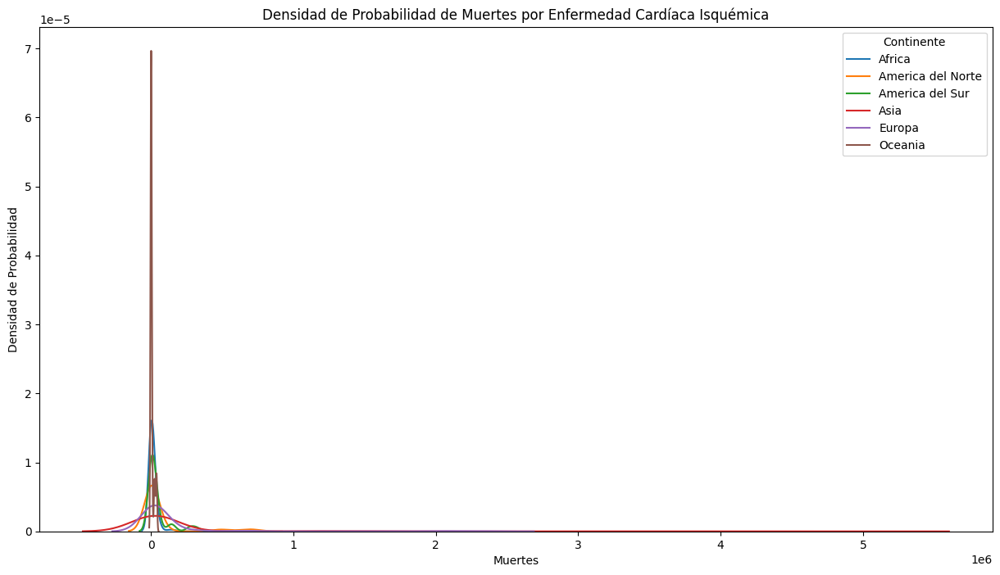

In [30]:
# Función para calcular la densidad de probabilidad
def calcular_densidad_probabilidad(df, patologia):
    data_patologia = df[patologia].dropna()  # Eliminar NaNs para el cálculo de la densidad
    return data_patologia

# Bucle para iterar sobre cada patología
for patologia in patologias:
    plt.figure(figsize=(15, 8))  # Crear una nueva figura para cada patología
    patologia_legible = reemplazar_texto(patologia)
    print(f"Densidad de probabilidad para {patologia_legible}:")
    
    # Bucle para iterar sobre cada continente y sus respectivos países
    for continente, paises in continentes.items():
        df_continente = df[df['Entity'].isin(paises)]  # Filtrar el DataFrame por los países del continente actual
        FDP = calcular_densidad_probabilidad(df_continente, patologia)  # Calcular la densidad de probabilidad
        
        # Imprimir densidad de probabilidad por consola
        print(f"Continente: {continente}")
        print(FDP.describe())
        print("=" * 90)
        
        # Graficar la densidad de probabilidad
        sns.kdeplot(FDP, label=continente)  # Usar seaborn para graficar la densidad de probabilidad
    
    # Configurar la gráfica
    plt.title(f'Densidad de Probabilidad de {patologia_legible}')
    plt.xlabel('Muertes')
    plt.ylabel('Densidad de Probabilidad')
    plt.legend(title='Continente')
    plt.show()

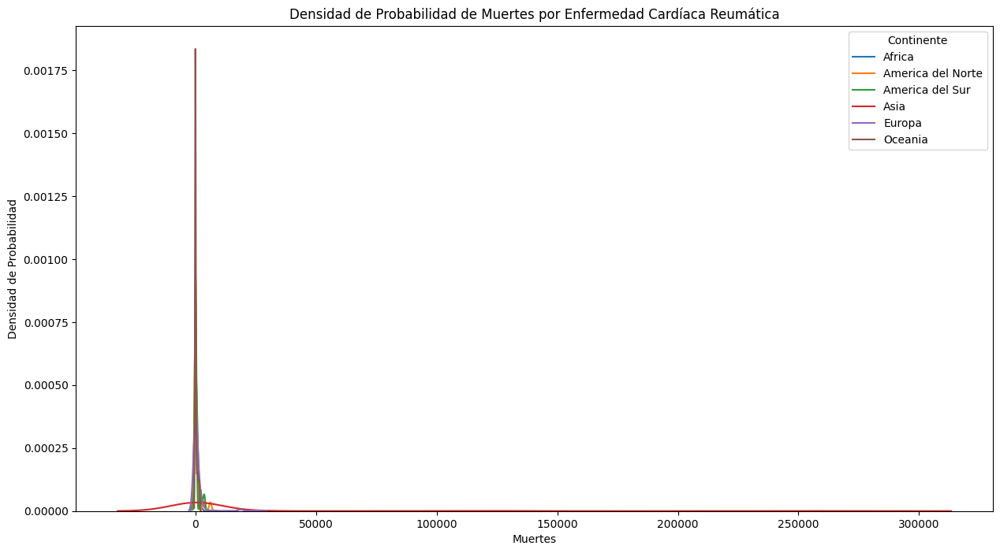

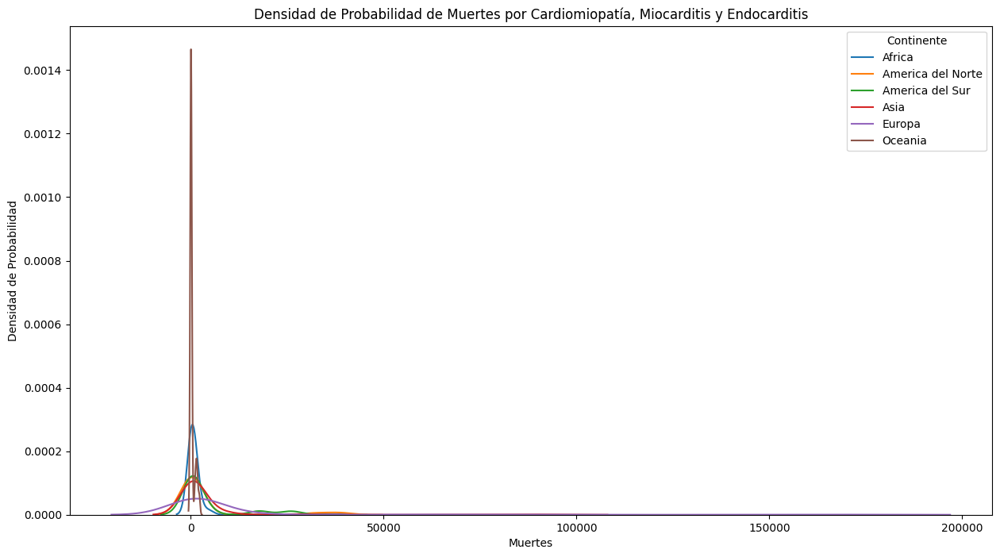

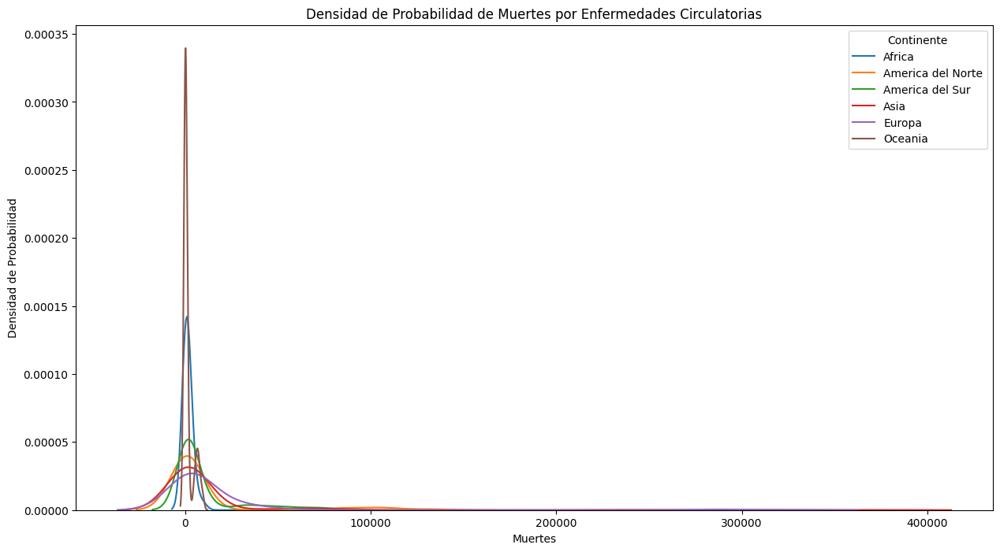

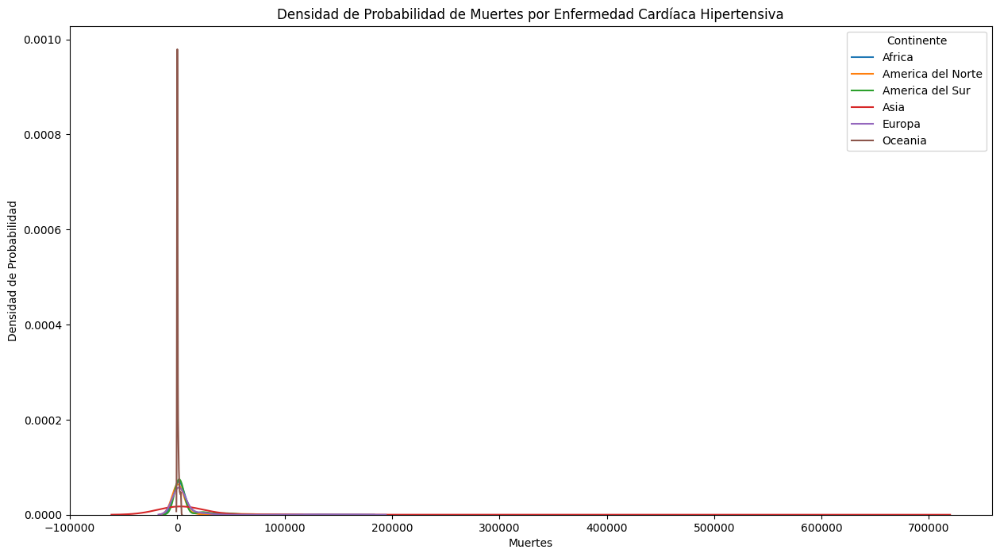

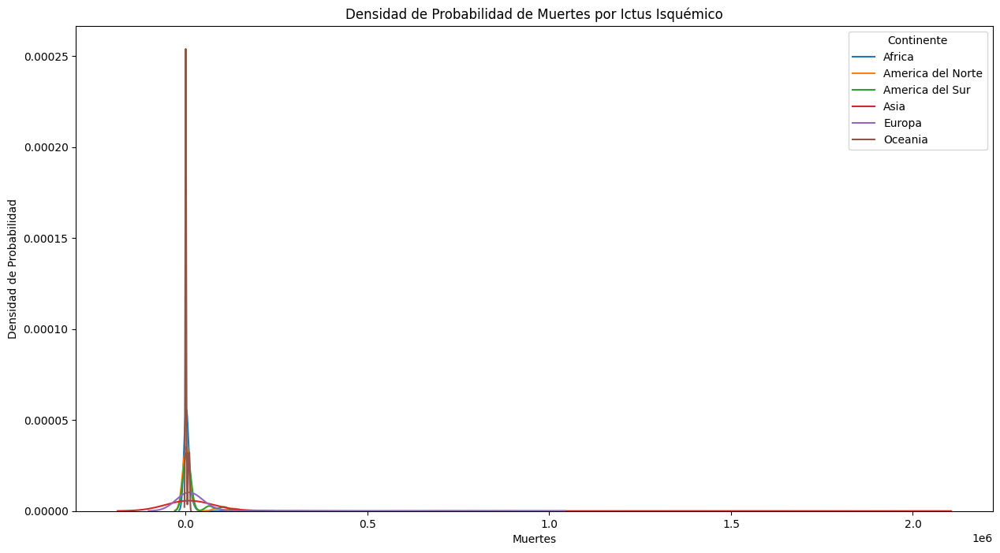

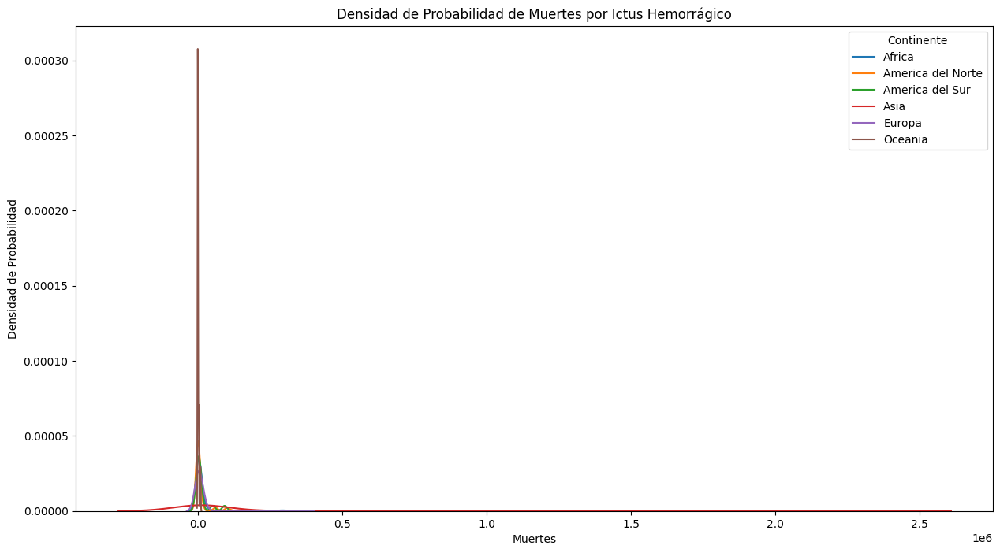

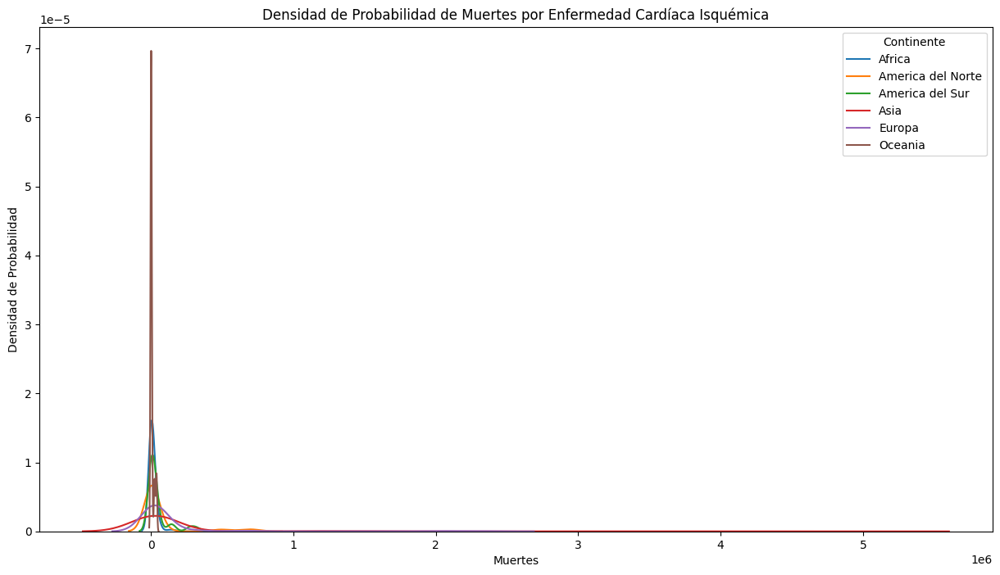

In [31]:
# Calcular y graficar la densidad de probabilidad
for patologia in patologias:
    plt.figure(figsize=(15, 8))
    for continente, paises in continentes.items():
        df_continente = df[df['Entity'].isin(paises)]
        data_patologia = df_continente[patologia].dropna()  # Eliminar valores NaN
        
        # Graficar la densidad
        sns.kdeplot(data_patologia, label=continente)
        
    patologia_legible = reemplazar_texto(patologia)
    plt.title(f'Densidad de Probabilidad de {patologia_legible}')
    plt.xlabel('Muertes')
    plt.ylabel('Densidad de Probabilidad')
    plt.legend(title='Continente')
    plt.show()

## Función de distribución de la muestra

Distribución acumulativa para Muertes por Enfermedad Cardíaca Reumática:
Continente: Africa
CDF por Muertes por Enfermedad Cardíaca Reumática:
[9.25925926e-04 1.85185185e-03 2.77777778e-03 ... 9.98148148e-01
 9.99074074e-01 1.00000000e+00]
Continente: America del Norte
CDF por Muertes por Enfermedad Cardíaca Reumática:
[0.00227273 0.00454545 0.00681818 0.00909091 0.01136364 0.01363636
 0.01590909 0.01818182 0.02045455 0.02272727 0.025      0.02727273
 0.02954545 0.03181818 0.03409091 0.03636364 0.03863636 0.04090909
 0.04318182 0.04545455 0.04772727 0.05       0.05227273 0.05454545
 0.05681818 0.05909091 0.06136364 0.06363636 0.06590909 0.06818182
 0.07045455 0.07272727 0.075      0.07727273 0.07954545 0.08181818
 0.08409091 0.08636364 0.08863636 0.09090909 0.09318182 0.09545455
 0.09772727 0.1        0.10227273 0.10454545 0.10681818 0.10909091
 0.11136364 0.11363636 0.11590909 0.11818182 0.12045455 0.12272727
 0.125      0.12727273 0.12954545 0.13181818 0.13409091 0.13636364
 0.138636

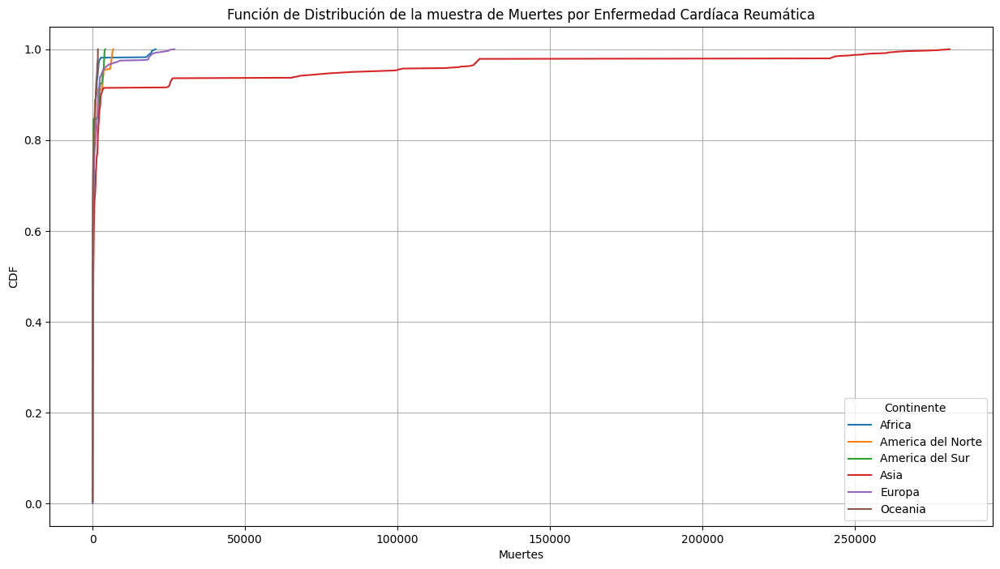

------------------------------------------------------------------------------------------
Distribución acumulativa para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Continente: Africa
CDF por Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
[9.25925926e-04 1.85185185e-03 2.77777778e-03 ... 9.98148148e-01
 9.99074074e-01 1.00000000e+00]
Continente: America del Norte
CDF por Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
[0.00227273 0.00454545 0.00681818 0.00909091 0.01136364 0.01363636
 0.01590909 0.01818182 0.02045455 0.02272727 0.025      0.02727273
 0.02954545 0.03181818 0.03409091 0.03636364 0.03863636 0.04090909
 0.04318182 0.04545455 0.04772727 0.05       0.05227273 0.05454545
 0.05681818 0.05909091 0.06136364 0.06363636 0.06590909 0.06818182
 0.07045455 0.07272727 0.075      0.07727273 0.07954545 0.08181818
 0.08409091 0.08636364 0.08863636 0.09090909 0.09318182 0.09545455
 0.09772727 0.1        0.10227273 0.10454545 0.10681818 0.10909091
 0.11136364 0

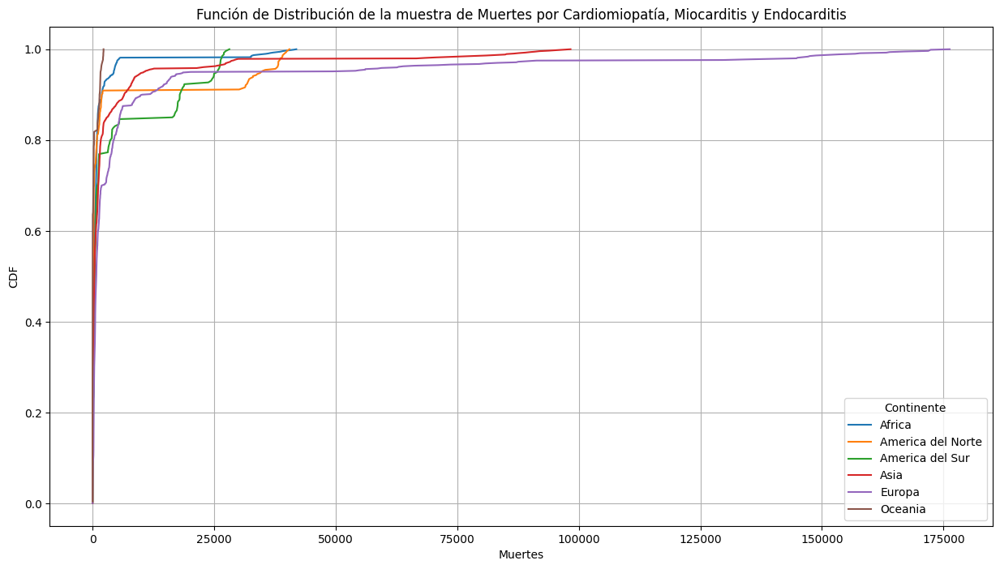

------------------------------------------------------------------------------------------
Distribución acumulativa para Muertes por Enfermedades Circulatorias:
Continente: Africa
CDF por Muertes por Enfermedades Circulatorias:
[9.25925926e-04 1.85185185e-03 2.77777778e-03 ... 9.98148148e-01
 9.99074074e-01 1.00000000e+00]
Continente: America del Norte
CDF por Muertes por Enfermedades Circulatorias:
[0.00227273 0.00454545 0.00681818 0.00909091 0.01136364 0.01363636
 0.01590909 0.01818182 0.02045455 0.02272727 0.025      0.02727273
 0.02954545 0.03181818 0.03409091 0.03636364 0.03863636 0.04090909
 0.04318182 0.04545455 0.04772727 0.05       0.05227273 0.05454545
 0.05681818 0.05909091 0.06136364 0.06363636 0.06590909 0.06818182
 0.07045455 0.07272727 0.075      0.07727273 0.07954545 0.08181818
 0.08409091 0.08636364 0.08863636 0.09090909 0.09318182 0.09545455
 0.09772727 0.1        0.10227273 0.10454545 0.10681818 0.10909091
 0.11136364 0.11363636 0.11590909 0.11818182 0.12045455 0.122

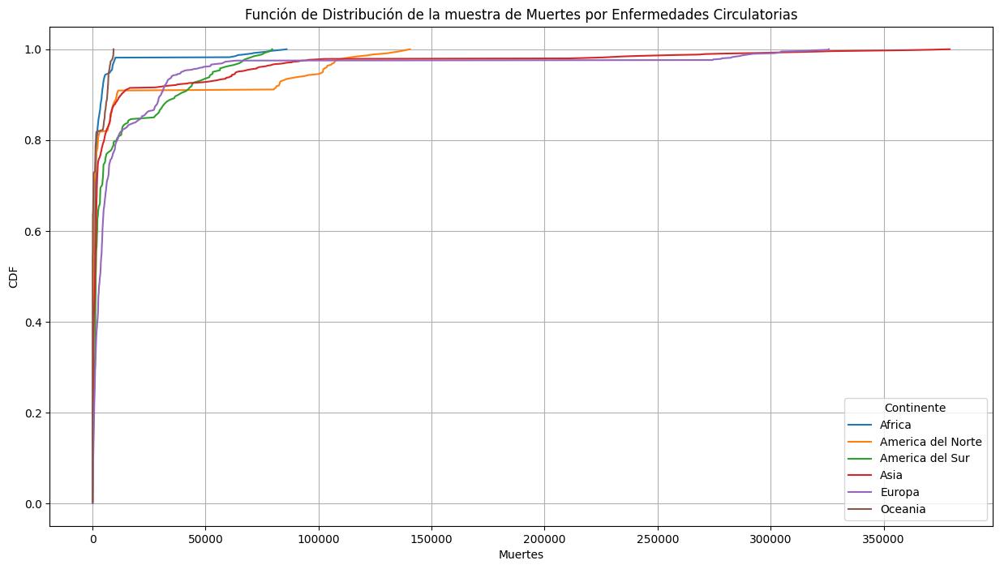

------------------------------------------------------------------------------------------
Distribución acumulativa para Muertes por Enfermedad Cardíaca Hipertensiva:
Continente: Africa
CDF por Muertes por Enfermedad Cardíaca Hipertensiva:
[9.25925926e-04 1.85185185e-03 2.77777778e-03 ... 9.98148148e-01
 9.99074074e-01 1.00000000e+00]
Continente: America del Norte
CDF por Muertes por Enfermedad Cardíaca Hipertensiva:
[0.00227273 0.00454545 0.00681818 0.00909091 0.01136364 0.01363636
 0.01590909 0.01818182 0.02045455 0.02272727 0.025      0.02727273
 0.02954545 0.03181818 0.03409091 0.03636364 0.03863636 0.04090909
 0.04318182 0.04545455 0.04772727 0.05       0.05227273 0.05454545
 0.05681818 0.05909091 0.06136364 0.06363636 0.06590909 0.06818182
 0.07045455 0.07272727 0.075      0.07727273 0.07954545 0.08181818
 0.08409091 0.08636364 0.08863636 0.09090909 0.09318182 0.09545455
 0.09772727 0.1        0.10227273 0.10454545 0.10681818 0.10909091
 0.11136364 0.11363636 0.11590909 0.1181818

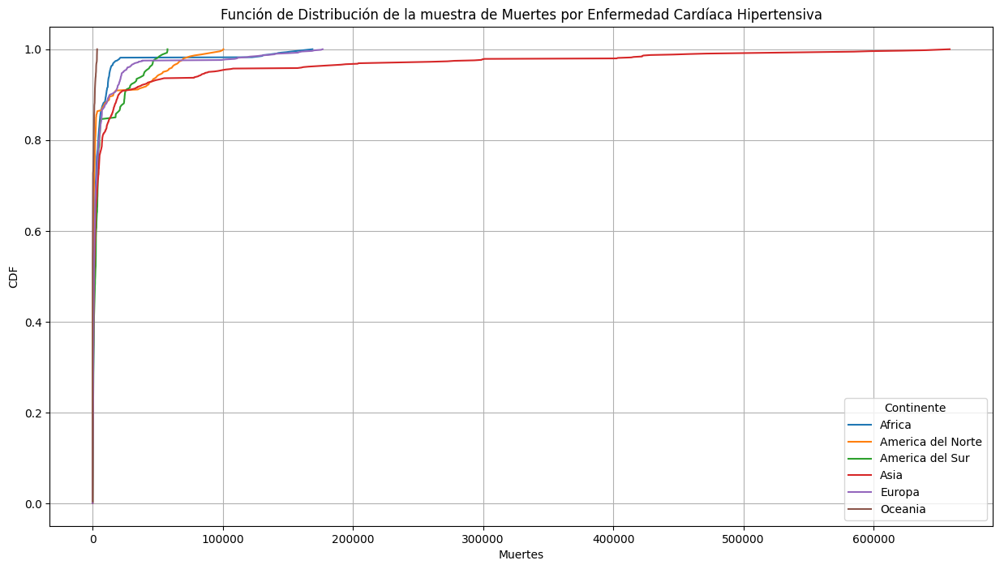

------------------------------------------------------------------------------------------
Distribución acumulativa para Muertes por Ictus Isquémico:
Continente: Africa
CDF por Muertes por Ictus Isquémico:
[9.25925926e-04 1.85185185e-03 2.77777778e-03 ... 9.98148148e-01
 9.99074074e-01 1.00000000e+00]
Continente: America del Norte
CDF por Muertes por Ictus Isquémico:
[0.00227273 0.00454545 0.00681818 0.00909091 0.01136364 0.01363636
 0.01590909 0.01818182 0.02045455 0.02272727 0.025      0.02727273
 0.02954545 0.03181818 0.03409091 0.03636364 0.03863636 0.04090909
 0.04318182 0.04545455 0.04772727 0.05       0.05227273 0.05454545
 0.05681818 0.05909091 0.06136364 0.06363636 0.06590909 0.06818182
 0.07045455 0.07272727 0.075      0.07727273 0.07954545 0.08181818
 0.08409091 0.08636364 0.08863636 0.09090909 0.09318182 0.09545455
 0.09772727 0.1        0.10227273 0.10454545 0.10681818 0.10909091
 0.11136364 0.11363636 0.11590909 0.11818182 0.12045455 0.12272727
 0.125      0.12727273 0.12

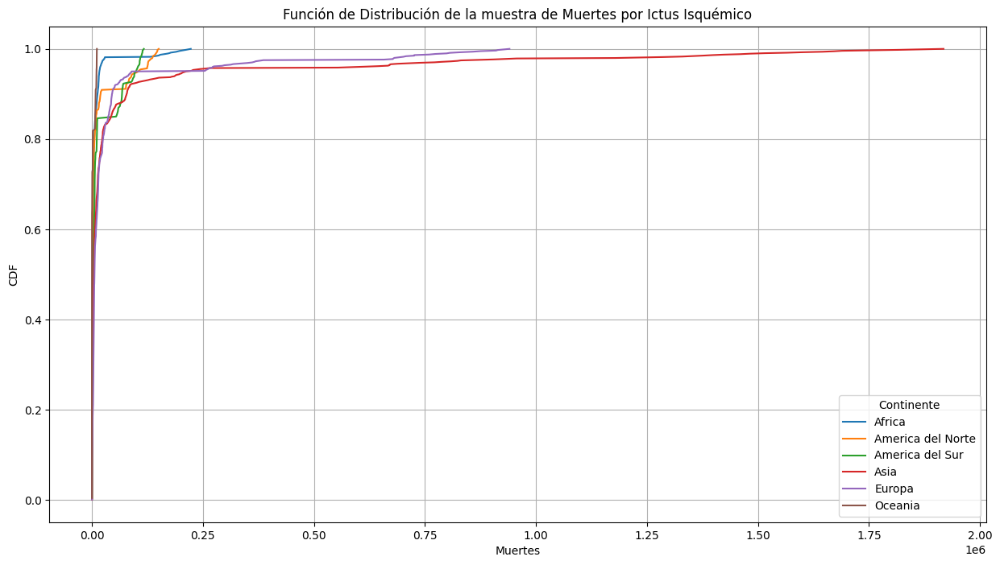

------------------------------------------------------------------------------------------
Distribución acumulativa para Muertes por Ictus Hemorrágico:
Continente: Africa
CDF por Muertes por Ictus Hemorrágico:
[9.25925926e-04 1.85185185e-03 2.77777778e-03 ... 9.98148148e-01
 9.99074074e-01 1.00000000e+00]
Continente: America del Norte
CDF por Muertes por Ictus Hemorrágico:
[0.00227273 0.00454545 0.00681818 0.00909091 0.01136364 0.01363636
 0.01590909 0.01818182 0.02045455 0.02272727 0.025      0.02727273
 0.02954545 0.03181818 0.03409091 0.03636364 0.03863636 0.04090909
 0.04318182 0.04545455 0.04772727 0.05       0.05227273 0.05454545
 0.05681818 0.05909091 0.06136364 0.06363636 0.06590909 0.06818182
 0.07045455 0.07272727 0.075      0.07727273 0.07954545 0.08181818
 0.08409091 0.08636364 0.08863636 0.09090909 0.09318182 0.09545455
 0.09772727 0.1        0.10227273 0.10454545 0.10681818 0.10909091
 0.11136364 0.11363636 0.11590909 0.11818182 0.12045455 0.12272727
 0.125      0.1272727

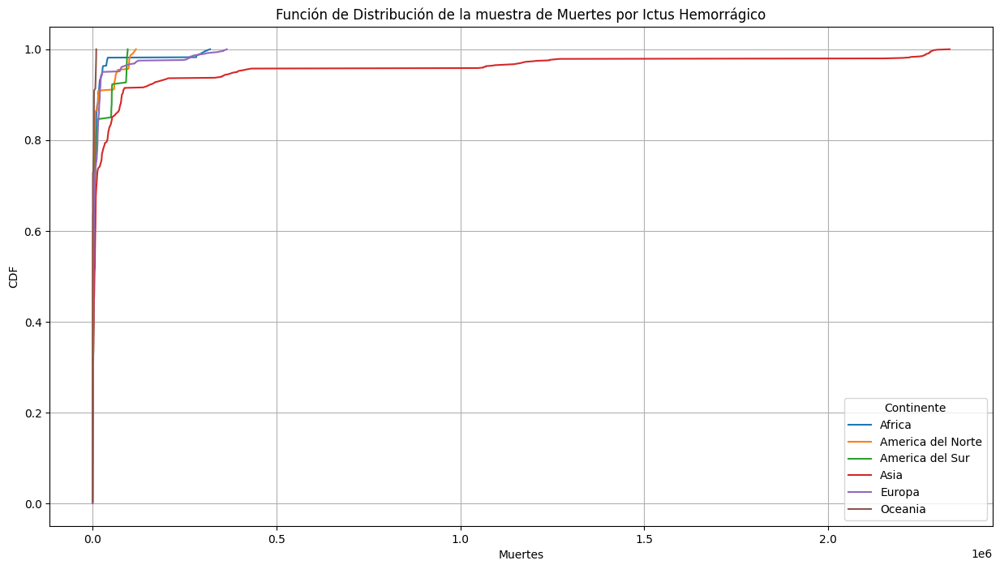

------------------------------------------------------------------------------------------
Distribución acumulativa para Muertes por Enfermedad Cardíaca Isquémica:
Continente: Africa
CDF por Muertes por Enfermedad Cardíaca Isquémica:
[9.25925926e-04 1.85185185e-03 2.77777778e-03 ... 9.98148148e-01
 9.99074074e-01 1.00000000e+00]
Continente: America del Norte
CDF por Muertes por Enfermedad Cardíaca Isquémica:
[0.00227273 0.00454545 0.00681818 0.00909091 0.01136364 0.01363636
 0.01590909 0.01818182 0.02045455 0.02272727 0.025      0.02727273
 0.02954545 0.03181818 0.03409091 0.03636364 0.03863636 0.04090909
 0.04318182 0.04545455 0.04772727 0.05       0.05227273 0.05454545
 0.05681818 0.05909091 0.06136364 0.06363636 0.06590909 0.06818182
 0.07045455 0.07272727 0.075      0.07727273 0.07954545 0.08181818
 0.08409091 0.08636364 0.08863636 0.09090909 0.09318182 0.09545455
 0.09772727 0.1        0.10227273 0.10454545 0.10681818 0.10909091
 0.11136364 0.11363636 0.11590909 0.11818182 0.12045

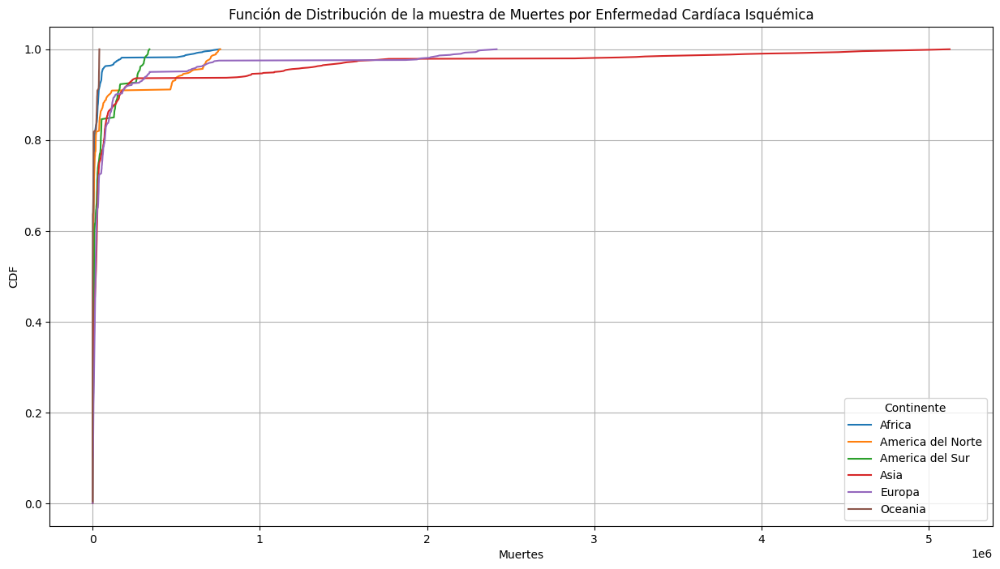

------------------------------------------------------------------------------------------


In [32]:
# Definir la función para calcular la función de distribución de la muestra (CDF)
def calcular_cdf(FDP):
    valores_ordenados = np.sort(FDP)
    cdf = np.arange(1, len(valores_ordenados) + 1) / len(valores_ordenados)
    return valores_ordenados, cdf

# Iterar sobre cada patología
for patologia in patologias:
    plt.figure(figsize=(15, 8))  # Crear una nueva figura para cada patología
    patologia_legible = reemplazar_texto(patologia)
    print(f"Distribución acumulativa para {patologia_legible}:")

    # Iterar sobre cada continente y sus respectivos países
    for continente, paises in continentes.items():
        df_continente = df[df['Entity'].isin(paises)]  # Filtrar el DataFrame por los países del continente actual
        FDP = calcular_densidad_probabilidad(df_continente, patologia)  # Calcular la densidad de probabilidad

        # Calcular e imprimir CDF
        valores_ordenados, cdf = calcular_cdf(FDP)
        print(f"Continente: {continente}")
        print(f"CDF por {patologia_legible}:\n{cdf}")
        print("=" * 90)

        # Graficar la CDF
        plt.plot(valores_ordenados, cdf, label=continente)  # Usar plot para graficar la CDF de cada continente

    # Configurar la gráfica
    plt.title(f'Función de Distribución de la muestra de {patologia_legible}')
    plt.xlabel('Muertes')
    plt.ylabel('CDF')
    plt.legend(title='Continente')
    plt.grid(True)
    plt.show()

    print("-" * 90)

## Función de densidad de probabilidad teórica

Densidad de probabilidad teórica para Muertes por Enfermedad Cardíaca Reumática:
Continente: Africa
Media y desviación estándar por Muertes por Enfermedad Cardíaca Reumática son:
Media: 695.2907416666666, Desviación Estándar: 2553.8927530788687
Continente: America del Norte
Media y desviación estándar por Muertes por Enfermedad Cardíaca Reumática son:
Media: 567.6289115909091, Desviación Estándar: 1436.8451596787072
Continente: America del Sur
Media y desviación estándar por Muertes por Enfermedad Cardíaca Reumática son:
Media: 557.4066938461539, Desviación Estándar: 1054.3435040715408
Continente: Asia
Media y desviación estándar por Muertes por Enfermedad Cardíaca Reumática son:
Media: 10926.722861702128, Desviación Estándar: 42168.82038329492
Continente: Europa
Media y desviación estándar por Muertes por Enfermedad Cardíaca Reumática son:
Media: 1031.65173, Desviación Estándar: 3336.93423263621
Continente: Oceania
Media y desviación estándar por Muertes por Enfermedad Cardíaca Reumát

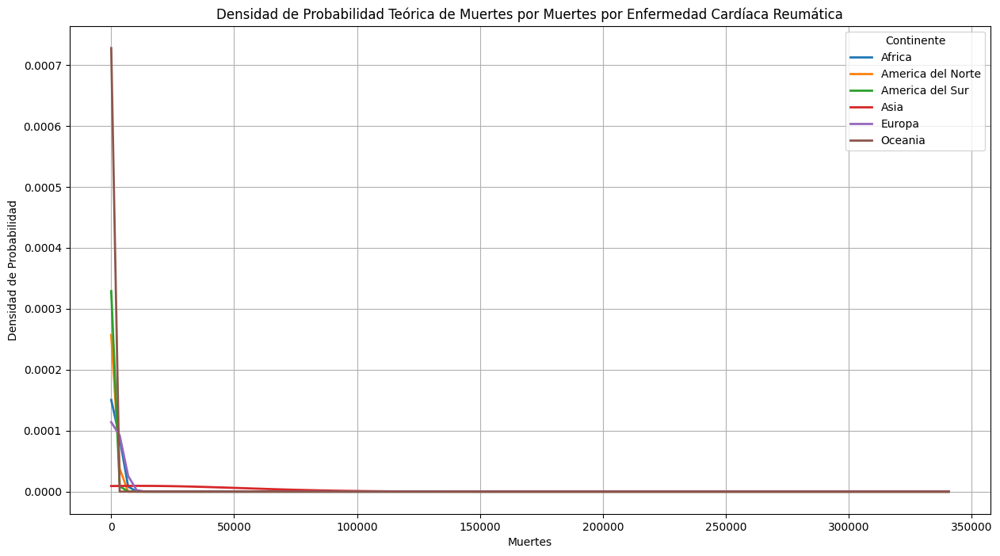

------------------------------------------------------------------------------------------
Densidad de probabilidad teórica para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Continente: Africa
Media y desviación estándar por Muertes por Cardiomiopatía, Miocarditis y Endocarditis son:
Media: 1334.9662305555557, Desviación Estándar: 4948.268206693669
Continente: America del Norte
Media y desviación estándar por Muertes por Cardiomiopatía, Miocarditis y Endocarditis son:
Media: 3528.6015749999992, Desviación Estándar: 10239.822402327323
Continente: America del Sur
Media y desviación estándar por Muertes por Cardiomiopatía, Miocarditis y Endocarditis son:
Media: 3993.1508153846157, Desviación Estándar: 7855.3652268629085
Continente: Asia
Media y desviación estándar por Muertes por Cardiomiopatía, Miocarditis y Endocarditis son:
Media: 3559.5303989361705, Desviación Estándar: 12734.601229700465
Continente: Europa
Media y desviación estándar por Muertes por Cardiomiopatía, Miocard

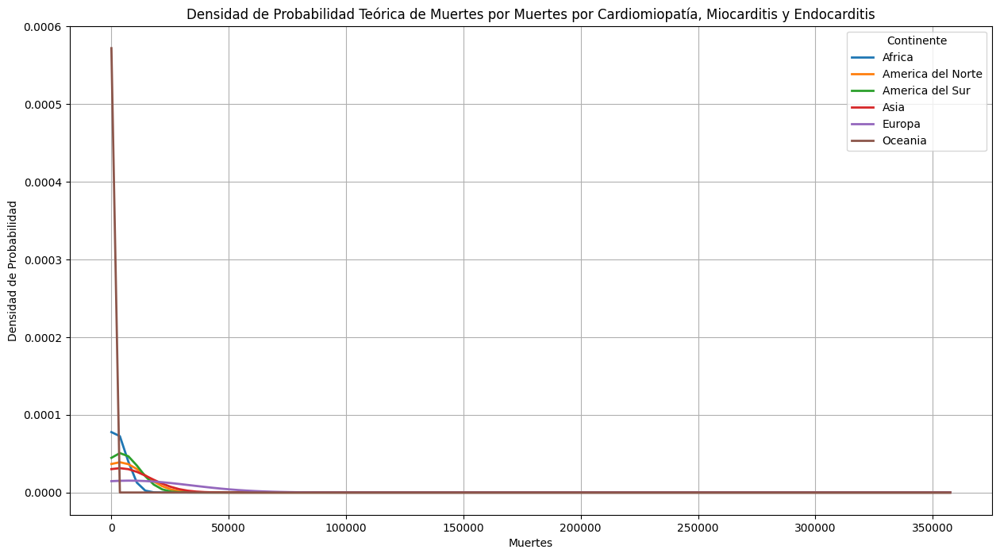

------------------------------------------------------------------------------------------
Densidad de probabilidad teórica para Muertes por Enfermedades Circulatorias:
Continente: Africa
Media y desviación estándar por Muertes por Enfermedades Circulatorias son:
Media: 2629.5956462962963, Desviación Estándar: 9754.930564334583
Continente: America del Norte
Media y desviación estándar por Muertes por Enfermedades Circulatorias son:
Media: 10489.266377272728, Desviación Estándar: 29674.912636008805
Continente: America del Sur
Media y desviación estándar por Muertes por Enfermedades Circulatorias son:
Media: 9494.685046153845, Desviación Estándar: 17945.00039161945
Continente: Asia
Media y desviación estándar por Muertes por Enfermedades Circulatorias son:
Media: 11967.89370212766, Desviación Estándar: 43973.33682524771
Continente: Europa
Media y desviación estándar por Muertes por Enfermedades Circulatorias son:
Media: 14744.563287500001, Desviación Estándar: 46358.65041796922
Continent

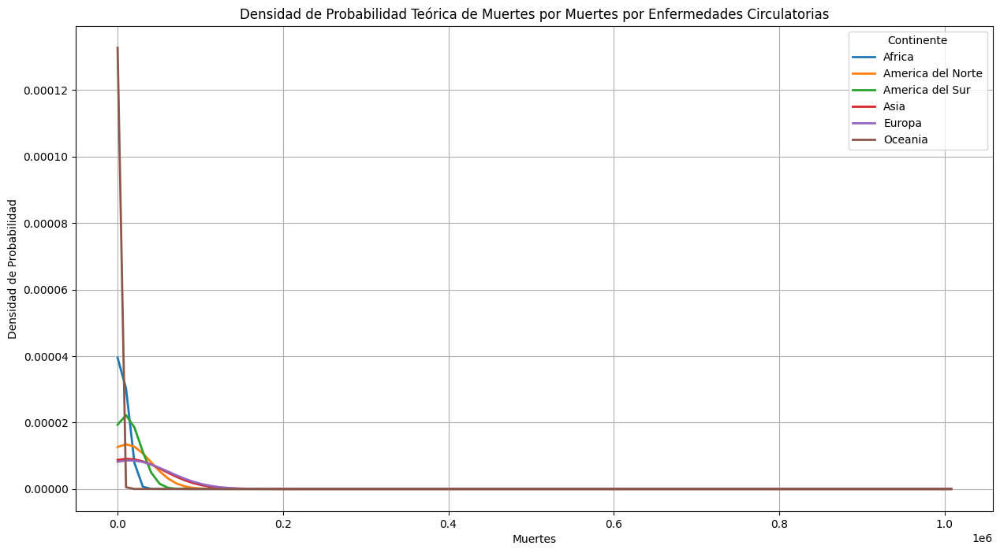

------------------------------------------------------------------------------------------
Densidad de probabilidad teórica para Muertes por Enfermedad Cardíaca Hipertensiva:
Continente: Africa
Media y desviación estándar por Muertes por Enfermedad Cardíaca Hipertensiva son:
Media: 5296.967296296296, Desviación Estándar: 19523.698056505284
Continente: America del Norte
Media y desviación estándar por Muertes por Enfermedad Cardíaca Hipertensiva son:
Media: 6588.228811363637, Desviación Estándar: 18156.521970258826
Continente: America del Sur
Media y desviación estándar por Muertes por Enfermedad Cardíaca Hipertensiva son:
Media: 6899.7429, Desviación Estándar: 12675.080912195825
Continente: Asia
Media y desviación estándar por Muertes por Enfermedad Cardíaca Hipertensiva son:
Media: 21147.484595744678, Desviación Estándar: 80289.84377455947
Continente: Europa
Media y desviación estándar por Muertes por Enfermedad Cardíaca Hipertensiva son:
Media: 6901.512475, Desviación Estándar: 22277

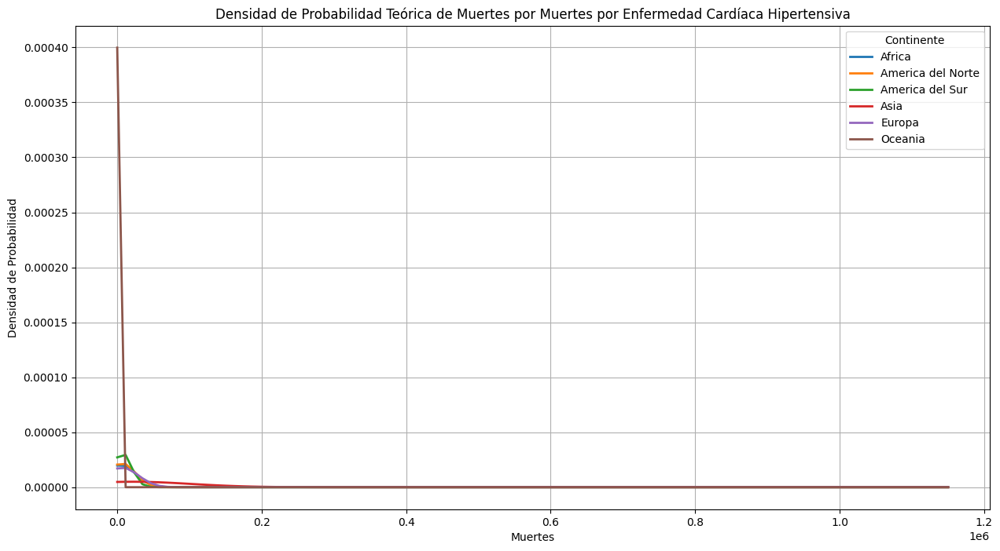

------------------------------------------------------------------------------------------
Densidad de probabilidad teórica para Muertes por Ictus Isquémico:
Continente: Africa
Media y desviación estándar por Muertes por Ictus Isquémico son:
Media: 6525.879962962963, Desviación Estándar: 24275.76307770034
Continente: America del Norte
Media y desviación estándar por Muertes por Ictus Isquémico son:
Media: 12268.663827272727, Desviación Estándar: 32454.877805423588
Continente: America del Sur
Media y desviación estándar por Muertes por Ictus Isquémico son:
Media: 15947.590834615386, Desviación Estándar: 30273.193386921914
Continente: Asia
Media y desviación estándar por Muertes por Ictus Isquémico son:
Media: 64640.36261702128, Desviación Estándar: 245210.81797569175
Continente: Europa
Media y desviación estándar por Muertes por Ictus Isquémico son:
Media: 39087.7288875, Desviación Estándar: 129563.17259516314
Continente: Oceania
Media y desviación estándar por Muertes por Ictus Isquémi

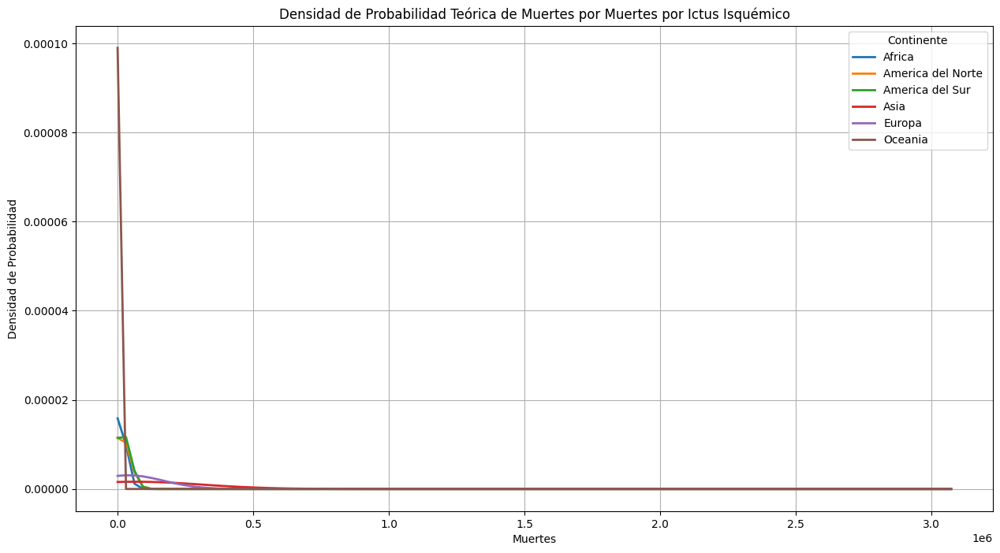

------------------------------------------------------------------------------------------
Densidad de probabilidad teórica para Muertes por Ictus Hemorrágico:
Continente: Africa
Media y desviación estándar por Muertes por Ictus Hemorrágico son:
Media: 10844.348324074075, Desviación Estándar: 39984.93196650453
Continente: America del Norte
Media y desviación estándar por Muertes por Ictus Hemorrágico son:
Media: 9423.106956818181, Desviación Estándar: 24286.682012829126
Continente: America del Sur
Media y desviación estándar por Muertes por Ictus Hemorrágico son:
Media: 14315.283415384616, Desviación Estándar: 26269.856215474847
Continente: Asia
Media y desviación estándar por Muertes por Ictus Hemorrágico son:
Media: 95936.68921276595, Desviación Estándar: 363478.0651168609
Continente: Europa
Media y desviación estándar por Muertes por Ictus Hemorrágico son:
Media: 15018.937725, Desviación Estándar: 48647.424241853354
Continente: Oceania
Media y desviación estándar por Muertes por Ict

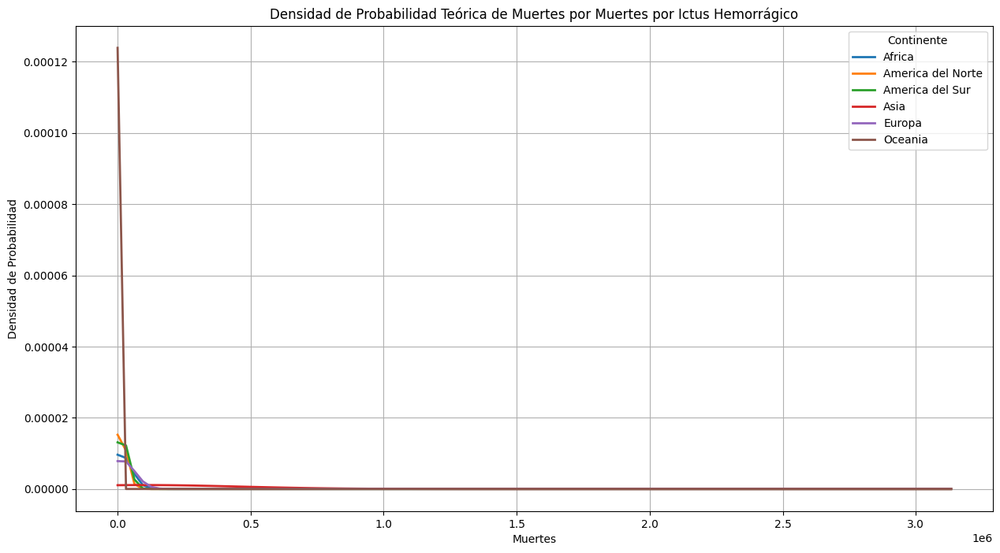

------------------------------------------------------------------------------------------
Densidad de probabilidad teórica para Muertes por Enfermedad Cardíaca Isquémica:
Continente: Africa
Media y desviación estándar por Muertes por Enfermedad Cardíaca Isquémica son:
Media: 22916.073101851853, Desviación Estándar: 86116.19476933702
Continente: America del Norte
Media y desviación estándar por Muertes por Enfermedad Cardíaca Isquémica son:
Media: 63887.88268181818, Desviación Estándar: 175317.2289144048
Continente: America del Sur
Media y desviación estándar por Muertes por Enfermedad Cardíaca Isquémica son:
Media: 45442.8591923077, Desviación Estándar: 81627.86271752833
Continente: Asia
Media y desviación estándar por Muertes por Enfermedad Cardíaca Isquémica son:
Media: 168501.3214893617, Desviación Estándar: 627718.7373810454
Continente: Europa
Media y desviación estándar por Muertes por Enfermedad Cardíaca Isquémica son:
Media: 107147.1270625, Desviación Estándar: 345900.615002906

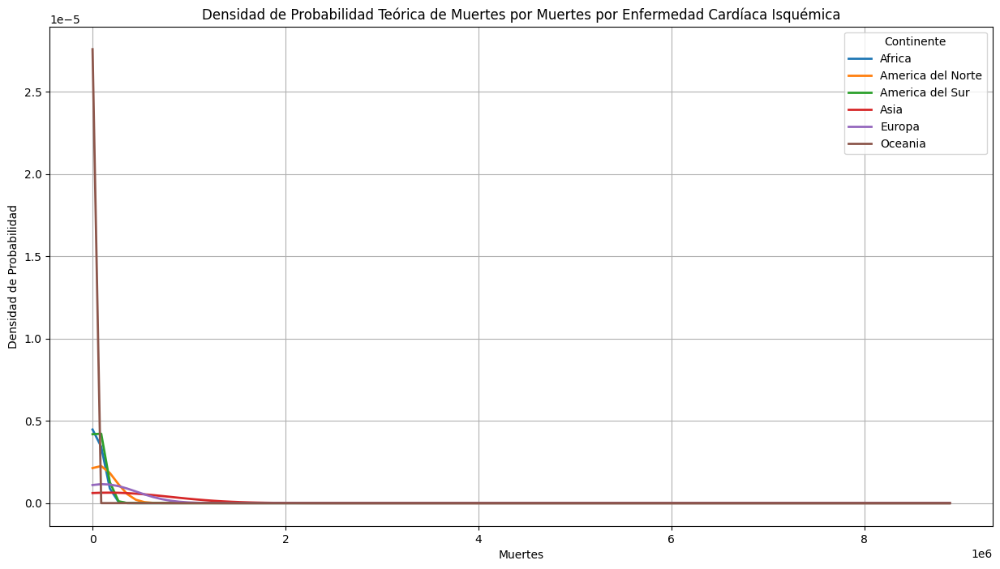

------------------------------------------------------------------------------------------


In [33]:
# Función para calcular la densidad de probabilidad teórica
def calcular_densidad_probabilidad_teorica(df, patologia):
    data_patologia = df[patologia].dropna()
    mu, std = stats.norm.fit(data_patologia)
    return mu, std

# Iterar sobre cada patología
for patologia in patologias:
    plt.figure(figsize=(15, 8))  # Crear una nueva figura para cada patología
    patologia_legible = reemplazar_texto(patologia)
    print(f"Densidad de probabilidad teórica para {patologia_legible}:")

    # Iterar sobre cada continente y sus respectivos países
    for continente, paises in continentes.items():
        df_continente = df[df['Entity'].isin(paises)]  # Filtrar el DataFrame por los países del continente actual

        # Calcular los parámetros mu (media) y std (desviación estándar) de la distribución normal
        mu, std = calcular_densidad_probabilidad_teorica(df_continente, patologia)

        # Imprimir los parámetros teóricos en la consola
        print(f"Continente: {continente}")
        print(f"Media y desviación estándar por {patologia_legible} son:\nMedia: {mu}, Desviación Estándar: {std}")
        print("=" * 90)

        # Crear un rango de valores para x
        data_patologia = df[patologia].dropna()
        xmin, xmax = data_patologia.min(), data_patologia.max()
        x = np.linspace(xmin, xmax, 100)

        # Calcular la densidad de probabilidad teórica (PDF)
        p = stats.norm.pdf(x, mu, std)

        # Graficar la densidad de probabilidad teórica
        plt.plot(x, p, linewidth=2, label=continente)  # Usar plot para graficar la densidad teórica de cada continente

    # Configurar la gráfica
    plt.title(f'Densidad de Probabilidad Teórica de Muertes por {patologia_legible}')
    plt.xlabel('Muertes')
    plt.ylabel('Densidad de Probabilidad')
    plt.legend(title='Continente')
    plt.grid(True)
    plt.show()

    print("-" * 90)

## Comparación entre función de distribución de la muestra y la teórica

Comparación de la función de distribución de la muestra y la teórica para Muertes por Enfermedad Cardíaca Reumática:


<Figure size 1500x800 with 0 Axes>

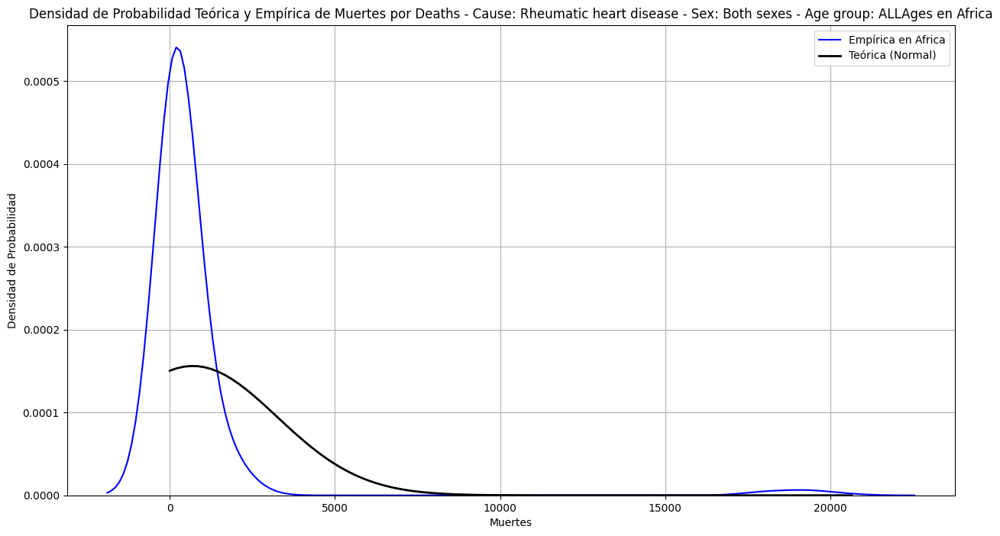

Continente: Africa
Patología: Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 695.2907416666666, Desviación Estándar: 2553.8927530788687


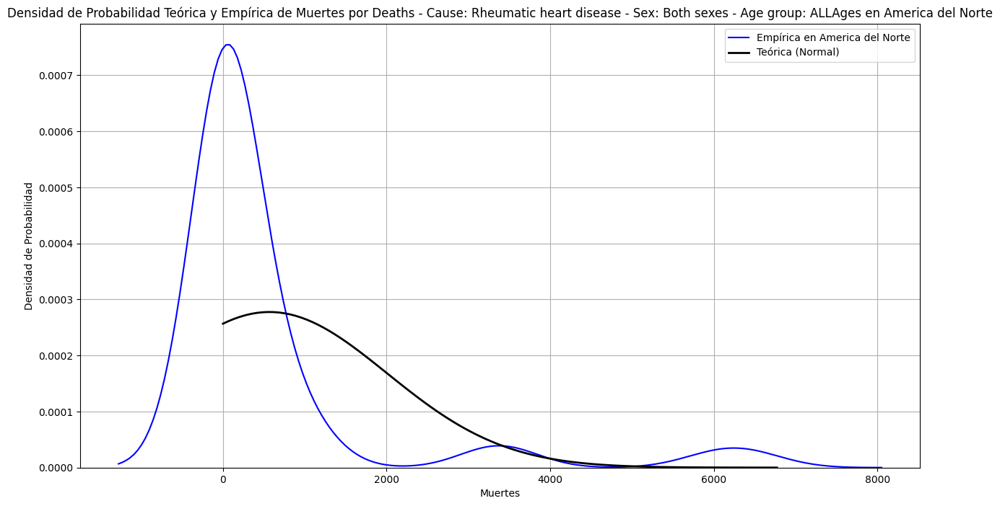

Continente: America del Norte
Patología: Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 567.6289115909091, Desviación Estándar: 1436.8451596787072


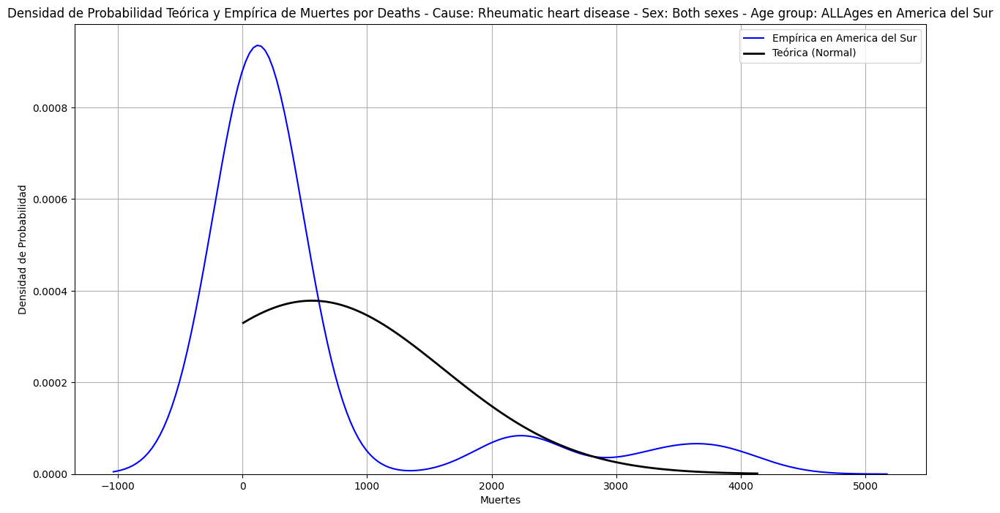

Continente: America del Sur
Patología: Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 557.4066938461539, Desviación Estándar: 1054.3435040715408


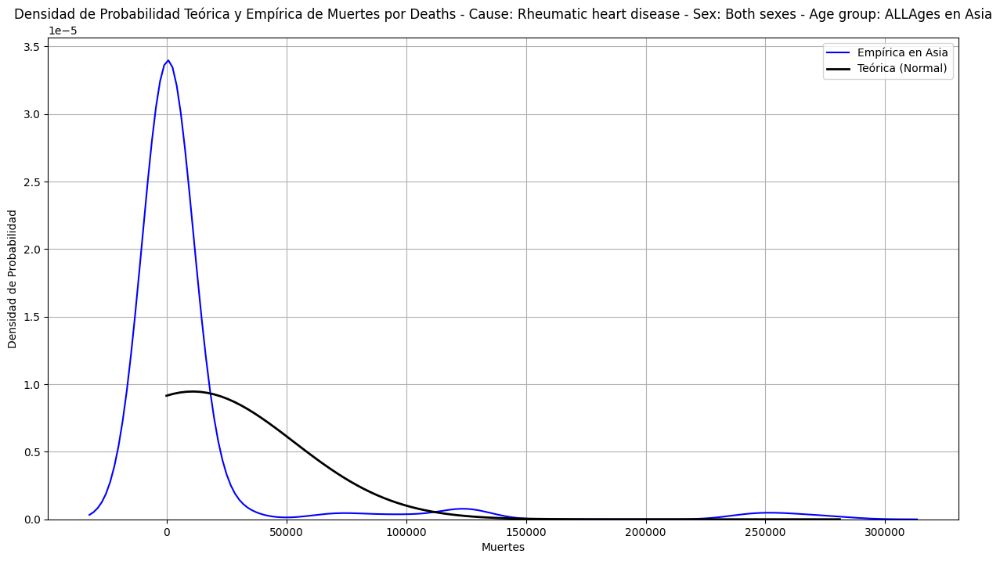

Continente: Asia
Patología: Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 10926.722861702128, Desviación Estándar: 42168.82038329492


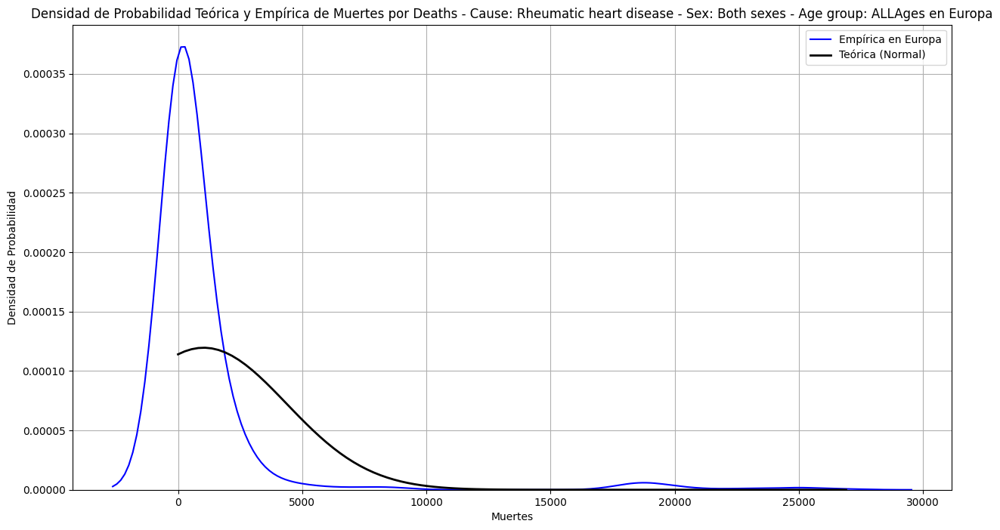

Continente: Europa
Patología: Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 1031.65173, Desviación Estándar: 3336.93423263621


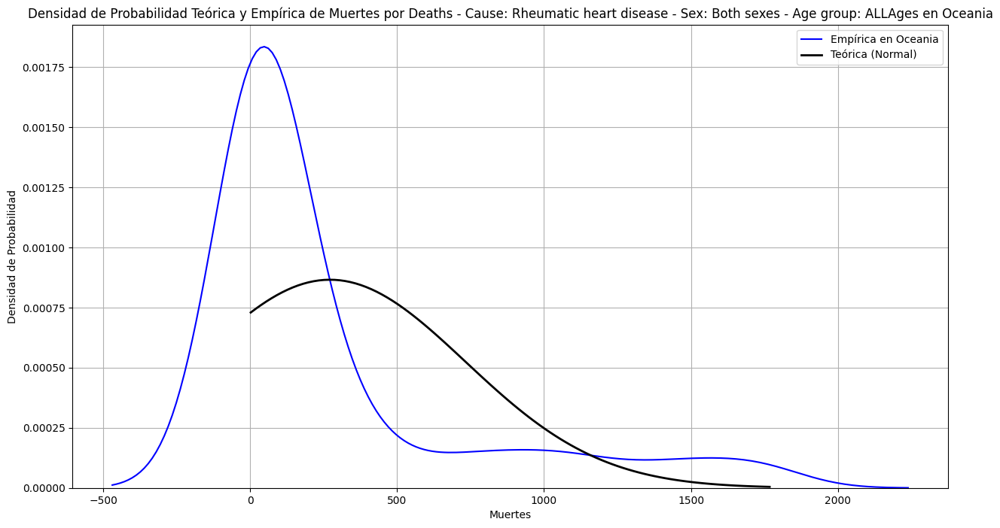

Continente: Oceania
Patología: Deaths - Cause: Rheumatic heart disease - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 271.8251813636364, Desviación Estándar: 460.7085263667545
------------------------------------------------------------------------------------------
Comparación de la función de distribución de la muestra y la teórica para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:


<Figure size 1500x800 with 0 Axes>

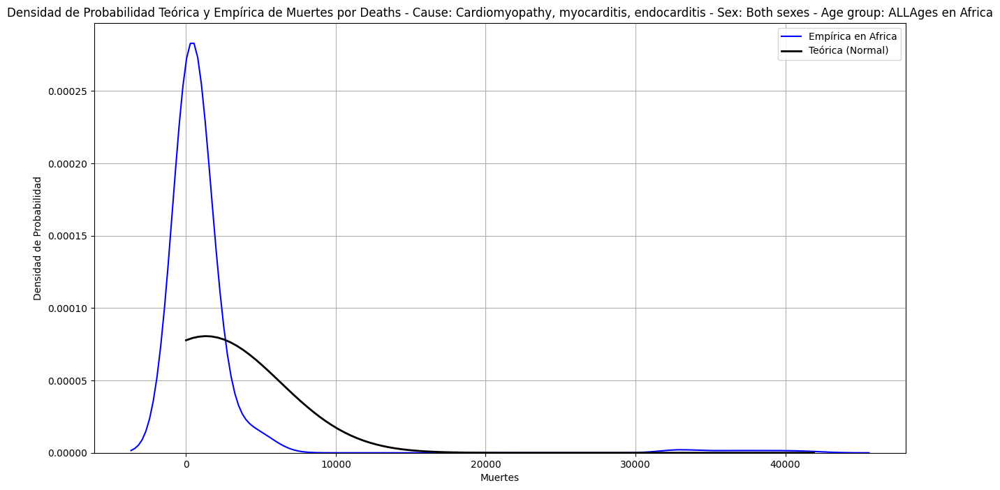

Continente: Africa
Patología: Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 1334.9662305555557, Desviación Estándar: 4948.268206693669


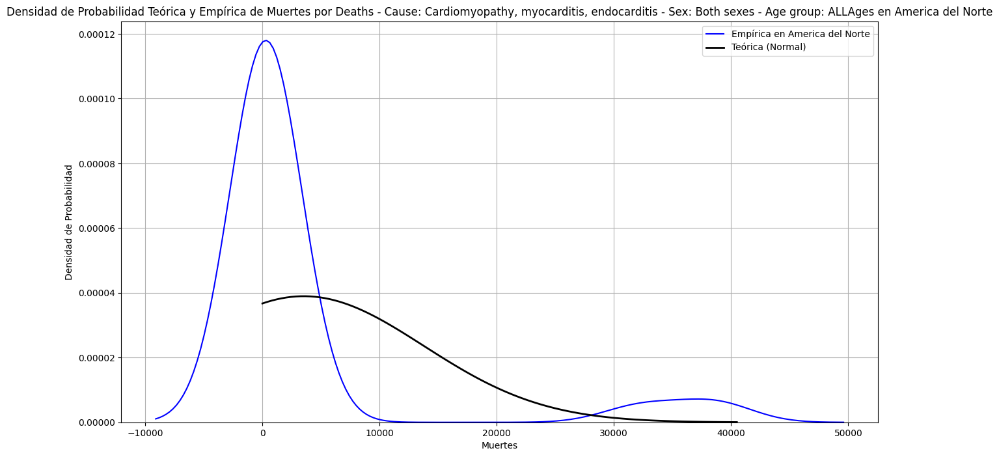

Continente: America del Norte
Patología: Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 3528.6015749999992, Desviación Estándar: 10239.822402327323


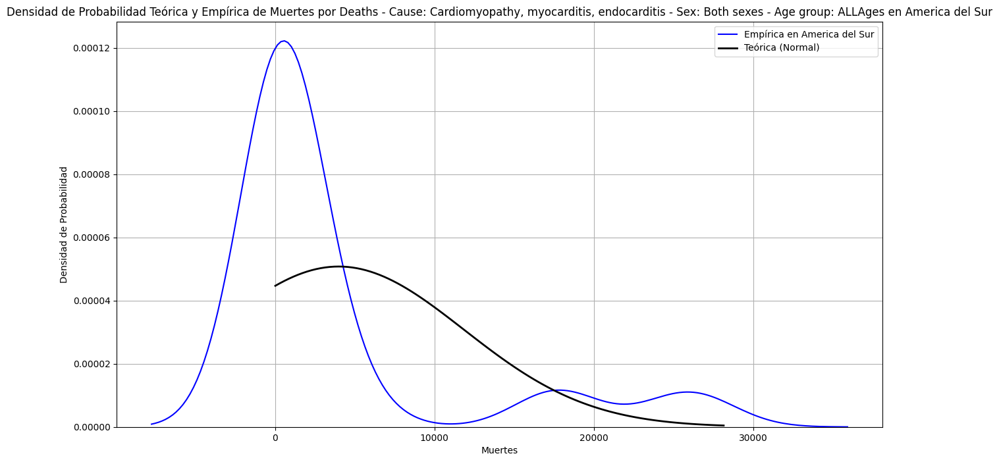

Continente: America del Sur
Patología: Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 3993.1508153846157, Desviación Estándar: 7855.3652268629085


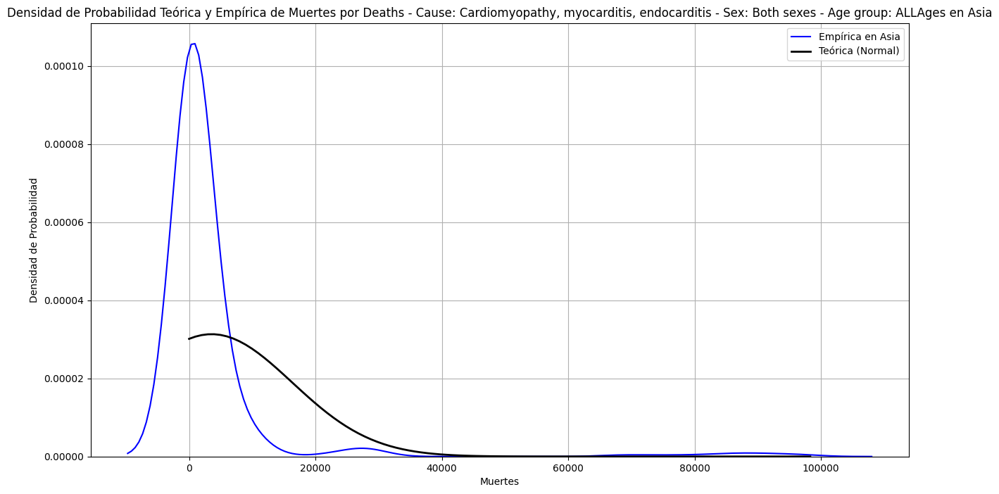

Continente: Asia
Patología: Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 3559.5303989361705, Desviación Estándar: 12734.601229700465


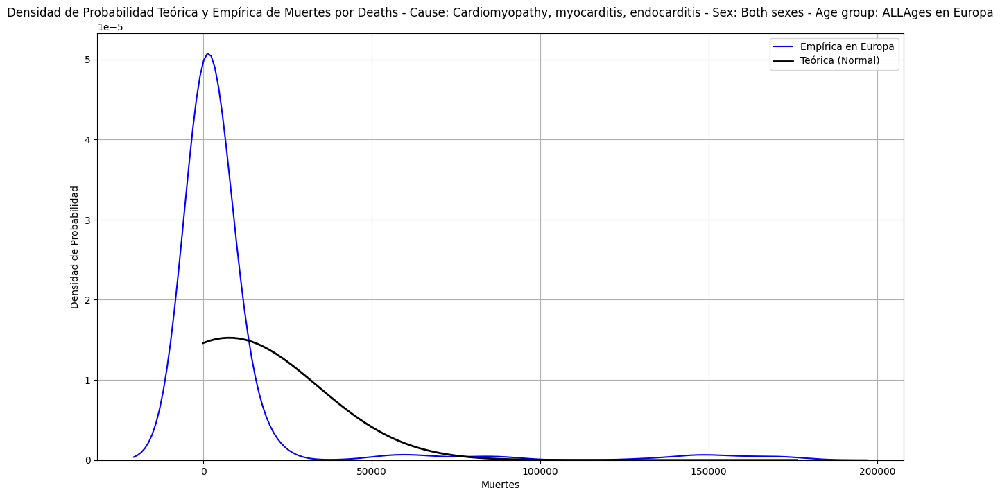

Continente: Europa
Patología: Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 7720.51135, Desviación Estándar: 26133.211786777607


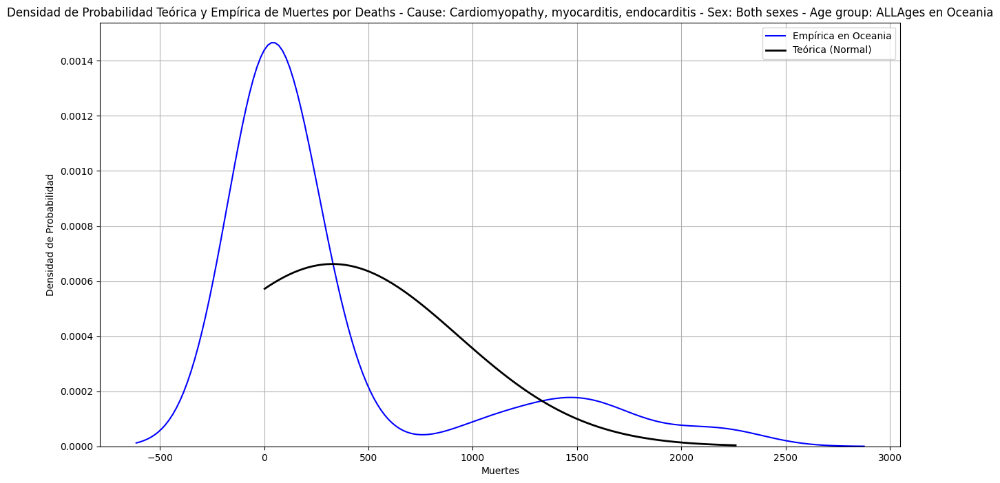

Continente: Oceania
Patología: Deaths - Cause: Cardiomyopathy, myocarditis, endocarditis - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 327.3867259090909, Desviación Estándar: 602.4697700811586
------------------------------------------------------------------------------------------
Comparación de la función de distribución de la muestra y la teórica para Muertes por Enfermedades Circulatorias:


<Figure size 1500x800 with 0 Axes>

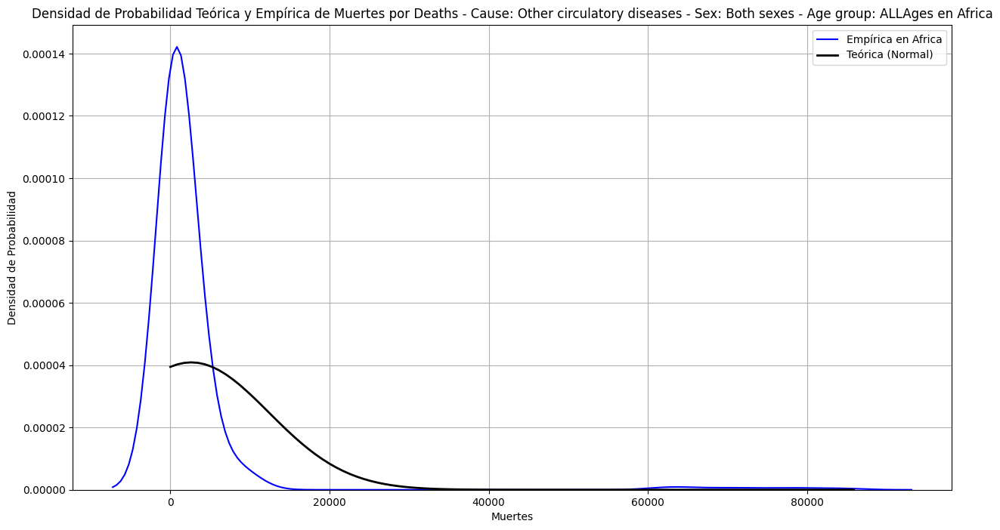

Continente: Africa
Patología: Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 2629.5956462962963, Desviación Estándar: 9754.930564334583


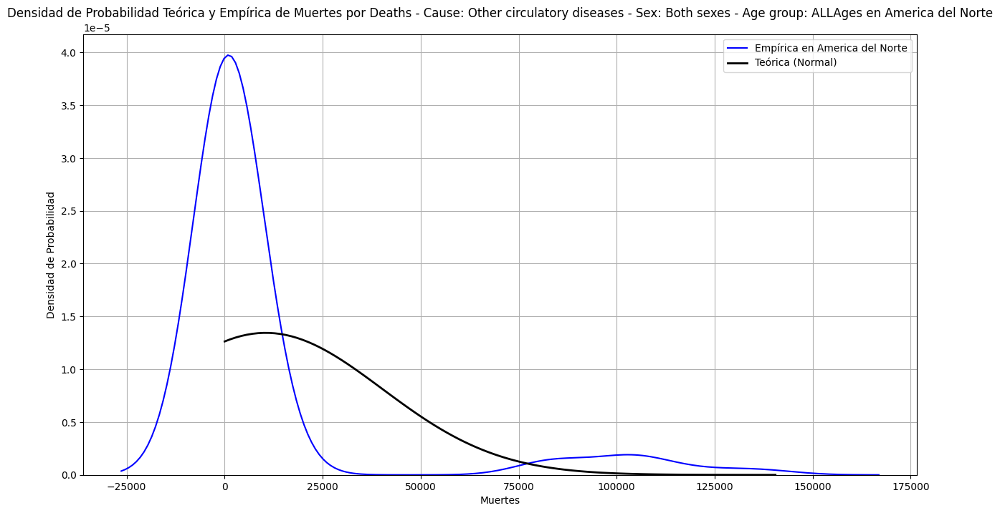

Continente: America del Norte
Patología: Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 10489.266377272728, Desviación Estándar: 29674.912636008805


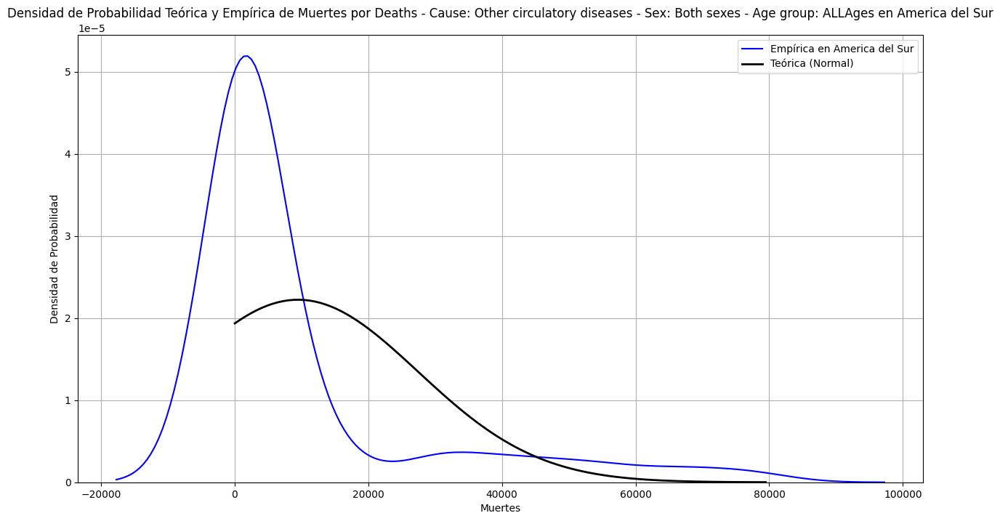

Continente: America del Sur
Patología: Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 9494.685046153845, Desviación Estándar: 17945.00039161945


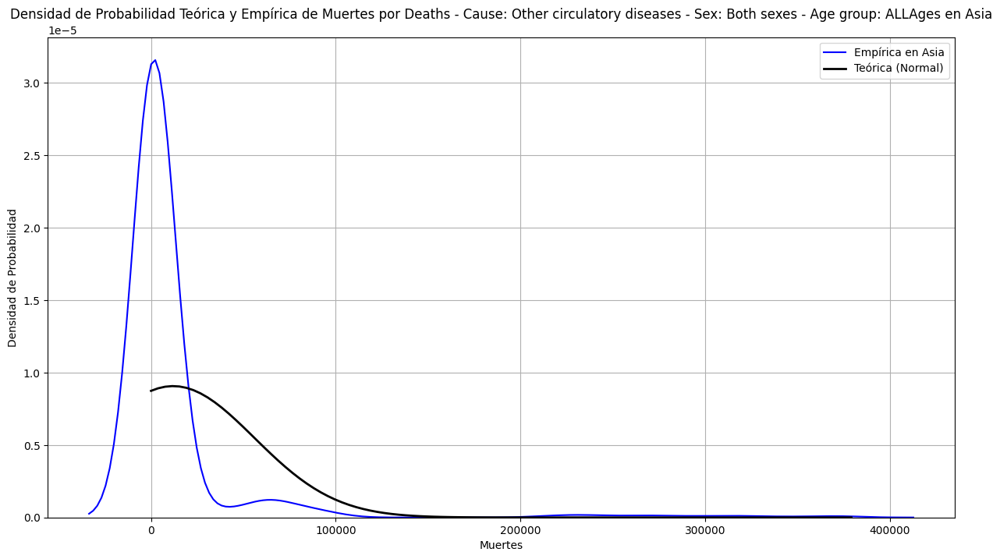

Continente: Asia
Patología: Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 11967.89370212766, Desviación Estándar: 43973.33682524771


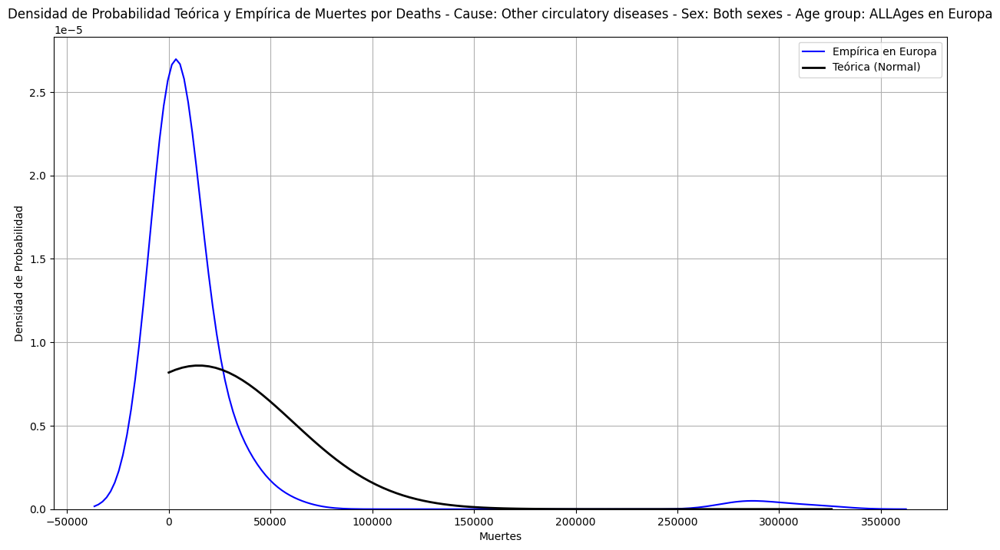

Continente: Europa
Patología: Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 14744.563287500001, Desviación Estándar: 46358.65041796922


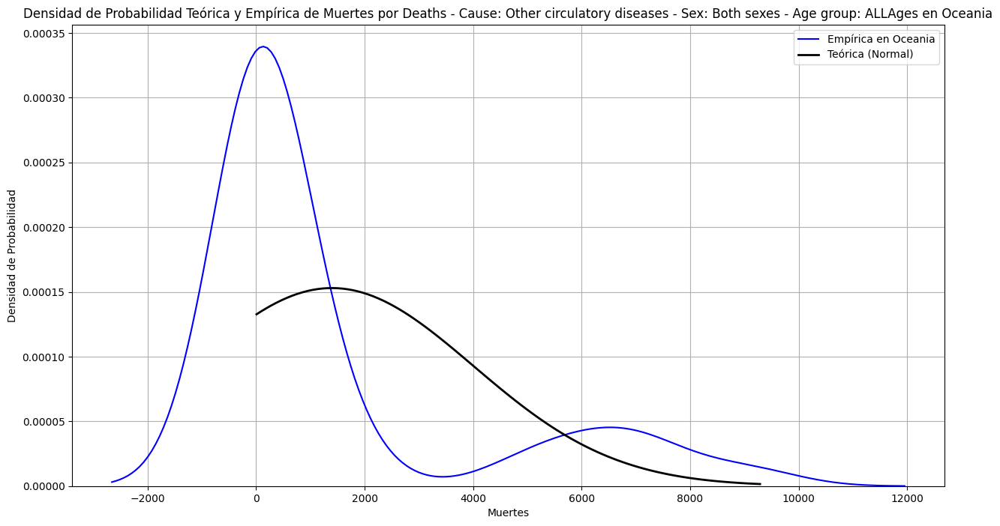

Continente: Oceania
Patología: Deaths - Cause: Other circulatory diseases - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 1397.2931809090908, Desviación Estándar: 2608.1030313971733
------------------------------------------------------------------------------------------
Comparación de la función de distribución de la muestra y la teórica para Muertes por Enfermedad Cardíaca Hipertensiva:


<Figure size 1500x800 with 0 Axes>

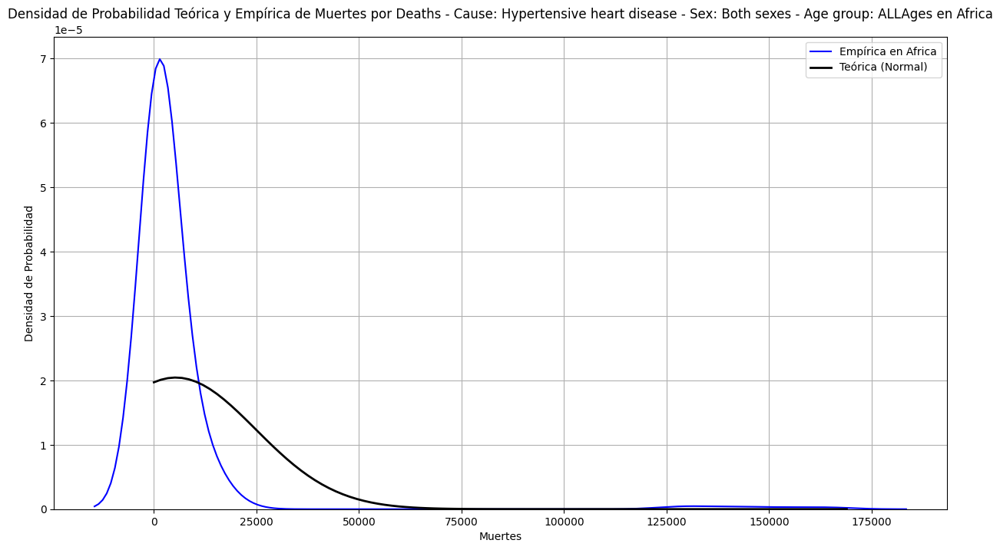

Continente: Africa
Patología: Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 5296.967296296296, Desviación Estándar: 19523.698056505284


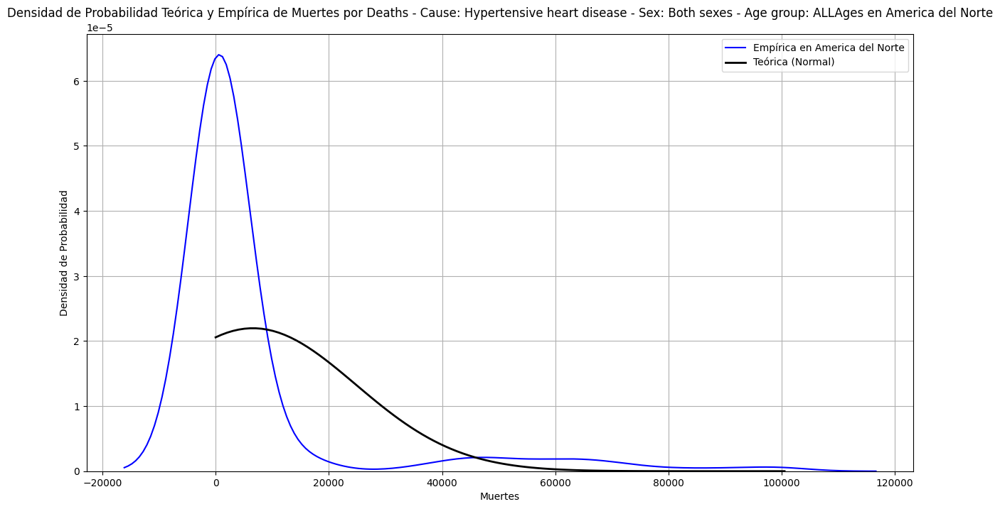

Continente: America del Norte
Patología: Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 6588.228811363637, Desviación Estándar: 18156.521970258826


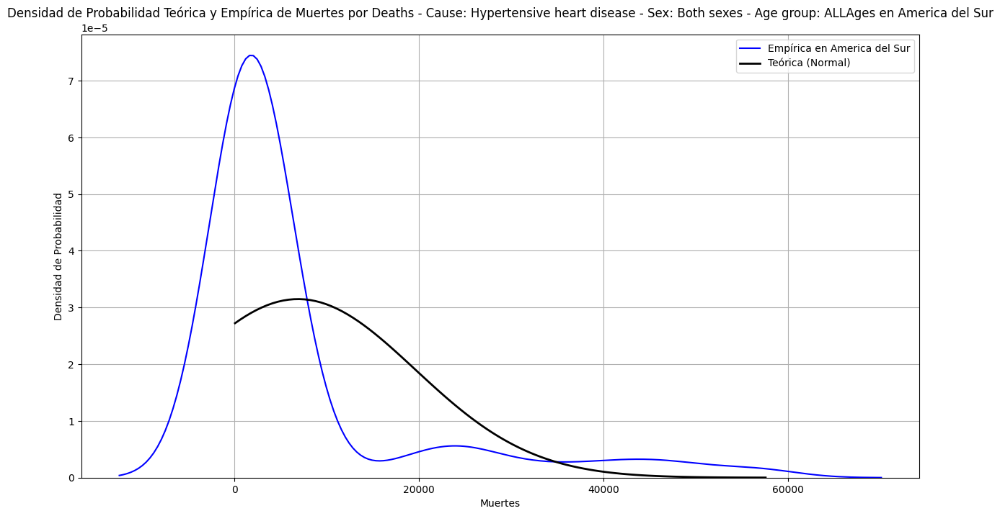

Continente: America del Sur
Patología: Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 6899.7429, Desviación Estándar: 12675.080912195825


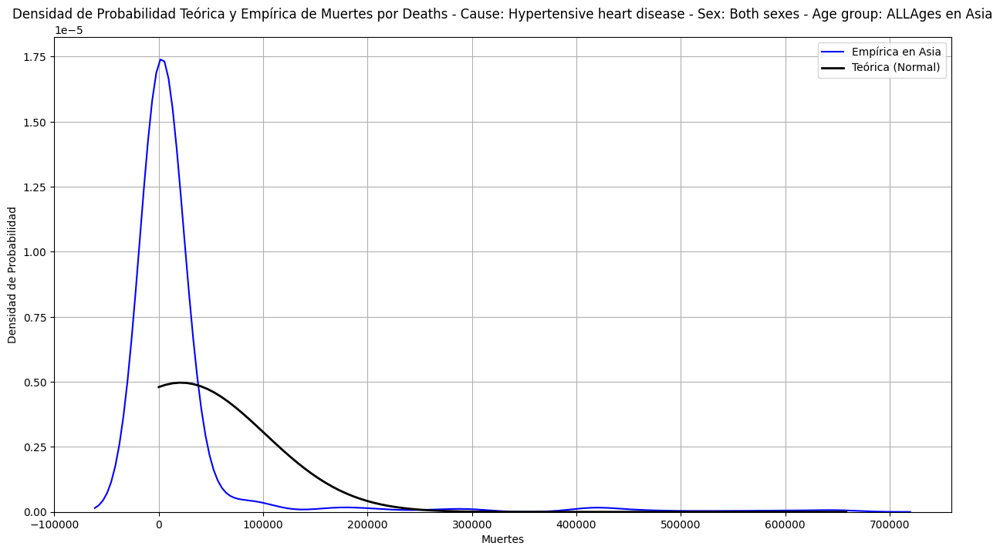

Continente: Asia
Patología: Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 21147.484595744678, Desviación Estándar: 80289.84377455947


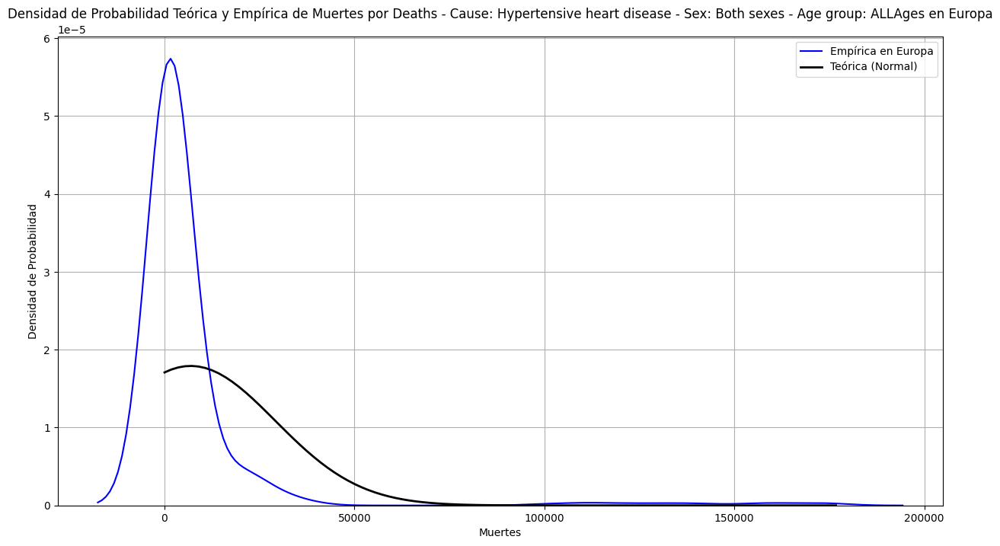

Continente: Europa
Patología: Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 6901.512475, Desviación Estándar: 22277.2616932219


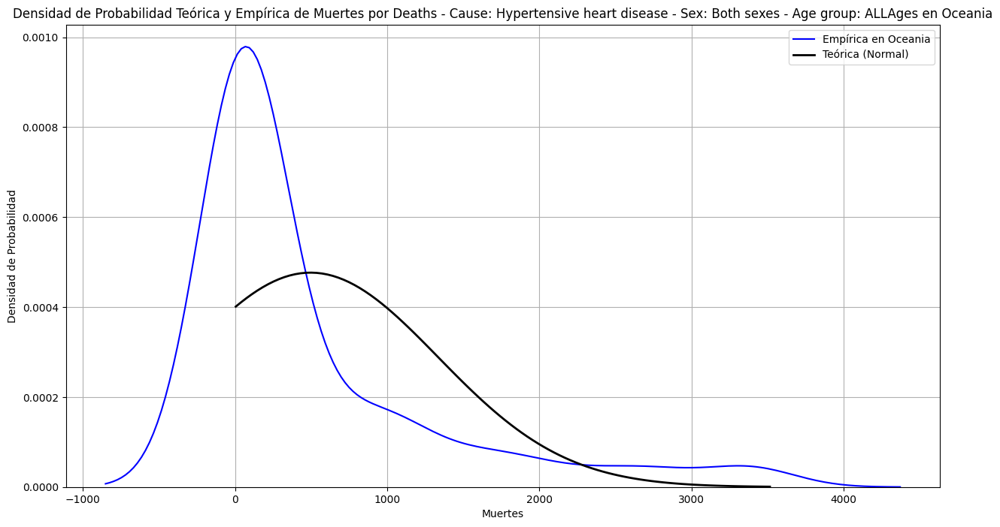

Continente: Oceania
Patología: Deaths - Cause: Hypertensive heart disease - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 496.46036181818187, Desviación Estándar: 836.9911953650172
------------------------------------------------------------------------------------------
Comparación de la función de distribución de la muestra y la teórica para Muertes por Ictus Isquémico:


<Figure size 1500x800 with 0 Axes>

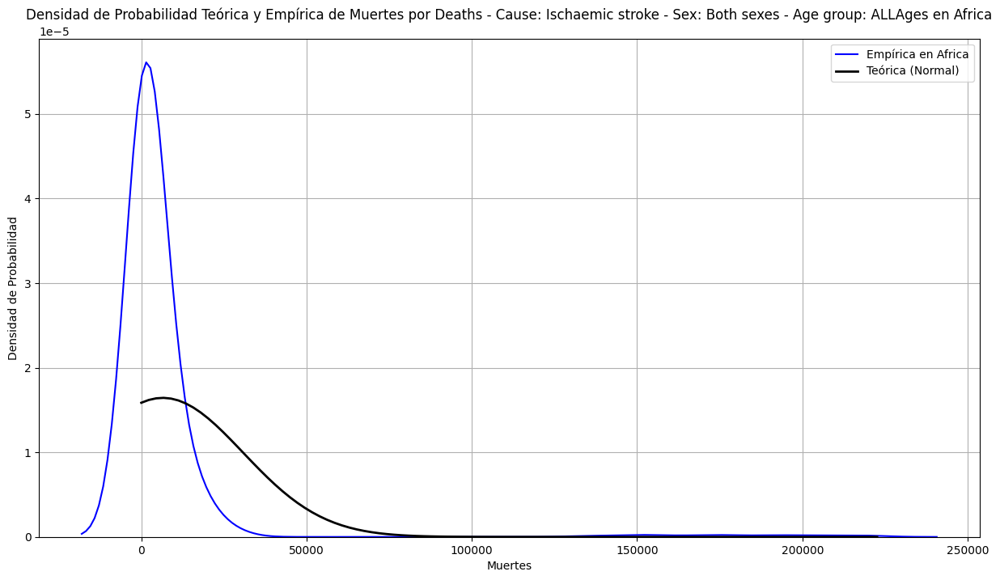

Continente: Africa
Patología: Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 6525.879962962963, Desviación Estándar: 24275.76307770034


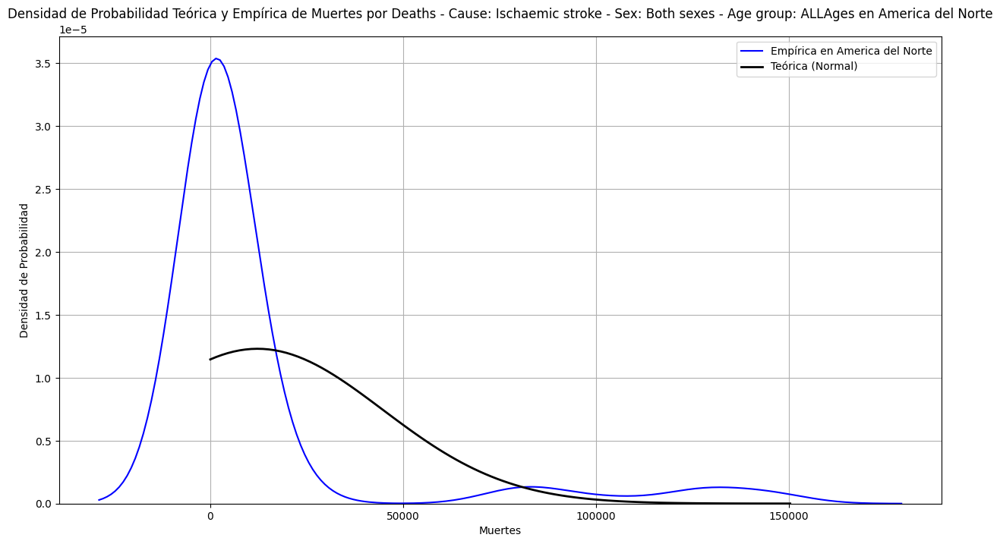

Continente: America del Norte
Patología: Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 12268.663827272727, Desviación Estándar: 32454.877805423588


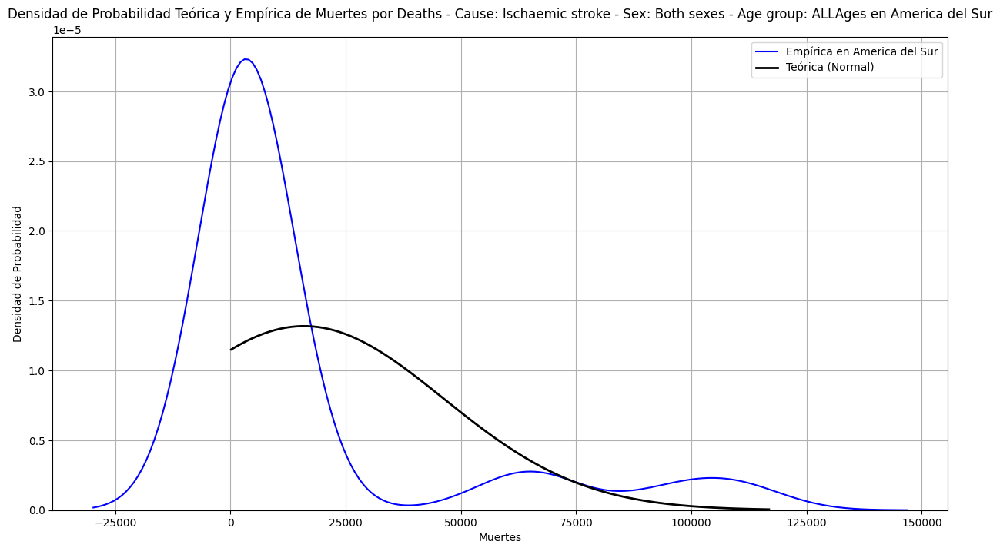

Continente: America del Sur
Patología: Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 15947.590834615386, Desviación Estándar: 30273.193386921914


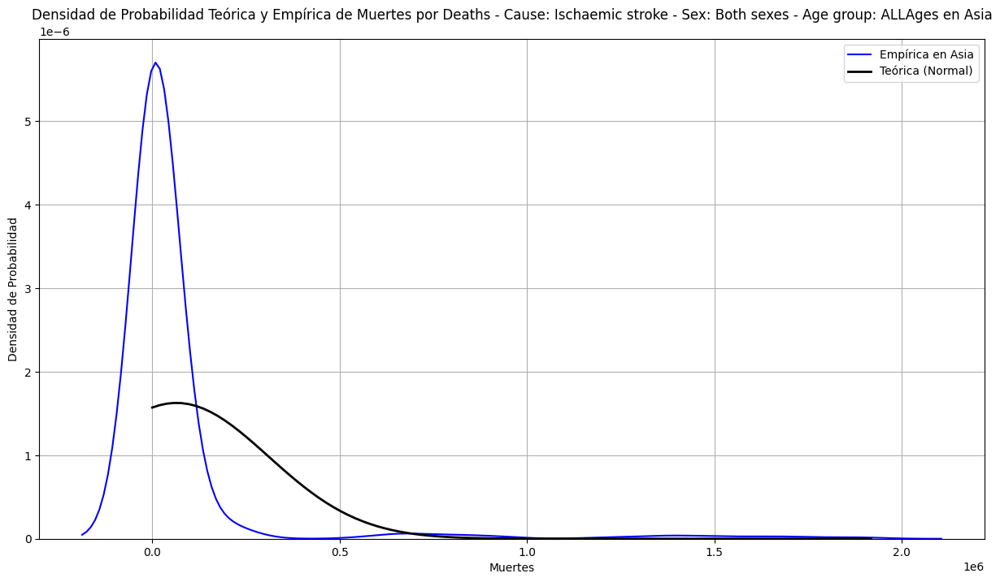

Continente: Asia
Patología: Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 64640.36261702128, Desviación Estándar: 245210.81797569175


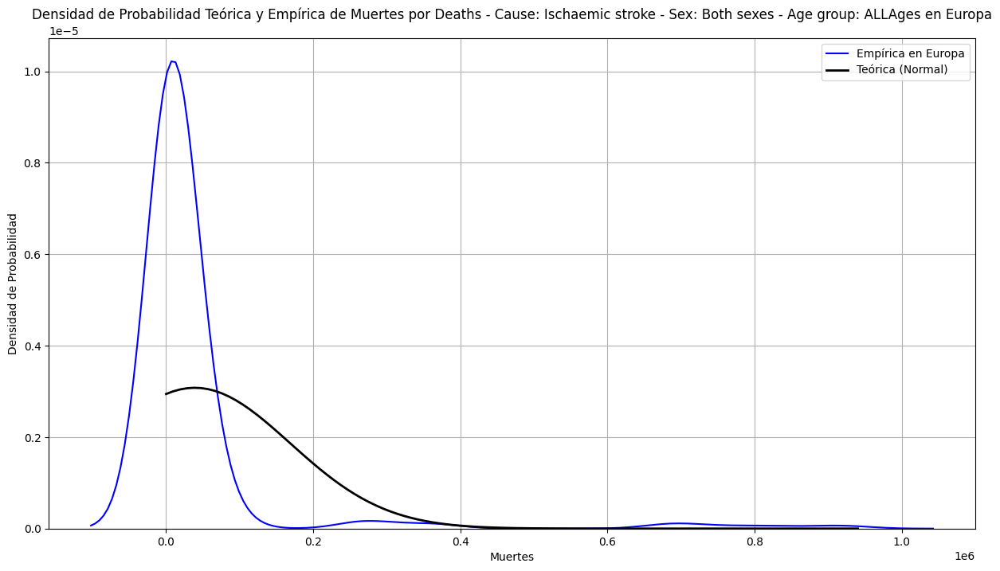

Continente: Europa
Patología: Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 39087.7288875, Desviación Estándar: 129563.17259516314


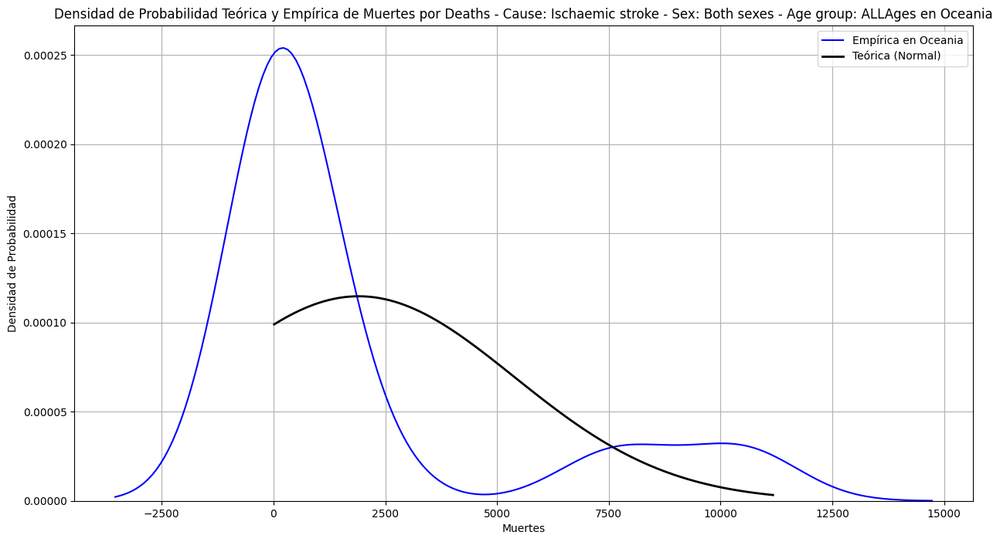

Continente: Oceania
Patología: Deaths - Cause: Ischaemic stroke - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 1905.1367363636361, Desviación Estándar: 3476.464988387733
------------------------------------------------------------------------------------------
Comparación de la función de distribución de la muestra y la teórica para Muertes por Ictus Hemorrágico:


<Figure size 1500x800 with 0 Axes>

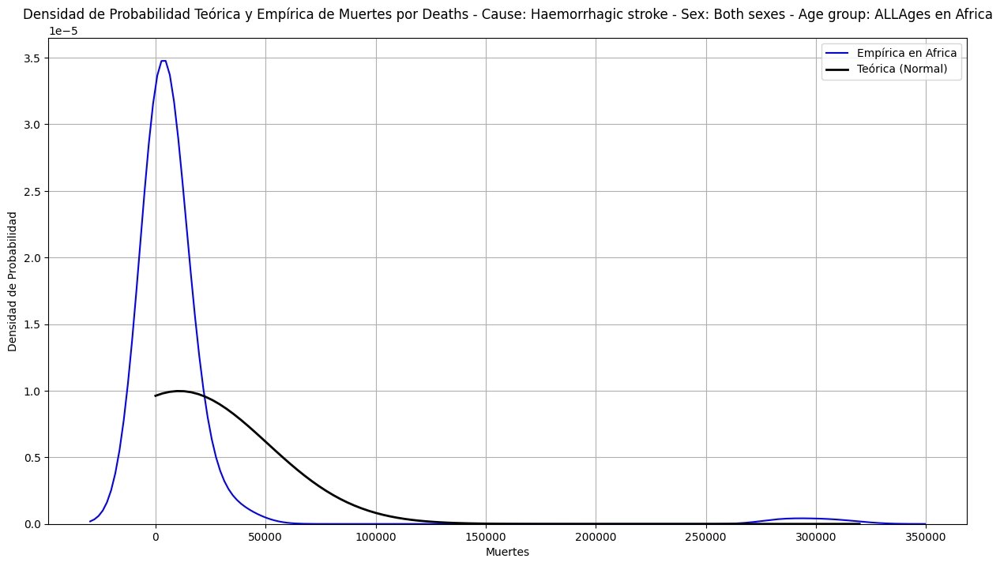

Continente: Africa
Patología: Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 10844.348324074075, Desviación Estándar: 39984.93196650453


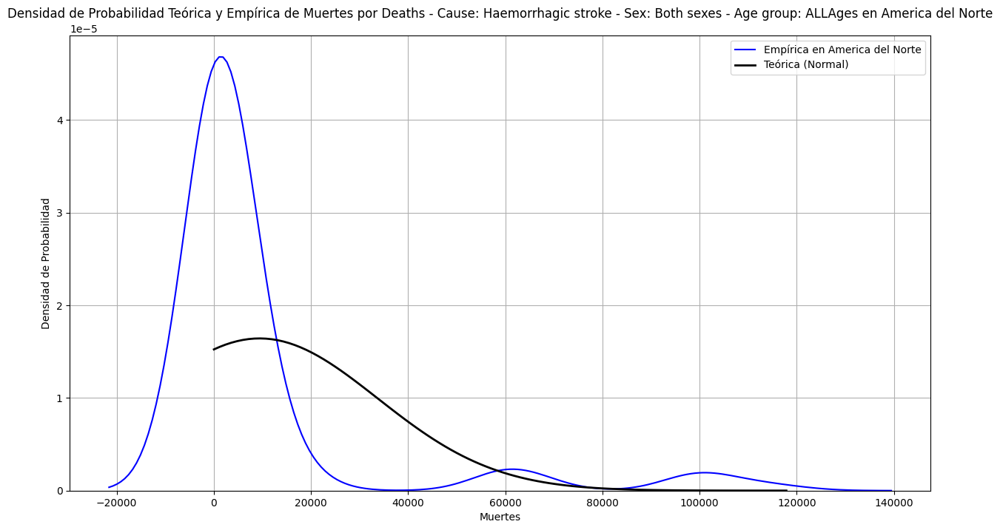

Continente: America del Norte
Patología: Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 9423.106956818181, Desviación Estándar: 24286.682012829126


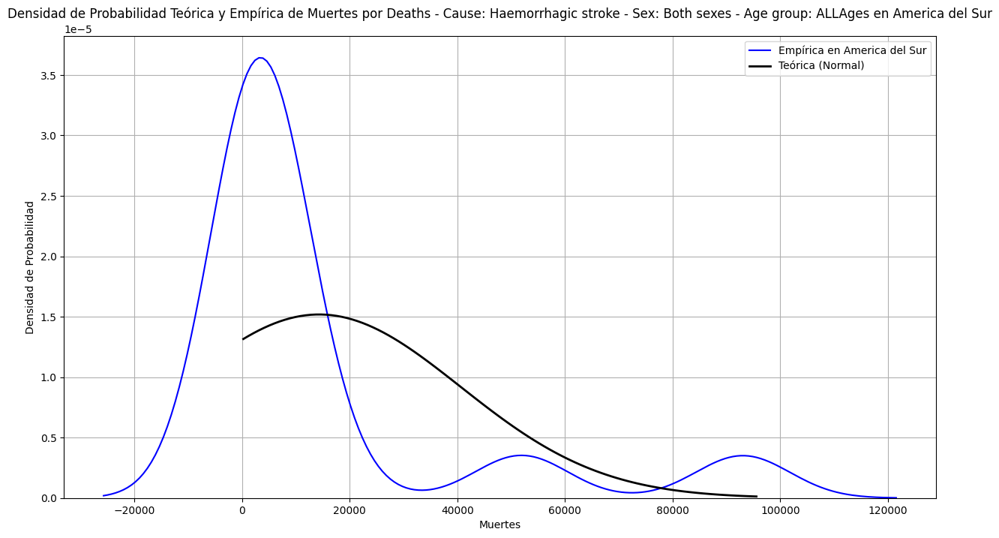

Continente: America del Sur
Patología: Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 14315.283415384616, Desviación Estándar: 26269.856215474847


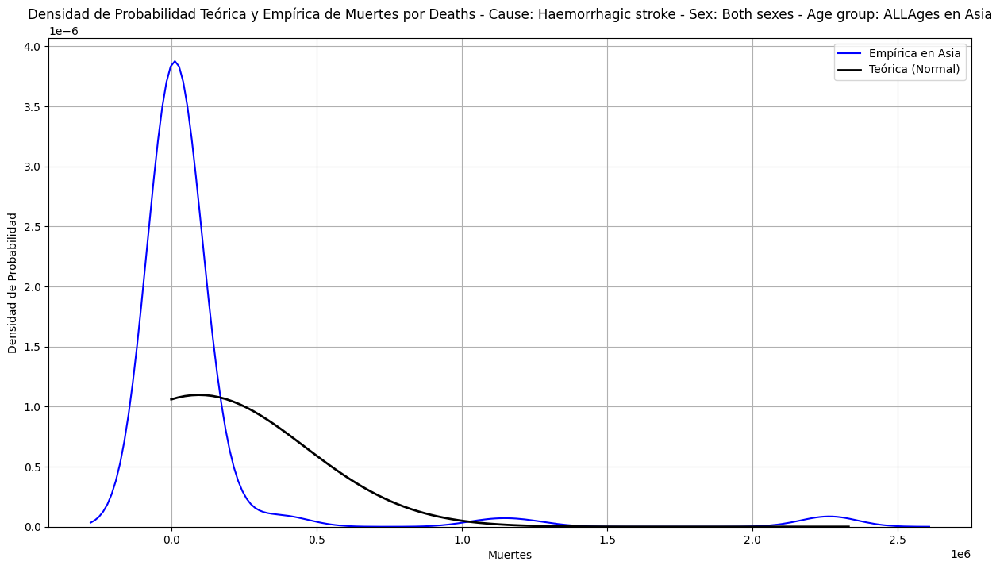

Continente: Asia
Patología: Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 95936.68921276595, Desviación Estándar: 363478.0651168609


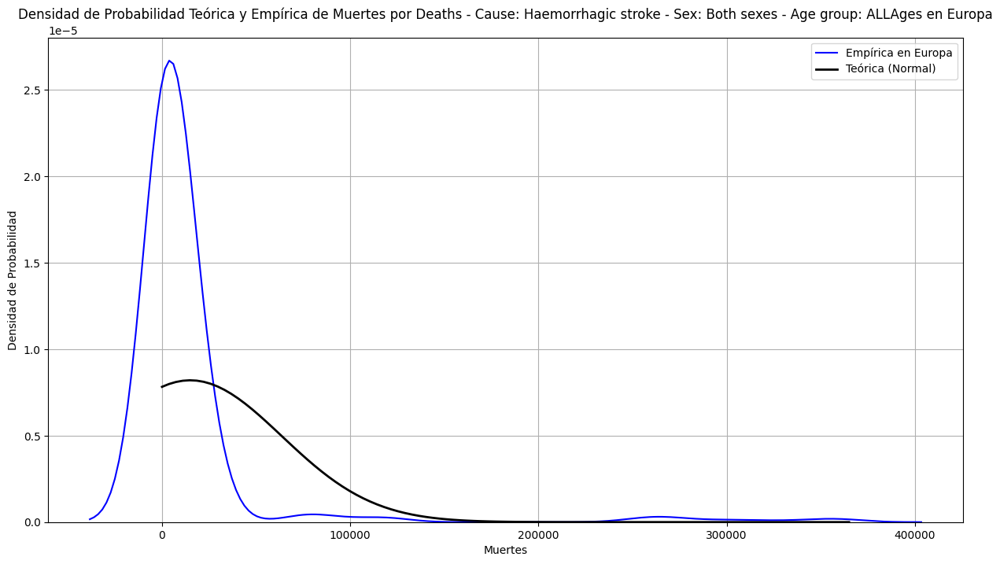

Continente: Europa
Patología: Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 15018.937725, Desviación Estándar: 48647.424241853354


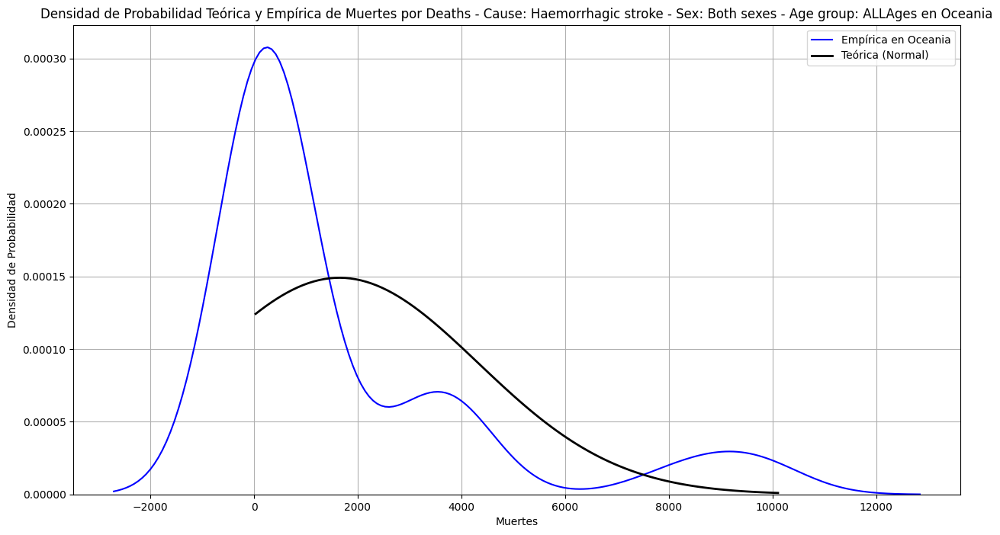

Continente: Oceania
Patología: Deaths - Cause: Haemorrhagic stroke - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 1646.7172745454543, Desviación Estándar: 2676.895770256292
------------------------------------------------------------------------------------------
Comparación de la función de distribución de la muestra y la teórica para Muertes por Enfermedad Cardíaca Isquémica:


<Figure size 1500x800 with 0 Axes>

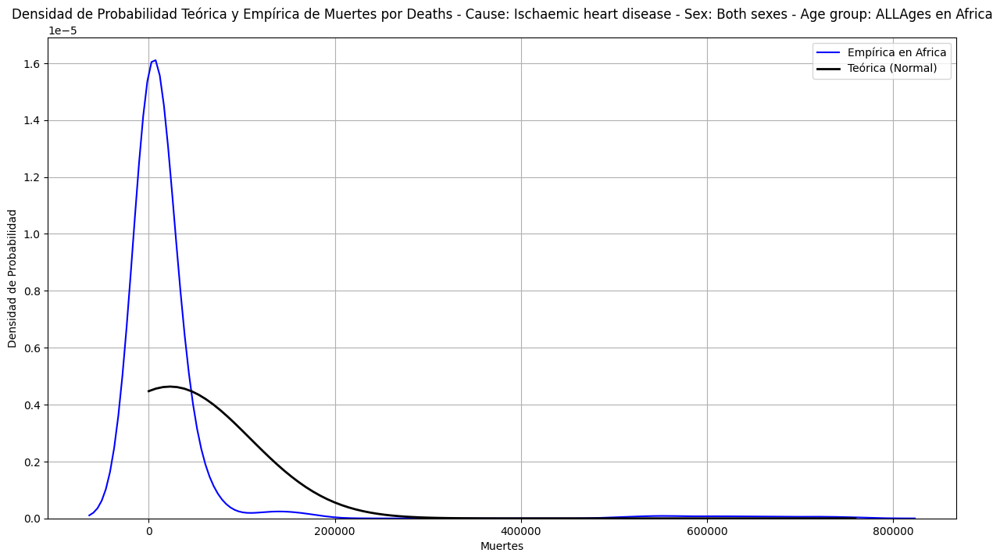

Continente: Africa
Patología: Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 22916.073101851853, Desviación Estándar: 86116.19476933702


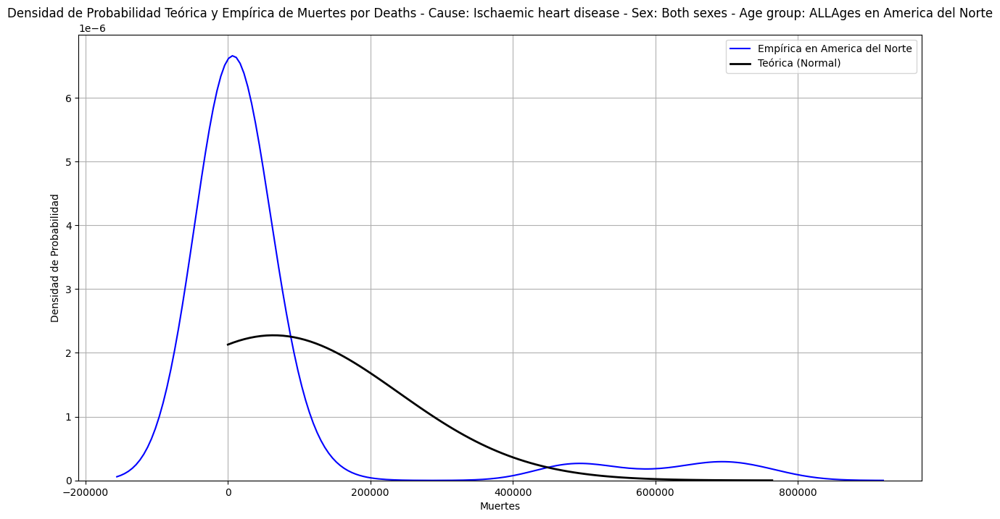

Continente: America del Norte
Patología: Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 63887.88268181818, Desviación Estándar: 175317.2289144048


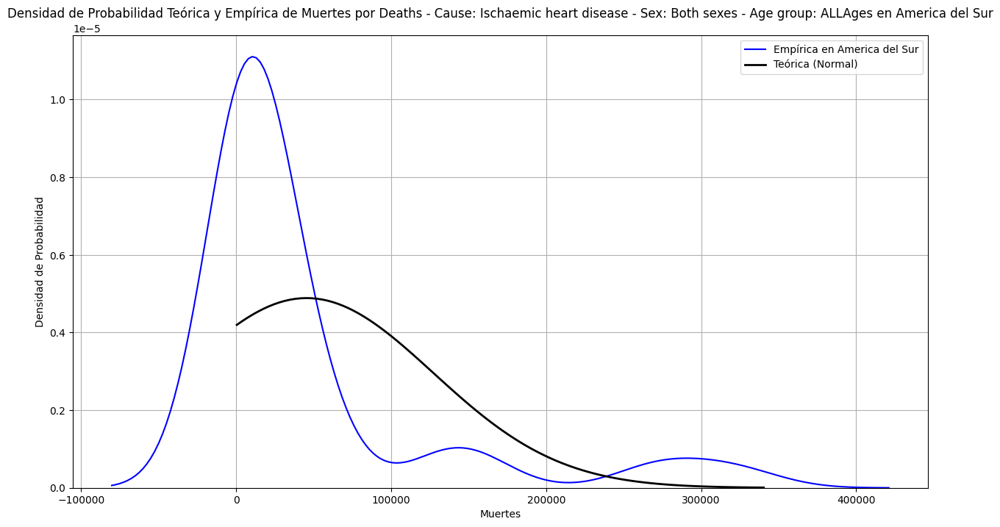

Continente: America del Sur
Patología: Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 45442.8591923077, Desviación Estándar: 81627.86271752833


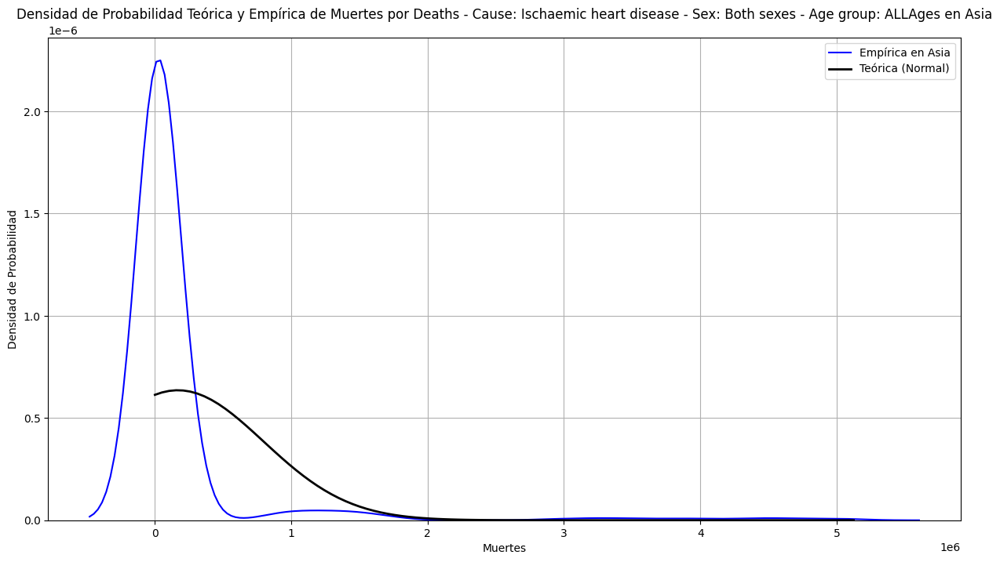

Continente: Asia
Patología: Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 168501.3214893617, Desviación Estándar: 627718.7373810454


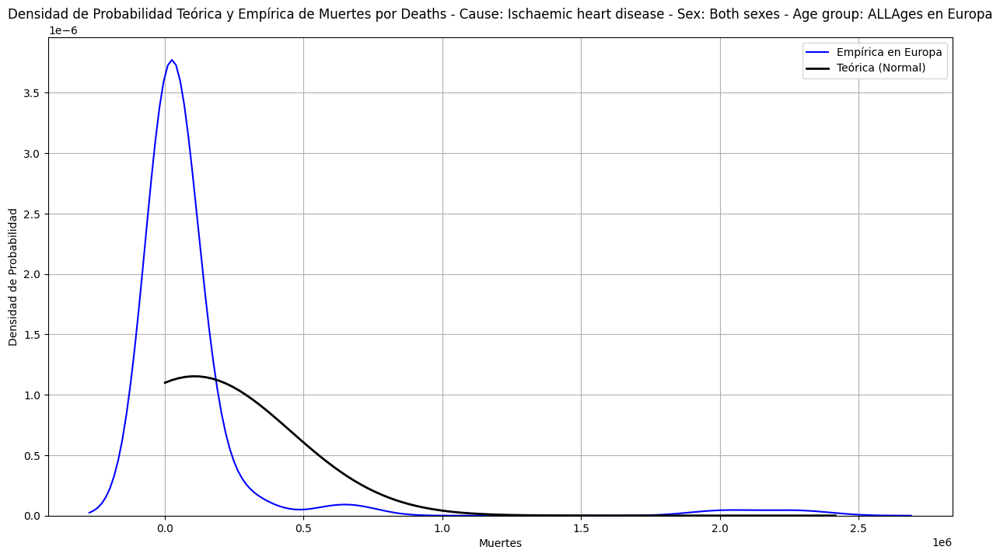

Continente: Europa
Patología: Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 107147.1270625, Desviación Estándar: 345900.6150029066


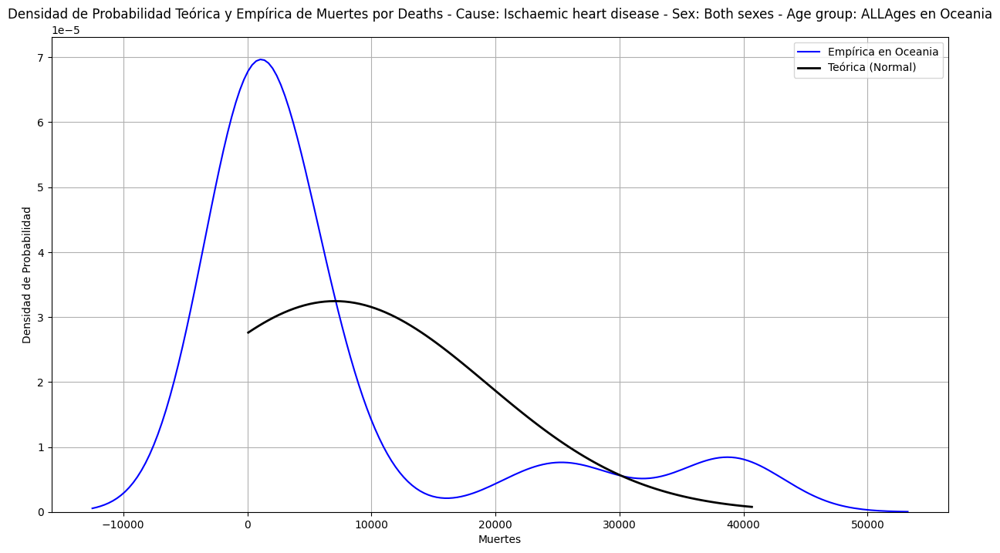

Continente: Oceania
Patología: Deaths - Cause: Ischaemic heart disease - Sex: Both sexes - Age group: ALLAges
Media y desviación estándar teóricas:
Media: 7065.691745454545, Desviación Estándar: 12293.066750028387
------------------------------------------------------------------------------------------


In [34]:
# Función para calcular la densidad de probabilidad teórica
def calcular_densidad_probabilidad_teorica(df, patologia):
    data_patologia = df[patologia].dropna()
    mu, std = stats.norm.fit(data_patologia)
    return mu, std

# Función para graficar la densidad de probabilidad teórica y empírica
def graficar_pdf_teorica_empirica(df, patologia, continente):
    data_patologia = df[patologia].dropna()
    mu, std = calcular_densidad_probabilidad_teorica(df, patologia)
    
    # Crear un rango de valores para x
    xmin, xmax = data_patologia.min(), data_patologia.max()
    x = np.linspace(xmin, xmax, 100)
    
    # Calcular la PDF teórica
    p = stats.norm.pdf(x, mu, std)
    
    # Graficar la PDF teórica y la empírica
    plt.figure(figsize=(15, 8))
    sns.kdeplot(data_patologia, label=f'Empírica en {continente}', color='blue')
    plt.plot(x, p, 'k', linewidth=2, label='Teórica (Normal)')
    plt.title(f'Densidad de Probabilidad Teórica y Empírica de Muertes por {patologia} en {continente}')
    plt.xlabel('Muertes')
    plt.ylabel('Densidad de Probabilidad')
    plt.legend()
    plt.grid(True)
    plt.show()

    # Calcular y mostrar los parámetros teóricos en la consola
    print(f"Continente: {continente}")
    print(f"Patología: {patologia}")
    print(f"Media y desviación estándar teóricas:\nMedia: {mu}, Desviación Estándar: {std}")
    print("=" * 90)

# Iterar sobre cada patología
for patologia in patologias:
    plt.figure(figsize=(15, 8))  # Crear una nueva figura para cada patología
    patologia_legible = reemplazar_texto(patologia)
    print(f"Comparación de la función de distribución de la muestra y la teórica para {patologia_legible}:")

    # Iterar sobre cada continente y sus respectivos países
    for continente, paises in continentes.items():
        df_continente = df[df['Entity'].isin(paises)]  # Filtrar el DataFrame por los países del continente actual

        # Graficar la densidad teórica y empírica para la patología y continente actuales
        graficar_pdf_teorica_empirica(df_continente, patologia, continente)

    print("-" * 90)

# Determinaciones

## Primeros tres momentos

Momentos para las muertes por enfermedades cardiovasculares en Africa
Para Muertes por Enfermedad Cardíaca Reumática:
Media: 695.2907416666666
Varianza: 6522368.194228765
Sesgo: 6.812073813175804
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Media: 1334.9662305555557
Varianza: 24485358.245375372
Sesgo: 6.801526284441501
Para Muertes por Enfermedades Circulatorias:
Media: 2629.5956462962963
Varianza: 95158670.31498903
Sesgo: 6.881096546397012
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Media: 5296.967296296296
Varianza: 381174785.8015882
Sesgo: 6.838792597838829
Para Muertes por Ictus Isquémico:
Media: 6525.879962962963
Varianza: 589312673.0046391
Sesgo: 6.941764356025917
Para Muertes por Ictus Hemorrágico:
Media: 10844.348324074075
Varianza: 1598794784.3659961
Sesgo: 6.8183403647643726
Para Muertes por Enfermedad Cardíaca Isquémica:
Media: 22916.073101851853
Varianza: 7415999001.550389
Sesgo: 6.6298986496515155


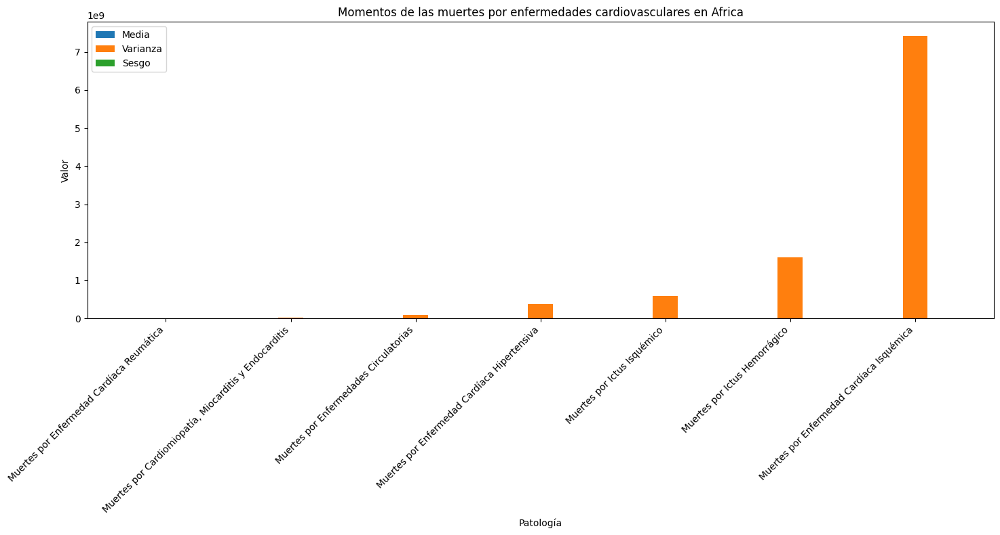

Momentos para las muertes por enfermedades cardiovasculares en America del Norte
Para Muertes por Enfermedad Cardíaca Reumática:
Media: 567.6289115909091
Varianza: 2064524.0128921298
Sesgo: 3.1279254301590766
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Media: 3528.6015749999992
Varianza: 104853962.83120452
Sesgo: 2.883780842503068
Para Muertes por Enfermedades Circulatorias:
Media: 10489.266377272728
Varianza: 880600439.9547551
Sesgo: 2.97627948918127
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Media: 6588.228811363637
Varianza: 329659290.0564914
Sesgo: 3.2328371708536228
Para Muertes por Ictus Isquémico:
Media: 12268.663827272727
Varianza: 1053319093.3649766
Sesgo: 3.055429484632576
Para Muertes por Ictus Hemorrágico:
Media: 9423.106956818181
Varianza: 589842923.1922778
Sesgo: 3.116313004930891
Para Muertes por Enfermedad Cardíaca Isquémica:
Media: 63887.88268181818
Varianza: 30736130754.22582
Sesgo: 2.955653017236642


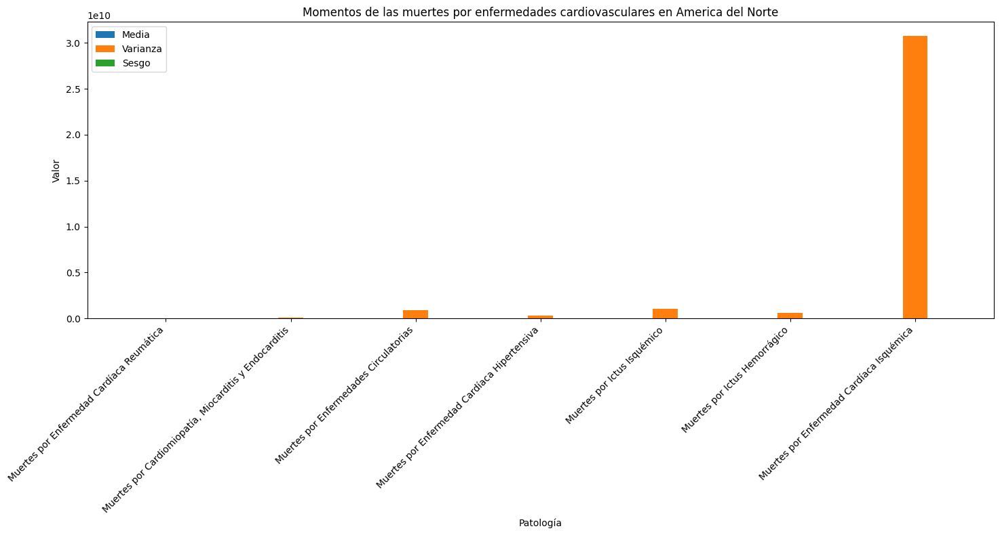

Momentos para las muertes por enfermedades cardiovasculares en America del Sur
Para Muertes por Enfermedad Cardíaca Reumática:
Media: 557.4066938461539
Varianza: 1111640.2245778553
Sesgo: 2.1861464938498303
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Media: 3993.1508153846157
Varianza: 61706762.84740695
Sesgo: 2.0317228133038063
Para Muertes por Enfermedades Circulatorias:
Media: 9494.685046153845
Varianza: 322023039.0552223
Sesgo: 2.3105249550119957
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Media: 6899.7429
Varianza: 160657676.13071093
Sesgo: 2.4508933957603642
Para Muertes por Ictus Isquémico:
Media: 15947.590834615386
Varianza: 916466237.8419727
Sesgo: 2.1746053340883953
Para Muertes por Ictus Hemorrágico:
Media: 14315.283415384616
Varianza: 690105345.5817225
Sesgo: 2.228766358649378
Para Muertes por Enfermedad Cardíaca Isquémica:
Media: 45442.8591923077
Varianza: 6663107971.831652
Sesgo: 2.3490705514632153


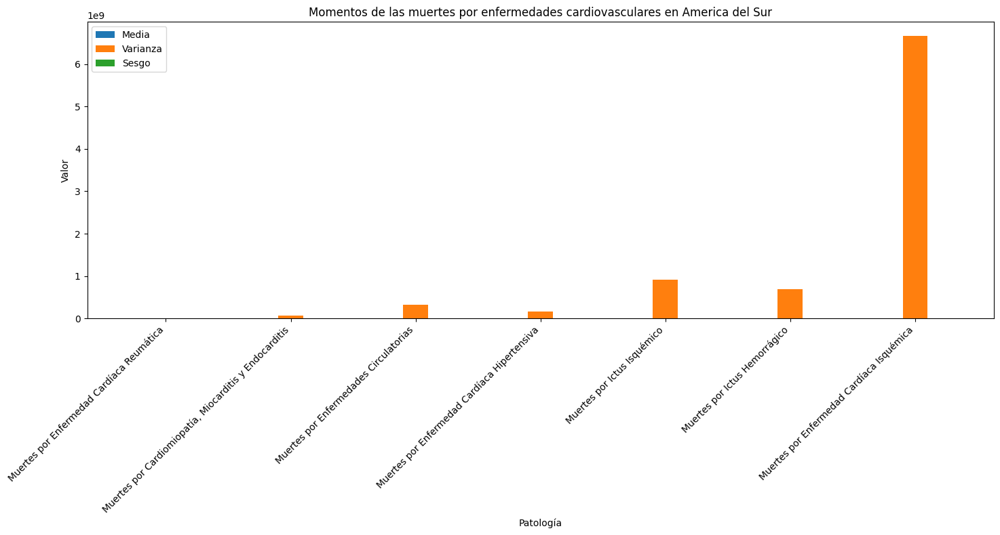

Momentos para las muertes por enfermedades cardiovasculares en Asia
Para Muertes por Enfermedad Cardíaca Reumática:
Media: 10926.722861702128
Varianza: 1778209412.5185895
Sesgo: 4.773089587314836
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Media: 3559.5303989361705
Varianza: 162170068.4794886
Sesgo: 5.7771730689452685
Para Muertes por Enfermedades Circulatorias:
Media: 11967.89370212766
Varianza: 1933654351.5466864
Sesgo: 5.75228599744891
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Media: 21147.484595744678
Varianza: 6446459013.343166
Sesgo: 5.483265169494541
Para Muertes por Ictus Isquémico:
Media: 64640.36261702128
Varianza: 60128345252.30783
Sesgo: 5.289504916329435
Para Muertes por Ictus Hemorrágico:
Media: 95936.68921276595
Varianza: 132116303821.09695
Sesgo: 5.02451469519539
Para Muertes por Enfermedad Cardíaca Isquémica:
Media: 168501.3214893617
Varianza: 394030813259.25385
Sesgo: 5.52710869355686


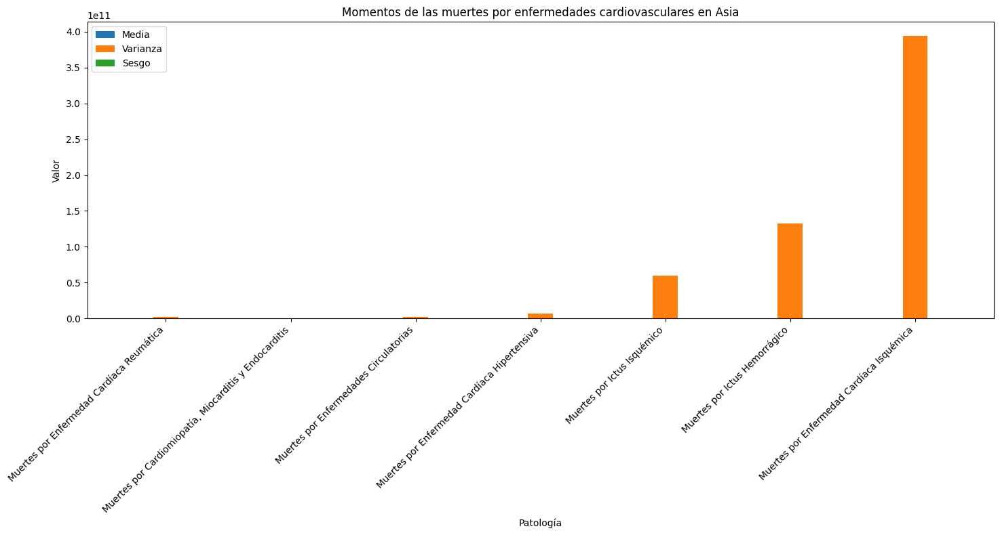

Momentos para las muertes por enfermedades cardiovasculares en Europa
Para Muertes por Enfermedad Cardíaca Reumática:
Media: 1031.65173
Varianza: 11135130.07293941
Sesgo: 5.4770023968595565
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Media: 7720.51135
Varianza: 682944758.292572
Sesgo: 4.889682828310057
Para Muertes por Enfermedades Circulatorias:
Media: 14744.563287500001
Varianza: 2149124468.575478
Sesgo: 5.583149121221579
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Media: 6901.512475
Varianza: 496276388.54829186
Sesgo: 5.683342450912456
Para Muertes por Ictus Isquémico:
Media: 39087.7288875
Varianza: 16786615692.924034
Sesgo: 5.162651130021468
Para Muertes por Ictus Hemorrágico:
Media: 15018.937725
Varianza: 2366571885.3668613
Sesgo: 5.465142507149118
Para Muertes por Enfermedad Cardíaca Isquémica:
Media: 107147.1270625
Varianza: 119647235459.389
Sesgo: 5.281670460411995


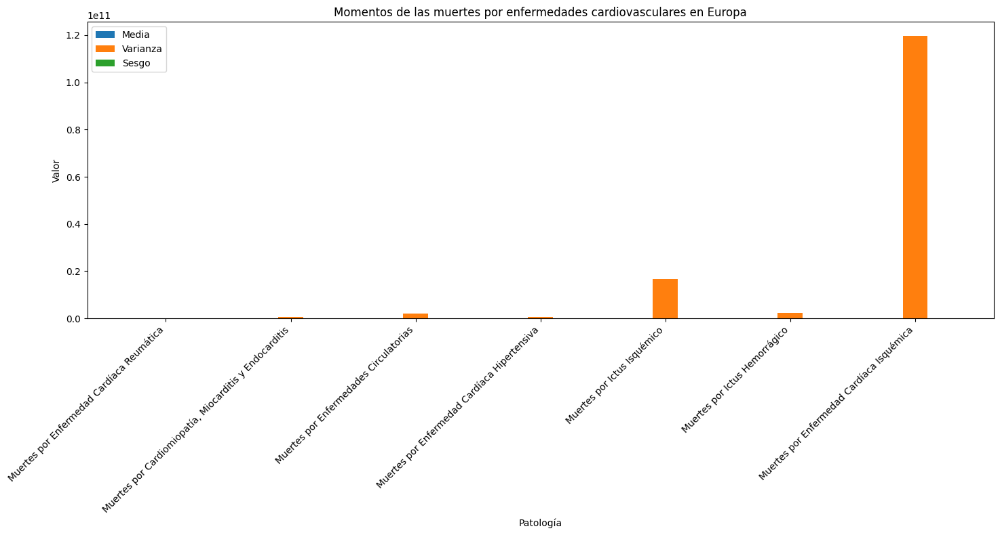

Momentos para las muertes por enfermedades cardiovasculares en Oceania
Para Muertes por Enfermedad Cardíaca Reumática:
Media: 271.8251813636364
Varianza: 212252.34626702653
Sesgo: 1.9629731492482232
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Media: 327.3867259090909
Varianza: 362969.82386164414
Sesgo: 1.8584947988140659
Para Muertes por Enfermedades Circulatorias:
Media: 1397.2931809090908
Varianza: 6802201.422383125
Sesgo: 1.762019439384836
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Media: 496.46036181818187
Varianza: 700554.2611185604
Sesgo: 2.075243996511416
Para Muertes por Ictus Isquémico:
Media: 1905.1367363636361
Varianza: 12085808.81548572
Sesgo: 1.7002176614464826
Para Muertes por Ictus Hemorrágico:
Media: 1646.7172745454543
Varianza: 7165770.964816027
Sesgo: 1.9502770472878916
Para Muertes por Enfermedad Cardíaca Isquémica:
Media: 7065.691745454545
Varianza: 151119490.1206535
Sesgo: 1.778673740075485


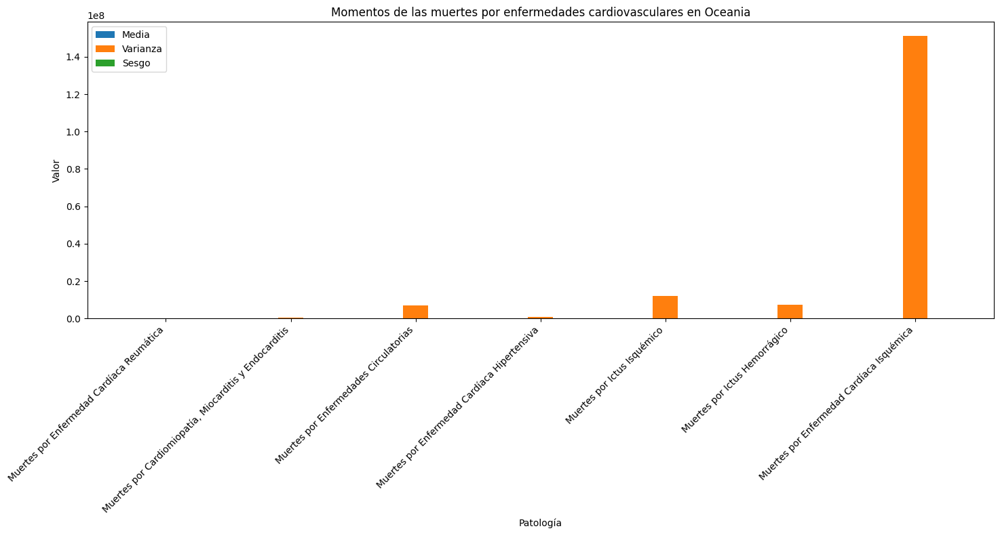

In [35]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import skew

# Función para calcular los momentos
def calcular_momentos(df, patologia):
    data_patologia = df[patologia].dropna()
    media = np.mean(data_patologia)
    varianza = np.var(data_patologia)
    sesgo = skew(data_patologia)
    return media, varianza, sesgo

# Bucle para calcular y graficar los momentos por continente y patología
for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]
    print(f"Momentos para las muertes por enfermedades cardiovasculares en {continente}")
    
    momentos_continente = {}

    for patologia in patologias:
        media, varianza, sesgo = calcular_momentos(df_continente, patologia)
        patologia_legible = reemplazar_texto(patologia)
        momentos_continente[patologia_legible] = {'media': media, 'varianza': varianza, 'sesgo': sesgo}
        
        print(f"Para {patologia_legible}:")
        print(f"Media: {media}")
        print(f"Varianza: {varianza}")
        print(f"Sesgo: {sesgo}")
        print("="*90)
        
    # Graficar los momentos para el continente actual
    patologias_legibles = list(momentos_continente.keys())
    medias = [momentos_continente[p]['media'] for p in patologias_legibles]
    varianzas = [momentos_continente[p]['varianza'] for p in patologias_legibles]
    sesgos = [momentos_continente[p]['sesgo'] for p in patologias_legibles]
    
    x = np.arange(len(patologias_legibles))
    width = 0.2
    
    fig, ax = plt.subplots(figsize=(15, 8))
    
    bar1 = ax.bar(x - width, medias, width, label='Media')
    bar2 = ax.bar(x, varianzas, width, label='Varianza')
    bar3 = ax.bar(x + width, sesgos, width, label='Sesgo')
    
    ax.set_xlabel('Patología')
    ax.set_ylabel('Valor')
    ax.set_title(f'Momentos de las muertes por enfermedades cardiovasculares en {continente}')
    ax.set_xticks(x)
    ax.set_xticklabels(patologias_legibles, rotation=45, ha="right")
    ax.legend()
    
    plt.tight_layout()
    plt.show()


## coeficiente de variación

Coeficiente de Variación para las muertes por enfermedades cardiovasculares en Africa
Para Muertes por Enfermedad Cardíaca Reumática:
Coeficiente de Variación (CV): 3.6731292393696875
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Coeficiente de Variación (CV): 3.706661706816667
Para Muertes por Enfermedades Circulatorias:
Coeficiente de Variación (CV): 3.709669423157929
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Coeficiente de Variación (CV): 3.6858256742790334
Para Muertes por Ictus Isquémico:
Coeficiente de Variación (CV): 3.719921790697227
Para Muertes por Ictus Hemorrágico:
Coeficiente de Variación (CV): 3.6871678012905007
Para Muertes por Enfermedad Cardíaca Isquémica:
Coeficiente de Variación (CV): 3.757894923209071


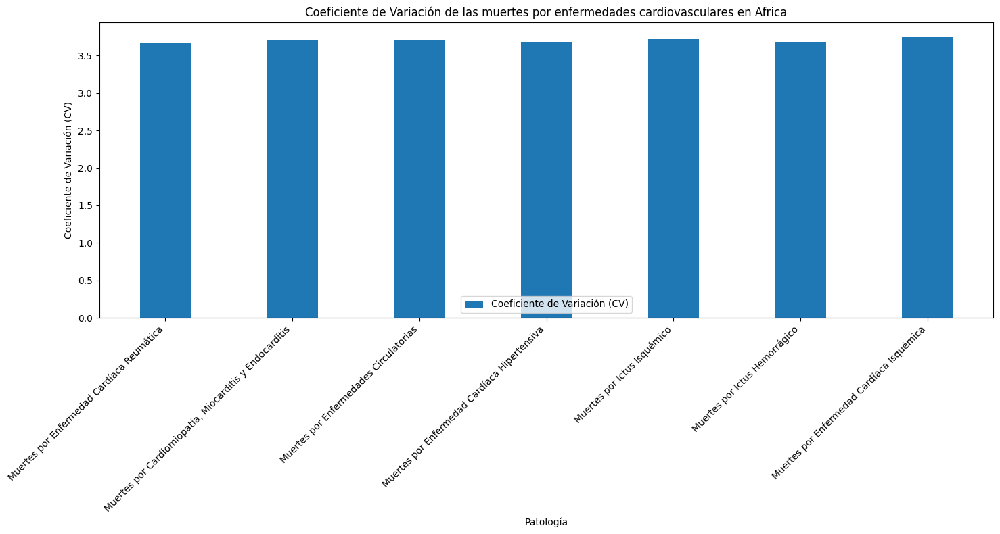

Coeficiente de Variación para las muertes por enfermedades cardiovasculares en America del Norte
Para Muertes por Enfermedad Cardíaca Reumática:
Coeficiente de Variación (CV): 2.531310739003096
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Coeficiente de Variación (CV): 2.9019491673064066
Para Muertes por Enfermedades Circulatorias:
Coeficiente de Variación (CV): 2.8290741762747054
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Coeficiente de Variación (CV): 2.755903367979834
Para Muertes por Ictus Isquémico:
Coeficiente de Variación (CV): 2.6453473876493176
Para Muertes por Ictus Hemorrágico:
Coeficiente de Variación (CV): 2.577353958107868
Para Muertes por Enfermedad Cardíaca Isquémica:
Coeficiente de Variación (CV): 2.7441389752660914


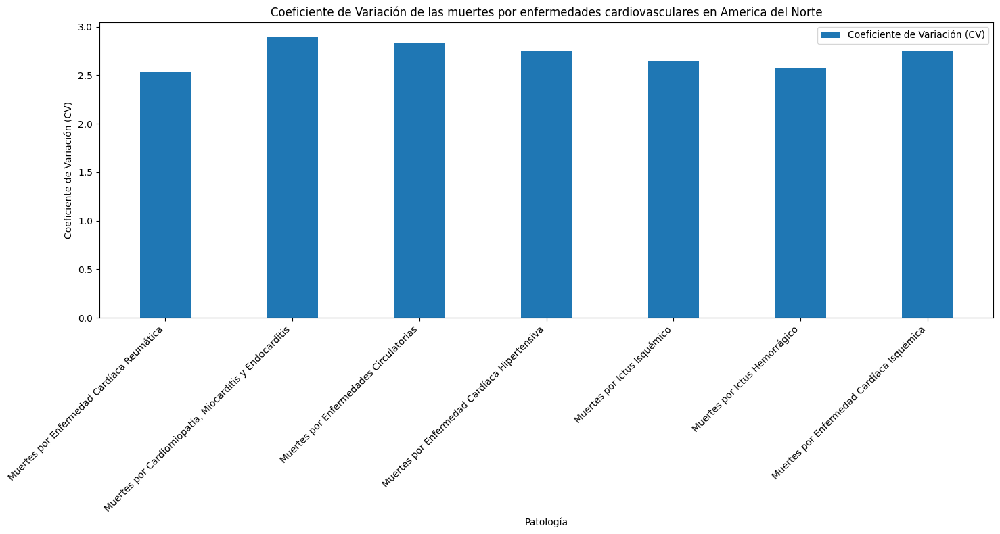

Coeficiente de Variación para las muertes por enfermedades cardiovasculares en America del Sur
Para Muertes por Enfermedad Cardíaca Reumática:
Coeficiente de Variación (CV): 1.8915156845291548
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Coeficiente de Variación (CV): 1.9672097524085848
Para Muertes por Enfermedades Circulatorias:
Coeficiente de Variación (CV): 1.890004808415283
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Coeficiente de Variación (CV): 1.837036697729103
Para Muertes por Ictus Isquémico:
Coeficiente de Variación (CV): 1.898292582301007
Para Muertes por Ictus Hemorrágico:
Coeficiente de Variación (CV): 1.8350915907988707
Para Muertes por Enfermedad Cardíaca Isquémica:
Coeficiente de Variación (CV): 1.7962747980291218


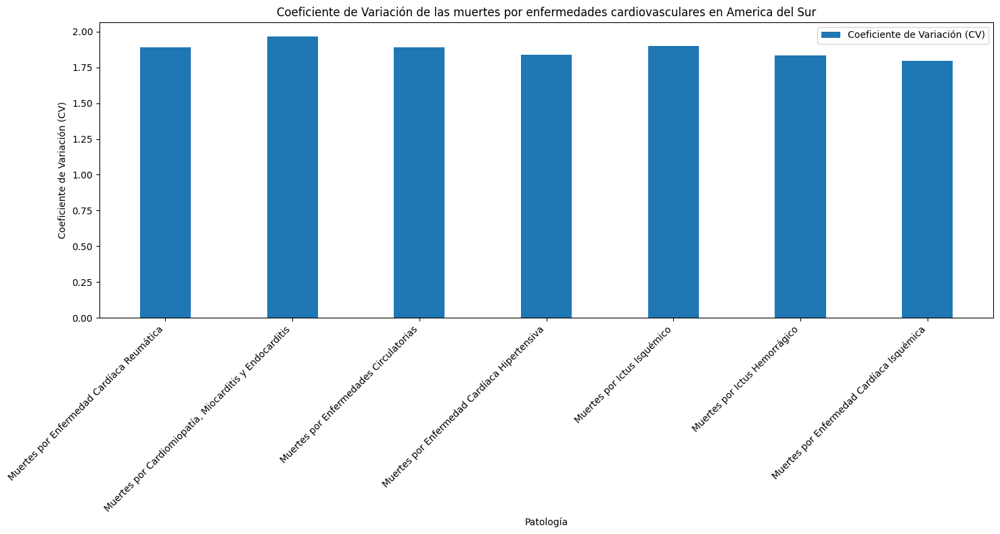

Coeficiente de Variación para las muertes por enfermedades cardiovasculares en Asia
Para Muertes por Enfermedad Cardíaca Reumática:
Coeficiente de Variación (CV): 3.859237661375627
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Coeficiente de Variación (CV): 3.5776071005058503
Para Muertes por Enfermedades Circulatorias:
Coeficiente de Variación (CV): 3.674275350342567
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Coeficiente de Variación (CV): 3.7966616507532764
Para Muertes por Ictus Isquémico:
Coeficiente de Variación (CV): 3.793462908438607
Para Muertes por Ictus Hemorrágico:
Coeficiente de Variación (CV): 3.7887284635260707
Para Muertes por Enfermedad Cardíaca Isquémica:
Coeficiente de Variación (CV): 3.7253045366808966


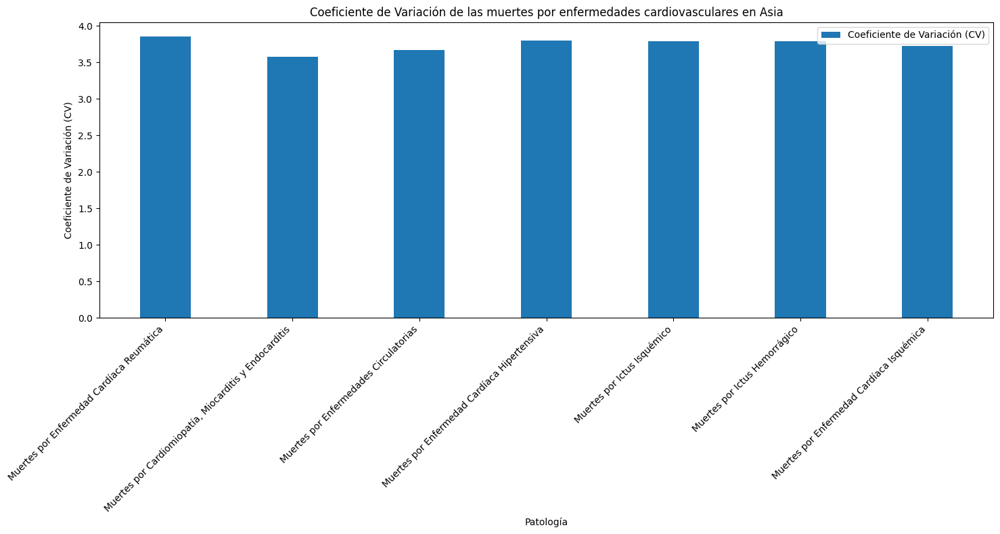

Coeficiente de Variación para las muertes por enfermedades cardiovasculares en Europa
Para Muertes por Enfermedad Cardíaca Reumática:
Coeficiente de Variación (CV): 3.234554971992544
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Coeficiente de Variación (CV): 3.384906854230272
Para Muertes por Enfermedades Circulatorias:
Coeficiente de Variación (CV): 3.1441182430456043
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Coeficiente de Variación (CV): 3.227881101993067
Para Muertes por Ictus Isquémico:
Coeficiente de Variación (CV): 3.3146764031254983
Para Muertes por Ictus Hemorrágico:
Coeficiente de Variación (CV): 3.239072238835943
Para Muertes por Enfermedad Cardíaca Isquémica:
Coeficiente de Variación (CV): 3.228277084845581


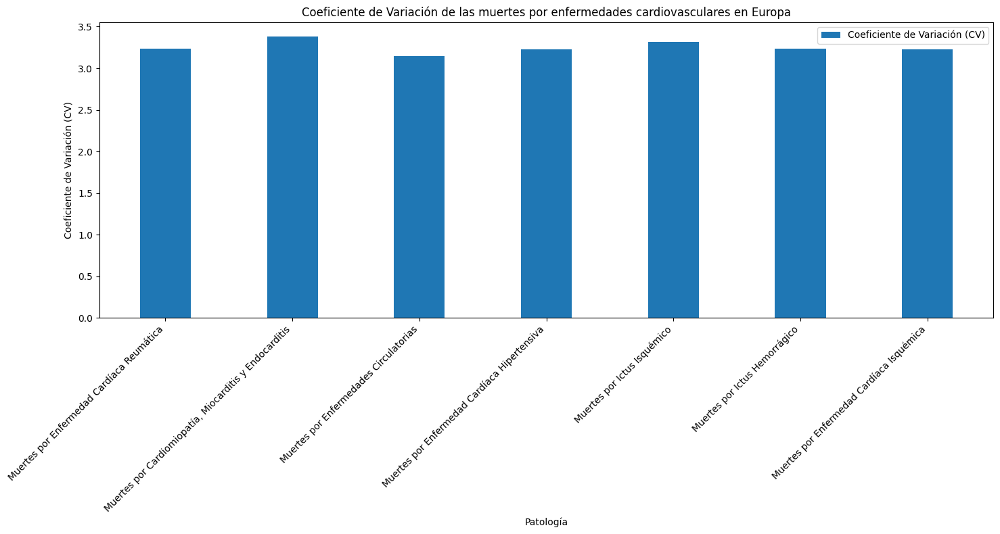

Coeficiente de Variación para las muertes por enfermedades cardiovasculares en Oceania
Para Muertes por Enfermedad Cardíaca Reumática:
Coeficiente de Variación (CV): 1.6948706667114768
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Coeficiente de Variación (CV): 1.8402388441627076
Para Muertes por Enfermedades Circulatorias:
Coeficiente de Variación (CV): 1.866539583124795
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Coeficiente de Variación (CV): 1.6859174664009684
Para Muertes por Ictus Isquémico:
Coeficiente de Variación (CV): 1.8247850256792146
Para Muertes por Ictus Hemorrágico:
Coeficiente de Variación (CV): 1.6255952443294792
Para Muertes por Enfermedad Cardíaca Isquémica:
Coeficiente de Variación (CV): 1.7398249446611769


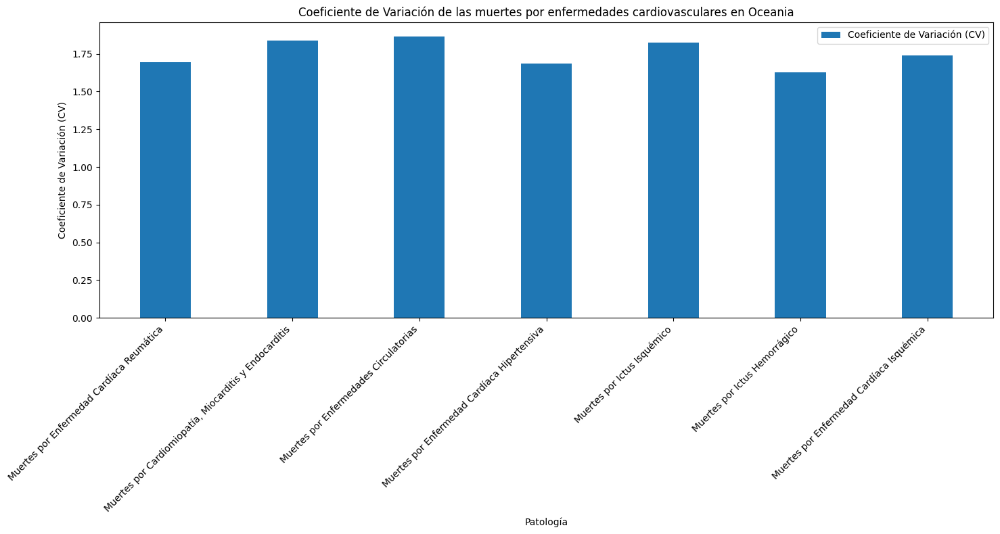

In [36]:
import numpy as np
import matplotlib.pyplot as plt

# Función para calcular el coeficiente de variación
def calcular_coeficiente_variacion(df, patologia):
    data_patologia = df[patologia].dropna()
    media = np.mean(data_patologia)
    desviacion_estandar = np.std(data_patologia)
    cv = desviacion_estandar / media
    return cv

# Bucle para calcular y graficar el coeficiente de variación por continente y patología
for continente, paises in continentes.items():
    df_continente = df[df['Entity'].isin(paises)]
    print(f"Coeficiente de Variación para las muertes por enfermedades cardiovasculares en {continente}")
    
    cvs_continente = {}

    for patologia in patologias:
        cv = calcular_coeficiente_variacion(df_continente, patologia)
        patologia_legible = reemplazar_texto(patologia)
        cvs_continente[patologia_legible] = cv
        
        print(f"Para {patologia_legible}:")
        print(f"Coeficiente de Variación (CV): {cv}")
        print("="*90)
        
    # Graficar el coeficiente de variación para el continente actual
    patologias_legibles = list(cvs_continente.keys())
    cvs = [cvs_continente[p] for p in patologias_legibles]
    
    x = np.arange(len(patologias_legibles))
    width = 0.4
    
    fig, ax = plt.subplots(figsize=(15, 8))
    
    bar = ax.bar(x, cvs, width, label='Coeficiente de Variación (CV)')
    
    ax.set_xlabel('Patología')
    ax.set_ylabel('Coeficiente de Variación (CV)')
    ax.set_title(f'Coeficiente de Variación de las muertes por enfermedades cardiovasculares en {continente}')
    ax.set_xticks(x)
    ax.set_xticklabels(patologias_legibles, rotation=45, ha="right")
    ax.legend()
    
    plt.tight_layout()
    plt.show()


## Sesgo

Sesgo para las muertes por enfermedades cardiovasculares en Africa
Para Muertes por Enfermedad Cardíaca Reumática:
Sesgo: 6.812073813175804
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Sesgo: 6.801526284441501
Para Muertes por Enfermedades Circulatorias:
Sesgo: 6.881096546397012
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Sesgo: 6.838792597838829
Para Muertes por Ictus Isquémico:
Sesgo: 6.941764356025917
Para Muertes por Ictus Hemorrágico:
Sesgo: 6.8183403647643726
Para Muertes por Enfermedad Cardíaca Isquémica:
Sesgo: 6.6298986496515155


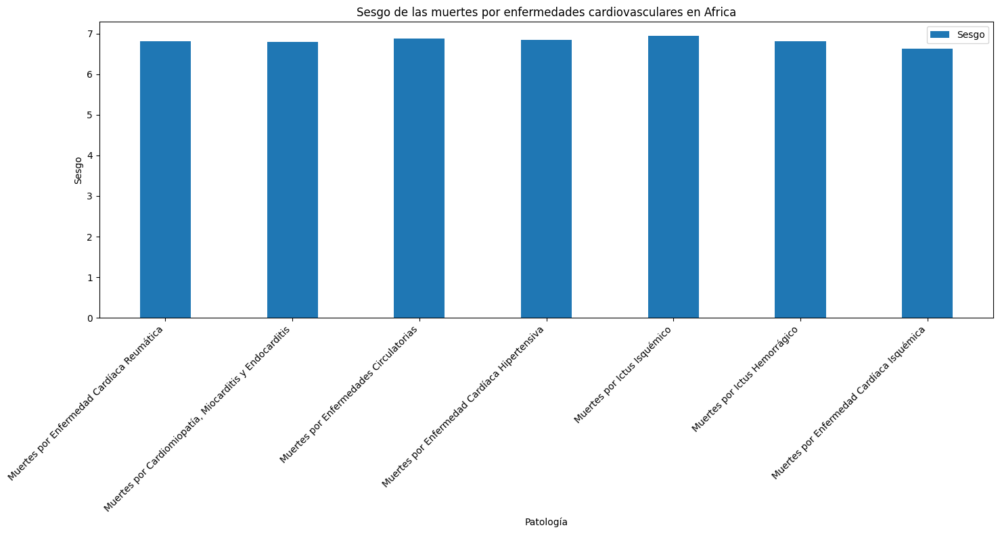

Sesgo para las muertes por enfermedades cardiovasculares en America del Norte
Para Muertes por Enfermedad Cardíaca Reumática:
Sesgo: 3.1279254301590766
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Sesgo: 2.883780842503068
Para Muertes por Enfermedades Circulatorias:
Sesgo: 2.97627948918127
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Sesgo: 3.2328371708536228
Para Muertes por Ictus Isquémico:
Sesgo: 3.055429484632576
Para Muertes por Ictus Hemorrágico:
Sesgo: 3.116313004930891
Para Muertes por Enfermedad Cardíaca Isquémica:
Sesgo: 2.955653017236642


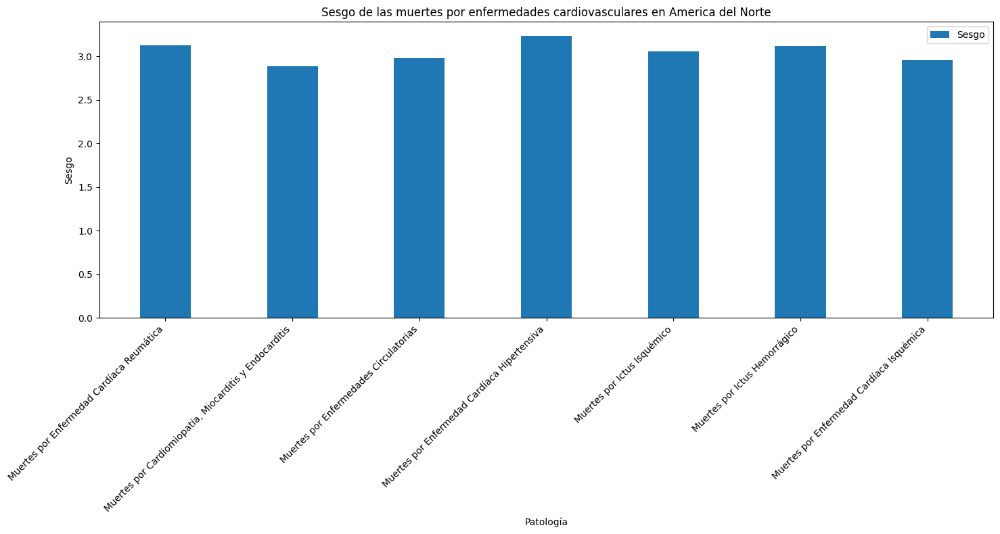

Sesgo para las muertes por enfermedades cardiovasculares en America del Sur
Para Muertes por Enfermedad Cardíaca Reumática:
Sesgo: 2.1861464938498303
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Sesgo: 2.0317228133038063
Para Muertes por Enfermedades Circulatorias:
Sesgo: 2.3105249550119957
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Sesgo: 2.4508933957603642
Para Muertes por Ictus Isquémico:
Sesgo: 2.1746053340883953
Para Muertes por Ictus Hemorrágico:
Sesgo: 2.228766358649378
Para Muertes por Enfermedad Cardíaca Isquémica:
Sesgo: 2.3490705514632153


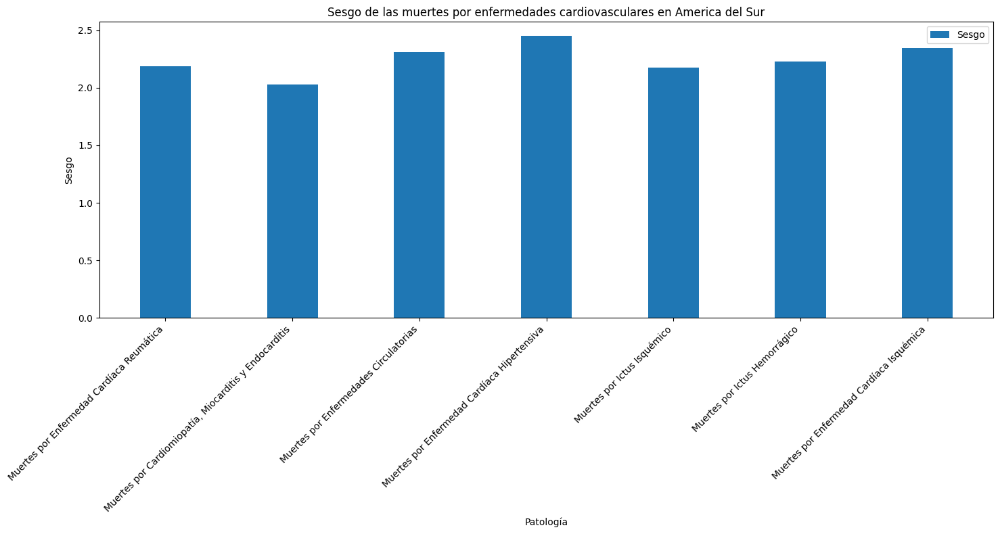

Sesgo para las muertes por enfermedades cardiovasculares en Asia
Para Muertes por Enfermedad Cardíaca Reumática:
Sesgo: 4.773089587314836
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Sesgo: 5.7771730689452685
Para Muertes por Enfermedades Circulatorias:
Sesgo: 5.75228599744891
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Sesgo: 5.483265169494541
Para Muertes por Ictus Isquémico:
Sesgo: 5.289504916329435
Para Muertes por Ictus Hemorrágico:
Sesgo: 5.02451469519539
Para Muertes por Enfermedad Cardíaca Isquémica:
Sesgo: 5.52710869355686


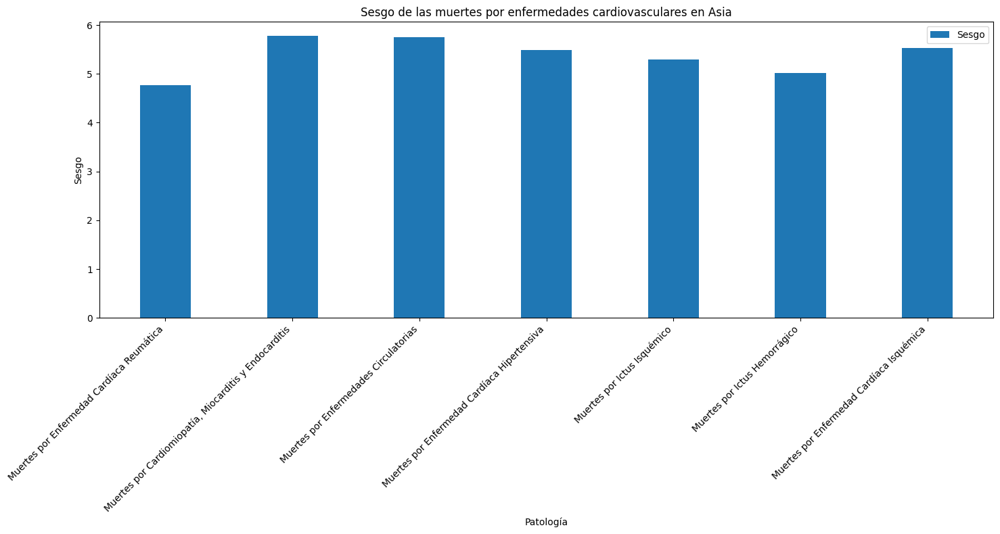

Sesgo para las muertes por enfermedades cardiovasculares en Europa
Para Muertes por Enfermedad Cardíaca Reumática:
Sesgo: 5.4770023968595565
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Sesgo: 4.889682828310057
Para Muertes por Enfermedades Circulatorias:
Sesgo: 5.583149121221579
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Sesgo: 5.683342450912456
Para Muertes por Ictus Isquémico:
Sesgo: 5.162651130021468
Para Muertes por Ictus Hemorrágico:
Sesgo: 5.465142507149118
Para Muertes por Enfermedad Cardíaca Isquémica:
Sesgo: 5.281670460411995


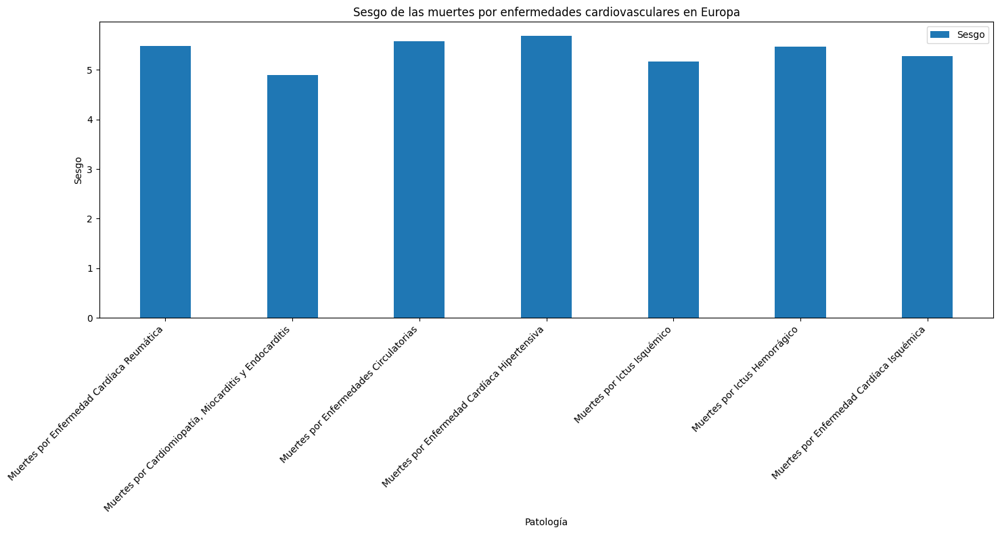

Sesgo para las muertes por enfermedades cardiovasculares en Oceania
Para Muertes por Enfermedad Cardíaca Reumática:
Sesgo: 1.9629731492482232
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Sesgo: 1.8584947988140659
Para Muertes por Enfermedades Circulatorias:
Sesgo: 1.762019439384836
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Sesgo: 2.075243996511416
Para Muertes por Ictus Isquémico:
Sesgo: 1.7002176614464826
Para Muertes por Ictus Hemorrágico:
Sesgo: 1.9502770472878916
Para Muertes por Enfermedad Cardíaca Isquémica:
Sesgo: 1.778673740075485


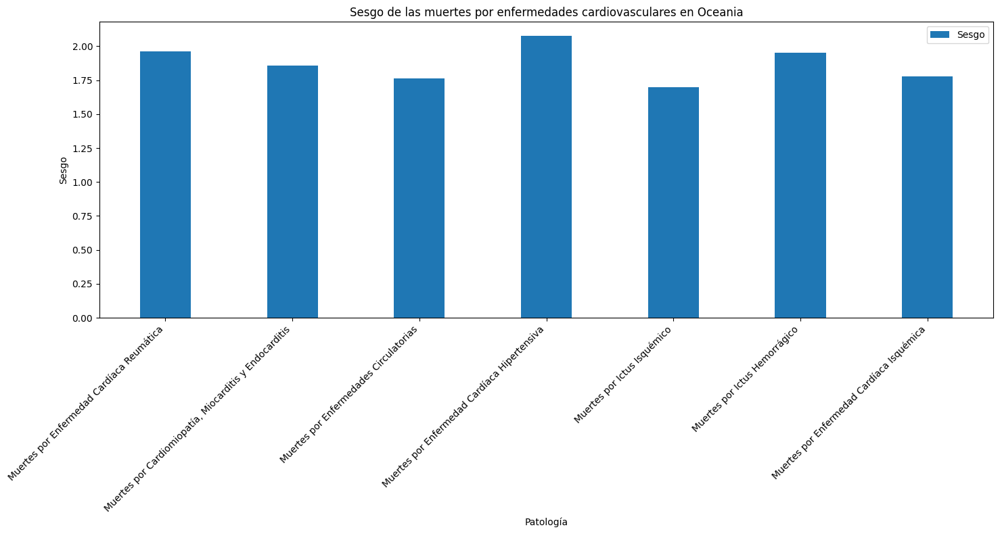

In [37]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import skew
import seaborn as sns

# Función para calcular el sesgo
def calcular_sesgo(df, patologia):
    data_patologia = df[patologia].dropna()
    sesgo = skew(data_patologia)
    return sesgo

# Bucle para calcular y graficar el sesgo por continente y patología
for continente, paises in continentes.items():
    # Filtrar el DataFrame por los países del continente actual
    df_continente = df[df['Entity'].isin(paises)]
    print(f"Sesgo para las muertes por enfermedades cardiovasculares en {continente}")
    
    sesgos_continente = {}

    for patologia in patologias:
        # Calcular el sesgo
        sesgo = calcular_sesgo(df_continente, patologia)
        patologia_legible = reemplazar_texto(patologia)
        
        # Almacenar el sesgo en el diccionario
        sesgos_continente[patologia_legible] = sesgo
        
        # Imprimir el sesgo para la patología actual
        print(f"Para {patologia_legible}:")
        print(f"Sesgo: {sesgo}")
        print("="*90)
        
    # Graficar el sesgo para el continente actual
    patologias_legibles = list(sesgos_continente.keys())
    sesgos = [sesgos_continente[p] for p in patologias_legibles]
    
    x = np.arange(len(patologias_legibles))
    width = 0.4
    
    fig, ax = plt.subplots(figsize=(15, 8))
    
    # Crear un gráfico de barras del sesgo
    bar = ax.bar(x, sesgos, width, label='Sesgo')
    
    # Configurar las etiquetas y el título del gráfico
    ax.set_xlabel('Patología')
    ax.set_ylabel('Sesgo')
    ax.set_title(f'Sesgo de las muertes por enfermedades cardiovasculares en {continente}')
    ax.set_xticks(x)
    ax.set_xticklabels(patologias_legibles, rotation=45, ha="right")
    ax.legend()
    
    # Ajustar el diseño del gráfico
    plt.tight_layout()
    plt.show()


## Kurtosis

Curtosis para las muertes por enfermedades cardiovasculares en Africa
Para Muertes por Enfermedad Cardíaca Reumática:
Curtosis Experimental: 46.04680268228292
Curtosis Teórica: 0.11344417608362978
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Curtosis Experimental: 46.44561116322248
Curtosis Teórica: 0.15100842033326822
Para Muertes por Enfermedades Circulatorias:
Curtosis Experimental: 47.71543533044533
Curtosis Teórica: -0.1917237214105878
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Curtosis Experimental: 47.05718050936147
Curtosis Teórica: -0.14195160052698697
Para Muertes por Ictus Isquémico:
Curtosis Experimental: 49.31321236130528
Curtosis Teórica: -0.025352081462323817
Para Muertes por Ictus Hemorrágico:
Curtosis Experimental: 46.05700279490813
Curtosis Teórica: -0.10265350146251206
Para Muertes por Enfermedad Cardíaca Isquémica:
Curtosis Experimental: 45.15214433546512
Curtosis Teórica: 0.189533564941887


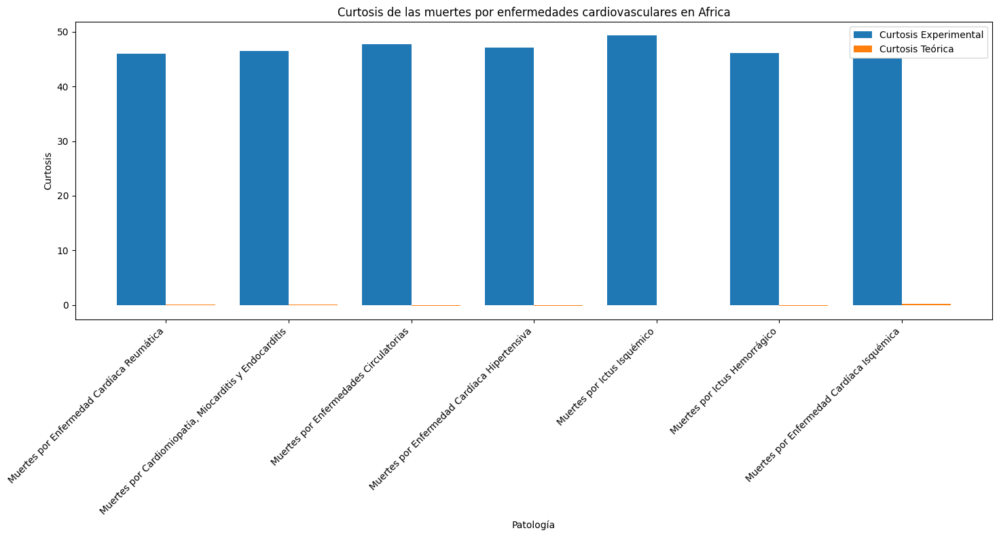

Curtosis para las muertes por enfermedades cardiovasculares en America del Norte
Para Muertes por Enfermedad Cardíaca Reumática:
Curtosis Experimental: 8.935125168851714
Curtosis Teórica: 0.06349758685341333
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Curtosis Experimental: 6.448305346576577
Curtosis Teórica: -0.15233200721781026
Para Muertes por Enfermedades Circulatorias:
Curtosis Experimental: 7.340937096495649
Curtosis Teórica: 0.019151623620838443
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Curtosis Experimental: 9.841946654831874
Curtosis Teórica: -0.39619052410031586
Para Muertes por Ictus Isquémico:
Curtosis Experimental: 8.05726903315564
Curtosis Teórica: 0.49910451141519463
Para Muertes por Ictus Hemorrágico:
Curtosis Experimental: 8.611553745511936
Curtosis Teórica: -0.11526008275419519
Para Muertes por Enfermedad Cardíaca Isquémica:
Curtosis Experimental: 7.190050419456398
Curtosis Teórica: -0.11785719389169591


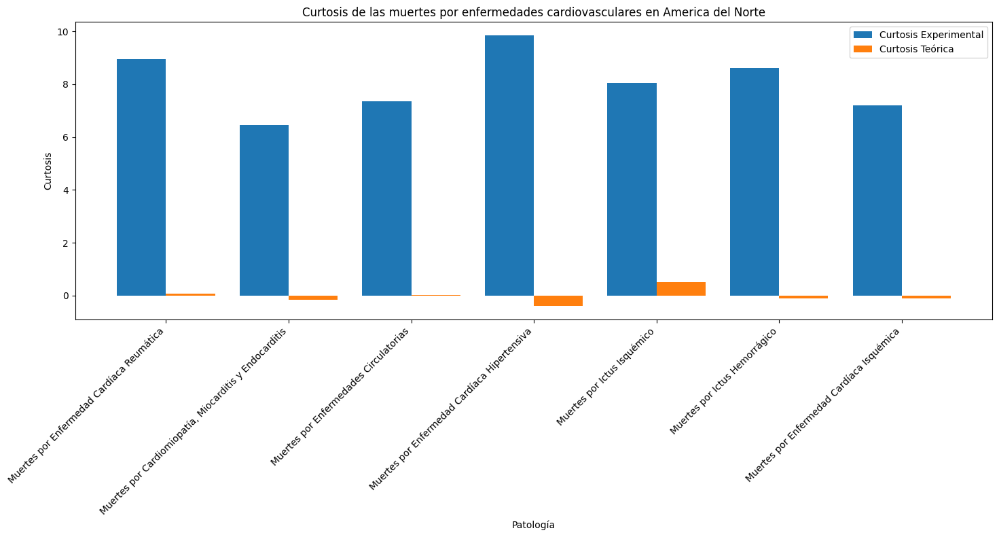

Curtosis para las muertes por enfermedades cardiovasculares en America del Sur
Para Muertes por Enfermedad Cardíaca Reumática:
Curtosis Experimental: 3.309746522719146
Curtosis Teórica: 0.2426109561387273
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Curtosis Experimental: 2.52790703003018
Curtosis Teórica: 0.06829256294515096
Para Muertes por Enfermedades Circulatorias:
Curtosis Experimental: 4.366056712817766
Curtosis Teórica: -0.25327942032335615
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Curtosis Experimental: 5.0927782225837355
Curtosis Teórica: -0.24642621469507509
Para Muertes por Ictus Isquémico:
Curtosis Experimental: 3.261251555429067
Curtosis Teórica: -0.3362290487912669
Para Muertes por Ictus Hemorrágico:
Curtosis Experimental: 3.5739522947761344
Curtosis Teórica: -0.2353694887864517
Para Muertes por Enfermedad Cardíaca Isquémica:
Curtosis Experimental: 4.43238021660484
Curtosis Teórica: 0.0836687229597688


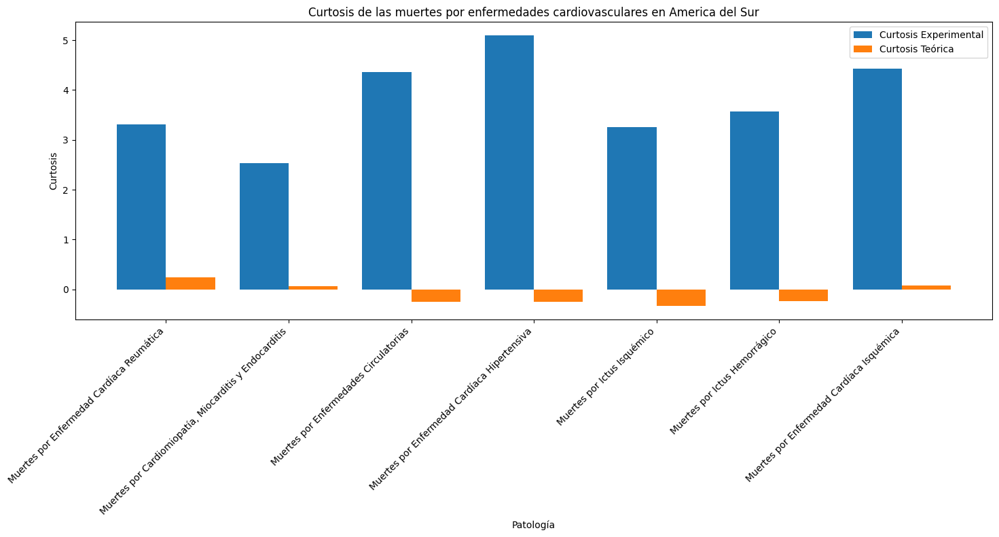

Curtosis para las muertes por enfermedades cardiovasculares en Asia
Para Muertes por Enfermedad Cardíaca Reumática:
Curtosis Experimental: 23.389685667846635
Curtosis Teórica: -0.03526015450783948
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Curtosis Experimental: 34.45519433332816
Curtosis Teórica: -0.019336945365893587
Para Muertes por Enfermedades Circulatorias:
Curtosis Experimental: 35.69637337165739
Curtosis Teórica: 0.002702928906813895
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Curtosis Experimental: 31.898976494280006
Curtosis Teórica: -0.3114643883171544
Para Muertes por Ictus Isquémico:
Curtosis Experimental: 28.87140487083146
Curtosis Teórica: 0.06400405781454932
Para Muertes por Ictus Hemorrágico:
Curtosis Experimental: 25.387182400818855
Curtosis Teórica: -0.05069021537845275
Para Muertes por Enfermedad Cardíaca Isquémica:
Curtosis Experimental: 32.58467380516339
Curtosis Teórica: -0.07719817747331614


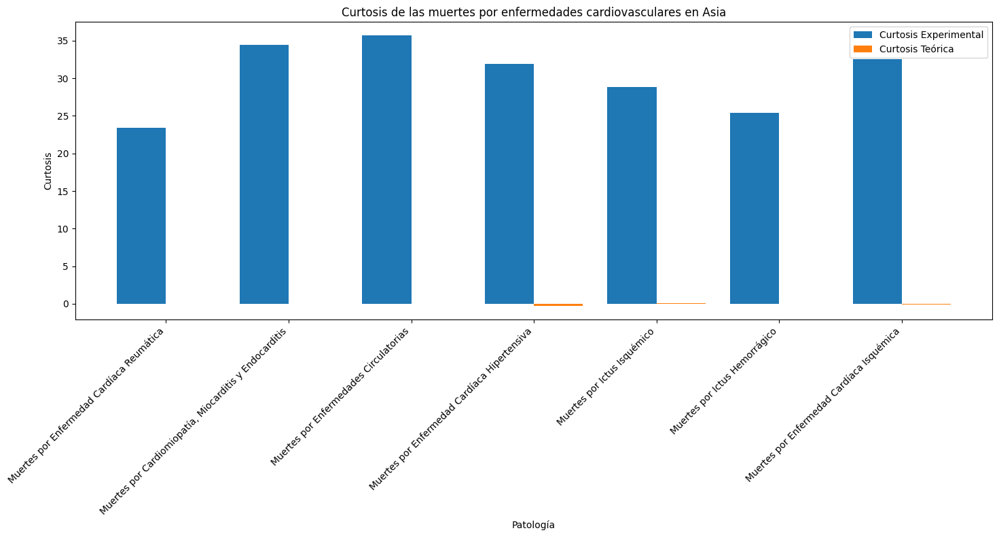

Curtosis para las muertes por enfermedades cardiovasculares en Europa
Para Muertes por Enfermedad Cardíaca Reumática:
Curtosis Experimental: 31.056568545187254
Curtosis Teórica: -0.030206701597605523
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Curtosis Experimental: 24.0204125304593
Curtosis Teórica: 0.020874938811664467
Para Muertes por Enfermedades Circulatorias:
Curtosis Experimental: 31.100041173940298
Curtosis Teórica: 0.10834037487916692
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Curtosis Experimental: 33.696993763399476
Curtosis Teórica: -0.08321371565752322
Para Muertes por Ictus Isquémico:
Curtosis Experimental: 27.172385577278604
Curtosis Teórica: 0.16251918769254425
Para Muertes por Ictus Hemorrágico:
Curtosis Experimental: 30.529504125021475
Curtosis Teórica: -0.07211041529704154
Para Muertes por Enfermedad Cardíaca Isquémica:
Curtosis Experimental: 28.25273839032339
Curtosis Teórica: 0.11673589032423148


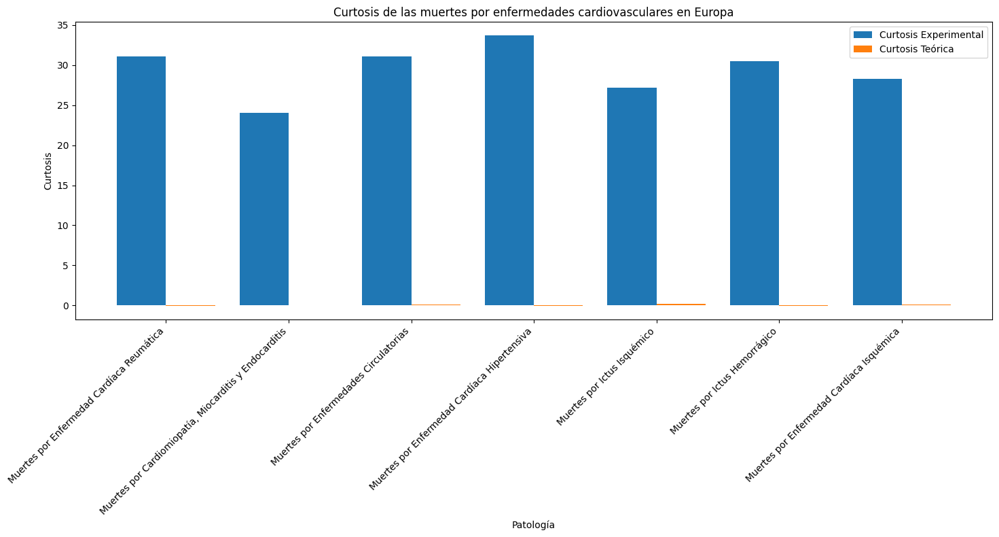

Curtosis para las muertes por enfermedades cardiovasculares en Oceania
Para Muertes por Enfermedad Cardíaca Reumática:
Curtosis Experimental: 2.673143530783988
Curtosis Teórica: -0.4418974203237762
Para Muertes por Cardiomiopatía, Miocarditis y Endocarditis:
Curtosis Experimental: 2.037132897326118
Curtosis Teórica: -0.16640782915886865
Para Muertes por Enfermedades Circulatorias:
Curtosis Experimental: 1.5374506826452414
Curtosis Teórica: -0.18011890120912444
Para Muertes por Enfermedad Cardíaca Hipertensiva:
Curtosis Experimental: 3.5659577537576226
Curtosis Teórica: -0.015826754670503984
Para Muertes por Ictus Isquémico:
Curtosis Experimental: 1.1902494821828347
Curtosis Teórica: 0.2424877294585941
Para Muertes por Ictus Hemorrágico:
Curtosis Experimental: 2.786795622349495
Curtosis Teórica: 0.4068796263710066
Para Muertes por Enfermedad Cardíaca Isquémica:
Curtosis Experimental: 1.622534375162366
Curtosis Teórica: 0.37451588700044436


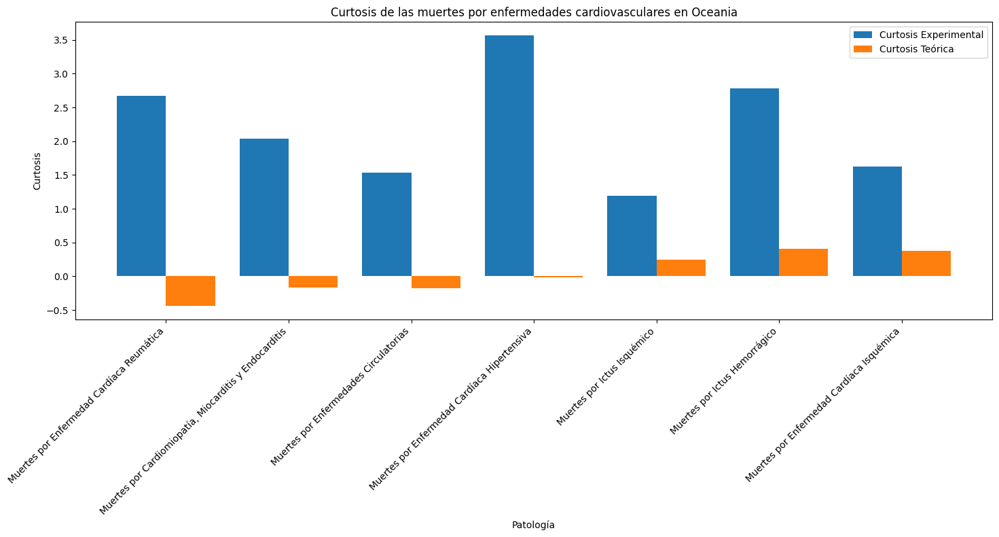

In [38]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import kurtosis, norm

# Función para calcular la curtosis
def calcular_curtosis(df, patologia):
    # Eliminar valores NaN
    data_patologia = df[patologia].dropna()
    
    # Curtosis experimental
    curtosis_experimental = kurtosis(data_patologia)
    
    # Ajustar una distribución normal a los datos
    mu, std = norm.fit(data_patologia)
    
    # Generar datos teóricos basados en la distribución normal ajustada
    data_teorica = np.random.normal(mu, std, len(data_patologia))
    
    # Curtosis teórica
    curtosis_teorica = kurtosis(data_teorica)
    
    return curtosis_experimental, curtosis_teorica

# Bucle para calcular y graficar la curtosis por continente y patología
for continente, paises in continentes.items():
    # Filtrar el DataFrame por los países del continente actual
    df_continente = df[df['Entity'].isin(paises)]
    print(f"Curtosis para las muertes por enfermedades cardiovasculares en {continente}")
    
    curtosis_continente = {}

    for patologia in patologias:
        # Calcular la curtosis experimental y teórica
        curtosis_experimental, curtosis_teorica = calcular_curtosis(df_continente, patologia)
        patologia_legible = reemplazar_texto(patologia)
        
        # Almacenar los resultados en el diccionario
        curtosis_continente[patologia_legible] = (curtosis_experimental, curtosis_teorica)
        
        # Imprimir los resultados
        print(f"Para {patologia_legible}:")
        print(f"Curtosis Experimental: {curtosis_experimental}")
        print(f"Curtosis Teórica: {curtosis_teorica}")
        print("="*90)
        
    # Graficar la curtosis para el continente actual
    patologias_legibles = list(curtosis_continente.keys())
    curtosis_experimentales = [curtosis_continente[p][0] for p in patologias_legibles]
    curtosis_teoricas = [curtosis_continente[p][1] for p in patologias_legibles]
    
    x = np.arange(len(patologias_legibles))
    width = 0.4
    
    fig, ax = plt.subplots(figsize=(15, 8))
    
    # Graficar las barras de curtosis experimental y teórica
    bar1 = ax.bar(x - width/2, curtosis_experimentales, width, label='Curtosis Experimental')
    bar2 = ax.bar(x + width/2, curtosis_teoricas, width, label='Curtosis Teórica')
    
    # Configurar etiquetas y título del gráfico
    ax.set_xlabel('Patología')
    ax.set_ylabel('Curtosis')
    ax.set_title(f'Curtosis de las muertes por enfermedades cardiovasculares en {continente}')
    ax.set_xticks(x)
    ax.set_xticklabels(patologias_legibles, rotation=45, ha="right")
    ax.legend()
    
    # Ajustar el diseño del gráfico
    plt.tight_layout()
    plt.show()

# Intervalos

## Intervalo de confianza para la media de la población

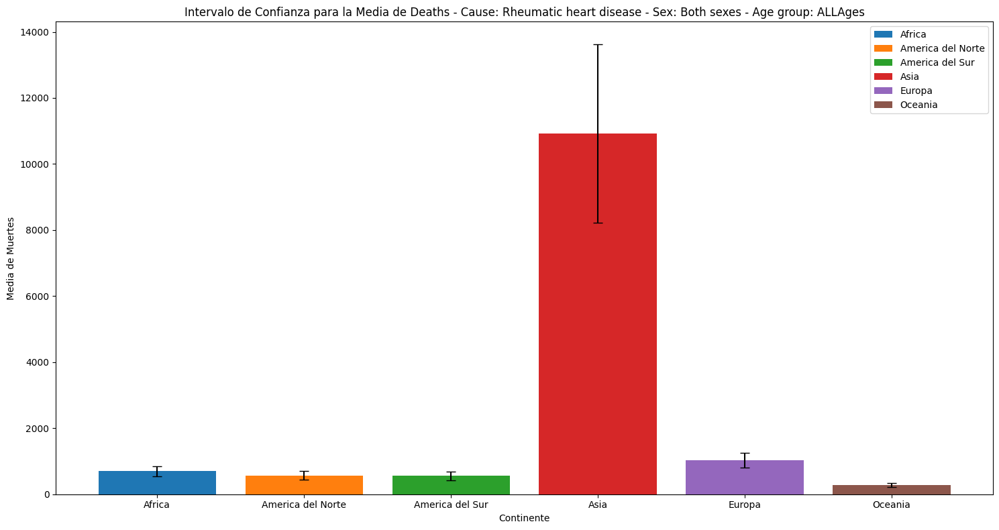

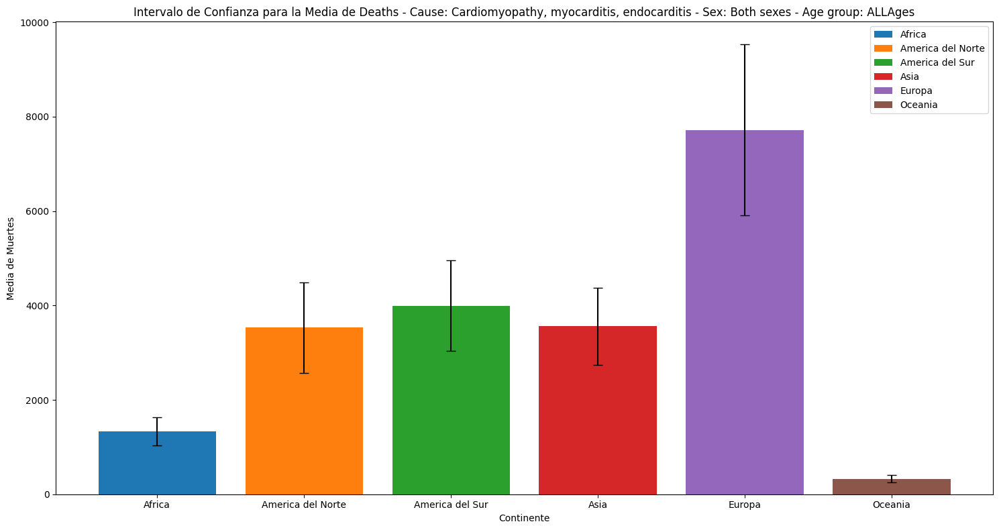

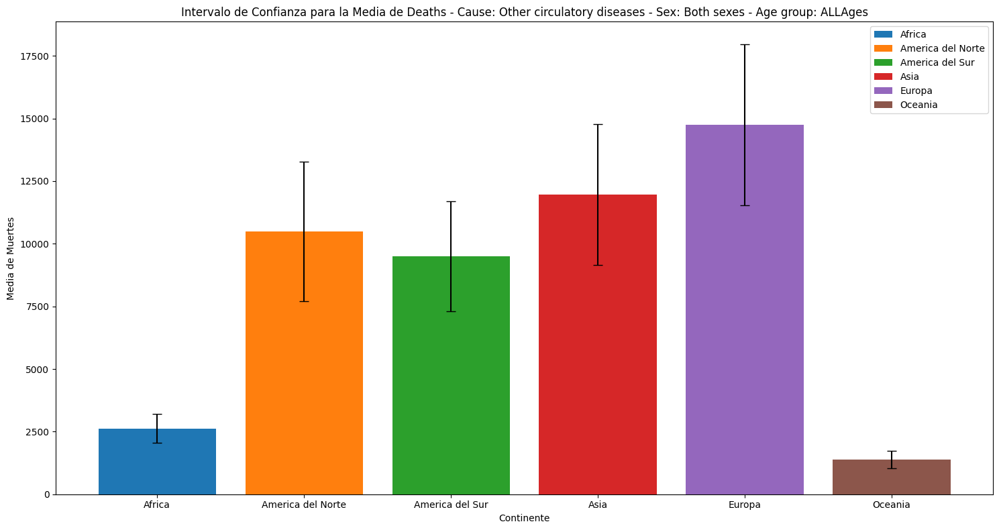

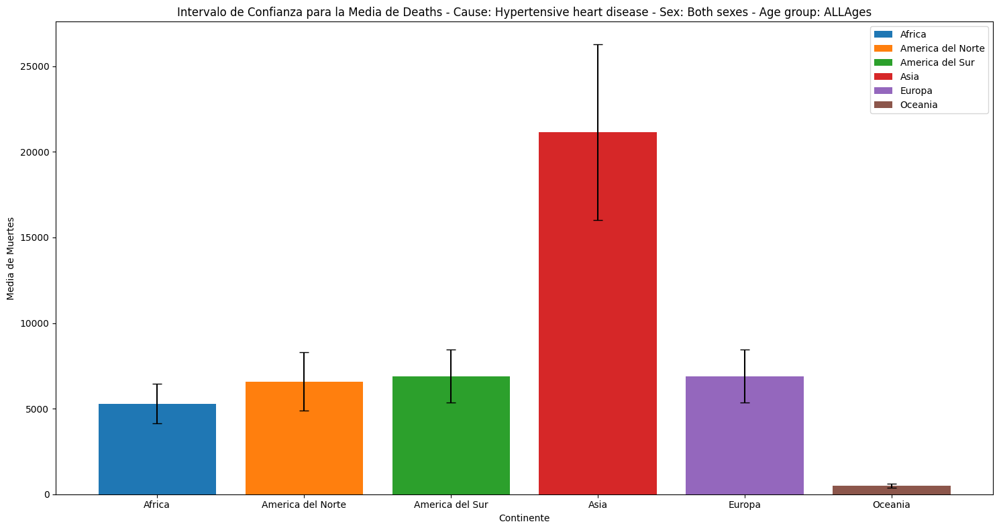

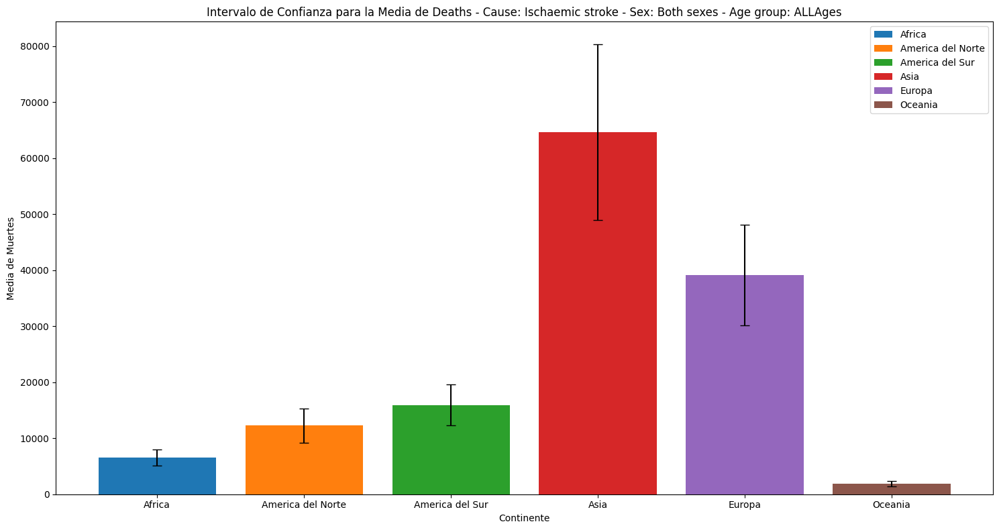

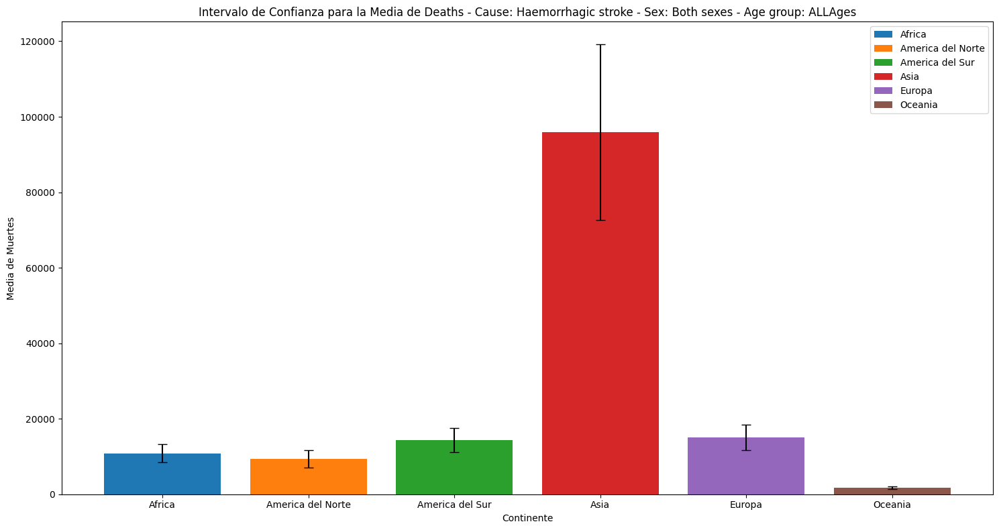

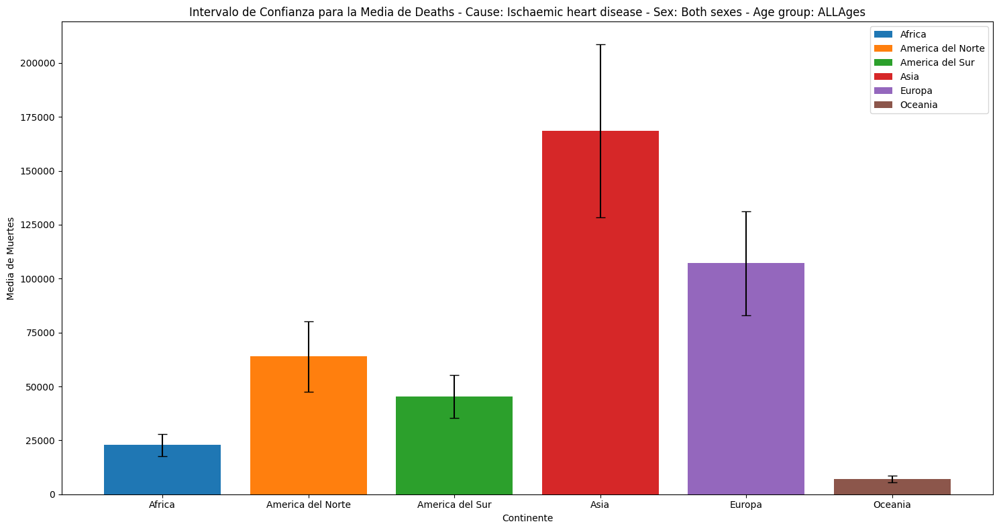

In [39]:
# Función para calcular el intervalo de confianza para la media
def intervalo_confianza_media(df, patologia, confianza=0.95):
    data_patologia = df[patologia].dropna()
    n = len(data_patologia)
    media = np.mean(data_patologia)
    stderr = np.std(data_patologia, ddof=1) / np.sqrt(n)
    t_score = t.ppf((1 + confianza) / 2, n - 1)
    margen_error = t_score * stderr
    intervalo = (media - margen_error, media + margen_error)
    
    return media, intervalo
    
# Bucle para calcular y graficar el intervalo de confianza para la media por patología y continente
for patologia in patologias:
    medias_por_patologia = []
    intervalos_inferiores_por_patologia = []
    intervalos_superiores_por_patologia = []
    
    fig, ax = plt.subplots(figsize=(15, 8))
    xticks = []
    xticklabels = []
    
    for i, (continente, paises) in enumerate(continentes.items()):
        # Filtrar el DataFrame por los países del continente actual
        df_continente = df[df['Entity'].isin(paises)]
        
        # Calcular el intervalo de confianza para la media
        media, intervalo = intervalo_confianza_media(df_continente, patologia)
        
        # Agregar resultados a las listas por patología
        medias_por_patologia.append(media)
        intervalos_inferiores_por_patologia.append(intervalo[0])
        intervalos_superiores_por_patologia.append(intervalo[1])
        
        # Graficar la media y el intervalo de confianza como barras
        ax.bar(i, media, yerr=[[media - intervalo[0]], [intervalo[1] - media]], capsize=5, label=continente)
        xticks.append(i)
        xticklabels.append(continente)
    
    # Configurar el gráfico
    ax.set_xlabel('Continente')
    ax.set_ylabel('Media de Muertes')
    ax.set_title(f'Intervalo de Confianza para la Media de {patologia}')
    ax.set_xticks(xticks)
    ax.set_xticklabels(xticklabels)
    ax.legend()
    
    plt.tight_layout()
    plt.show()

## Intervalo de confianza para la varianza de la población

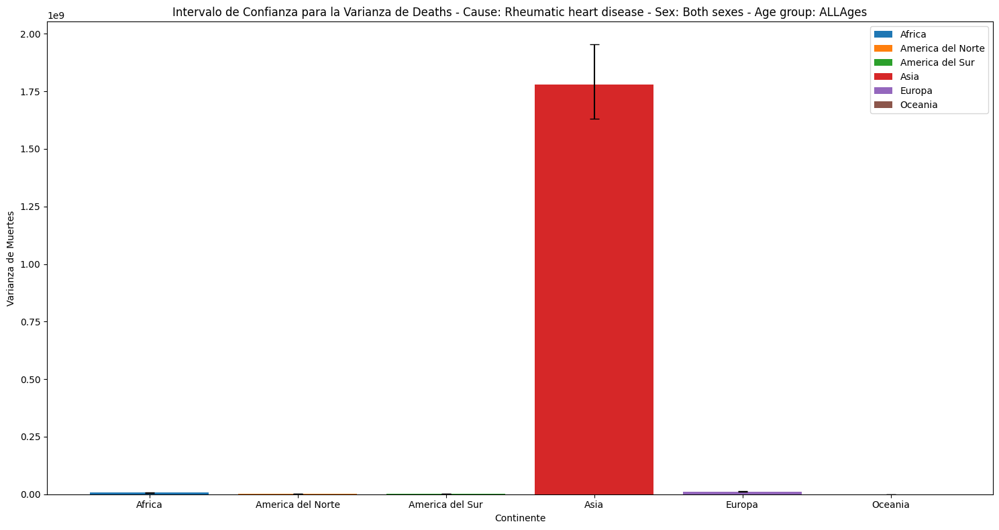

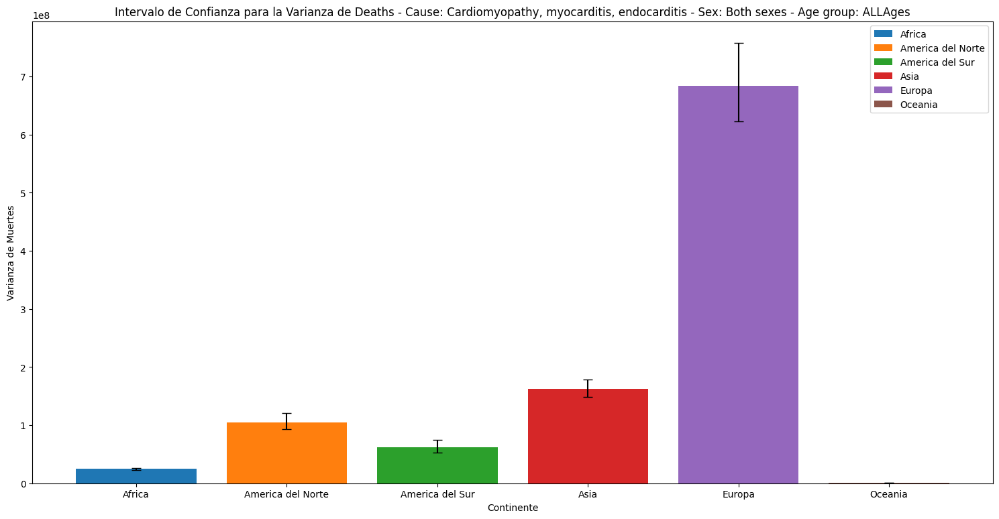

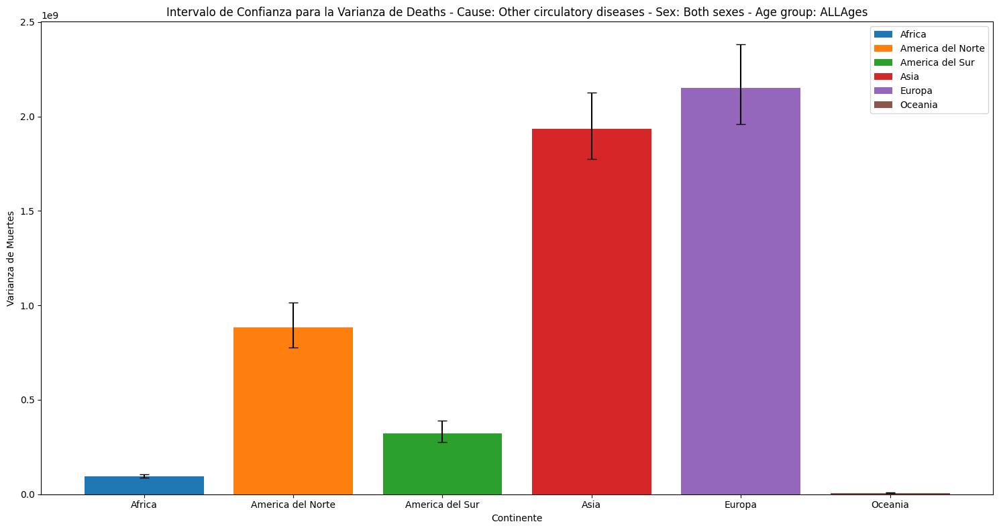

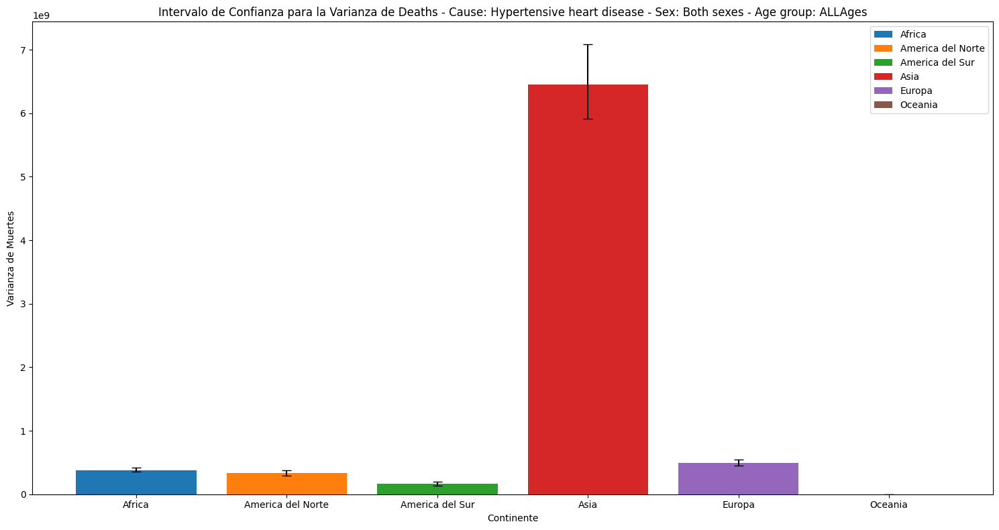

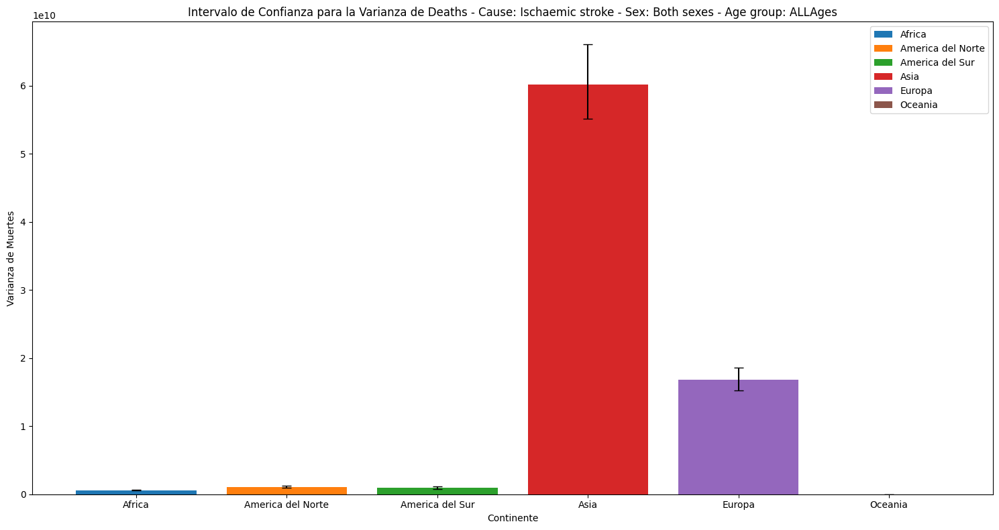

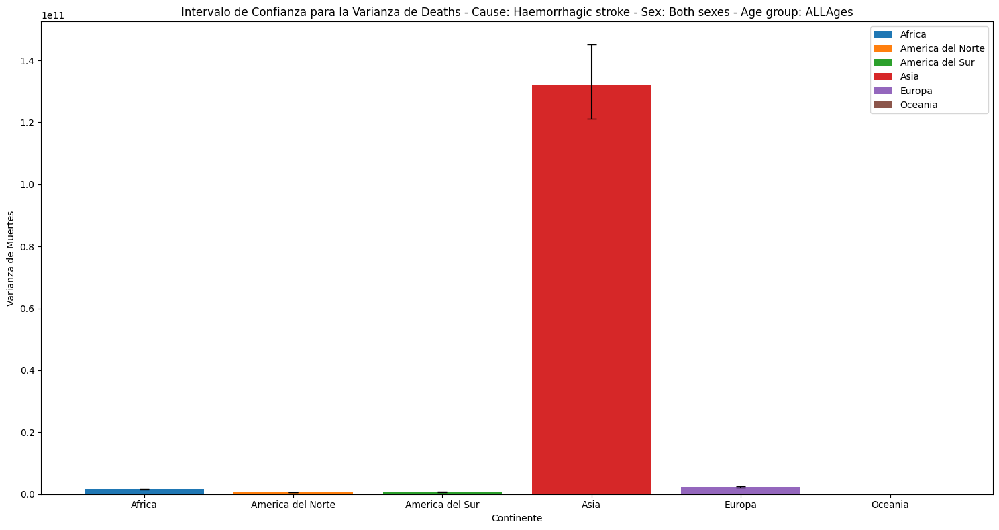

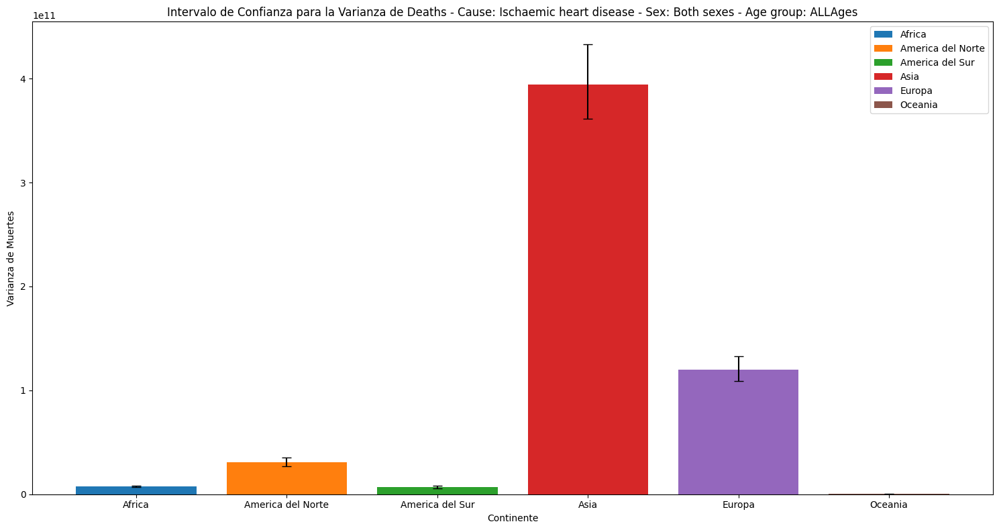

In [44]:
# Función para calcular el intervalo de confianza para la varianza
def intervalo_confianza_varianza(df, patologia, confianza=0.95):
    data_patologia = df[patologia].dropna()
    n = len(data_patologia)
    varianza = np.var(data_patologia, ddof=1)
    chi2_lower = chi2.ppf((1 - confianza) / 2, n - 1)
    chi2_upper = chi2.ppf((1 + confianza) / 2, n - 1)
    intervalo = (n * varianza / chi2_upper, n * varianza / chi2_lower)
    
    return varianza, intervalo

# Bucle para calcular y graficar el intervalo de confianza para la varianza por patología y continente
for patologia in patologias:
    varianzas_por_patologia = []
    intervalos_inferiores_por_patologia = []
    intervalos_superiores_por_patologia = []
    
    fig, ax = plt.subplots(figsize=(15, 8))
    xticks = []
    xticklabels = []
    
    for i, (continente, paises) in enumerate(continentes.items()):
        # Filtrar el DataFrame por los países del continente actual
        df_continente = df[df['Entity'].isin(paises)]
        
        # Calcular el intervalo de confianza para la varianza
        varianza, intervalo = intervalo_confianza_varianza(df_continente, patologia)
        
        # Agregar resultados a las listas por patología
        varianzas_por_patologia.append(varianza)
        intervalos_inferiores_por_patologia.append(intervalo[0])
        intervalos_superiores_por_patologia.append(intervalo[1])
        
        # Graficar la varianza y el intervalo de confianza como barras
        ax.bar(i, varianza, yerr=[[varianza - intervalo[0]], [intervalo[1] - varianza]], capsize=5, label=continente)
        xticks.append(i)
        xticklabels.append(continente)
    
    # Configurar el gráfico
    ax.set_xlabel('Continente')
    ax.set_ylabel('Varianza de Muertes')
    ax.set_title(f'Intervalo de Confianza para la Varianza de {patologia}')
    ax.set_xticks(xticks)
    ax.set_xticklabels(xticklabels)
    ax.legend()
    
    plt.tight_layout()
    plt.show()


# Prueba

## Prueba *t_Student*

Prueba t-Student para Year entre Africa y Europa:
Estadístico t: 0.0
Valor p: 1.0
Resultado: No hay una diferencia significativa entre las medias de los dos grupos.


C:\Users\Tony\AppData\Local\Temp\ipykernel_9436\2989714683.py:13: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data_continente1, label=f'{continente1} (Media: {np.mean(data_continente1):.2f})', shade=True)
C:\Users\Tony\AppData\Local\Temp\ipykernel_9436\2989714683.py:14: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data_continente2, label=f'{continente2} (Media: {np.mean(data_continente2):.2f})', shade=True)


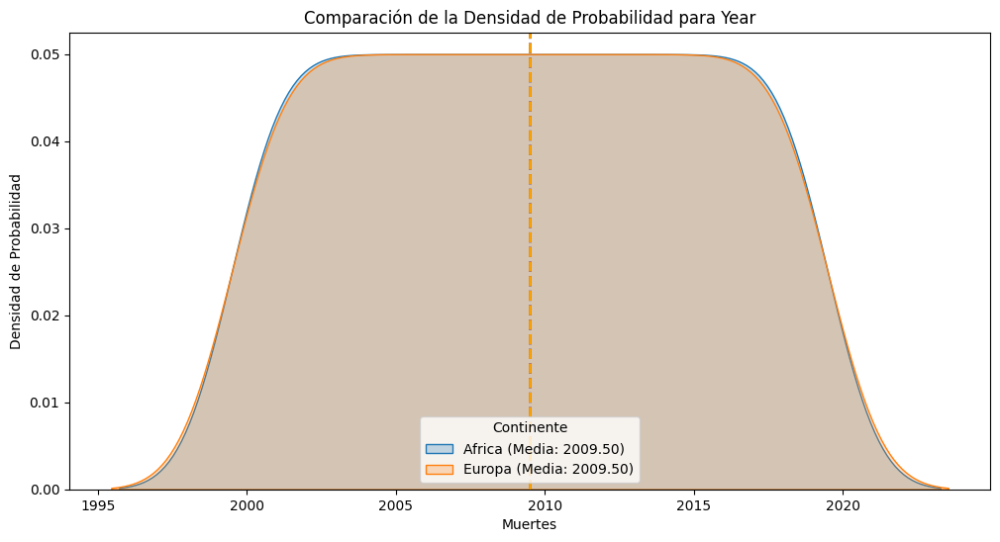

Prueba t-Student para Muertes por Enfermedad Cardíaca Reumática entre Africa y Europa:
Estadístico t: -2.3795523982282876
Valor p: 0.017463141806884762
Resultado: Hay una diferencia significativa entre las medias de los dos grupos.


C:\Users\Tony\AppData\Local\Temp\ipykernel_9436\2989714683.py:13: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data_continente1, label=f'{continente1} (Media: {np.mean(data_continente1):.2f})', shade=True)
C:\Users\Tony\AppData\Local\Temp\ipykernel_9436\2989714683.py:14: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data_continente2, label=f'{continente2} (Media: {np.mean(data_continente2):.2f})', shade=True)


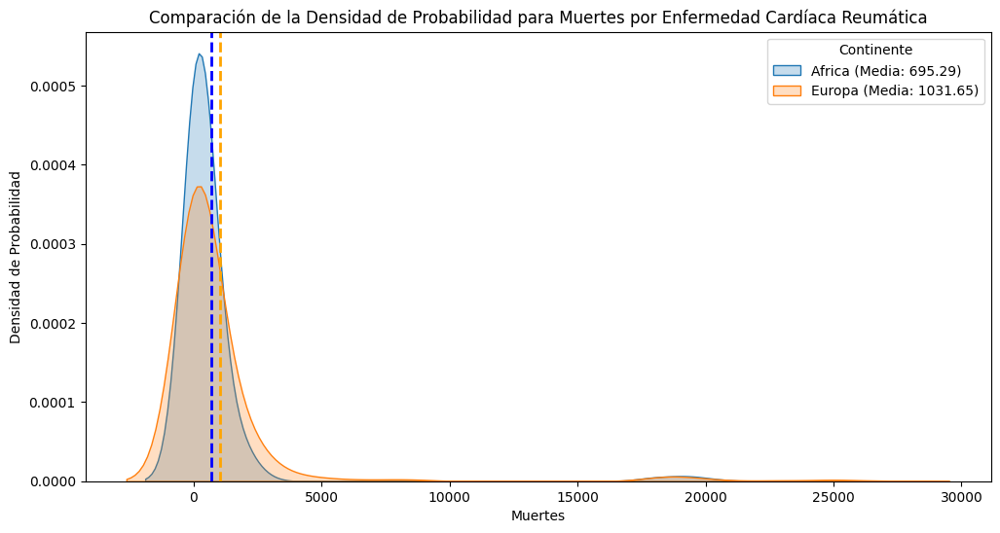

Prueba t-Student para Muertes por Cardiomiopatía, Miocarditis y Endocarditis entre Africa y Europa:
Estadístico t: -6.81692887156812
Valor p: 1.773538966170505e-11
Resultado: Hay una diferencia significativa entre las medias de los dos grupos.


C:\Users\Tony\AppData\Local\Temp\ipykernel_9436\2989714683.py:13: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data_continente1, label=f'{continente1} (Media: {np.mean(data_continente1):.2f})', shade=True)
C:\Users\Tony\AppData\Local\Temp\ipykernel_9436\2989714683.py:14: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data_continente2, label=f'{continente2} (Media: {np.mean(data_continente2):.2f})', shade=True)


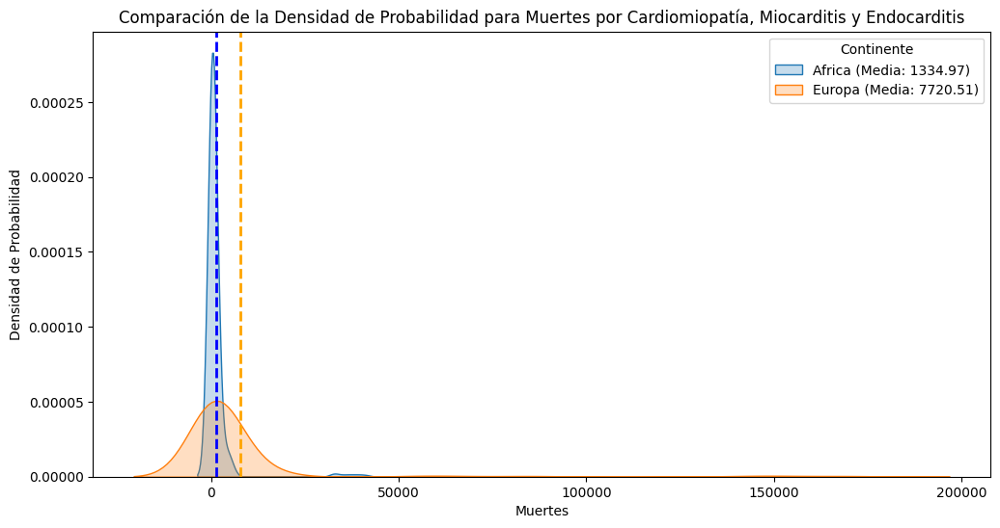

Prueba t-Student para Muertes por Enfermedades Circulatorias entre Africa y Europa:
Estadístico t: -7.268743044924518
Valor p: 8.213435744425502e-13
Resultado: Hay una diferencia significativa entre las medias de los dos grupos.


C:\Users\Tony\AppData\Local\Temp\ipykernel_9436\2989714683.py:13: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data_continente1, label=f'{continente1} (Media: {np.mean(data_continente1):.2f})', shade=True)
C:\Users\Tony\AppData\Local\Temp\ipykernel_9436\2989714683.py:14: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data_continente2, label=f'{continente2} (Media: {np.mean(data_continente2):.2f})', shade=True)


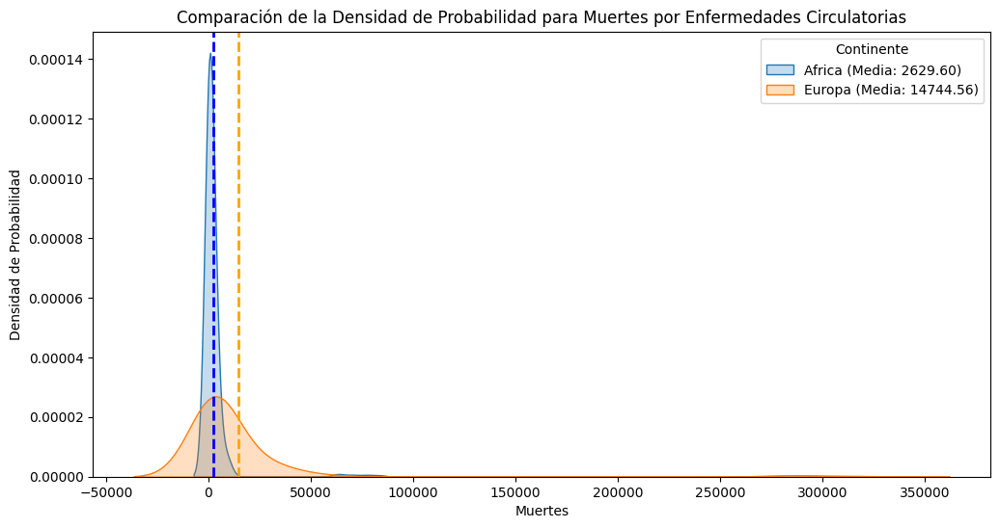

Prueba t-Student para Muertes por Enfermedad Cardíaca Hipertensiva entre Africa y Europa:
Estadístico t: -1.6254958013295984
Valor p: 0.10425559101328045
Resultado: No hay una diferencia significativa entre las medias de los dos grupos.


C:\Users\Tony\AppData\Local\Temp\ipykernel_9436\2989714683.py:13: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data_continente1, label=f'{continente1} (Media: {np.mean(data_continente1):.2f})', shade=True)
C:\Users\Tony\AppData\Local\Temp\ipykernel_9436\2989714683.py:14: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data_continente2, label=f'{continente2} (Media: {np.mean(data_continente2):.2f})', shade=True)


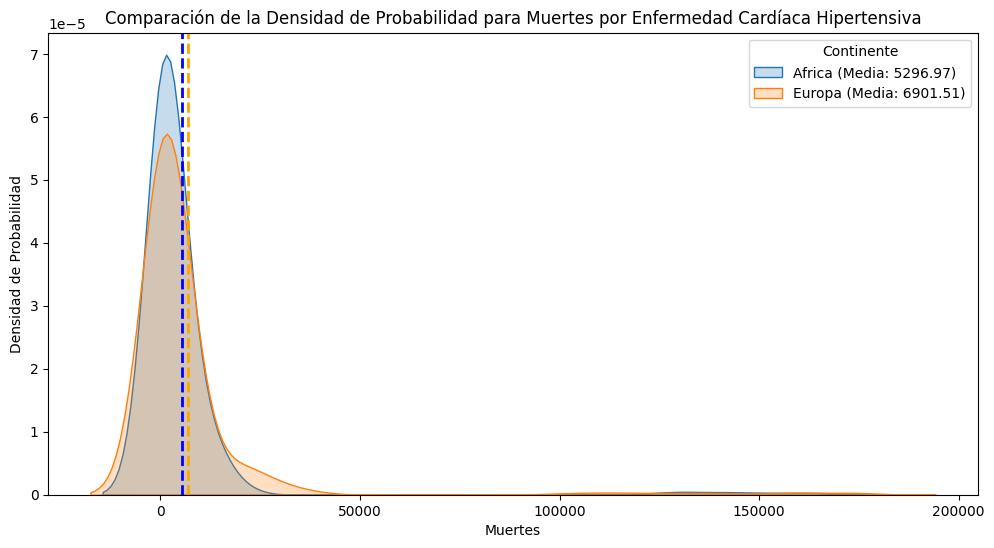

Prueba t-Student para Muertes por Ictus Isquémico entre Africa y Europa:
Estadístico t: -7.01339049830006
Valor p: 4.782602599444641e-12
Resultado: Hay una diferencia significativa entre las medias de los dos grupos.


C:\Users\Tony\AppData\Local\Temp\ipykernel_9436\2989714683.py:13: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data_continente1, label=f'{continente1} (Media: {np.mean(data_continente1):.2f})', shade=True)
C:\Users\Tony\AppData\Local\Temp\ipykernel_9436\2989714683.py:14: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data_continente2, label=f'{continente2} (Media: {np.mean(data_continente2):.2f})', shade=True)


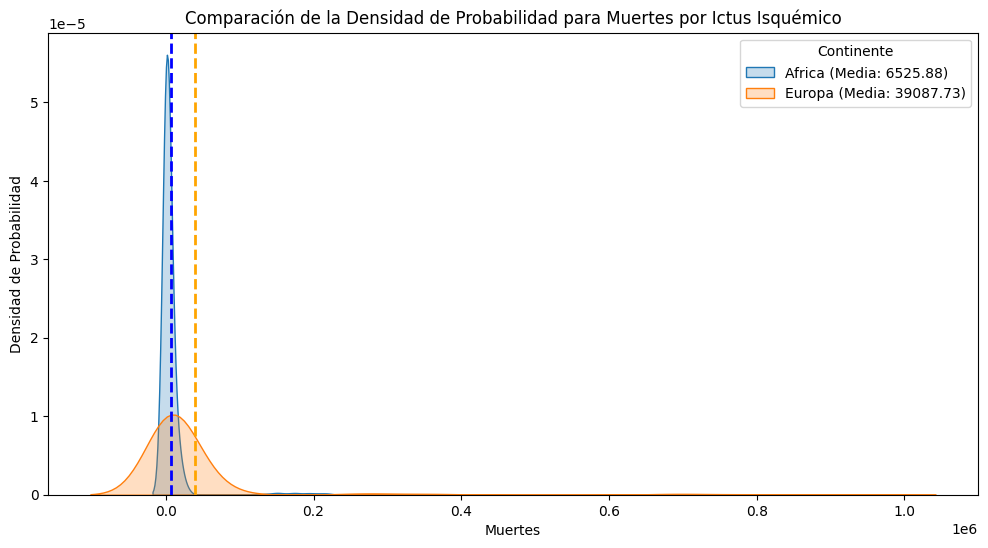

Prueba t-Student para Muertes por Ictus Hemorrágico entre Africa y Europa:
Estadístico t: -1.9803575592126832
Valor p: 0.04784375596078297
Resultado: Hay una diferencia significativa entre las medias de los dos grupos.


C:\Users\Tony\AppData\Local\Temp\ipykernel_9436\2989714683.py:13: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data_continente1, label=f'{continente1} (Media: {np.mean(data_continente1):.2f})', shade=True)
C:\Users\Tony\AppData\Local\Temp\ipykernel_9436\2989714683.py:14: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data_continente2, label=f'{continente2} (Media: {np.mean(data_continente2):.2f})', shade=True)


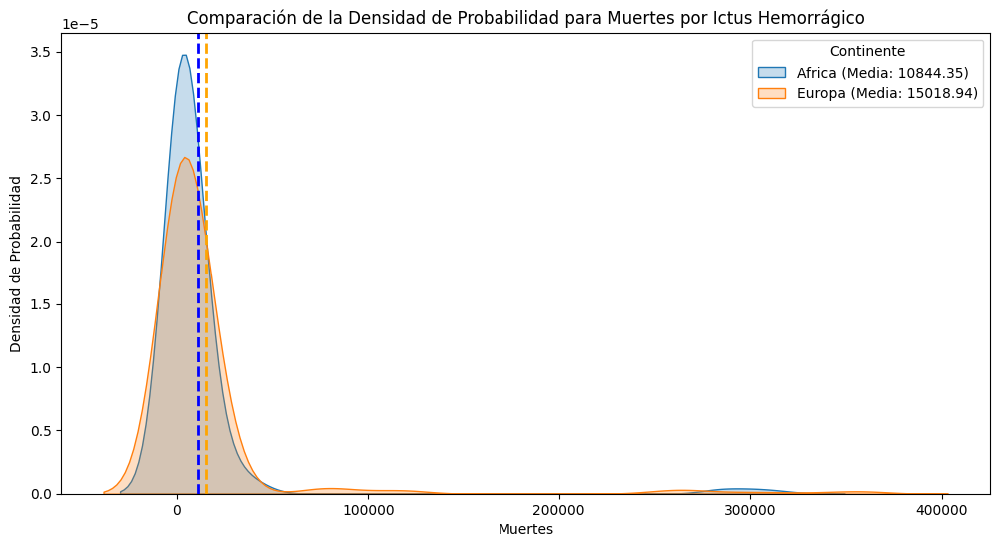

Prueba t-Student para Muertes por Enfermedad Cardíaca Isquémica entre Africa y Europa:
Estadístico t: -6.730536062845247
Valor p: 3.0597052641001334e-11
Resultado: Hay una diferencia significativa entre las medias de los dos grupos.


C:\Users\Tony\AppData\Local\Temp\ipykernel_9436\2989714683.py:13: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data_continente1, label=f'{continente1} (Media: {np.mean(data_continente1):.2f})', shade=True)
C:\Users\Tony\AppData\Local\Temp\ipykernel_9436\2989714683.py:14: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data_continente2, label=f'{continente2} (Media: {np.mean(data_continente2):.2f})', shade=True)


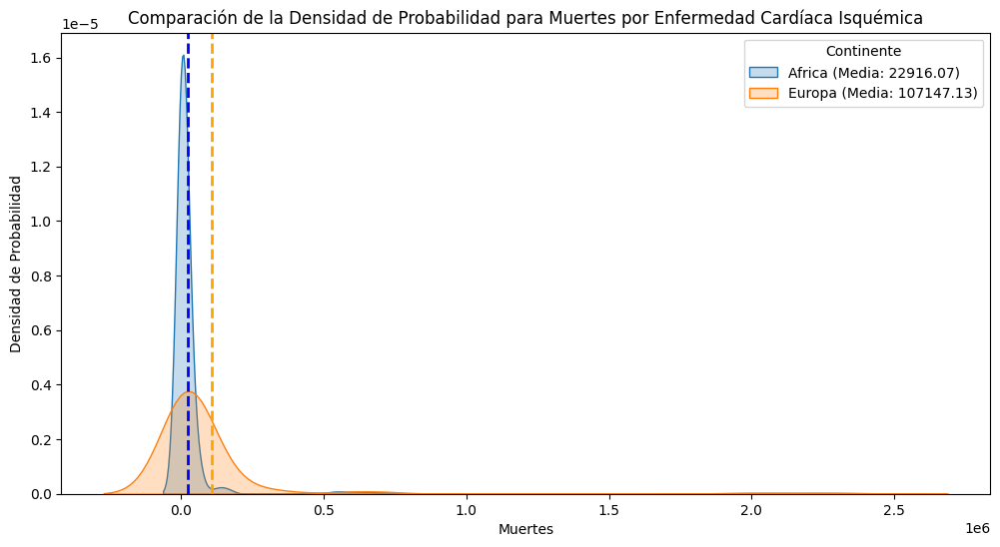

Prueba t-Student para Total_deaths entre Africa y Europa:
Estadístico t: -6.268505839773057
Valor p: 5.629337260718972e-10
Resultado: Hay una diferencia significativa entre las medias de los dos grupos.


C:\Users\Tony\AppData\Local\Temp\ipykernel_9436\2989714683.py:13: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data_continente1, label=f'{continente1} (Media: {np.mean(data_continente1):.2f})', shade=True)
C:\Users\Tony\AppData\Local\Temp\ipykernel_9436\2989714683.py:14: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(data_continente2, label=f'{continente2} (Media: {np.mean(data_continente2):.2f})', shade=True)


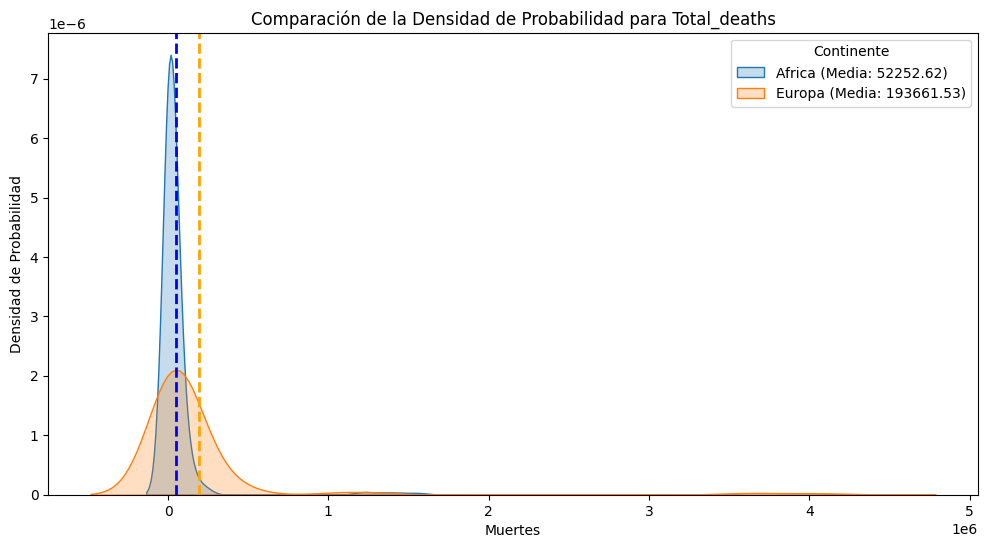

In [41]:
# Función para realizar la prueba t-Student entre dos continentes
def prueba_t_student(df, patologia, continente1, continente2):
    data_continente1 = df[df['Entity'].isin(continentes[continente1])][patologia].dropna()
    data_continente2 = df[df['Entity'].isin(continentes[continente2])][patologia].dropna()
    
    t_stat, p_value = stats.ttest_ind(data_continente1, data_continente2, equal_var=False)  # Prueba t para muestras independientes
    return t_stat, p_value, data_continente1, data_continente2

# Función para graficar la comparación de densidades
def graficar_comparacion(data_continente1, data_continente2, patologia_legible, continente1, continente2):
    plt.figure(figsize=(12, 6))
    
    sns.kdeplot(data_continente1, label=f'{continente1} (Media: {np.mean(data_continente1):.2f})', shade=True)
    sns.kdeplot(data_continente2, label=f'{continente2} (Media: {np.mean(data_continente2):.2f})', shade=True)
    
    plt.axvline(np.mean(data_continente1), color='blue', linestyle='dashed', linewidth=2)
    plt.axvline(np.mean(data_continente2), color='orange', linestyle='dashed', linewidth=2)
    
    plt.title(f'Comparación de la Densidad de Probabilidad para {patologia_legible}')
    plt.xlabel('Muertes')
    plt.ylabel('Densidad de Probabilidad')
    plt.legend(title='Continente')
    plt.show()

# Comparación de dos continentes específicos
continente1 = "Africa"
continente2 = "Europa"

# Bucle para realizar la prueba t-Student por patología
for patologia in df.columns[2:]:  # Suponiendo que las patologías empiezan en la tercera columna
    t_stat, p_value, data_continente1, data_continente2 = prueba_t_student(df, patologia, continente1, continente2)
    patologia_legible = reemplazar_texto(patologia)
    
    print(f"Prueba t-Student para {patologia_legible} entre {continente1} y {continente2}:")
    print(f"Estadístico t: {t_stat}")
    print(f"Valor p: {p_value}")
    if p_value < 0.05:
        print("Resultado: Hay una diferencia significativa entre las medias de los dos grupos.")
    else:
        print("Resultado: No hay una diferencia significativa entre las medias de los dos grupos.")
    print("="*90)
    
    # Graficar la comparación de densidades
    graficar_comparacion(data_continente1, data_continente2, patologia_legible, continente1, continente2)